In [ ]:
!pip install opendatasets --upgrade --quiet

In [ ]:
import opendatasets as od

dataset = 'https://www.kaggle.com/datasets/noir1112/e-commerce-customer-engagement?select=ecommerce_customer_data.csv'

od.download(dataset)

Please provide your Kaggle credentials to download this dataset. Learn more: http://bit.ly/kaggle-creds
Your Kaggle username: 00
Your Kaggle Key: ··········
Dataset URL: https://www.kaggle.com/datasets/noir1112/e-commerce-customer-engagement


100%|██████████| 916k/916k [00:00<00:00, 474MB/s]

In [ ]:
import pandas as pd

# Load the dataset
df = pd.read_csv('/content/e-commerce-customer-engagement/ecommerce_customer_data.csv')

# Inspect the dataset
print("Dataset Shape:", df.shape)  # Dimensions of the dataset
print(df.info())  # Summary of column data types and missing values
print(df.head())  # First few rows for a quick preview

import pandas as pd
from tabulate import tabulate
import io
import re

# Capture the output of df.info()
buffer = io.StringIO()
df.info(buf=buffer)
info_string = buffer.getvalue()

# Parse the output to extract column information
lines = info_string.split('\n')[3:-2]  # Extract relevant lines
table_data = []
index = 0  # Initialize the index
for line in lines:
    # Use regex to extract column name, non-null count, and dtype
    match = re.search(r"(\S+)\s+(\d+)\s+non-null\s+(\S+)", line)
    if match:
        column_name = match.group(1)
        non_null_count = match.group(2)
        dtype = match.group(3)
        table_data.append([index, column_name, non_null_count, dtype])
        index += 1  # Increment the index

# Format with tabulate
formatted_table = tabulate(table_data, headers=["#", "Column", "Non-Null Count", "Dtype"], tablefmt="fancy_grid", showindex=False)

# Display the formatted table
print(formatted_table)

Dataset Shape: (10000, 23)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 23 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   CustomerID                   9508 non-null   object 
 1   RegistrationDate             9504 non-null   object 
 2   Age                          9485 non-null   float64
 3   Gender                       7388 non-null   object 
 4   IncomeLevel                  7497 non-null   object 
 5   Country                      9507 non-null   object 
 6   City                         9517 non-null   object 
 7   TotalPurchases               9470 non-null   float64
 8   AverageOrderValue            9481 non-null   float64
 9   CustomerLifetimeValue        9507 non-null   float64
 10  FavoriteCategory             8411 non-null   object 
 11  SecondFavoriteCategory       8450 non-null   object 
 12  EmailEngagementRate          9524 non-null   flo

In [ ]:
from IPython.display import display, HTML

# Calculate missing values and percentages
missing_values = df.isnull().sum()
missing_percent = (df.isnull().sum() / len(df)) * 100

# Create HTML for side-by-side display
output = f"""
<table>
<tr>
<th>Missing Values</th>
<th>Missing Values (%)</th>
</tr>
<tr>
<td>{missing_values.to_frame().to_html()}</td>
<td>{missing_percent.to_frame().to_html()}</td>
</tr>
</table>
"""

# Display the output
display(HTML(output))

# Drop columns with more than 30% missing values (you can adjust the threshold if needed)
threshold = 30
df = df.loc[:, missing_percent < threshold]
print("Shape After Dropping Columns with >30% Missing:", df.shape)

# Impute missing values for the remaining columns
# For numerical columns, fill with mean
numerical_cols = df.select_dtypes(include=['float64', 'int64']).columns
df[numerical_cols] = df[numerical_cols].fillna(df[numerical_cols].mean())

# For categorical columns, fill with 'Unknown'
categorical_cols = df.select_dtypes(include=['object']).columns
df[categorical_cols] = df[categorical_cols].fillna('Unknown')

# Check if there are any remaining missing values
print("Missing Values After Handling:\n", df.isnull().sum())


Missing Values,Missing Values (%)
,0
CustomerID,492
RegistrationDate,496
Age,515
Gender,2612
IncomeLevel,2503
Country,493
City,483
TotalPurchases,530
AverageOrderValue,519


Shape After Dropping Columns with >30% Missing: (10000, 23)
Missing Values After Handling:
 CustomerID                     0
RegistrationDate               0
Age                            0
Gender                         0
IncomeLevel                    0
Country                        0
City                           0
TotalPurchases                 0
AverageOrderValue              0
CustomerLifetimeValue          0
FavoriteCategory               0
SecondFavoriteCategory         0
EmailEngagementRate            0
SocialMediaEngagementRate      0
MobileAppUsage                 0
CustomerServiceInteractions    0
AverageSatisfactionScore       0
EmailConversionRate            0
SocialMediaConversionRate      0
SearchEngineConversionRate     0
RepeatCustomer                 0
PremiumMember                  0
HasReturnedItems               0
dtype: int64


In [ ]:
# Impute missing values in Age column with the median
df['Age'] = df['Age'].fillna(df['Age'].median())


In [ ]:
# Replace "L" with "Low" and "H" with "High" in the "IncomeLevel" column
df['IncomeLevel'] = df['IncomeLevel'].replace({'L': 'Low', 'H': 'High'})

# Replace "F" with "Female" and "M" with "Male" in the "Gender" column
df['Gender'] = df['Gender'].replace({'F': 'Female', 'M': 'Male'})

# Display the updated DataFrame
print(df.head())

  CustomerID RegistrationDate        Age             Gender IncomeLevel  \
0    Unknown       2020-05-10  25.000000            Unknown     Unknown   
1  CUST00002       2021-07-18  34.536742  Prefer not to say        High   
2  CUST00003       2021-02-04  43.000000            Unknown        High   
3  CUST00004       2020-12-31  49.000000             Female        High   
4  CUST00005       2022-06-27  29.000000             Female   Very High   

     Country         City  TotalPurchases  AverageOrderValue  \
0      Other        Tokyo             4.0          15.886509   
1    Germany       London             6.0          27.638853   
2     France      Unknown            10.0         161.739425   
3  Australia  Los Angeles             5.0          14.194263   
4  Australia        Tokyo             7.0       31147.427206   

   CustomerLifetimeValue  ... SocialMediaEngagementRate MobileAppUsage  \
0             672.919948  ...                  0.379694           High   
1             18

In [ ]:
# Convert RegistrationDate to datetime
df['RegistrationDate'] = pd.to_datetime(df['RegistrationDate'], errors='coerce')

# Drop rows with invalid dates
df.dropna(subset=['RegistrationDate'], inplace=True)

# Create a CustomerTenure column based on RegistrationDate
from datetime import datetime
current_date = datetime.now()
df['CustomerTenure'] = ((current_date - df['RegistrationDate']).dt.days // 30).astype(int)

# Drop the original RegistrationDate column
df.drop(columns=['RegistrationDate'], inplace=True)

print("Shape After Creating CustomerTenure:", df.shape)
print(df.columns)

Shape After Creating CustomerTenure: (9504, 23)
Index(['CustomerID', 'Age', 'Gender', 'IncomeLevel', 'Country', 'City',
       'TotalPurchases', 'AverageOrderValue', 'CustomerLifetimeValue',
       'FavoriteCategory', 'SecondFavoriteCategory', 'EmailEngagementRate',
       'SocialMediaEngagementRate', 'MobileAppUsage',
       'CustomerServiceInteractions', 'AverageSatisfactionScore',
       'EmailConversionRate', 'SocialMediaConversionRate',
       'SearchEngineConversionRate', 'RepeatCustomer', 'PremiumMember',
       'HasReturnedItems', 'CustomerTenure'],
      dtype='object')


In [ ]:
from sklearn.preprocessing import LabelEncoder
import pandas as pd

# Example: Label Encoding for binary columns (e.g., RepeatCustomer, PremiumMember)
label_cols = ['RepeatCustomer', 'PremiumMember', 'HasReturnedItems']
le = LabelEncoder()
for col in label_cols:
    df[col] = le.fit_transform(df[col])

print("Data After Label Encoding:\n", df.head())

print(df.columns)

Data After Label Encoding:
   CustomerID        Age             Gender IncomeLevel    Country  \
0    Unknown  25.000000            Unknown     Unknown      Other   
1  CUST00002  34.536742  Prefer not to say        High    Germany   
2  CUST00003  43.000000            Unknown        High     France   
3  CUST00004  49.000000             Female        High  Australia   
4  CUST00005  29.000000             Female   Very High  Australia   

          City  TotalPurchases  AverageOrderValue  CustomerLifetimeValue  \
0        Tokyo             4.0          15.886509             672.919948   
1       London             6.0          27.638853             181.725056   
2      Unknown            10.0         161.739425            1810.555150   
3  Los Angeles             5.0          14.194263              86.219740   
4        Tokyo             7.0       31147.427206            2112.575945   

  FavoriteCategory  ... MobileAppUsage  CustomerServiceInteractions  \
0         Clothing  ...      

In [ ]:
# 1. Replace '4.0' and 'Unknown' with NaN initially:
df['FavoriteCategory'] = df['FavoriteCategory'].replace(['4.0', 'Unknown'], pd.NA)
df['SecondFavoriteCategory'] = df['SecondFavoriteCategory'].replace(['4.0', 'Unknown'], pd.NA)

# 2. Calculate the most common categories (excluding NaNs):
most_common_fav = df['FavoriteCategory'].dropna().mode()[0]
most_common_second = df['SecondFavoriteCategory'].dropna().mode()[0]

# 3. Fill NaN values with the most common categories:
df['FavoriteCategory'] = df['FavoriteCategory'].fillna(most_common_fav)
df['SecondFavoriteCategory'] = df['SecondFavoriteCategory'].fillna(most_common_second)

# 4. Create the 'FavoriteCombination' column:
df['FavoriteCombination'] = df['FavoriteCategory'] + ' & ' + df['SecondFavoriteCategory']

# 5. Group by 'FavoriteCombination' and count values:
behavior_by_combination = df.groupby('FavoriteCombination')['TotalPurchases'].size()

# 6. Sort and display the top 10 results:
print(behavior_by_combination.sort_values(ascending=False).head(10))

print("Shape After FavoriteCombination:", df.shape)
print(df.columns)
print("Data After FavoriteCombination:\n", df.head())

FavoriteCombination
Beauty & Home Goods         662
Electronics & Home Goods    292
Beauty & Books              280
Beauty & Sports             279
Beauty & Clothing           277
Beauty & Electronics        276
Home Goods & Home Goods     275
Books & Home Goods          272
Beauty & Toys               271
Food & Home Goods           267
Name: TotalPurchases, dtype: int64
Shape After FavoriteCombination: (9504, 24)
Index(['CustomerID', 'Age', 'Gender', 'IncomeLevel', 'Country', 'City',
       'TotalPurchases', 'AverageOrderValue', 'CustomerLifetimeValue',
       'FavoriteCategory', 'SecondFavoriteCategory', 'EmailEngagementRate',
       'SocialMediaEngagementRate', 'MobileAppUsage',
       'CustomerServiceInteractions', 'AverageSatisfactionScore',
       'EmailConversionRate', 'SocialMediaConversionRate',
       'SearchEngineConversionRate', 'RepeatCustomer', 'PremiumMember',
       'HasReturnedItems', 'CustomerTenure', 'FavoriteCombination'],
      dtype='object')
Data After FavoriteC

In [ ]:
print("Missing Values2:\n", df.isnull().sum())

Missing Values2:
 CustomerID                     0
Age                            0
Gender                         0
IncomeLevel                    0
Country                        0
City                           0
TotalPurchases                 0
AverageOrderValue              0
CustomerLifetimeValue          0
FavoriteCategory               0
SecondFavoriteCategory         0
EmailEngagementRate            0
SocialMediaEngagementRate      0
MobileAppUsage                 0
CustomerServiceInteractions    0
AverageSatisfactionScore       0
EmailConversionRate            0
SocialMediaConversionRate      0
SearchEngineConversionRate     0
RepeatCustomer                 0
PremiumMember                  0
HasReturnedItems               0
CustomerTenure                 0
FavoriteCombination            0
dtype: int64


In [ ]:
print(df.dtypes)

CustomerID                      object
Age                            float64
Gender                          object
IncomeLevel                     object
Country                         object
City                            object
TotalPurchases                 float64
AverageOrderValue              float64
CustomerLifetimeValue          float64
FavoriteCategory                object
SecondFavoriteCategory          object
EmailEngagementRate            float64
SocialMediaEngagementRate      float64
MobileAppUsage                  object
CustomerServiceInteractions    float64
AverageSatisfactionScore       float64
EmailConversionRate            float64
SocialMediaConversionRate      float64
SearchEngineConversionRate     float64
RepeatCustomer                   int64
PremiumMember                    int64
HasReturnedItems                 int64
CustomerTenure                   int64
FavoriteCombination             object
dtype: object


In [ ]:
df.to_csv('cleaned_data.csv', index=False)
print("Cleaned data saved.")

Cleaned data saved.


In [ ]:
# Save the DataFrame to an Excel file
!pip install openpyxl
df.to_excel('cleaned_ecommerce_data_16122024.xlsx', index=False)

In [ ]:
#DESCRIPTIVE ANALYSIS
# Summary statistics for numerical columns
df.describe()


,Age,TotalPurchases,AverageOrderValue,CustomerLifetimeValue,EmailEngagementRate,SocialMediaEngagementRate,CustomerServiceInteractions,AverageSatisfactionScore,EmailConversionRate,SocialMediaConversionRate,SearchEngineConversionRate,RepeatCustomer,PremiumMember,HasReturnedItems,CustomerTenure
count,9504.000000,9504.000000,9504.000000,9504.000000,9504.000000,9504.000000,9504.000000,9504.000000,9504.000000,9504.000000,9504.000000,9504.000000,9504.000000,9504.000000,9504.000000
mean,34.538908,5.044223,192.850575,677.460418,0.282839,0.286447,2.001460,6.955619,0.198319,0.198675,0.199702,1.744423,0.425505,0.620265,54.814078
std,14.736006,3.114673,1468.913616,5721.407370,0.153866,0.155344,1.388721,1.853072,0.117082,0.116485,0.117994,0.631540,0.787895,0.896316,20.836597
min,-25.000000,0.000000,1.235282,-9331.077011,0.002205,0.002378,0.000000,0.000000,0.000885,0.001554,0.002951,0.000000,0.000000,0.000000,18.000000
25%,25.000000,3.000000,28.713755,103.388177,0.166037,0.167469,1.000000,5.752584,0.110486,0.109752,0.109880,2.000000,0.000000,0.000000,37.000000
50%,34.536742,5.000000,58.229613,264.505755,0.272762,0.279304,2.000000,6.955430,0.185823,0.186650,0.186522,2.000000,0.000000,0.000000,55.000000
75%,44.000000,7.000000,126.005493,635.768163,0.377536,0.382239,3.000000,8.283253,0.261918,0.265830,0.267293,2.000000,0.000000,2.000000,73.000000
max,91.000000,27.000000,51810.123750,420810.815641,0.890822,0.847513,11.000000,10.000000,0.783003,0.824266,0.784076,2.000000,2.000000,2.000000,91.000000


In [ ]:
# Check if there are any remaining negative values
print(f"Negative Age values after fixing: {df[df['Age'] < 0].shape[0]}")
print(df['Age'].describe())  # Check summary statistics again


Negative Age values after fixing: 81
count    9504.000000
mean       34.538908
std        14.736006
min       -25.000000
25%        25.000000
50%        34.536742
75%        44.000000
max        91.000000
Name: Age, dtype: float64


In [ ]:
# Remove the rows with negative Age values
df_cleaned = df[df['Age'] >= 0]
print(f"New dataset shape after removal: {df_cleaned.shape}")



New dataset shape after removal: (9423, 24)


In [ ]:
# Verify if there are still any negative Age values
print(f"Negative Age values after fixing: {df[df['Age'] < 0].shape[0]}")


Negative Age values after fixing: 81


In [ ]:
# Clip Age values to be within a realistic range (e.g., 13-100)
df['Age'] = df['Age'].clip(lower=18, upper=100)
print(f"New min age: {df['Age'].min()}, New max age: {df['Age'].max()}")


New min age: 18.0, New max age: 91.0


In [ ]:
# Recalculate and review summary statistics
print(df['Age'].describe())


count    9504.000000
mean       35.555428
std        13.003981
min        18.000000
25%        25.000000
50%        34.536742
75%        44.000000
max        91.000000
Name: Age, dtype: float64


In [ ]:
df['CustomerLifetimeValue'] = df['CustomerLifetimeValue'].clip(lower=0)


In [ ]:
df = df[df['TotalPurchases'] > 0]


In [ ]:
df['AverageSatisfactionScore'] = df['AverageSatisfactionScore'].replace(0, df['AverageSatisfactionScore'].median())


/tmp/ipython-input-22-2698419050.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['AverageSatisfactionScore'] = df['AverageSatisfactionScore'].replace(0, df['AverageSatisfactionScore'].median())


In [ ]:
df['AverageSatisfactionScore'] = df['AverageSatisfactionScore'].clip(lower=1)


/tmp/ipython-input-23-2465986406.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['AverageSatisfactionScore'] = df['AverageSatisfactionScore'].clip(lower=1)


In [ ]:
df['RepeatCustomer'] = df['RepeatCustomer'].clip(0, 1)
df['PremiumMember'] = df['PremiumMember'].clip(0, 1)


/tmp/ipython-input-24-221134613.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['RepeatCustomer'] = df['RepeatCustomer'].clip(0, 1)
/tmp/ipython-input-24-221134613.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['PremiumMember'] = df['PremiumMember'].clip(0, 1)


In [ ]:
df['HasReturnedItems'] = df['HasReturnedItems'].clip(0, 1)


/tmp/ipython-input-25-2649503628.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['HasReturnedItems'] = df['HasReturnedItems'].clip(0, 1)


# **STATISTIC ANALYSIS**

In [ ]:
# Convert integer columns to int (remove decimals)
int_columns = ["Age", "TotalPurchases", "CustomerServiceInteractions",
               "RepeatCustomer", "PremiumMember", "HasReturnedItems", "CustomerTenure"]
df[int_columns] = df[int_columns].astype(int)

# Round float columns to 2 decimals
float_columns = ["AverageOrderValue", "CustomerLifetimeValue", "EmailEngagementRate",
                 "SocialMediaEngagementRate", "EmailConversionRate", "SocialMediaConversionRate",
                 "SearchEngineConversionRate", "AverageSatisfactionScore"]
df[float_columns] = df[float_columns].round(2)

# Format the describe() output to limit decimals
pd.options.display.float_format = lambda x: f"{x:.0f}" if x.is_integer() else f"{x:.2f}"

# Display cleaned summary
df.describe()





/tmp/ipython-input-26-2927675608.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[int_columns] = df[int_columns].astype(int)


,Age,TotalPurchases,AverageOrderValue,CustomerLifetimeValue,EmailEngagementRate,SocialMediaEngagementRate,CustomerServiceInteractions,AverageSatisfactionScore,EmailConversionRate,SocialMediaConversionRate,SearchEngineConversionRate,RepeatCustomer,PremiumMember,HasReturnedItems,CustomerTenure
count,9231,9231,9231,9231,9231,9231,9231,9231,9231,9231,9231,9231,9231,9231,9231
mean,35.52,5.19,193.68,705.14,0.28,0.29,2.00,6.96,0.20,0.20,0.20,0.92,0.24,0.34,54.81
std,12.99,3.04,1487.94,5800.83,0.15,0.16,1.39,1.85,0.12,0.12,0.12,0.27,0.42,0.47,20.85
min,18,1,1.24,0,0,0,0,1,0,0,0,0,0,0,18
25%,25,3,28.71,112.13,0.17,0.17,1,5.76,0.11,0.11,0.11,1,0,0,37
50%,34,5,58.26,278.08,0.27,0.28,2,6.96,0.19,0.19,0.19,1,0,0,55
75%,44,7,125.91,651.93,0.38,0.38,3,8.28,0.26,0.27,0.27,1,0,1,73
max,91,27,51810.12,420810.82,0.89,0.85,11,10,0.78,0.82,0.78,1,1,1,91


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 9231 entries, 0 to 9999
Data columns (total 24 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   CustomerID                   9231 non-null   object 
 1   Age                          9231 non-null   int64  
 2   Gender                       9231 non-null   object 
 3   IncomeLevel                  9231 non-null   object 
 4   Country                      9231 non-null   object 
 5   City                         9231 non-null   object 
 6   TotalPurchases               9231 non-null   int64  
 7   AverageOrderValue            9231 non-null   float64
 8   CustomerLifetimeValue        9231 non-null   float64
 9   FavoriteCategory             9231 non-null   object 
 10  SecondFavoriteCategory       9231 non-null   object 
 11  EmailEngagementRate          9231 non-null   float64
 12  SocialMediaEngagementRate    9231 non-null   float64
 13  MobileAppUsage         

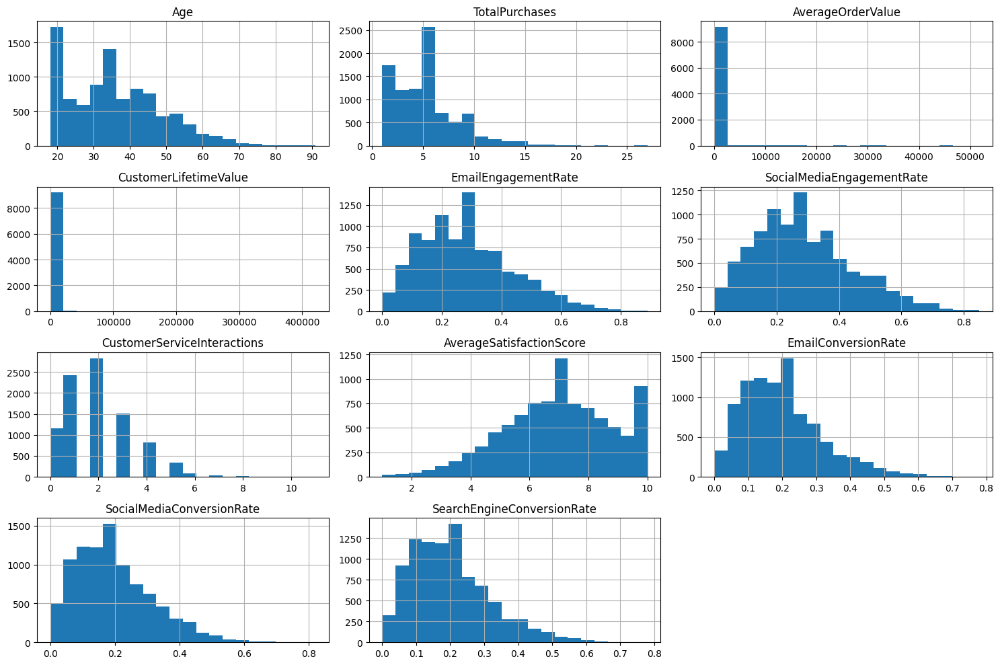

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plotting histograms for all numerical columns
df[numerical_cols].hist(figsize=(15, 10), bins=20)
plt.tight_layout()
plt.show()



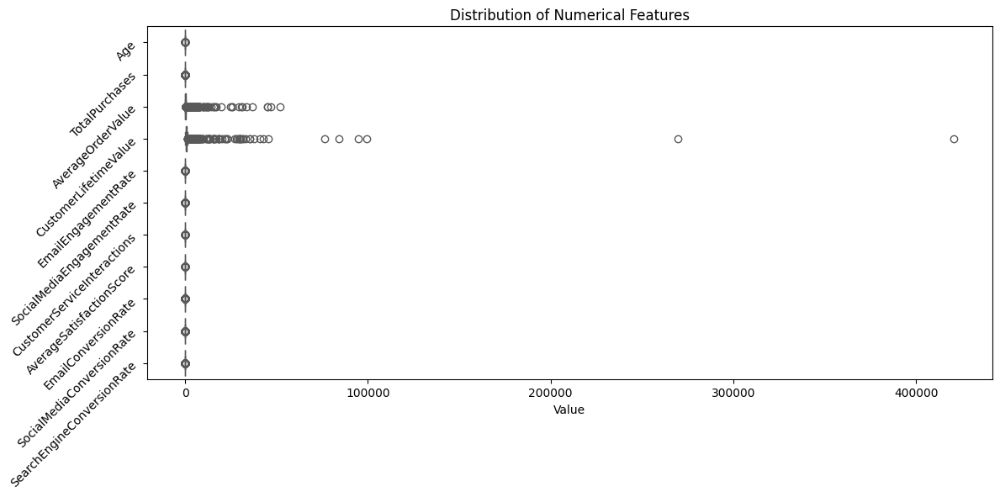

In [ ]:
# Boxplots for key numerical columns (e.g., TotalPurchases, AverageOrderValue)
plt.figure(figsize=(12, 6))  # Adjust figure size for better visibility
sns.boxplot(data=df[numerical_cols], orient="h", palette="Set2")
plt.title("Distribution of Numerical Features")  # Add a title
plt.xlabel("Value")  # Add x-axis label
plt.yticks(rotation=45, ha='right')  # Rotate y-axis labels for readability
plt.tight_layout()  # Adjust layout to prevent overlapping elements
plt.show()

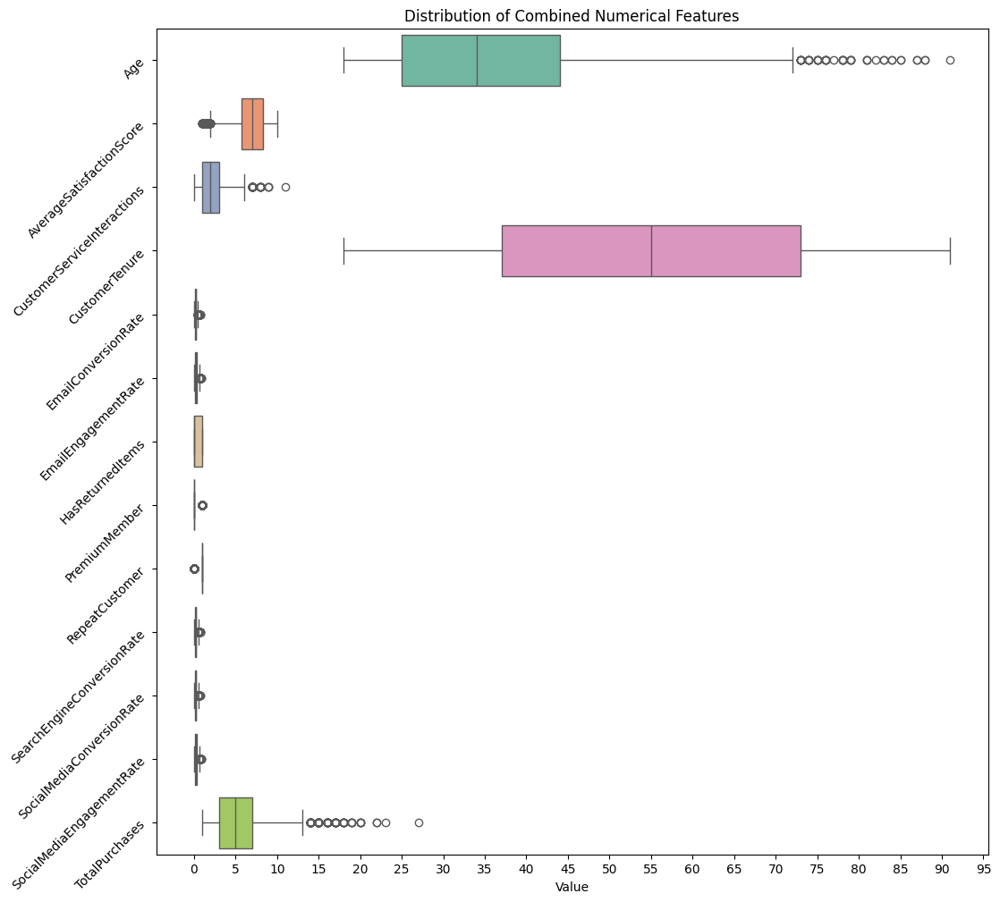

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Define the features to plot, selecting only numerical columns
features_combined = df.select_dtypes(include=['number']).columns.difference(['AverageOrderValue', 'CustomerLifetimeValue']).tolist()

# Set up a larger figure size for better visibility
plt.figure(figsize=(12, 12))

# First subplot for combined numerical features
sns.boxplot(data=df[features_combined], orient="h", palette="Set2")
plt.title("Distribution of Combined Numerical Features")
plt.xlabel("Value")
plt.yticks(rotation=45, ha='right')

# Set the x-axis ticks to increments of 5
# Calculate min and max only for numerical columns
min_val = df[features_combined].min().min()
max_val = df[features_combined].max().max()
plt.xticks(np.arange(min_val, max_val + 5, 5))

plt.show()

In [ ]:
!pip install plotly
import plotly.express as px
from IPython.display import display, HTML

# Frequency of categories in categorical columns (excluding CustomerID)
categorical_cols = df.select_dtypes(include=['object']).columns
categorical_cols = categorical_cols[categorical_cols != 'CustomerID']  # Exclude CustomerID

for col in categorical_cols:
    # Create and display the table of value counts
    value_counts = df[col].value_counts().to_frame()
    value_counts.reset_index(inplace=True)
    value_counts.columns = ['Category', 'Frequency']
    display(HTML(value_counts.to_html()))

    # Create and display the interactive bar chart
    fig = px.bar(
        value_counts,  # Use the value_counts DataFrame for the chart
        x='Category',  # Set x-axis to 'Category'
        y='Frequency',  # Set y-axis to 'Frequency'
        title=f"Frequency of Categories in {col}"
    )
    fig.update_layout(xaxis_tickangle=-45)  # Rotate x-axis labels
    fig.show()

,Category,Frequency
0,Unknown,2404
1,Other,1760
2,Female,1717
3,Male,1685
4,Prefer not to say,1665


,Category,Frequency
0,Unknown,2295
1,Very High,1815
2,Medium,1783
3,Low,1681
4,High,1657


,Category,Frequency
0,France,1132
1,Japan,1120
2,USA,1117
3,Australia,1101
4,Canada,1087
5,Other,1081
6,UK,1075
7,Germany,1073
8,Unknown,445


,Category,Frequency
0,New York,1134
1,Berlin,1124
2,London,1116
3,Tokyo,1113
4,Other,1089
5,Los Angeles,1076
6,Paris,1068
7,Sydney,1062
8,Unknown,449


,Category,Frequency
0,Beauty,2503
1,Sports,991
2,Electronics,984
3,Toys,957
4,Food,955
5,Clothing,952
6,Books,946
7,Home Goods,943


,Category,Frequency
0,Home Goods,2433
1,Electronics,997
2,Clothing,980
3,Sports,979
4,Food,976
5,Toys,960
6,Beauty,958
7,Books,948


,Category,Frequency
0,Unknown,2251
1,Never,1762
2,Low,1749
3,Medium,1739
4,High,1730


,Category,Frequency
0,Beauty & Home Goods,647
1,Electronics & Home Goods,283
2,Beauty & Books,274
3,Beauty & Sports,271
4,Beauty & Clothing,270
5,Beauty & Electronics,267
6,Beauty & Toys,265
7,Food & Home Goods,263
8,Books & Home Goods,262
9,Beauty & Food,261


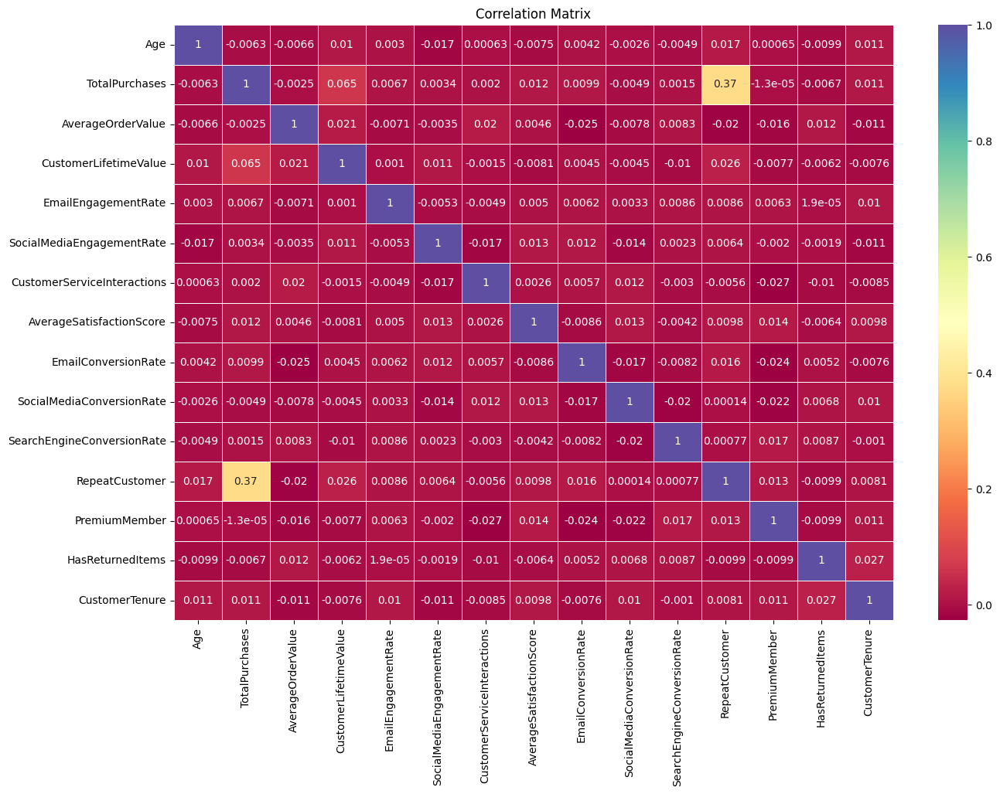

In [ ]:
# Correlation matrix to explore relationships between numerical columns
# Select only numerical features (excluding those with 'object' dtype)
numerical_cols = df.select_dtypes(include=['number']).columns
correlation_matrix = df[numerical_cols].corr()

plt.figure(figsize=(15, 10))
sns.heatmap(correlation_matrix, annot=True, cmap="Spectral", linewidths=0.5)
plt.title('Correlation Matrix')
plt.show()

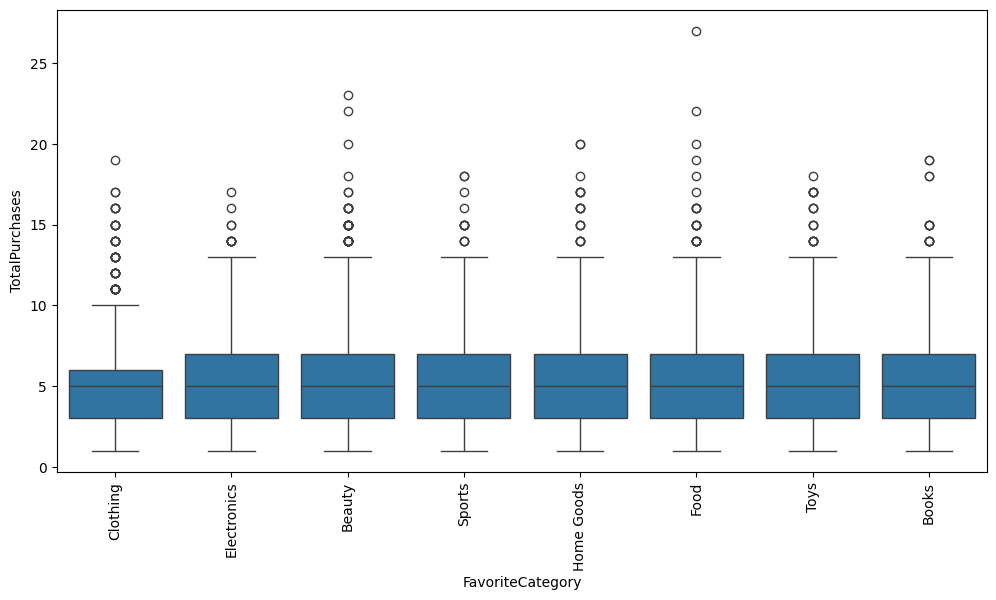

In [ ]:
# Grouping by 'FavoriteCategory' and calculating mean of numerical features
grouped_by_fav_category = df.groupby('FavoriteCategory')[numerical_cols].mean()

# Boxplot for TotalPurchases by FavoriteCategory
plt.figure(figsize=(12, 6))
sns.boxplot(x='FavoriteCategory', y='TotalPurchases', data=df)
plt.xticks(rotation=90)
plt.show()


In [ ]:
# Check for missing values in the dataset
missing_values = df.isnull().sum()
missing_percent = (missing_values / len(df)) * 100
missing_data = pd.DataFrame({"Missing Values": missing_values, "Percentage": missing_percent})
print(missing_data[missing_data['Percentage'] > 0])


Empty DataFrame
Columns: [Missing Values, Percentage]
Index: []


In [ ]:
# Add import statement at the beginning of your code (e.g., in cell ipython-input-48-484bce2eeb5e)
import numpy as np

from scipy import stats

# Calculate Z-scores for numerical features
z_scores = stats.zscore(df[numerical_cols])
abs_z_scores = np.abs(z_scores)

# Identify rows with Z-scores > 3 (potential outliers)
outliers = (abs_z_scores > 3).all(axis=1)
print(f"Number of outliers: {outliers.sum()}")

Number of outliers: 0


Age                            0.53
TotalPurchases                 1.10
AverageOrderValue             22.53
CustomerLifetimeValue         53.97
EmailEngagementRate            0.62
SocialMediaEngagementRate      0.57
CustomerServiceInteractions    0.78
AverageSatisfactionScore      -0.29
EmailConversionRate            0.90
SocialMediaConversionRate      0.83
SearchEngineConversionRate     0.87
RepeatCustomer                -3.12
PremiumMember                  1.24
HasReturnedItems               0.70
CustomerTenure                -0.00
dtype: float64


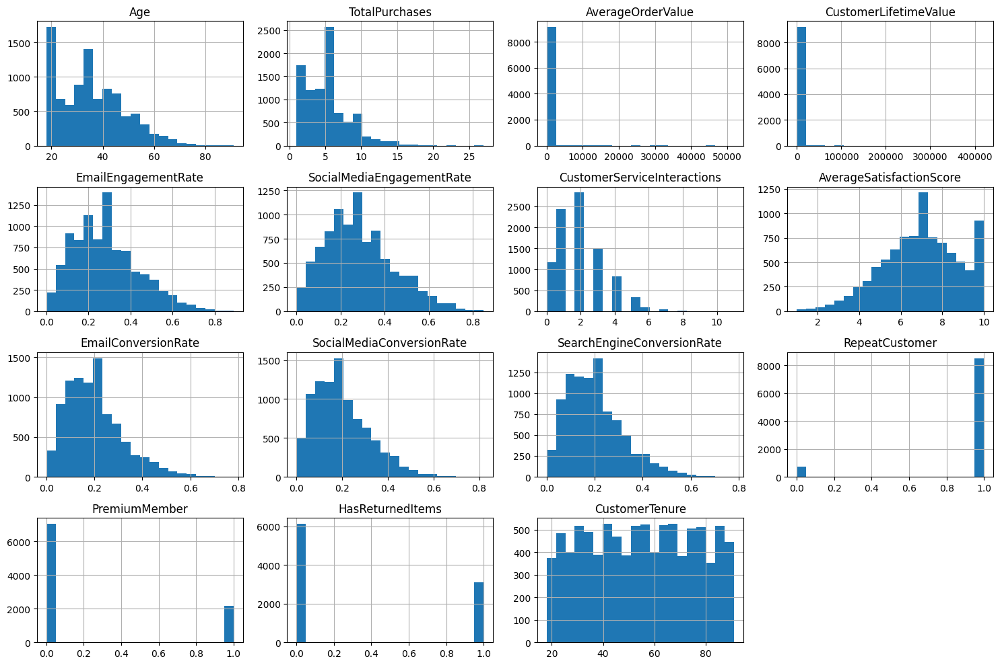

In [ ]:
# Checking skewness of numerical features
skewness = df[numerical_cols].skew()
print(skewness)

# Visualize skewness
df[numerical_cols].hist(figsize=(15, 10), bins=20)
plt.tight_layout()
plt.show()


In [ ]:
n_samples, n_features = df.shape
ratio = n_features / n_samples
print(f"Feature-to-Sample Ratio: {ratio}")


Feature-to-Sample Ratio: 0.0025999350016249595


In [ ]:
sparsity = (df != 0).mean().mean()
print(f"Sparsity of the dataset: {sparsity:.2f}")


Sparsity of the dataset: 0.93


Dataset Shape: (9231, 24)
Feature-to-Sample Ratio: 0.0025999350016249595
The dataset is not high-dimensional.
Sparsity of the dataset: 0.93


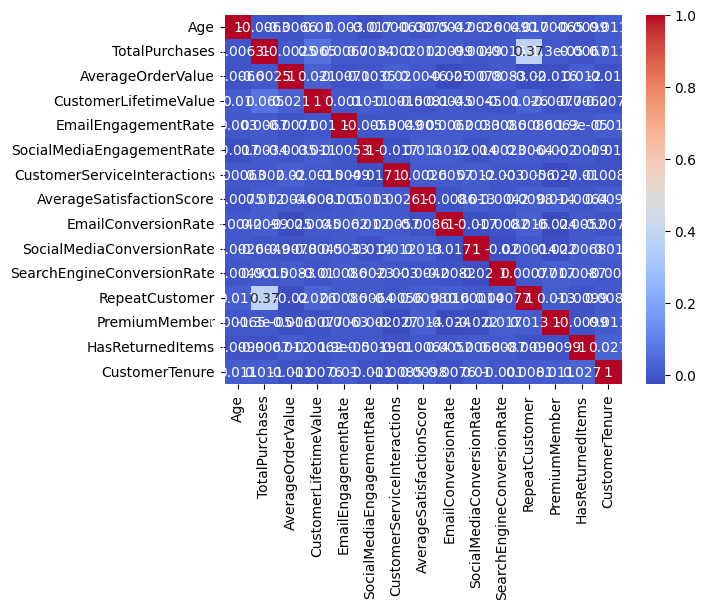

In [ ]:
n_samples, n_features = df.shape
ratio = n_features / n_samples
print(f"Dataset Shape: {df.shape}")
print(f"Feature-to-Sample Ratio: {ratio}")

# Check if the feature-to-sample ratio is greater than 1
if ratio > 1:
    print("The dataset is likely high-dimensional.")
else:
    print("The dataset is not high-dimensional.")

# Check for sparsity
sparsity = (df != 0).mean().mean()
print(f"Sparsity of the dataset: {sparsity:.2f}")

numerical_cols = df.select_dtypes(include=['number']).columns
correlation_matrix = df[numerical_cols].corr()
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm")
plt.show()



## **CLUSTERING ANALYSIS WITHOUT PCA**

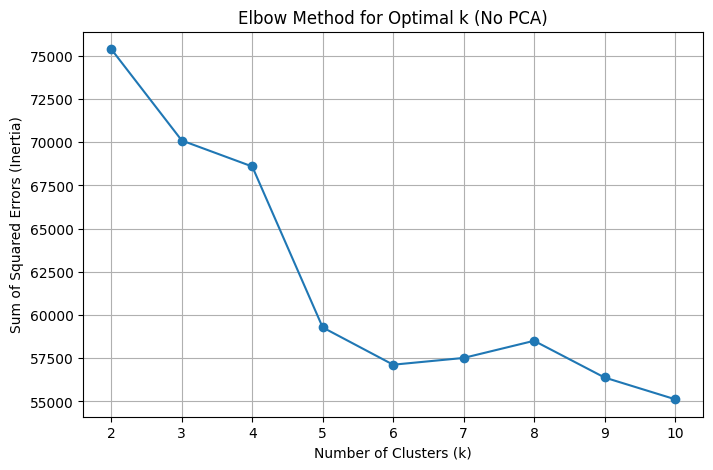


🔍 Clustering Evaluation for k=4 (No PCA)

📊 KMeans Cluster Counts (No PCA, k=4):


,0,Count
0,1,4026
1,2,2405
2,3,719
3,4,2081



📊 Agglomerative Cluster Counts (No PCA, k=4, linkage=ward):


,0,Count
0,1,8406
1,2,204
2,3,86
3,4,535



📈 Evaluation Scores for k=4 (No PCA):


,Method,k,Silhouette,DB,CH,Composite
0,KMeans-NoPCA,4,0.06,2.83,1164.45,-1.61
1,Agglo-NoPCA-ward,4,0.29,1.35,1456.01,0.39


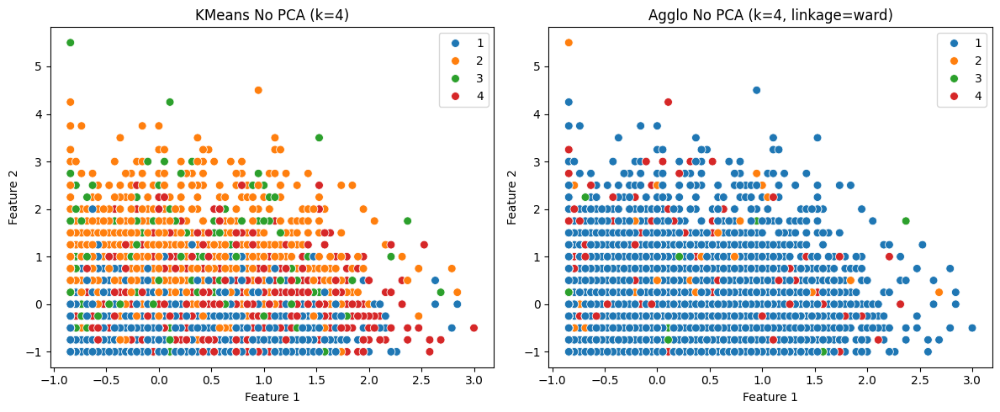


🔍 Clustering Evaluation for k=5 (No PCA)

📊 KMeans Cluster Counts (No PCA, k=5):


,0,Count
0,1,3987
1,2,2305
2,3,650
3,4,111
4,5,2178



📊 Agglomerative Cluster Counts (No PCA, k=5, linkage=ward):


,0,Count
0,1,204
1,2,6422
2,3,86
3,4,535
4,5,1984



📈 Evaluation Scores for k=5 (No PCA):


,Method,k,Silhouette,DB,CH,Composite
0,KMeans-NoPCA,5,0.07,2.42,1361.46,-0.99
1,Agglo-NoPCA-ward,5,0.07,2.41,1224.52,-1.12


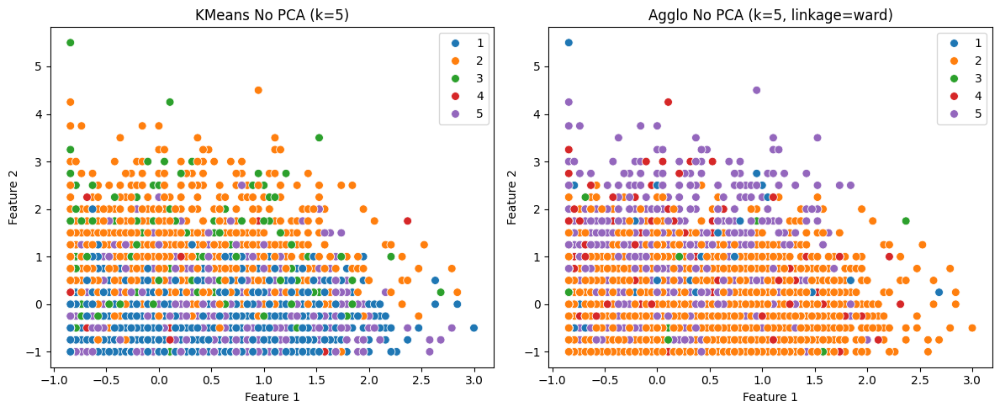


🔍 Clustering Evaluation for k=6 (No PCA)

📊 KMeans Cluster Counts (No PCA, k=6):


,0,Count
0,1,2634
1,2,1855
2,3,556
3,4,111
4,5,1875
5,6,2200



📊 Agglomerative Cluster Counts (No PCA, k=6, linkage=ward):


,0,Count
0,1,6422
1,2,1984
2,3,86
3,4,535
4,5,137
5,6,67



📈 Evaluation Scores for k=6 (No PCA):


,Method,k,Silhouette,DB,CH,Composite
0,KMeans-NoPCA,6,0.06,2.41,1204.01,-1.14
1,Agglo-NoPCA-ward,6,0.07,2.17,1052.14,-1.05


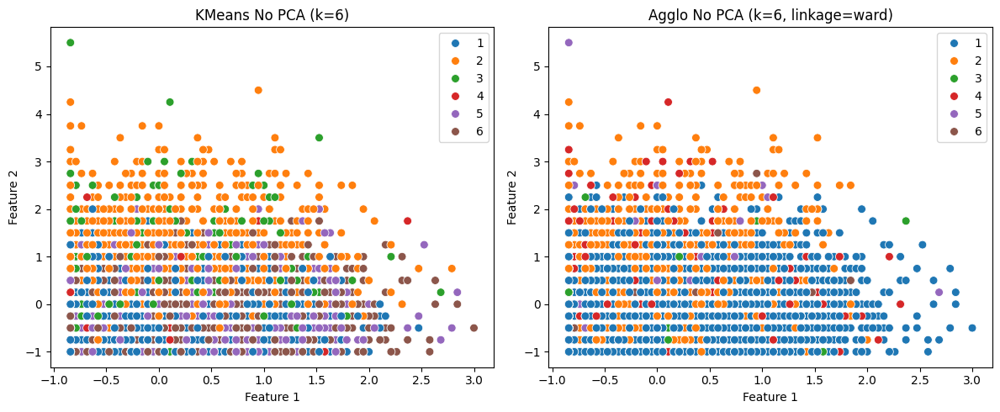


🔍 Clustering Evaluation for k=7 (No PCA)

📊 KMeans Cluster Counts (No PCA, k=7):


,0,Count
0,1,2357
1,2,1339
2,3,435
3,4,129
4,5,1245
5,6,1761
6,7,1965



📊 Agglomerative Cluster Counts (No PCA, k=7, linkage=ward):


,0,Count
0,1,5205
1,2,1984
2,3,1217
3,4,535
4,5,137
5,6,67
6,7,86



📈 Evaluation Scores for k=7 (No PCA):


,Method,k,Silhouette,DB,CH,Composite
0,KMeans-NoPCA,7,0.06,2.41,1043.42,-1.31
1,Agglo-NoPCA-ward,7,0.04,2.38,937.20,-1.40


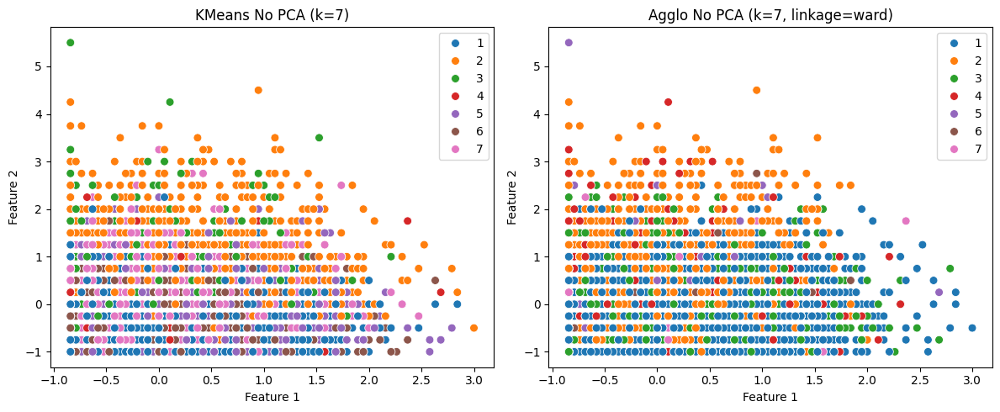


🔍 Clustering Evaluation for k=8 (No PCA)

📊 KMeans Cluster Counts (No PCA, k=8):


,0,Count
0,1,998
1,2,235
2,3,1135
3,4,1789
4,5,713
5,6,1260
6,7,1781
7,8,1320



📊 Agglomerative Cluster Counts (No PCA, k=8, linkage=ward):


,0,Count
0,1,1984
1,2,4729
2,3,1217
3,4,535
4,5,137
5,6,67
6,7,86
7,8,476



📈 Evaluation Scores for k=8 (No PCA):


,Method,k,Silhouette,DB,CH,Composite
0,KMeans-NoPCA,8,0.05,2.58,830.86,-1.70
1,Agglo-NoPCA-ward,8,0.04,2.40,850.93,-1.51


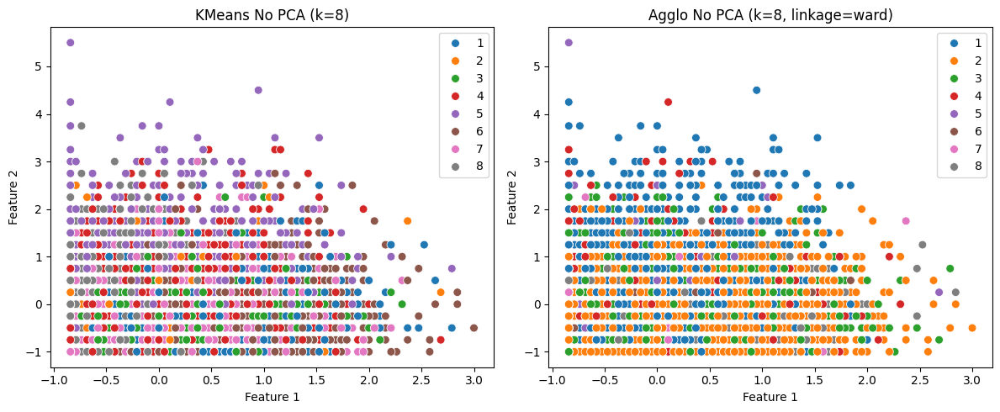


📋 Full Evaluation Metrics Summary (No PCA):


,Method,k,Silhouette,DB,CH,Composite
1,Agglo-NoPCA-ward,4,0.29,1.35,1456.01,0.39
0,KMeans-NoPCA,4,0.06,2.83,1164.45,-1.61
3,Agglo-NoPCA-ward,5,0.07,2.41,1224.52,-1.12
2,KMeans-NoPCA,5,0.07,2.42,1361.46,-0.99
5,Agglo-NoPCA-ward,6,0.07,2.17,1052.14,-1.05
4,KMeans-NoPCA,6,0.06,2.41,1204.01,-1.14
7,Agglo-NoPCA-ward,7,0.04,2.38,937.20,-1.40
6,KMeans-NoPCA,7,0.06,2.41,1043.42,-1.31
9,Agglo-NoPCA-ward,8,0.04,2.40,850.93,-1.51
8,KMeans-NoPCA,8,0.05,2.58,830.86,-1.70



📝 Best Score Comparison Summary (No PCA):


,Method,k,Silhouette,DB,CH,Composite
2,KMeans-NoPCA,5,0.07,2.42,1361.46,-0.99
1,Agglo-NoPCA-ward,4,0.29,1.35,1456.01,0.39


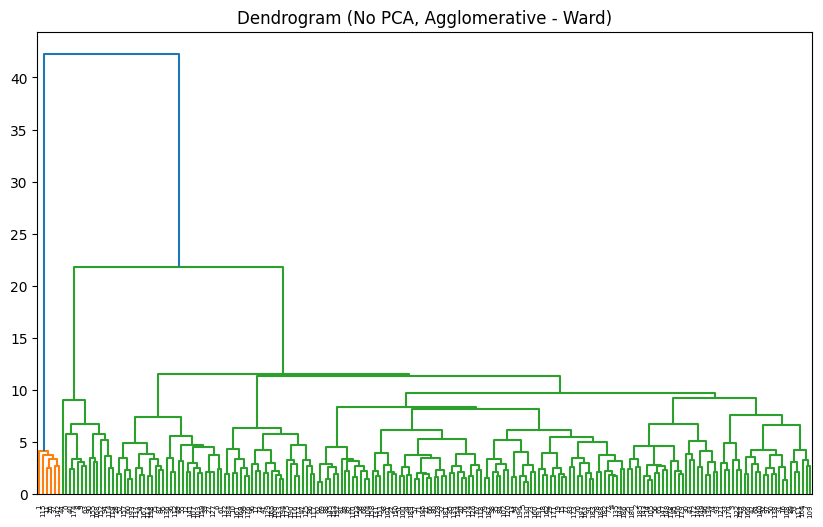

In [ ]:
# -------------------------------------------
# CLUSTERING WITHOUT PCA
# -------------------------------------------

# 1. Imports
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import MiniBatchKMeans, AgglomerativeClustering
from sklearn.metrics import silhouette_score, davies_bouldin_score, calinski_harabasz_score
from scipy.cluster.hierarchy import dendrogram, linkage
from scipy.stats.mstats import winsorize
from sklearn.preprocessing import RobustScaler
from sklearn.decomposition import PCA

# Step 1: Data Preparation (Moved from cell SfDqCa1C7-Dx)
df_processed = df.copy()

# Winsorization to cap outliers
for col in ['AverageOrderValue', 'CustomerLifetimeValue']:
    df_processed[col] = winsorize(df_processed[col], limits=[0.01, 0.01])

features = [
    'Age', 'TotalPurchases', 'AverageOrderValue', 'CustomerLifetimeValue',
    'EmailEngagementRate', 'SocialMediaEngagementRate',
    'CustomerServiceInteractions', 'AverageSatisfactionScore',
    'EmailConversionRate', 'SocialMediaConversionRate',
    'SearchEngineConversionRate', 'RepeatCustomer',
    'PremiumMember', 'HasReturnedItems', 'CustomerTenure'
]

# Step 2: Feature Scaling (Moved from cell SfDqCa1C7-Dx)
scaler = RobustScaler()
df_scaled = scaler.fit_transform(df_processed[features])




# 2. Evaluation Function
def evaluate_clustering(X, labels):
    sil = silhouette_score(X, labels)
    db = davies_bouldin_score(X, labels)
    ch = calinski_harabasz_score(X, labels)
    comp = sil - db + (ch / 1000)
    return sil, db, ch, comp

# 3. Elbow Method for KMeans (no PCA)
sse_no_pca = []
k_range = range(2, 11)
for k in k_range:
    kmeans = MiniBatchKMeans(n_clusters=k, batch_size=100, random_state=42)
    kmeans.fit(df_scaled)
    sse_no_pca.append(kmeans.inertia_)

plt.figure(figsize=(8, 5))
plt.plot(k_range, sse_no_pca, marker='o')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Sum of Squared Errors (Inertia)')
plt.title('Elbow Method for Optimal k (No PCA)')
plt.grid(True)
plt.show()

# 4. Clustering Evaluation & Visualisation (k = 4 to 8)
all_results_no_pca = []

for k in range(4, 9):
    print(f"\n{'='*60}\n🔍 Clustering Evaluation for k={k} (No PCA)\n{'='*60}")
    result_k = []

    # --- MiniBatch KMeans ---
    kmeans = MiniBatchKMeans(n_clusters=k, batch_size=100, random_state=42)
    kmeans_labels = kmeans.fit_predict(df_scaled) + 1
    df_processed[f'Cluster_KMeans_NoPCA_k{k}'] = kmeans_labels
    sil_km, db_km, ch_km, comp_km = evaluate_clustering(df_scaled, kmeans_labels)
    result_k.append({
        'Method': 'KMeans-NoPCA', 'k': k,
        'Silhouette': sil_km, 'DB': db_km, 'CH': ch_km, 'Composite': comp_km
    })

    print(f"\n📊 KMeans Cluster Counts (No PCA, k={k}):")
    display(pd.DataFrame(kmeans_labels).value_counts().sort_index().rename('Count').reset_index().rename(columns={'index': 'Cluster'}))

    # --- Agglomerative Clustering ---
    linkage_method = 'ward'
    ag_model = AgglomerativeClustering(n_clusters=k, linkage=linkage_method)
    ag_labels = ag_model.fit_predict(df_scaled) + 1
    df_processed[f'Cluster_Agglo_NoPCA_k{k}'] = ag_labels
    sil_ag, db_ag, ch_ag, comp_ag = evaluate_clustering(df_scaled, ag_labels)
    result_k.append({
        'Method': f'Agglo-NoPCA-{linkage_method}', 'k': k,
        'Silhouette': sil_ag, 'DB': db_ag, 'CH': ch_ag, 'Composite': comp_ag
    })

    print(f"\n📊 Agglomerative Cluster Counts (No PCA, k={k}, linkage={linkage_method}):")
    display(pd.DataFrame(ag_labels).value_counts().sort_index().rename('Count').reset_index().rename(columns={'index': 'Cluster'}))

    # Store results
    df_k = pd.DataFrame(result_k)
    all_results_no_pca.extend(result_k)
    print(f"\n📈 Evaluation Scores for k={k} (No PCA):")
    display(df_k)

    # Side-by-side scatter plots (first 2 scaled features)
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    sns.scatterplot(x=df_scaled[:, 0], y=df_scaled[:, 1], hue=kmeans_labels, palette='tab10', s=50)
    plt.title(f"KMeans No PCA (k={k})")
    plt.xlabel('Feature 1'); plt.ylabel('Feature 2')

    plt.subplot(1, 2, 2)
    sns.scatterplot(x=df_scaled[:, 0], y=df_scaled[:, 1], hue=ag_labels, palette='tab10', s=50)
    plt.title(f"Agglo No PCA (k={k}, linkage={linkage_method})")
    plt.xlabel('Feature 1'); plt.ylabel('Feature 2')

    plt.tight_layout()
    plt.show()

# 5. Summary Table
df_results_no_pca = pd.DataFrame(all_results_no_pca)
print("\n📋 Full Evaluation Metrics Summary (No PCA):")
display(df_results_no_pca.sort_values(by=['k', 'Method']))

# 6. Best Clustering Without PCA
best_kmeans_no_pca = df_results_no_pca[df_results_no_pca['Method'] == 'KMeans-NoPCA'].sort_values(by='Composite', ascending=False).iloc[0]
best_agglo_no_pca = df_results_no_pca[df_results_no_pca['Method'].str.contains('Agglo')].sort_values(by='Composite', ascending=False).iloc[0]

summary_table_no_pca = pd.DataFrame([best_kmeans_no_pca, best_agglo_no_pca])
print("\n📝 Best Score Comparison Summary (No PCA):")
display(summary_table_no_pca)

# 7. Dendrogram (Optional, if Agglo best)
if 'Agglo' in best_agglo_no_pca['Method']:
    sample_data = pd.DataFrame(df_scaled).sample(n=200, random_state=42)
    linked = linkage(sample_data, method='ward')

    plt.figure(figsize=(10, 6))
    dendrogram(linked)
    plt.title("Dendrogram (No PCA, Agglomerative - Ward)")
    plt.show()

# **#ANALYSIS--CLUSTERING WITH PCA**





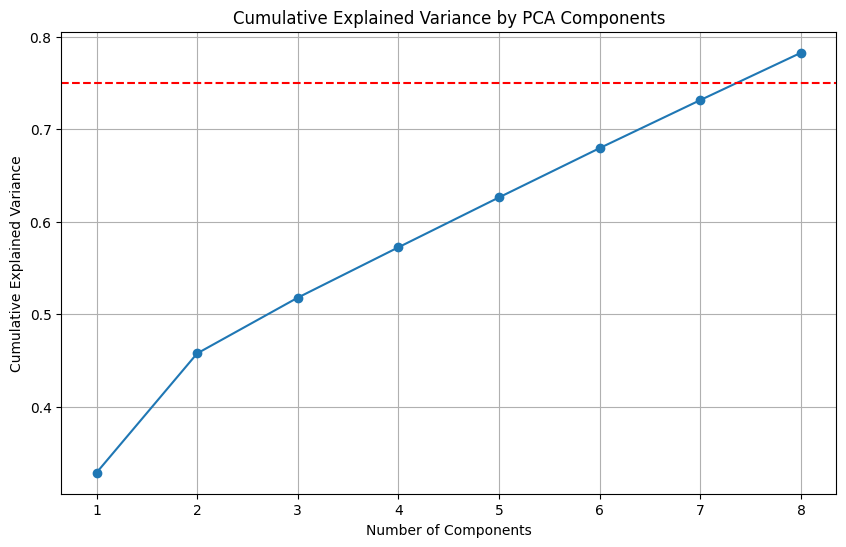


📊 PCA Eigenvalues and Variance Explained:


,Principal Component,Eigenvalue,% Variance Explained,Cumulative % Variance
0,PC1,3.35,32.89,32.89
1,PC2,1.31,12.89,45.78
2,PC3,0.61,6.02,51.80
3,PC4,0.55,5.44,57.24
4,PC5,0.55,5.39,62.64
5,PC6,0.54,5.32,67.96
6,PC7,0.53,5.19,73.15
7,PC8,0.52,5.11,78.26


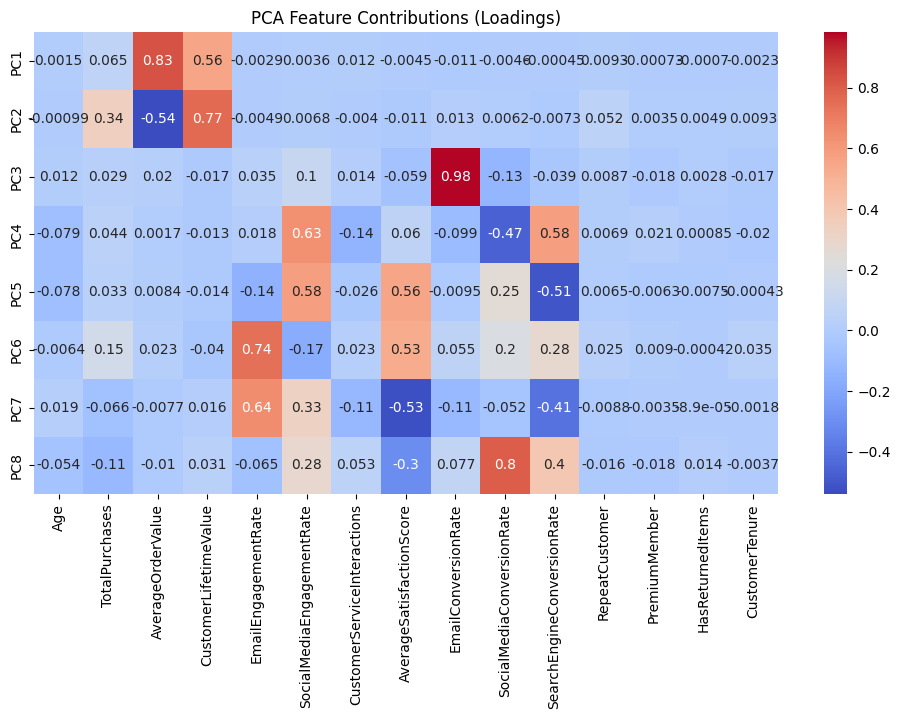

In [ ]:
# =============================== #
# 📌 Part 1: PCA (Principal Component Analysis)
# =============================== #

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from scipy.stats.mstats import winsorize
from sklearn.preprocessing import RobustScaler
from sklearn.decomposition import PCA

# Step 1: Data Preparation
df_processed = df.copy()

# Winsorization to cap outliers
for col in ['AverageOrderValue', 'CustomerLifetimeValue']:
    df_processed[col] = winsorize(df_processed[col], limits=[0.01, 0.01])

features = [
    'Age', 'TotalPurchases', 'AverageOrderValue', 'CustomerLifetimeValue',
    'EmailEngagementRate', 'SocialMediaEngagementRate',
    'CustomerServiceInteractions', 'AverageSatisfactionScore',
    'EmailConversionRate', 'SocialMediaConversionRate',
    'SearchEngineConversionRate', 'RepeatCustomer',
    'PremiumMember', 'HasReturnedItems', 'CustomerTenure'
]

# Step 2: Feature Scaling
scaler = RobustScaler()
df_scaled = scaler.fit_transform(df_processed[features])

# Step 3: Apply PCA (retain 75% of variance)
pca = PCA(n_components=0.75)
pca_data = pca.fit_transform(df_scaled)

# Step 4: Explained Variance Plot
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(pca.explained_variance_ratio_)+1), np.cumsum(pca.explained_variance_ratio_), marker='o')
plt.axhline(y=0.75, color='r', linestyle='--')
plt.title('Cumulative Explained Variance by PCA Components')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.grid(True)
plt.show()

# Step 5: Eigenvalues and Variance Explained
eigenvalues = pca.explained_variance_
explained_variance_ratio = pca.explained_variance_ratio_
cumulative_variance = np.cumsum(explained_variance_ratio)

eigenvalue_df = pd.DataFrame({
    'Principal Component': [f'PC{i+1}' for i in range(len(eigenvalues))],
    'Eigenvalue': np.round(eigenvalues, 4),
    '% Variance Explained': np.round(explained_variance_ratio * 100, 2),
    'Cumulative % Variance': np.round(cumulative_variance * 100, 2)
})
print("\n📊 PCA Eigenvalues and Variance Explained:")
display(eigenvalue_df)

# Step 6: PCA Loadings
pca_loadings_df = pd.DataFrame(
    pca.components_,
    columns=features,
    index=[f'PC{i+1}' for i in range(pca.n_components_)]
)

plt.figure(figsize=(12, 6))
sns.heatmap(pca_loadings_df, cmap="coolwarm", annot=True)
plt.title("PCA Feature Contributions (Loadings)")
plt.show()


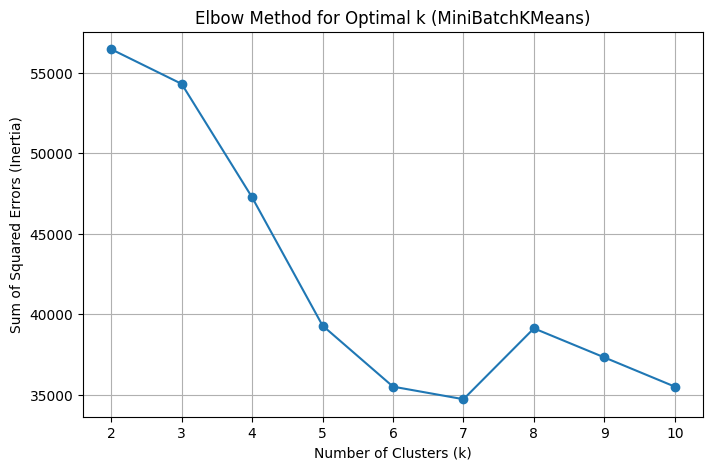


🔍 Clustering Evaluation for k=4

📊 KMeans Cluster Counts (k=4):


,0,Count
0,1,3241
1,2,3397
2,3,2094
3,4,499



📊 Agglomerative Cluster Counts (k=4, linkage=ward):


,0,Count
0,1,8148
1,2,218
2,3,97
3,4,768



📈 Evaluation Scores for k=4:


,Method,k,Silhouette,DB,CH,Composite
0,KMeans,4,0.08,2.27,1780.89,-0.40
1,Agglo-ward,4,0.32,1.31,2153.04,1.16


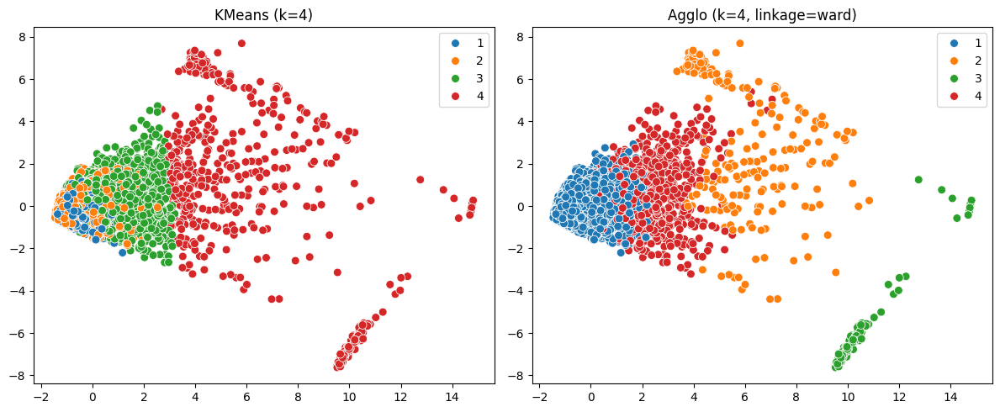


🔍 Clustering Evaluation for k=5

📊 KMeans Cluster Counts (k=5):


,0,Count
0,1,2322
1,2,2553
2,3,114
3,4,539
4,5,3703



📊 Agglomerative Cluster Counts (k=5, linkage=ward):


,0,Count
0,1,2581
1,2,218
2,3,97
3,4,768
4,5,5567



📈 Evaluation Scores for k=5:


,Method,k,Silhouette,DB,CH,Composite
0,KMeans,5,0.10,1.93,2024.39,0.19
1,Agglo-ward,5,0.09,2.25,1805.63,-0.36


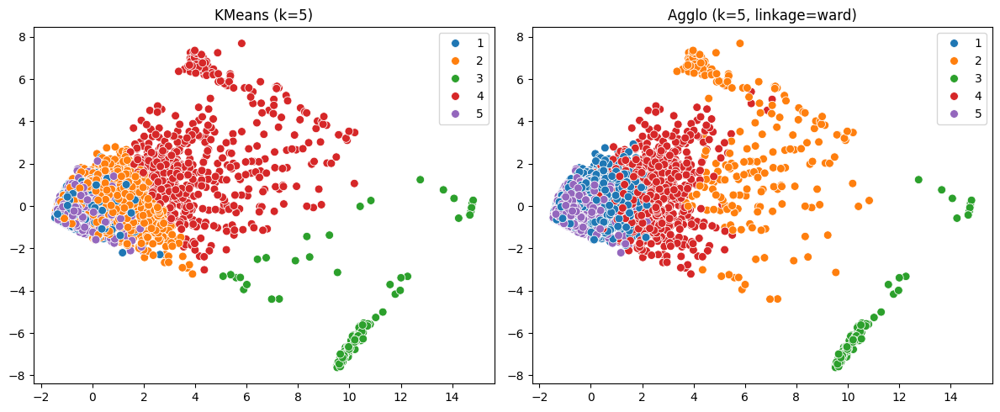


🔍 Clustering Evaluation for k=6

📊 KMeans Cluster Counts (k=6):


,0,Count
0,1,2036
1,2,1801
2,3,113
3,4,300
4,5,3435
5,6,1546



📊 Agglomerative Cluster Counts (k=6, linkage=ward):


,0,Count
0,1,218
1,2,5567
2,3,97
3,4,768
4,5,1803
5,6,778



📈 Evaluation Scores for k=6:


,Method,k,Silhouette,DB,CH,Composite
0,KMeans,6,0.11,1.79,1985.08,0.31
1,Agglo-ward,6,0.08,2.11,1600.23,-0.43


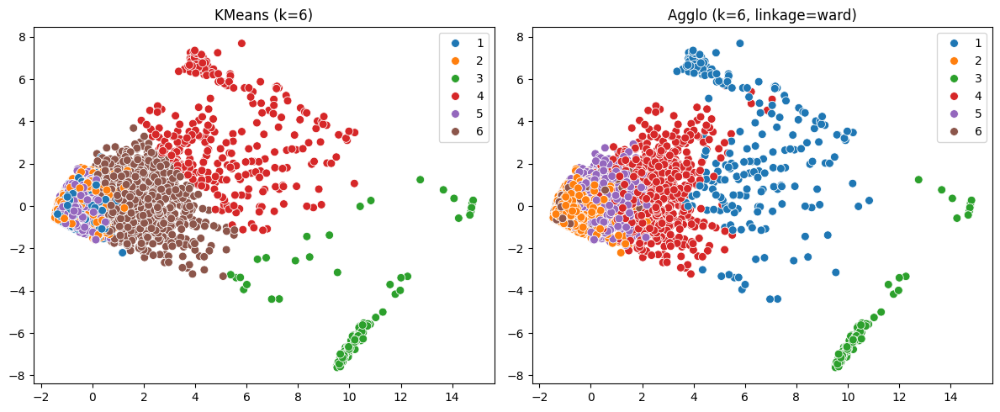


🔍 Clustering Evaluation for k=7

📊 KMeans Cluster Counts (k=7):


,0,Count
0,1,1459
1,2,1729
2,3,121
3,4,195
4,5,2802
5,6,2040
6,7,885



📊 Agglomerative Cluster Counts (k=7, linkage=ward):


,0,Count
0,1,5567
1,2,768
2,3,97
3,4,99
4,5,1803
5,6,778
6,7,119



📈 Evaluation Scores for k=7:


,Method,k,Silhouette,DB,CH,Composite
0,KMeans,7,0.11,1.76,1788.03,0.14
1,Agglo-ward,7,0.08,1.95,1443.59,-0.43


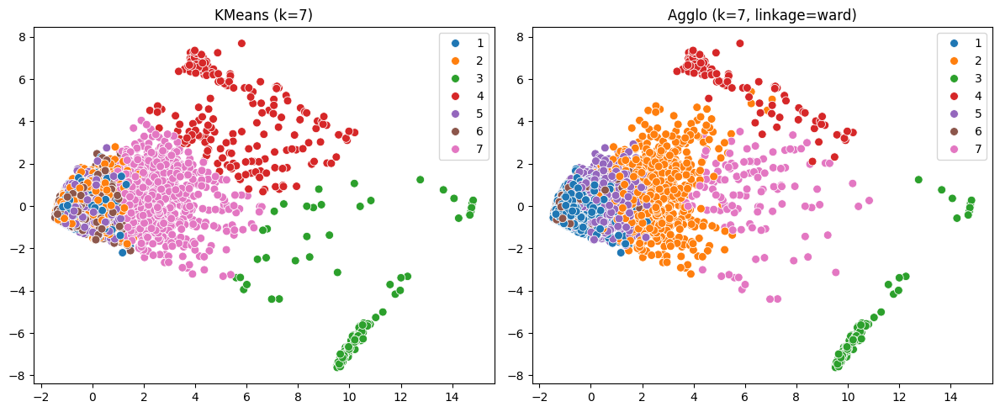


🔍 Clustering Evaluation for k=8

📊 KMeans Cluster Counts (k=8):


,0,Count
0,1,1028
1,2,1191
2,3,1067
3,4,258
4,5,1194
5,6,1890
6,7,1496
7,8,1107



📊 Agglomerative Cluster Counts (k=8, linkage=ward):


,0,Count
0,1,3491
1,2,2076
2,3,97
3,4,768
4,5,1803
5,6,778
6,7,119
7,8,99



📈 Evaluation Scores for k=8:


,Method,k,Silhouette,DB,CH,Composite
0,KMeans,8,0.08,1.87,1234.60,-0.55
1,Agglo-ward,8,0.06,2.14,1334.13,-0.75


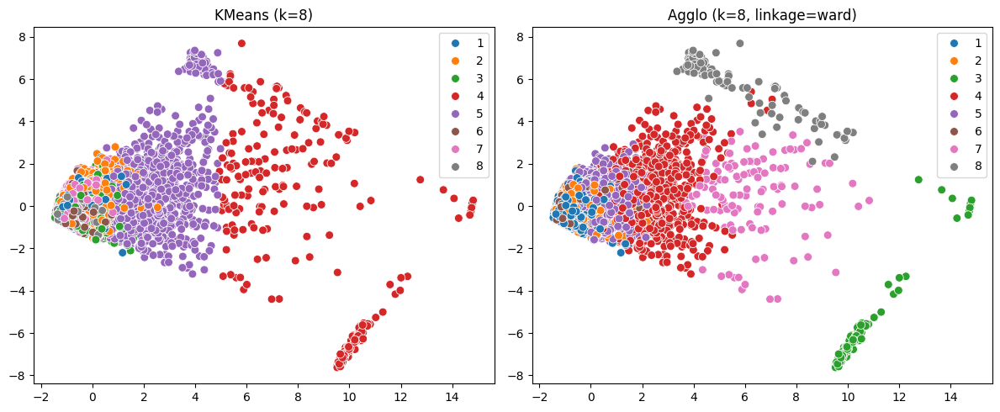


📋 Full Evaluation Metrics Summary:


,Method,k,Silhouette,DB,CH,Composite
1,Agglo-ward,4,0.32,1.31,2153.04,1.16
0,KMeans,4,0.08,2.27,1780.89,-0.40
3,Agglo-ward,5,0.09,2.25,1805.63,-0.36
2,KMeans,5,0.10,1.93,2024.39,0.19
5,Agglo-ward,6,0.08,2.11,1600.23,-0.43
4,KMeans,6,0.11,1.79,1985.08,0.31
7,Agglo-ward,7,0.08,1.95,1443.59,-0.43
6,KMeans,7,0.11,1.76,1788.03,0.14
9,Agglo-ward,8,0.06,2.14,1334.13,-0.75
8,KMeans,8,0.08,1.87,1234.60,-0.55



📝 Best Score Comparison Summary:


,Method,k,Silhouette,DB,CH,Composite
0,KMeans,6,0.11,1.79,1985.08,0.31
1,Agglo-ward,4,0.32,1.31,2153.04,1.16



✅ Best overall clustering method: Agglo-ward with k=4


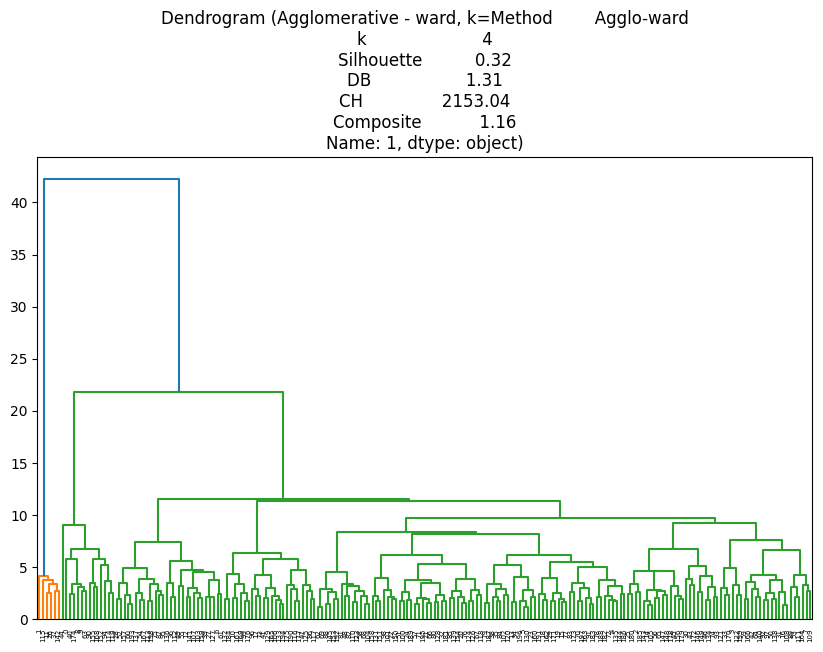

In [ ]:
# -------------------------------------------
# PART 2: FINAL CLUSTERING ANALYSIS WITH EVALUATION
# -------------------------------------------

# 1. Imports
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import MiniBatchKMeans, AgglomerativeClustering
from sklearn.metrics import silhouette_score, davies_bouldin_score, calinski_harabasz_score
from scipy.cluster.hierarchy import dendrogram, linkage

# 2. Evaluation Function
def evaluate_clustering(X, labels):
    sil = silhouette_score(X, labels)
    db = davies_bouldin_score(X, labels)
    ch = calinski_harabasz_score(X, labels)
    comp = sil - db + (ch / 1000)
    return sil, db, ch, comp

# 3. Elbow Method for KMeans
sse = []
k_range = range(2, 11)
for k in k_range:
    kmeans = MiniBatchKMeans(n_clusters=k, batch_size=100, random_state=42)
    kmeans.fit(pca_data)
    sse.append(kmeans.inertia_)

plt.figure(figsize=(8, 5))
plt.plot(k_range, sse, marker='o')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Sum of Squared Errors (Inertia)')
plt.title('Elbow Method for Optimal k (MiniBatchKMeans)')
plt.grid(True)
plt.show()

# 4. Clustering Evaluation & Visualisation (k = 4 to 8)
all_results = []

for k in range(4, 9):
    print(f"\n{'='*60}\n🔍 Clustering Evaluation for k={k}\n{'='*60}")
    result_k = []

    # --- KMeans ---
    kmeans = MiniBatchKMeans(n_clusters=k, batch_size=100, random_state=42)
    kmeans_labels = kmeans.fit_predict(pca_data) + 1
    df_processed[f'Cluster_KMeans_k{k}'] = kmeans_labels
    sil_km, db_km, ch_km, comp_km = evaluate_clustering(pca_data, kmeans_labels)
    result_k.append({
        'Method': 'KMeans', 'k': k,
        'Silhouette': sil_km, 'DB': db_km, 'CH': ch_km, 'Composite': comp_km
    })

    # Cluster counts
    print(f"\n📊 KMeans Cluster Counts (k={k}):")
    display(pd.DataFrame(kmeans_labels).value_counts().sort_index().rename('Count').reset_index().rename(columns={'index': 'Cluster'}))

    # --- Agglomerative with Ward Linkage ---
    linkage_method = 'ward'
    ag_model = AgglomerativeClustering(n_clusters=k, linkage=linkage_method)
    ag_labels = ag_model.fit_predict(pca_data) + 1
    df_processed[f'Cluster_Agglo_k{k}'] = ag_labels
    sil_ag, db_ag, ch_ag, comp_ag = evaluate_clustering(pca_data, ag_labels)
    result_k.append({
        'Method': f'Agglo-{linkage_method}', 'k': k,
        'Silhouette': sil_ag, 'DB': db_ag, 'CH': ch_ag, 'Composite': comp_ag
    })

    print(f"\n📊 Agglomerative Cluster Counts (k={k}, linkage={linkage_method}):")
    display(pd.DataFrame(ag_labels).value_counts().sort_index().rename('Count').reset_index().rename(columns={'index': 'Cluster'}))

    # Show evaluation table for this k
    df_k = pd.DataFrame(result_k)
    all_results.extend(result_k)
    print(f"\n📈 Evaluation Scores for k={k}:")
    display(df_k)

    # --- Side-by-Side Scatter Plot ---
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    sns.scatterplot(x=pca_data[:, 0], y=pca_data[:, 1], hue=kmeans_labels, palette='tab10', s=50)
    plt.title(f"KMeans (k={k})")

    plt.subplot(1, 2, 2)
    sns.scatterplot(x=pca_data[:, 0], y=pca_data[:, 1], hue=ag_labels, palette='tab10', s=50)
    plt.title(f"Agglo (k={k}, linkage={linkage_method})")

    plt.tight_layout()
    plt.show()

# 5. Evaluation Summary Table
df_results = pd.DataFrame(all_results)
print("\n📋 Full Evaluation Metrics Summary:")
display(df_results.sort_values(by=['k', 'Method']))

# 6. Best Score Comparison Summary (in table)
best_kmeans = df_results[df_results['Method'] == 'KMeans'].sort_values(by='Composite', ascending=False).iloc[0]
best_agglo = df_results[df_results['Method'].str.contains('Agglo')].sort_values(by='Composite', ascending=False).iloc[0]

summary_table = pd.DataFrame([
    {
        'Method': best_kmeans['Method'],
        'k': best_kmeans['k'],
        'Silhouette': best_kmeans['Silhouette'],
        'DB': best_kmeans['DB'],
        'CH': best_kmeans['CH'],
        'Composite': best_kmeans['Composite']
    },
    {
        'Method': best_agglo['Method'],
        'k': best_agglo['k'],
        'Silhouette': best_agglo['Silhouette'],
        'DB': best_agglo['DB'],
        'CH': best_agglo['CH'],
        'Composite': best_agglo['Composite']
    }
])
print("\n📝 Best Score Comparison Summary:")
display(summary_table)

# Best model overall
best_overall = best_kmeans if best_kmeans['Composite'] > best_agglo['Composite'] else best_agglo
print(f"\n✅ Best overall clustering method: {best_overall['Method']} with k={best_overall['k']}")


# 8. Dendrogram
if 'Agglo' in best_overall['Method']:
    sample_data = pd.DataFrame(df_scaled).sample(n=200, random_state=42)
    linked = linkage(sample_data, method='ward')

    plt.figure(figsize=(10, 6))
    dendrogram(linked)
    plt.title(f"Dendrogram (Agglomerative - ward, k={best_agglo})")
    plt.show()



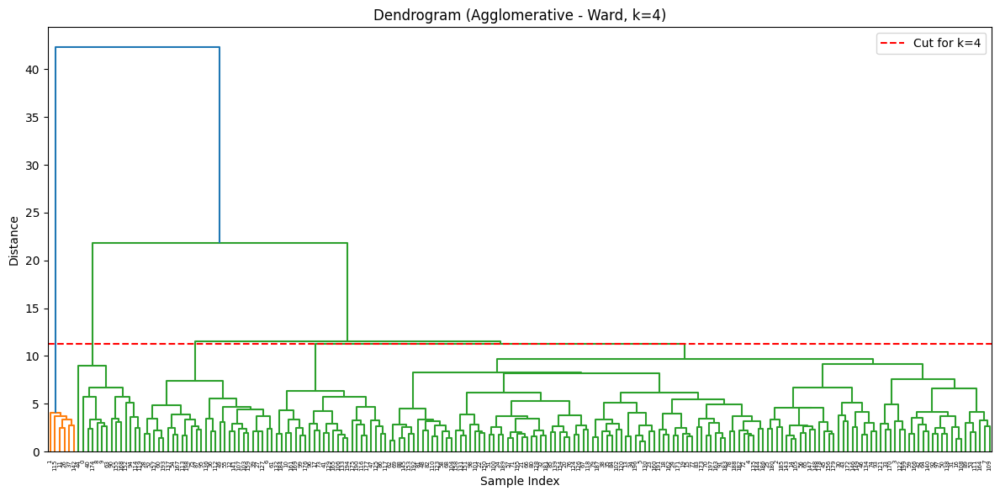

In [ ]:
from scipy.cluster.hierarchy import dendrogram, linkage
import matplotlib.pyplot as plt
import numpy as np

# 8. Dendrogram for Agglomerative Clustering with k=4
sample_data = pd.DataFrame(df_scaled).sample(n=200, random_state=42)
linked = linkage(sample_data, method='ward')

plt.figure(figsize=(12, 6))
dendrogram(linked, color_threshold=None)

# Draw horizontal line to show cut for k=4
cut_level = sorted(linked[:, 2], reverse=True)[3]  # 4 clusters = 3 merges from top
plt.axhline(y=cut_level, color='red', linestyle='--', label='Cut for k=4')

plt.title("Dendrogram (Agglomerative - Ward, k=4)")
plt.xlabel("Sample Index")
plt.ylabel("Distance")
plt.legend()
plt.tight_layout()
plt.show()


🔍 PCA Loadings (Feature Contributions to Principal Components):


,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8
Age,0.00,-0.00,0.01,-0.08,-0.08,-0.01,0.02,-0.05
TotalPurchases,0.06,0.34,0.03,0.04,0.03,0.15,-0.07,-0.11
AverageOrderValue,0.83,-0.54,0.02,0.00,0.01,0.02,-0.01,-0.01
CustomerLifetimeValue,0.56,0.77,-0.02,-0.01,-0.01,-0.04,0.02,0.03
EmailEngagementRate,-0.00,-0.00,0.04,0.02,-0.14,0.74,0.64,-0.06
SocialMediaEngagementRate,0.00,0.01,0.10,0.63,0.58,-0.17,0.33,0.28
CustomerServiceInteractions,0.01,-0.00,0.01,-0.14,-0.03,0.02,-0.11,0.05
AverageSatisfactionScore,-0.00,-0.01,-0.06,0.06,0.56,0.53,-0.53,-0.30
EmailConversionRate,-0.01,0.01,0.98,-0.10,-0.01,0.05,-0.11,0.08
SocialMediaConversionRate,-0.00,0.01,-0.13,-0.47,0.25,0.20,-0.05,0.80



📌 Most Influential Features (Top 3 from PC1 and PC2):
TotalPurchases, CustomerLifetimeValue, AverageOrderValue

🔍 MiniBatch KMeans (k=6) Cluster Profiling

📦 Cluster Sizes:


,count
Cluster_KMeans_k6,
1,2036
2,1801
3,113
4,300
5,3435
6,1546


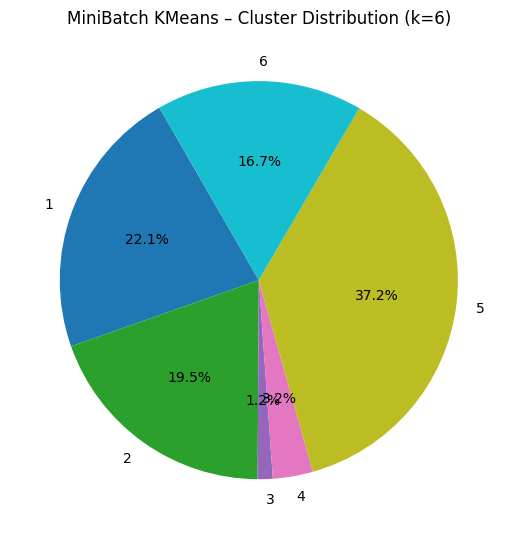

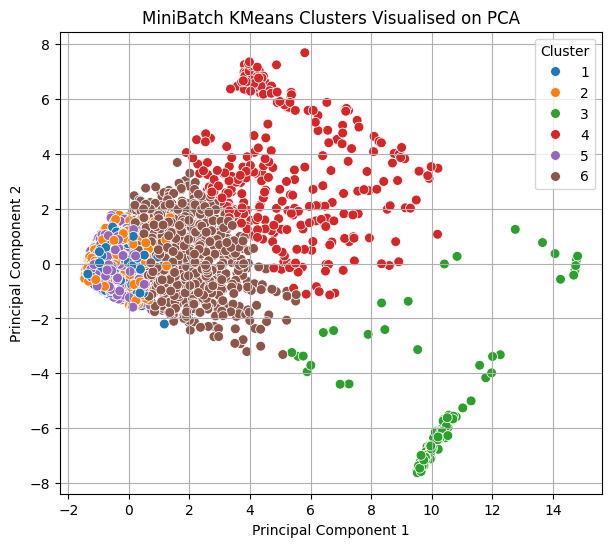


📊 Cluster Profiles – Feature Means (k=6):


,Age,TotalPurchases,AverageOrderValue,CustomerLifetimeValue,EmailEngagementRate,SocialMediaEngagementRate,CustomerServiceInteractions,AverageSatisfactionScore,EmailConversionRate,SocialMediaConversionRate,SearchEngineConversionRate,RepeatCustomer,PremiumMember,HasReturnedItems,CustomerTenure
Cluster_KMeans_k6,,,,,,,,,,,,,,,
1,35.17,4.90,56.17,254.15,0.32,0.29,1.92,6.42,0.16,0.17,0.33,0.91,0.25,0.33,54.57
2,35.67,5.34,62.29,309.57,0.31,0.29,2.06,7.05,0.36,0.20,0.17,0.93,0.22,0.33,54.64
3,35.34,4.96,1223.78,1117.09,0.28,0.30,2.29,6.94,0.19,0.19,0.21,0.88,0.22,0.27,51.70
4,35.56,7.77,342.16,3563.97,0.27,0.30,2.10,6.85,0.19,0.20,0.19,0.98,0.24,0.37,56.18
5,35.56,4.63,55.29,230.99,0.25,0.28,1.99,7.25,0.14,0.21,0.14,0.90,0.24,0.33,55.04
6,35.73,6.17,209.14,1023.12,0.28,0.28,2.03,6.94,0.18,0.20,0.19,0.96,0.23,0.35,54.76



📈 Distribution of Most Influential Features by Cluster:


/tmp/ipython-input-44-1841652009.py:56: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




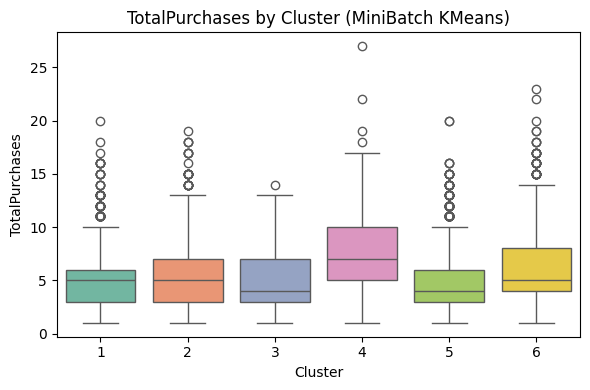

/tmp/ipython-input-44-1841652009.py:56: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




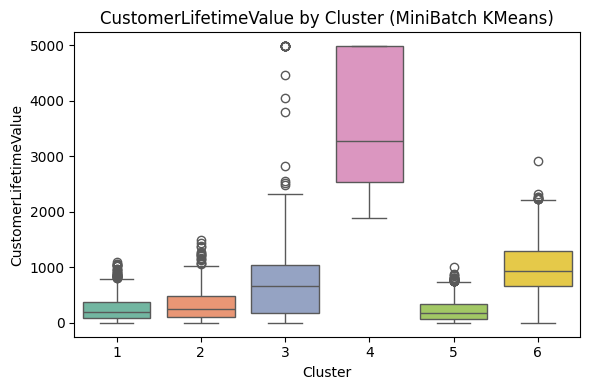

/tmp/ipython-input-44-1841652009.py:56: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




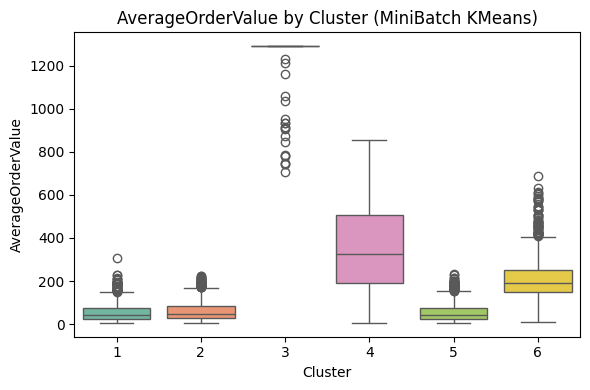


🔍 Agglomerative Clustering (k=4) Cluster Profiling

📦 Cluster Sizes:


,count
Cluster_Agglo_k4,
1,8148
2,218
3,97
4,768


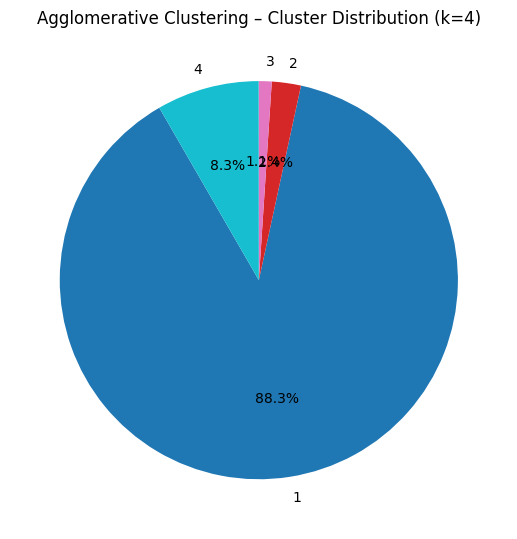

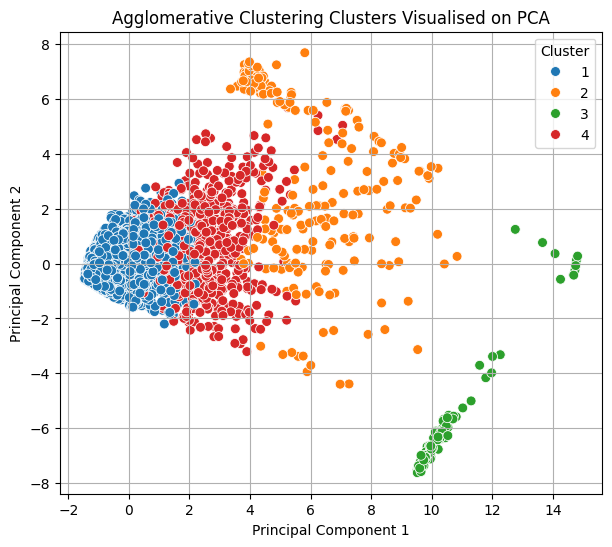


📊 Cluster Profiles – Feature Means (k=4):


,Age,TotalPurchases,AverageOrderValue,CustomerLifetimeValue,EmailEngagementRate,SocialMediaEngagementRate,CustomerServiceInteractions,AverageSatisfactionScore,EmailConversionRate,SocialMediaConversionRate,SearchEngineConversionRate,RepeatCustomer,PremiumMember,HasReturnedItems,CustomerTenure
Cluster_Agglo_k4,,,,,,,,,,,,,,,
1,35.44,5.03,69.50,322.87,0.28,0.29,1.99,6.95,0.20,0.20,0.20,0.92,0.24,0.33,54.79
2,36.61,6.28,429.48,3705.75,0.25,0.31,2.17,6.86,0.21,0.18,0.19,0.96,0.24,0.35,53.57
3,34.02,5.34,1285.46,1018.08,0.29,0.30,2.25,6.96,0.18,0.19,0.21,0.91,0.21,0.29,51.73
4,36.26,6.55,255.35,1443.09,0.30,0.27,2.06,7.09,0.20,0.20,0.22,0.95,0.24,0.35,55.78



📈 Distribution of Most Influential Features by Cluster:


/tmp/ipython-input-44-1841652009.py:56: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




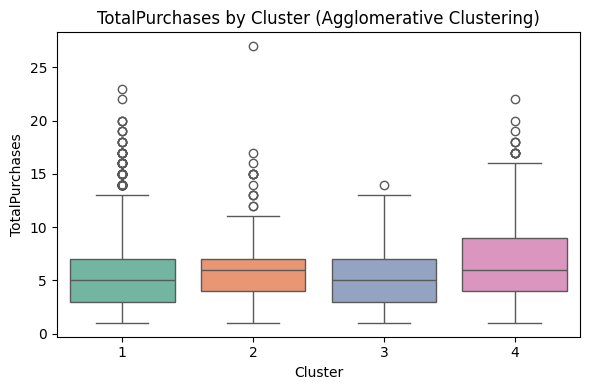

/tmp/ipython-input-44-1841652009.py:56: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




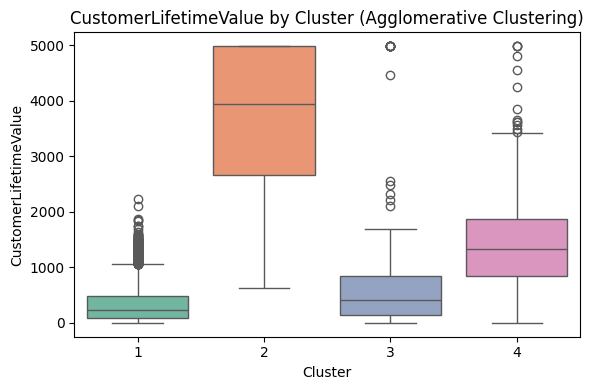

/tmp/ipython-input-44-1841652009.py:56: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




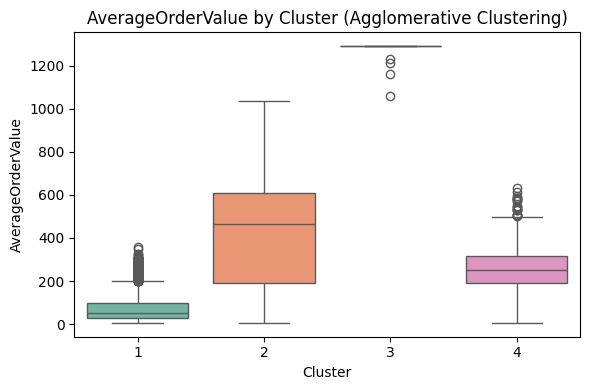


=== Mean PC scores per cluster ===


,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8
Cluster,,,,,,,,
1,-0.50,-0.07,-0,-0,0.01,-0.01,0.01,-0
2,6.07,2.84,0.05,-0.01,0.03,-0.31,0.05,0.05
3,10.59,-5.82,0.10,0.10,0.09,0.25,-0.06,-0.09
4,2.26,0.62,0.02,0.04,-0.09,0.14,-0.07,0.02


In [ ]:
# -------------------------------------------
# PART 3: PCA–Cluster Interpretation & Profiling
# -------------------------------------------

# 1. PCA Loadings – Feature Contributions to Each Component
pca_loadings = pd.DataFrame(pca.components_.T, index=features, columns=[f'PC{i+1}' for i in range(pca.n_components_)])
print("🔍 PCA Loadings (Feature Contributions to Principal Components):")
display(pca_loadings)

# Identify most influential features from first two components
top_features_pc1 = pca_loadings['PC1'].abs().sort_values(ascending=False).head(3).index.tolist()
top_features_pc2 = pca_loadings['PC2'].abs().sort_values(ascending=False).head(3).index.tolist()
important_features = list(set(top_features_pc1 + top_features_pc2))

print("\n📌 Most Influential Features (Top 3 from PC1 and PC2):")
print(", ".join(important_features))

def profile_and_visualise_clusters(df, pca_coords, cluster_col, method_name, k_value):
    print(f"\n============================")
    print(f"🔍 {method_name} (k={k_value}) Cluster Profiling")
    print(f"============================")

    # 1. Cluster Sizes
    cluster_sizes = df[cluster_col].value_counts().sort_index()
    print("\n📦 Cluster Sizes:")
    display(cluster_sizes)

    # Pie Chart for Cluster Proportions
    plt.figure(figsize=(5.5, 5.5))
    cluster_sizes.plot.pie(autopct='%1.1f%%', startangle=120, colormap='tab10')
    plt.title(f"{method_name} – Cluster Distribution (k={k_value})")
    plt.ylabel("")
    plt.tight_layout()
    plt.show()

    # 2. PCA Scatter Plot Coloured by Cluster
    plt.figure(figsize=(7, 6))
    sns.scatterplot(x=pca_coords[:, 0], y=pca_coords[:, 1], hue=df[cluster_col], palette='tab10', s=50)
    plt.title(f"{method_name} Clusters Visualised on PCA")
    plt.xlabel("Principal Component 1")
    plt.ylabel("Principal Component 2")
    plt.legend(title="Cluster")
    plt.grid(True)
    plt.show()

    # 3. Cluster Profile Table (Mean of Original Features)
    profile_features = features + [cluster_col]
    cluster_profile = df[profile_features].groupby(cluster_col).mean().round(2)
    print(f"\n📊 Cluster Profiles – Feature Means (k={k_value}):")
    display(cluster_profile)

    # 4. Feature Distribution Boxplots (Important Features)
    print("\n📈 Distribution of Most Influential Features by Cluster:")
    for feature in important_features:
        plt.figure(figsize=(6, 4))
        sns.boxplot(x=df[cluster_col], y=df[feature], palette='Set2')
        plt.title(f"{feature} by Cluster ({method_name})")
        plt.xlabel("Cluster")
        plt.ylabel(feature)
        plt.tight_layout()
        plt.show()

# Run for MiniBatch KMeans (k = 6)
profile_and_visualise_clusters(
    df=df_processed,
    pca_coords=pca_data,
    cluster_col='Cluster_KMeans_k6',
    method_name='MiniBatch KMeans',
    k_value=6
)

# Run for Agglomerative Clustering (k = 4)
profile_and_visualise_clusters(
    df=df_processed,
    pca_coords=pca_data,
    cluster_col='Cluster_Agglo_k4',
    method_name='Agglomerative Clustering',
    k_value=4
)

# Get the column name of the best clustering result
best_k = best_overall['k']
best_method = best_overall['Method']
cluster_column = ''

if best_method == 'KMeans':
    cluster_column = f'Cluster_KMeans_k{best_k}'
elif 'Agglo' in best_method:
    cluster_column = f'Cluster_Agglo_k{best_k}'


# Create PCA scores DataFrame and append cluster label
pca_scores_df = pd.DataFrame(pca_data, columns=[f'PC{i+1}' for i in range(pca_data.shape[1])])
pca_scores_df['Cluster'] = df_processed[cluster_column].values

# Step 4: Compute mean PC scores per cluster
cluster_pc_means = pca_scores_df.groupby('Cluster').mean().round(2)
print("\n=== Mean PC scores per cluster ===")
display(cluster_pc_means)

In [ ]:
# Example for MiniBatch KMeans with k=6
cluster_col = 'Cluster_Agglo_k4'

# Create PCA scores DataFrame and append cluster label
pca_scores_df = pd.DataFrame(pca_data, columns=[f'PC{i+1}' for i in range(pca_data.shape[1])])
pca_scores_df[cluster_col] = df_processed[cluster_col].values

# Compute mean PC scores per cluster
mean_pc_scores = pca_scores_df.groupby(cluster_col).mean().round(2)
print(f"\n📌 Mean Principal Component Scores per Cluster ({cluster_col}):")
display(mean_pc_scores)



📌 Mean Principal Component Scores per Cluster (Cluster_Agglo_k4):


,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8
Cluster_Agglo_k4,,,,,,,,
1,-0.50,-0.07,-0,-0,0.01,-0.01,0.01,-0
2,6.07,2.84,0.05,-0.01,0.03,-0.31,0.05,0.05
3,10.59,-5.82,0.10,0.10,0.09,0.25,-0.06,-0.09
4,2.26,0.62,0.02,0.04,-0.09,0.14,-0.07,0.02



📊 PCA Eigenvalues and Variance Explained:


,Principal Component,Eigenvalue,% Variance Explained,Cumulative % Variance
0,PC1,3.35,32.89,32.89
1,PC2,1.31,12.89,45.78
2,PC3,0.61,6.02,51.80
3,PC4,0.55,5.44,57.24
4,PC5,0.55,5.39,62.64
5,PC6,0.54,5.32,67.96
6,PC7,0.53,5.19,73.15
7,PC8,0.52,5.11,78.26


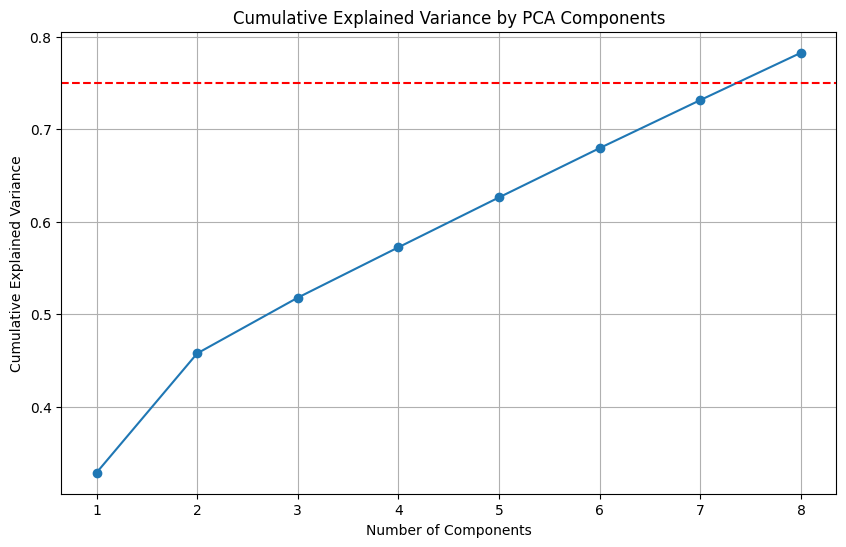

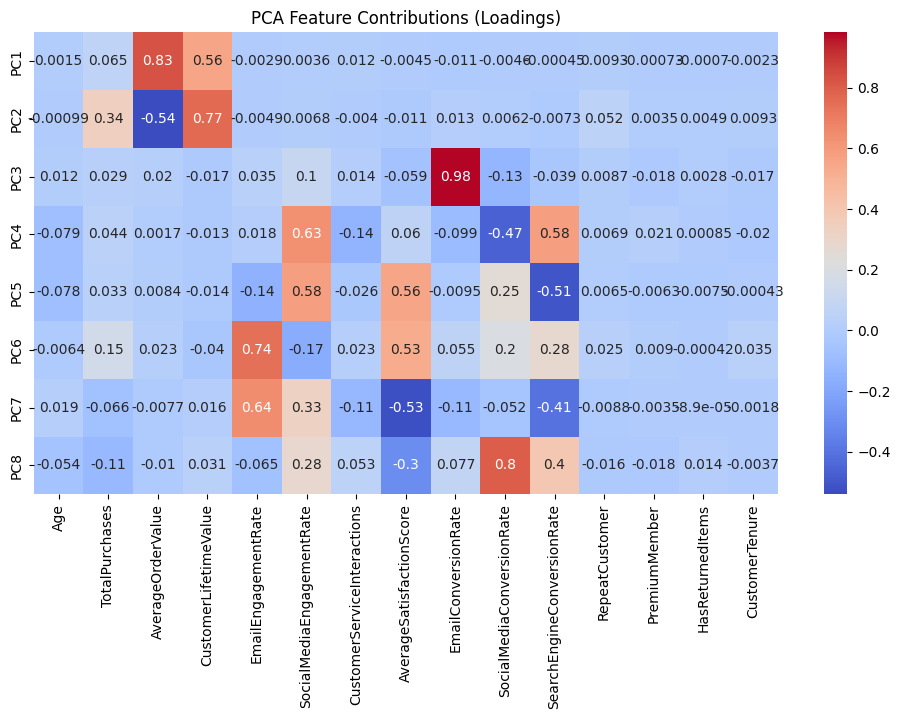

In [ ]:
# ===============================
# 📦 Imports
# ===============================
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

from scipy.stats.mstats import winsorize
from sklearn.preprocessing import RobustScaler
from sklearn.decomposition import PCA
from sklearn.cluster import AgglomerativeClustering, MiniBatchKMeans
from sklearn.metrics import silhouette_score, davies_bouldin_score, calinski_harabasz_score
from scipy.cluster.hierarchy import linkage as scipy_linkage, dendrogram

# ===============================
# 📌 Data Preparation
# ===============================

df_processed = df.copy()

# Winsorization for capping outliers
for col in ['AverageOrderValue', 'CustomerLifetimeValue']:
    df_processed[col] = winsorize(df_processed[col], limits=[0.01, 0.01])

# Feature selection
features = [
    'Age', 'TotalPurchases', 'AverageOrderValue', 'CustomerLifetimeValue',
    'EmailEngagementRate', 'SocialMediaEngagementRate',
    'CustomerServiceInteractions', 'AverageSatisfactionScore',
    'EmailConversionRate', 'SocialMediaConversionRate',
    'SearchEngineConversionRate', 'RepeatCustomer',
    'PremiumMember', 'HasReturnedItems', 'CustomerTenure'
]

# Scaling with RobustScaler
scaler = RobustScaler()
df_scaled = scaler.fit_transform(df_processed[features])

# ===============================
# 📌 Principal Component Analysis (PCA)
# ===============================

# Apply PCA to retain 75% of variance
pca = PCA(n_components=0.75)
pca_data = pca.fit_transform(df_scaled)

# Explained variance metrics
eigenvalues = pca.explained_variance_
explained_variance_ratio = pca.explained_variance_ratio_
cumulative_variance = np.cumsum(explained_variance_ratio)

# Display eigenvalues and variance explained
eigenvalue_df = pd.DataFrame({
    'Principal Component': [f'PC{i+1}' for i in range(len(eigenvalues))],
    'Eigenvalue': np.round(eigenvalues, 4),
    '% Variance Explained': np.round(explained_variance_ratio * 100, 2),
    'Cumulative % Variance': np.round(cumulative_variance * 100, 2)
})

print("\n📊 PCA Eigenvalues and Variance Explained:")
display(eigenvalue_df)

# Plot cumulative explained variance
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(explained_variance_ratio)+1), cumulative_variance, marker='o')
plt.axhline(y=0.75, color='red', linestyle='--')
plt.title('Cumulative Explained Variance by PCA Components')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.grid(True)
plt.show()

# ===============================
# 📌 PCA Loadings (Feature Contributions)
# ===============================

pca_loadings = pd.DataFrame(
    pca.components_,
    columns=features,
    index=[f'PC{i+1}' for i in range(len(pca.components_))]
)

plt.figure(figsize=(12, 6))
sns.heatmap(pca_loadings, cmap="coolwarm", annot=True)
plt.title("PCA Feature Contributions (Loadings)")
plt.show()


In [ ]:
!pip install opendatasets --upgrade --quiet

In [ ]:
import opendatasets as od

dataset = 'https://www.kaggle.com/datasets/noir1112/e-commerce-customer-engagement?select=ecommerce_customer_data.csv'

od.download(dataset)

Skipping, found downloaded files in "./e-commerce-customer-engagement" (use force=True to force download)


In [ ]:
import pandas as pd

# Load the dataset
df = pd.read_csv('/content/e-commerce-customer-engagement/ecommerce_customer_data.csv')

# Inspect the dataset
print("Dataset Shape:", df.shape)  # Dimensions of the dataset
print(df.info())  # Summary of column data types and missing values
print(df.head())  # First few rows for a quick preview

import pandas as pd
from tabulate import tabulate
import io
import re

# Capture the output of df.info()
buffer = io.StringIO()
df.info(buf=buffer)
info_string = buffer.getvalue()

# Parse the output to extract column information
lines = info_string.split('\n')[3:-2]  # Extract relevant lines
table_data = []
index = 0  # Initialize the index
for line in lines:
    # Use regex to extract column name, non-null count, and dtype
    match = re.search(r"(\S+)\s+(\d+)\s+non-null\s+(\S+)", line)
    if match:
        column_name = match.group(1)
        non_null_count = match.group(2)
        dtype = match.group(3)
        table_data.append([index, column_name, non_null_count, dtype])
        index += 1  # Increment the index

# Format with tabulate
formatted_table = tabulate(table_data, headers=["#", "Column", "Non-Null Count", "Dtype"], tablefmt="fancy_grid", showindex=False)

# Display the formatted table
print(formatted_table)

Dataset Shape: (10000, 23)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 23 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   CustomerID                   9508 non-null   object 
 1   RegistrationDate             9504 non-null   object 
 2   Age                          9485 non-null   float64
 3   Gender                       7388 non-null   object 
 4   IncomeLevel                  7497 non-null   object 
 5   Country                      9507 non-null   object 
 6   City                         9517 non-null   object 
 7   TotalPurchases               9470 non-null   float64
 8   AverageOrderValue            9481 non-null   float64
 9   CustomerLifetimeValue        9507 non-null   float64
 10  FavoriteCategory             8411 non-null   object 
 11  SecondFavoriteCategory       8450 non-null   object 
 12  EmailEngagementRate          9524 non-null   flo

In [ ]:
from IPython.display import display, HTML

# Calculate missing values and percentages
missing_values = df.isnull().sum()
missing_percent = (df.isnull().sum() / len(df)) * 100

# Create HTML for side-by-side display
output = f"""
<table>
<tr>
<th>Missing Values</th>
<th>Missing Values (%)</th>
</tr>
<tr>
<td>{missing_values.to_frame().to_html()}</td>
<td>{missing_percent.to_frame().to_html()}</td>
</tr>
</table>
"""

# Display the output
display(HTML(output))

# Drop columns with more than 30% missing values (you can adjust the threshold if needed)
threshold = 30
df = df.loc[:, missing_percent < threshold]
print("Shape After Dropping Columns with >30% Missing:", df.shape)

# Impute missing values for the remaining columns
# For numerical columns, fill with mean
numerical_cols = df.select_dtypes(include=['float64', 'int64']).columns
df[numerical_cols] = df[numerical_cols].fillna(df[numerical_cols].mean())

# For categorical columns, fill with 'Unknown'
categorical_cols = df.select_dtypes(include=['object']).columns
df[categorical_cols] = df[categorical_cols].fillna('Unknown')

# Check if there are any remaining missing values
print("Missing Values After Handling:\n", df.isnull().sum())


Missing Values,Missing Values (%)
,0
CustomerID,492
RegistrationDate,496
Age,515
Gender,2612
IncomeLevel,2503
Country,493
City,483
TotalPurchases,530
AverageOrderValue,519


Shape After Dropping Columns with >30% Missing: (10000, 23)
Missing Values After Handling:
 CustomerID                     0
RegistrationDate               0
Age                            0
Gender                         0
IncomeLevel                    0
Country                        0
City                           0
TotalPurchases                 0
AverageOrderValue              0
CustomerLifetimeValue          0
FavoriteCategory               0
SecondFavoriteCategory         0
EmailEngagementRate            0
SocialMediaEngagementRate      0
MobileAppUsage                 0
CustomerServiceInteractions    0
AverageSatisfactionScore       0
EmailConversionRate            0
SocialMediaConversionRate      0
SearchEngineConversionRate     0
RepeatCustomer                 0
PremiumMember                  0
HasReturnedItems               0
dtype: int64


In [ ]:
# Impute missing values in Age column with the median
df['Age'] = df['Age'].fillna(df['Age'].median())


In [ ]:
# Replace "L" with "Low" and "H" with "High" in the "IncomeLevel" column
df['IncomeLevel'] = df['IncomeLevel'].replace({'L': 'Low', 'H': 'High'})

# Replace "F" with "Female" and "M" with "Male" in the "Gender" column
df['Gender'] = df['Gender'].replace({'F': 'Female', 'M': 'Male'})

# Display the updated DataFrame
print(df.head())

  CustomerID RegistrationDate   Age             Gender IncomeLevel    Country  \
0    Unknown       2020-05-10    25            Unknown     Unknown      Other   
1  CUST00002       2021-07-18 34.54  Prefer not to say        High    Germany   
2  CUST00003       2021-02-04    43            Unknown        High     France   
3  CUST00004       2020-12-31    49             Female        High  Australia   
4  CUST00005       2022-06-27    29             Female   Very High  Australia   

          City  TotalPurchases  AverageOrderValue  CustomerLifetimeValue  ...  \
0        Tokyo               4              15.89                 672.92  ...   
1       London               6              27.64                 181.73  ...   
2      Unknown              10             161.74                1810.56  ...   
3  Los Angeles               5              14.19                  86.22  ...   
4        Tokyo               7           31147.43                2112.58  ...   

  SocialMediaEngagementRat

In [ ]:
# Convert RegistrationDate to datetime
df['RegistrationDate'] = pd.to_datetime(df['RegistrationDate'], errors='coerce')

# Drop rows with invalid dates
df.dropna(subset=['RegistrationDate'], inplace=True)

# Create a CustomerTenure column based on RegistrationDate
from datetime import datetime
current_date = datetime.now()
df['CustomerTenure'] = ((current_date - df['RegistrationDate']).dt.days // 30).astype(int)

# Drop the original RegistrationDate column
df.drop(columns=['RegistrationDate'], inplace=True)

print("Shape After Creating CustomerTenure:", df.shape)
print(df.columns)

Shape After Creating CustomerTenure: (9504, 23)
Index(['CustomerID', 'Age', 'Gender', 'IncomeLevel', 'Country', 'City',
       'TotalPurchases', 'AverageOrderValue', 'CustomerLifetimeValue',
       'FavoriteCategory', 'SecondFavoriteCategory', 'EmailEngagementRate',
       'SocialMediaEngagementRate', 'MobileAppUsage',
       'CustomerServiceInteractions', 'AverageSatisfactionScore',
       'EmailConversionRate', 'SocialMediaConversionRate',
       'SearchEngineConversionRate', 'RepeatCustomer', 'PremiumMember',
       'HasReturnedItems', 'CustomerTenure'],
      dtype='object')


In [ ]:
from sklearn.preprocessing import LabelEncoder
import pandas as pd

# Example: Label Encoding for binary columns (e.g., RepeatCustomer, PremiumMember)
label_cols = ['RepeatCustomer', 'PremiumMember', 'HasReturnedItems']
le = LabelEncoder()
for col in label_cols:
    df[col] = le.fit_transform(df[col])

print("Data After Label Encoding:\n", df.head())

print(df.columns)

Data After Label Encoding:
   CustomerID   Age             Gender IncomeLevel    Country         City  \
0    Unknown    25            Unknown     Unknown      Other        Tokyo   
1  CUST00002 34.54  Prefer not to say        High    Germany       London   
2  CUST00003    43            Unknown        High     France      Unknown   
3  CUST00004    49             Female        High  Australia  Los Angeles   
4  CUST00005    29             Female   Very High  Australia        Tokyo   

   TotalPurchases  AverageOrderValue  CustomerLifetimeValue FavoriteCategory  \
0               4              15.89                 672.92         Clothing   
1               6              27.64                 181.73      Electronics   
2              10             161.74                1810.56          Unknown   
3               5              14.19                  86.22           Sports   
4               7           31147.43                2112.58         Clothing   

   ... MobileAppUsage  Custo

In [ ]:
# 1. Replace '4.0' and 'Unknown' with NaN initially:
df['FavoriteCategory'] = df['FavoriteCategory'].replace(['4.0', 'Unknown'], pd.NA)
df['SecondFavoriteCategory'] = df['SecondFavoriteCategory'].replace(['4.0', 'Unknown'], pd.NA)

# 2. Calculate the most common categories (excluding NaNs):
most_common_fav = df['FavoriteCategory'].dropna().mode()[0]
most_common_second = df['SecondFavoriteCategory'].dropna().mode()[0]

# 3. Fill NaN values with the most common categories:
df['FavoriteCategory'] = df['FavoriteCategory'].fillna(most_common_fav)
df['SecondFavoriteCategory'] = df['SecondFavoriteCategory'].fillna(most_common_second)

# 4. Create the 'FavoriteCombination' column:
df['FavoriteCombination'] = df['FavoriteCategory'] + ' & ' + df['SecondFavoriteCategory']

# 5. Group by 'FavoriteCombination' and count values:
behavior_by_combination = df.groupby('FavoriteCombination')['TotalPurchases'].size()

# 6. Sort and display the top 10 results:
print(behavior_by_combination.sort_values(ascending=False).head(10))

print("Shape After FavoriteCombination:", df.shape)
print(df.columns)
print("Data After FavoriteCombination:\n", df.head())

FavoriteCombination
Beauty & Home Goods         662
Electronics & Home Goods    292
Beauty & Books              280
Beauty & Sports             279
Beauty & Clothing           277
Beauty & Electronics        276
Home Goods & Home Goods     275
Books & Home Goods          272
Beauty & Toys               271
Food & Home Goods           267
Name: TotalPurchases, dtype: int64
Shape After FavoriteCombination: (9504, 24)
Index(['CustomerID', 'Age', 'Gender', 'IncomeLevel', 'Country', 'City',
       'TotalPurchases', 'AverageOrderValue', 'CustomerLifetimeValue',
       'FavoriteCategory', 'SecondFavoriteCategory', 'EmailEngagementRate',
       'SocialMediaEngagementRate', 'MobileAppUsage',
       'CustomerServiceInteractions', 'AverageSatisfactionScore',
       'EmailConversionRate', 'SocialMediaConversionRate',
       'SearchEngineConversionRate', 'RepeatCustomer', 'PremiumMember',
       'HasReturnedItems', 'CustomerTenure', 'FavoriteCombination'],
      dtype='object')
Data After FavoriteC

In [ ]:
print("Missing Values2:\n", df.isnull().sum())

Missing Values2:
 CustomerID                     0
Age                            0
Gender                         0
IncomeLevel                    0
Country                        0
City                           0
TotalPurchases                 0
AverageOrderValue              0
CustomerLifetimeValue          0
FavoriteCategory               0
SecondFavoriteCategory         0
EmailEngagementRate            0
SocialMediaEngagementRate      0
MobileAppUsage                 0
CustomerServiceInteractions    0
AverageSatisfactionScore       0
EmailConversionRate            0
SocialMediaConversionRate      0
SearchEngineConversionRate     0
RepeatCustomer                 0
PremiumMember                  0
HasReturnedItems               0
CustomerTenure                 0
FavoriteCombination            0
dtype: int64


In [ ]:
print(df.dtypes)

CustomerID                      object
Age                            float64
Gender                          object
IncomeLevel                     object
Country                         object
City                            object
TotalPurchases                 float64
AverageOrderValue              float64
CustomerLifetimeValue          float64
FavoriteCategory                object
SecondFavoriteCategory          object
EmailEngagementRate            float64
SocialMediaEngagementRate      float64
MobileAppUsage                  object
CustomerServiceInteractions    float64
AverageSatisfactionScore       float64
EmailConversionRate            float64
SocialMediaConversionRate      float64
SearchEngineConversionRate     float64
RepeatCustomer                   int64
PremiumMember                    int64
HasReturnedItems                 int64
CustomerTenure                   int64
FavoriteCombination             object
dtype: object


In [ ]:
df.to_csv('cleaned_data.csv', index=False)
print("Cleaned data saved.")

Cleaned data saved.


In [ ]:
# Save the DataFrame to an Excel file
!pip install openpyxl
df.to_excel('cleaned_ecommerce_data_16122024.xlsx', index=False)

In [ ]:
#DESCRIPTIVE ANALYSIS
# Summary statistics for numerical columns
df.describe()


,Age,TotalPurchases,AverageOrderValue,CustomerLifetimeValue,EmailEngagementRate,SocialMediaEngagementRate,CustomerServiceInteractions,AverageSatisfactionScore,EmailConversionRate,SocialMediaConversionRate,SearchEngineConversionRate,RepeatCustomer,PremiumMember,HasReturnedItems,CustomerTenure
count,9504,9504,9504,9504,9504,9504,9504,9504,9504,9504,9504,9504,9504,9504,9504
mean,34.54,5.04,192.85,677.46,0.28,0.29,2.00,6.96,0.20,0.20,0.20,1.74,0.43,0.62,54.81
std,14.74,3.11,1468.91,5721.41,0.15,0.16,1.39,1.85,0.12,0.12,0.12,0.63,0.79,0.90,20.84
min,-25,0,1.24,-9331.08,0.00,0.00,0,0,0.00,0.00,0.00,0,0,0,18
25%,25,3,28.71,103.39,0.17,0.17,1,5.75,0.11,0.11,0.11,2,0,0,37
50%,34.54,5,58.23,264.51,0.27,0.28,2,6.96,0.19,0.19,0.19,2,0,0,55
75%,44,7,126.01,635.77,0.38,0.38,3,8.28,0.26,0.27,0.27,2,0,2,73
max,91,27,51810.12,420810.82,0.89,0.85,11,10,0.78,0.82,0.78,2,2,2,91


In [ ]:
# Check if there are any remaining negative values
print(f"Negative Age values after fixing: {df[df['Age'] < 0].shape[0]}")
print(df['Age'].describe())  # Check summary statistics again


Negative Age values after fixing: 81
count    9504
mean    34.54
std     14.74
min       -25
25%        25
50%     34.54
75%        44
max        91
Name: Age, dtype: float64


In [ ]:
# Remove the rows with negative Age values
df_cleaned = df[df['Age'] >= 0]
print(f"New dataset shape after removal: {df_cleaned.shape}")



New dataset shape after removal: (9423, 24)


In [ ]:
# Verify if there are still any negative Age values
print(f"Negative Age values after fixing: {df[df['Age'] < 0].shape[0]}")


Negative Age values after fixing: 81


In [ ]:
# Clip Age values to be within a realistic range (e.g., 13-100)
df['Age'] = df['Age'].clip(lower=18, upper=100)
print(f"New min age: {df['Age'].min()}, New max age: {df['Age'].max()}")


New min age: 18.0, New max age: 91.0


In [ ]:
# Recalculate and review summary statistics
print(df['Age'].describe())


count    9504
mean    35.56
std     13.00
min        18
25%        25
50%     34.54
75%        44
max        91
Name: Age, dtype: float64


In [ ]:
df['CustomerLifetimeValue'] = df['CustomerLifetimeValue'].clip(lower=0)


In [ ]:
df = df[df['TotalPurchases'] > 0]


In [ ]:
df['AverageSatisfactionScore'] = df['AverageSatisfactionScore'].replace(0, df['AverageSatisfactionScore'].median())


In [ ]:
df['AverageSatisfactionScore'] = df['AverageSatisfactionScore'].clip(lower=1)


In [ ]:
df['RepeatCustomer'] = df['RepeatCustomer'].clip(0, 1)
df['PremiumMember'] = df['PremiumMember'].clip(0, 1)


In [ ]:
df['HasReturnedItems'] = df['HasReturnedItems'].clip(0, 1)


# **STATISTIC ANALYSIS**

In [ ]:
# Convert integer columns to int (remove decimals)
int_columns = ["Age", "TotalPurchases", "CustomerServiceInteractions",
               "RepeatCustomer", "PremiumMember", "HasReturnedItems", "CustomerTenure"]
df[int_columns] = df[int_columns].astype(int)

# Round float columns to 2 decimals
float_columns = ["AverageOrderValue", "CustomerLifetimeValue", "EmailEngagementRate",
                 "SocialMediaEngagementRate", "EmailConversionRate", "SocialMediaConversionRate",
                 "SearchEngineConversionRate", "AverageSatisfactionScore"]
df[float_columns] = df[float_columns].round(2)

# Format the describe() output to limit decimals
pd.options.display.float_format = lambda x: f"{x:.0f}" if x.is_integer() else f"{x:.2f}"

# Display cleaned summary
df.describe()





,Age,TotalPurchases,AverageOrderValue,CustomerLifetimeValue,EmailEngagementRate,SocialMediaEngagementRate,CustomerServiceInteractions,AverageSatisfactionScore,EmailConversionRate,SocialMediaConversionRate,SearchEngineConversionRate,RepeatCustomer,PremiumMember,HasReturnedItems,CustomerTenure
count,9231,9231,9231,9231,9231,9231,9231,9231,9231,9231,9231,9231,9231,9231,9231
mean,35.52,5.19,193.68,705.14,0.28,0.29,2.00,6.96,0.20,0.20,0.20,0.92,0.24,0.34,54.81
std,12.99,3.04,1487.94,5800.83,0.15,0.16,1.39,1.85,0.12,0.12,0.12,0.27,0.42,0.47,20.85
min,18,1,1.24,0,0,0,0,1,0,0,0,0,0,0,18
25%,25,3,28.71,112.13,0.17,0.17,1,5.76,0.11,0.11,0.11,1,0,0,37
50%,34,5,58.26,278.08,0.27,0.28,2,6.96,0.19,0.19,0.19,1,0,0,55
75%,44,7,125.91,651.93,0.38,0.38,3,8.28,0.26,0.27,0.27,1,0,1,73
max,91,27,51810.12,420810.82,0.89,0.85,11,10,0.78,0.82,0.78,1,1,1,91


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 9231 entries, 0 to 9999
Data columns (total 24 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   CustomerID                   9231 non-null   object 
 1   Age                          9231 non-null   int64  
 2   Gender                       9231 non-null   object 
 3   IncomeLevel                  9231 non-null   object 
 4   Country                      9231 non-null   object 
 5   City                         9231 non-null   object 
 6   TotalPurchases               9231 non-null   int64  
 7   AverageOrderValue            9231 non-null   float64
 8   CustomerLifetimeValue        9231 non-null   float64
 9   FavoriteCategory             9231 non-null   object 
 10  SecondFavoriteCategory       9231 non-null   object 
 11  EmailEngagementRate          9231 non-null   float64
 12  SocialMediaEngagementRate    9231 non-null   float64
 13  MobileAppUsage         

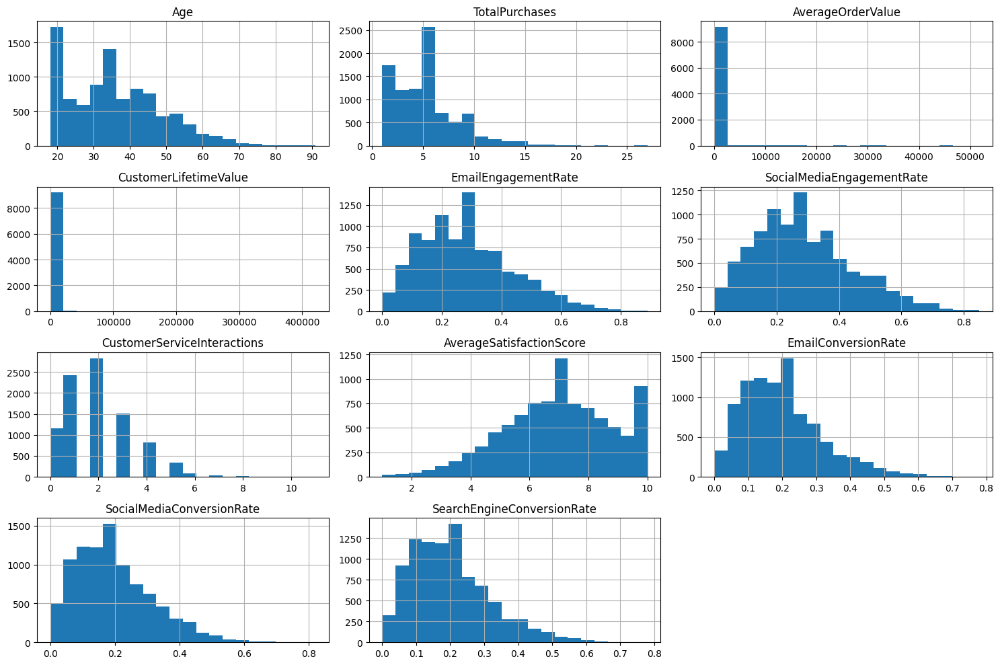

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plotting histograms for all numerical columns
df[numerical_cols].hist(figsize=(15, 10), bins=20)
plt.tight_layout()
plt.show()



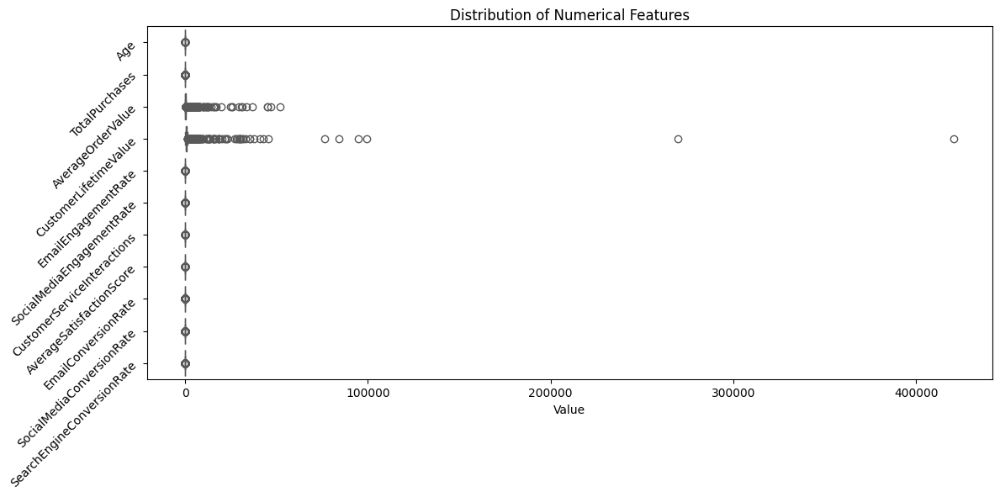

In [ ]:
# Boxplots for key numerical columns (e.g., TotalPurchases, AverageOrderValue)
plt.figure(figsize=(12, 6))  # Adjust figure size for better visibility
sns.boxplot(data=df[numerical_cols], orient="h", palette="Set2")
plt.title("Distribution of Numerical Features")  # Add a title
plt.xlabel("Value")  # Add x-axis label
plt.yticks(rotation=45, ha='right')  # Rotate y-axis labels for readability
plt.tight_layout()  # Adjust layout to prevent overlapping elements
plt.show()

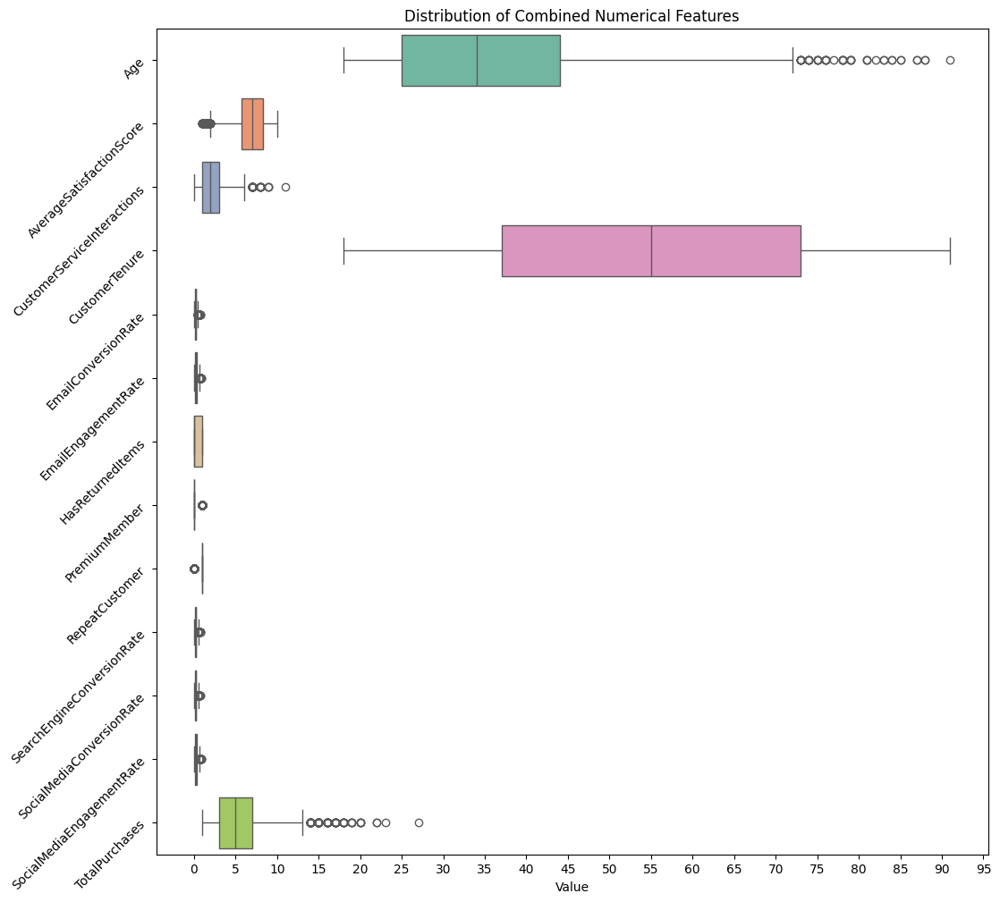

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Define the features to plot, selecting only numerical columns
features_combined = df.select_dtypes(include=['number']).columns.difference(['AverageOrderValue', 'CustomerLifetimeValue']).tolist()

# Set up a larger figure size for better visibility
plt.figure(figsize=(12, 12))

# First subplot for combined numerical features
sns.boxplot(data=df[features_combined], orient="h", palette="Set2")
plt.title("Distribution of Combined Numerical Features")
plt.xlabel("Value")
plt.yticks(rotation=45, ha='right')

# Set the x-axis ticks to increments of 5
# Calculate min and max only for numerical columns
min_val = df[features_combined].min().min()
max_val = df[features_combined].max().max()
plt.xticks(np.arange(min_val, max_val + 5, 5))

plt.show()

In [ ]:
!pip install plotly
import plotly.express as px
from IPython.display import display, HTML

# Frequency of categories in categorical columns (excluding CustomerID)
categorical_cols = df.select_dtypes(include=['object']).columns
categorical_cols = categorical_cols[categorical_cols != 'CustomerID']  # Exclude CustomerID

for col in categorical_cols:
    # Create and display the table of value counts
    value_counts = df[col].value_counts().to_frame()
    value_counts.reset_index(inplace=True)
    value_counts.columns = ['Category', 'Frequency']
    display(HTML(value_counts.to_html()))

    # Create and display the interactive bar chart
    fig = px.bar(
        value_counts,  # Use the value_counts DataFrame for the chart
        x='Category',  # Set x-axis to 'Category'
        y='Frequency',  # Set y-axis to 'Frequency'
        title=f"Frequency of Categories in {col}"
    )
    fig.update_layout(xaxis_tickangle=-45)  # Rotate x-axis labels
    fig.show()

,Category,Frequency
0,Unknown,2404
1,Other,1760
2,Female,1717
3,Male,1685
4,Prefer not to say,1665


,Category,Frequency
0,Unknown,2295
1,Very High,1815
2,Medium,1783
3,Low,1681
4,High,1657


,Category,Frequency
0,France,1132
1,Japan,1120
2,USA,1117
3,Australia,1101
4,Canada,1087
5,Other,1081
6,UK,1075
7,Germany,1073
8,Unknown,445


,Category,Frequency
0,New York,1134
1,Berlin,1124
2,London,1116
3,Tokyo,1113
4,Other,1089
5,Los Angeles,1076
6,Paris,1068
7,Sydney,1062
8,Unknown,449


,Category,Frequency
0,Beauty,2503
1,Sports,991
2,Electronics,984
3,Toys,957
4,Food,955
5,Clothing,952
6,Books,946
7,Home Goods,943


,Category,Frequency
0,Home Goods,2433
1,Electronics,997
2,Clothing,980
3,Sports,979
4,Food,976
5,Toys,960
6,Beauty,958
7,Books,948


,Category,Frequency
0,Unknown,2251
1,Never,1762
2,Low,1749
3,Medium,1739
4,High,1730


,Category,Frequency
0,Beauty & Home Goods,647
1,Electronics & Home Goods,283
2,Beauty & Books,274
3,Beauty & Sports,271
4,Beauty & Clothing,270
5,Beauty & Electronics,267
6,Beauty & Toys,265
7,Food & Home Goods,263
8,Books & Home Goods,262
9,Beauty & Food,261


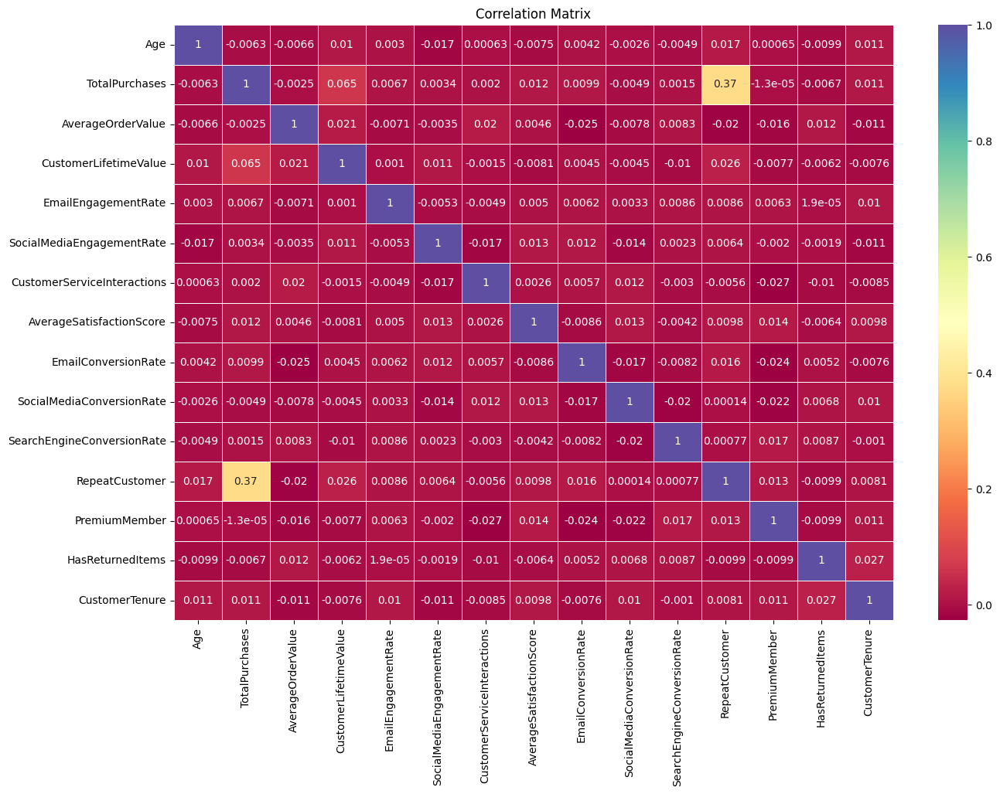

In [ ]:
# Correlation matrix to explore relationships between numerical columns
# Select only numerical features (excluding those with 'object' dtype)
numerical_cols = df.select_dtypes(include=['number']).columns
correlation_matrix = df[numerical_cols].corr()

plt.figure(figsize=(15, 10))
sns.heatmap(correlation_matrix, annot=True, cmap="Spectral", linewidths=0.5)
plt.title('Correlation Matrix')
plt.show()

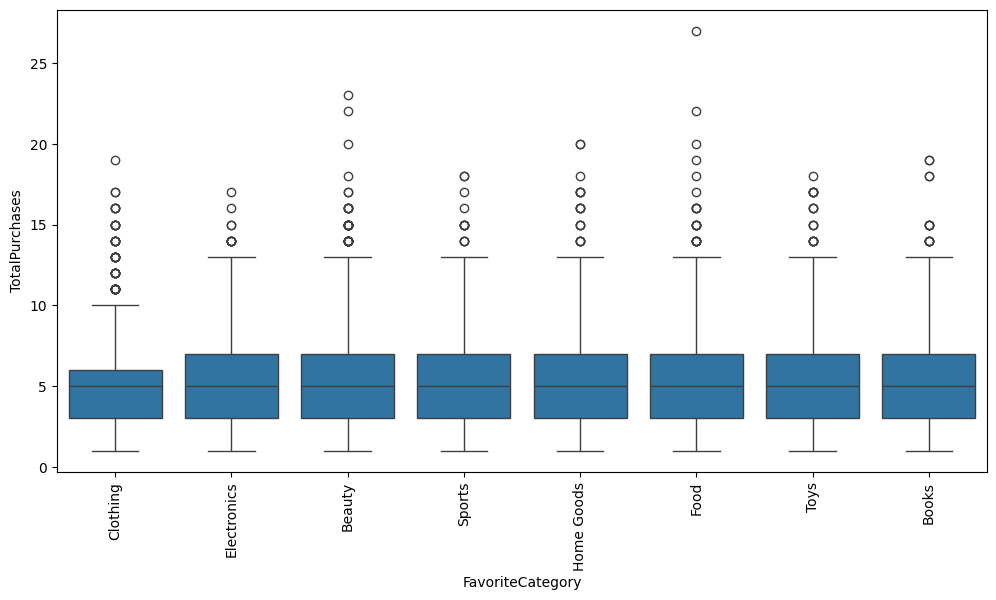

In [ ]:
# Grouping by 'FavoriteCategory' and calculating mean of numerical features
grouped_by_fav_category = df.groupby('FavoriteCategory')[numerical_cols].mean()

# Boxplot for TotalPurchases by FavoriteCategory
plt.figure(figsize=(12, 6))
sns.boxplot(x='FavoriteCategory', y='TotalPurchases', data=df)
plt.xticks(rotation=90)
plt.show()


In [ ]:
# Check for missing values in the dataset
missing_values = df.isnull().sum()
missing_percent = (missing_values / len(df)) * 100
missing_data = pd.DataFrame({"Missing Values": missing_values, "Percentage": missing_percent})
print(missing_data[missing_data['Percentage'] > 0])


Empty DataFrame
Columns: [Missing Values, Percentage]
Index: []


In [ ]:
# Add import statement at the beginning of your code (e.g., in cell ipython-input-48-484bce2eeb5e)
import numpy as np

from scipy import stats

# Calculate Z-scores for numerical features
z_scores = stats.zscore(df[numerical_cols])
abs_z_scores = np.abs(z_scores)

# Identify rows with Z-scores > 3 (potential outliers)
outliers = (abs_z_scores > 3).all(axis=1)
print(f"Number of outliers: {outliers.sum()}")

Number of outliers: 0


Age                            0.53
TotalPurchases                 1.10
AverageOrderValue             22.53
CustomerLifetimeValue         53.97
EmailEngagementRate            0.62
SocialMediaEngagementRate      0.57
CustomerServiceInteractions    0.78
AverageSatisfactionScore      -0.29
EmailConversionRate            0.90
SocialMediaConversionRate      0.83
SearchEngineConversionRate     0.87
RepeatCustomer                -3.12
PremiumMember                  1.24
HasReturnedItems               0.70
CustomerTenure                -0.00
dtype: float64


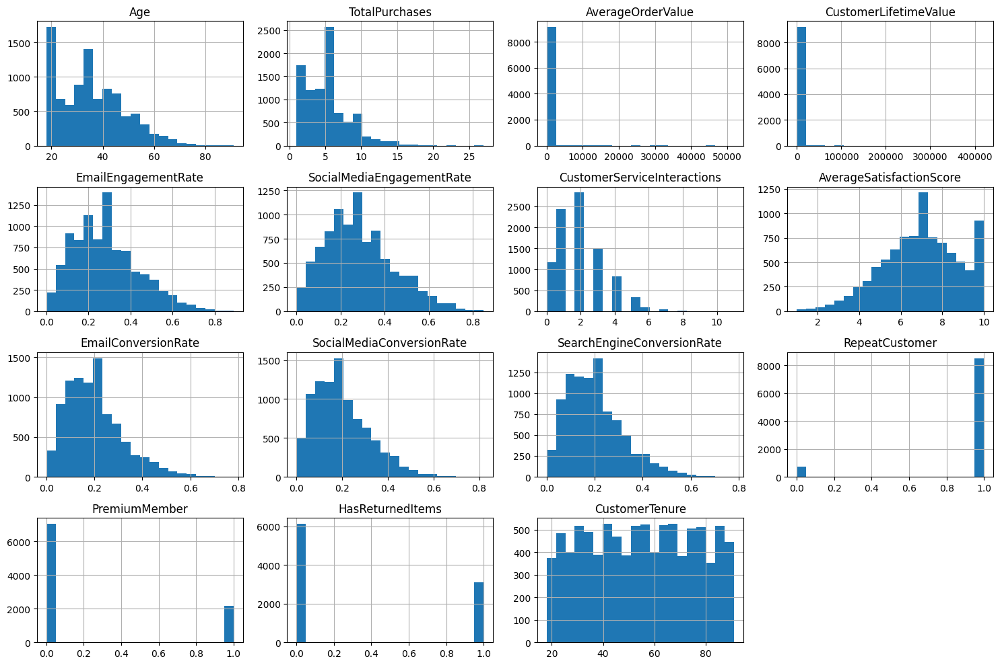

In [ ]:
# Checking skewness of numerical features
skewness = df[numerical_cols].skew()
print(skewness)

# Visualize skewness
df[numerical_cols].hist(figsize=(15, 10), bins=20)
plt.tight_layout()
plt.show()


In [ ]:
n_samples, n_features = df.shape
ratio = n_features / n_samples
print(f"Feature-to-Sample Ratio: {ratio}")


Feature-to-Sample Ratio: 0.0025999350016249595


In [ ]:
sparsity = (df != 0).mean().mean()
print(f"Sparsity of the dataset: {sparsity:.2f}")


Sparsity of the dataset: 0.93


Dataset Shape: (9231, 24)
Feature-to-Sample Ratio: 0.0025999350016249595
The dataset is not high-dimensional.
Sparsity of the dataset: 0.93


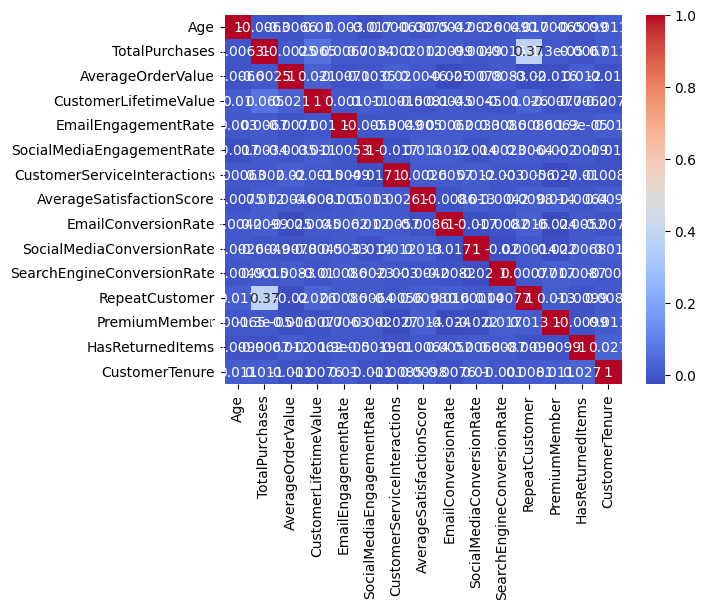

In [ ]:
n_samples, n_features = df.shape
ratio = n_features / n_samples
print(f"Dataset Shape: {df.shape}")
print(f"Feature-to-Sample Ratio: {ratio}")

# Check if the feature-to-sample ratio is greater than 1
if ratio > 1:
    print("The dataset is likely high-dimensional.")
else:
    print("The dataset is not high-dimensional.")

# Check for sparsity
sparsity = (df != 0).mean().mean()
print(f"Sparsity of the dataset: {sparsity:.2f}")

numerical_cols = df.select_dtypes(include=['number']).columns
correlation_matrix = df[numerical_cols].corr()
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm")
plt.show()



## **CLUSTERING ANALYSIS WITHOUT PCA**

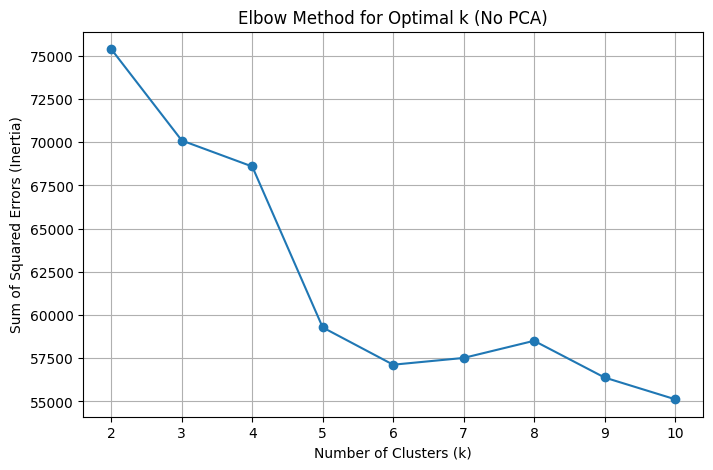


🔍 Clustering Evaluation for k=4 (No PCA)

📊 KMeans Cluster Counts (No PCA, k=4):


,0,Count
0,1,4026
1,2,2405
2,3,719
3,4,2081



📊 Agglomerative Cluster Counts (No PCA, k=4, linkage=ward):


,0,Count
0,1,8406
1,2,204
2,3,86
3,4,535



📈 Evaluation Scores for k=4 (No PCA):


,Method,k,Silhouette,DB,CH,Composite
0,KMeans-NoPCA,4,0.06,2.83,1164.45,-1.61
1,Agglo-NoPCA-ward,4,0.29,1.35,1456.01,0.39


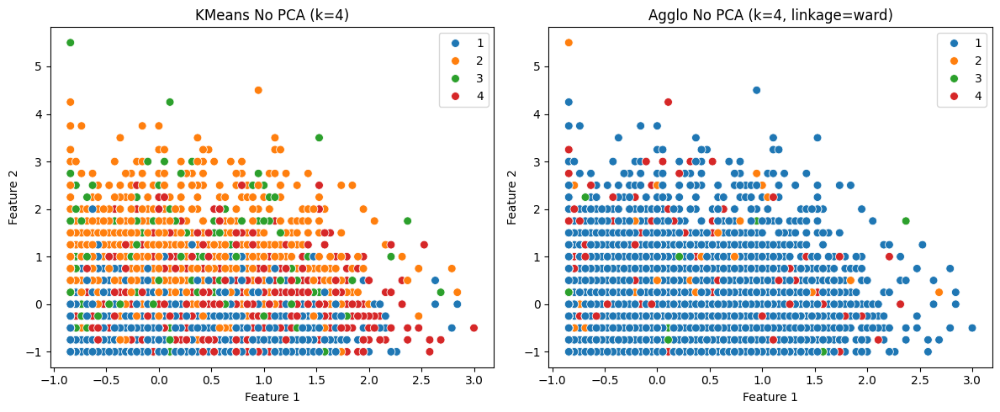


🔍 Clustering Evaluation for k=5 (No PCA)

📊 KMeans Cluster Counts (No PCA, k=5):


,0,Count
0,1,3987
1,2,2305
2,3,650
3,4,111
4,5,2178



📊 Agglomerative Cluster Counts (No PCA, k=5, linkage=ward):


,0,Count
0,1,204
1,2,6422
2,3,86
3,4,535
4,5,1984



📈 Evaluation Scores for k=5 (No PCA):


,Method,k,Silhouette,DB,CH,Composite
0,KMeans-NoPCA,5,0.07,2.42,1361.46,-0.99
1,Agglo-NoPCA-ward,5,0.07,2.41,1224.52,-1.12


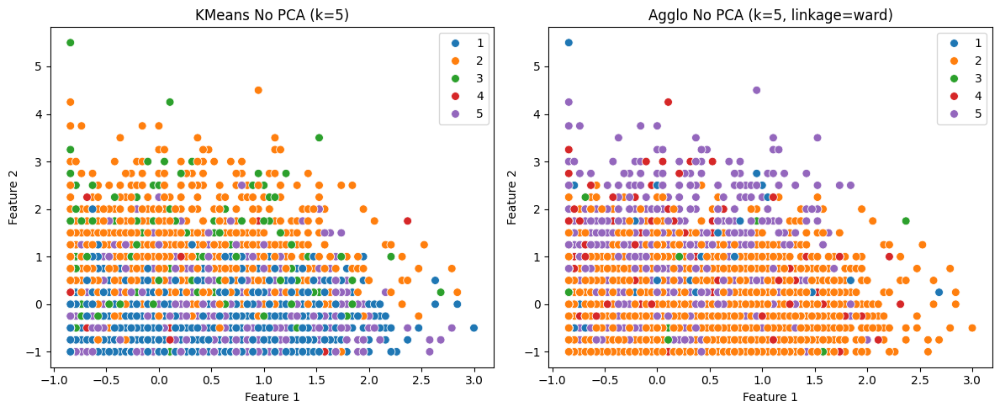


🔍 Clustering Evaluation for k=6 (No PCA)

📊 KMeans Cluster Counts (No PCA, k=6):


,0,Count
0,1,2634
1,2,1855
2,3,556
3,4,111
4,5,1875
5,6,2200



📊 Agglomerative Cluster Counts (No PCA, k=6, linkage=ward):


,0,Count
0,1,6422
1,2,1984
2,3,86
3,4,535
4,5,137
5,6,67



📈 Evaluation Scores for k=6 (No PCA):


,Method,k,Silhouette,DB,CH,Composite
0,KMeans-NoPCA,6,0.06,2.41,1204.01,-1.14
1,Agglo-NoPCA-ward,6,0.07,2.17,1052.14,-1.05


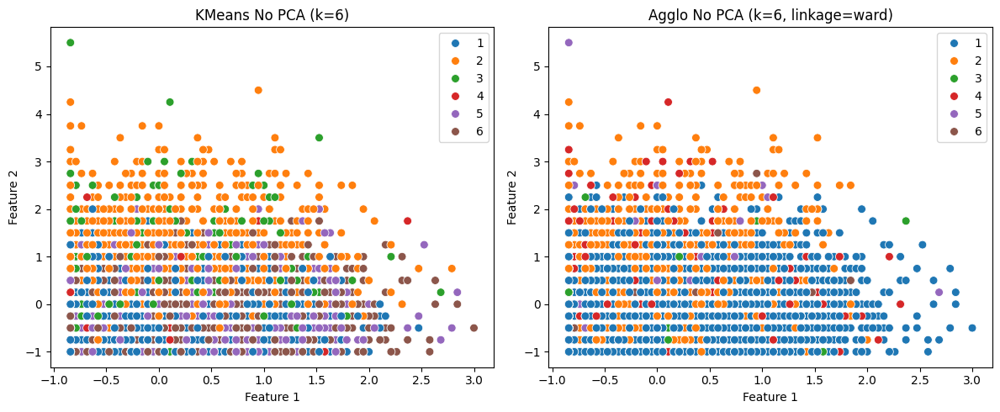


🔍 Clustering Evaluation for k=7 (No PCA)

📊 KMeans Cluster Counts (No PCA, k=7):


,0,Count
0,1,2357
1,2,1339
2,3,435
3,4,129
4,5,1245
5,6,1761
6,7,1965



📊 Agglomerative Cluster Counts (No PCA, k=7, linkage=ward):


,0,Count
0,1,5205
1,2,1984
2,3,1217
3,4,535
4,5,137
5,6,67
6,7,86



📈 Evaluation Scores for k=7 (No PCA):


,Method,k,Silhouette,DB,CH,Composite
0,KMeans-NoPCA,7,0.06,2.41,1043.42,-1.31
1,Agglo-NoPCA-ward,7,0.04,2.38,937.20,-1.40


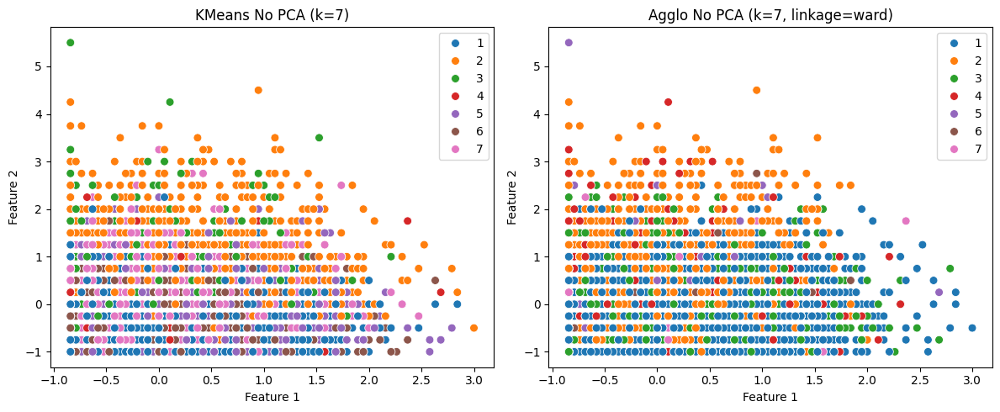


🔍 Clustering Evaluation for k=8 (No PCA)

📊 KMeans Cluster Counts (No PCA, k=8):


,0,Count
0,1,998
1,2,235
2,3,1135
3,4,1789
4,5,713
5,6,1260
6,7,1781
7,8,1320



📊 Agglomerative Cluster Counts (No PCA, k=8, linkage=ward):


,0,Count
0,1,1984
1,2,4729
2,3,1217
3,4,535
4,5,137
5,6,67
6,7,86
7,8,476



📈 Evaluation Scores for k=8 (No PCA):


,Method,k,Silhouette,DB,CH,Composite
0,KMeans-NoPCA,8,0.05,2.58,830.86,-1.70
1,Agglo-NoPCA-ward,8,0.04,2.40,850.93,-1.51


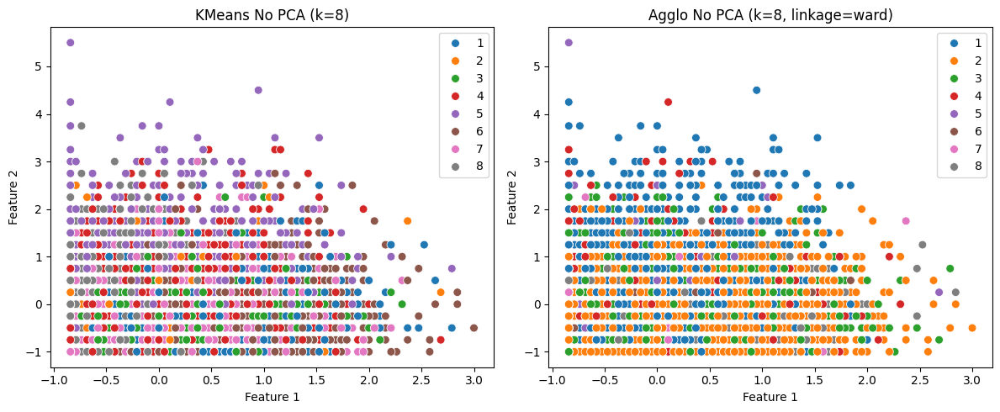


📋 Full Evaluation Metrics Summary (No PCA):


,Method,k,Silhouette,DB,CH,Composite
1,Agglo-NoPCA-ward,4,0.29,1.35,1456.01,0.39
0,KMeans-NoPCA,4,0.06,2.83,1164.45,-1.61
3,Agglo-NoPCA-ward,5,0.07,2.41,1224.52,-1.12
2,KMeans-NoPCA,5,0.07,2.42,1361.46,-0.99
5,Agglo-NoPCA-ward,6,0.07,2.17,1052.14,-1.05
4,KMeans-NoPCA,6,0.06,2.41,1204.01,-1.14
7,Agglo-NoPCA-ward,7,0.04,2.38,937.20,-1.40
6,KMeans-NoPCA,7,0.06,2.41,1043.42,-1.31
9,Agglo-NoPCA-ward,8,0.04,2.40,850.93,-1.51
8,KMeans-NoPCA,8,0.05,2.58,830.86,-1.70



📝 Best Score Comparison Summary (No PCA):


,Method,k,Silhouette,DB,CH,Composite
2,KMeans-NoPCA,5,0.07,2.42,1361.46,-0.99
1,Agglo-NoPCA-ward,4,0.29,1.35,1456.01,0.39


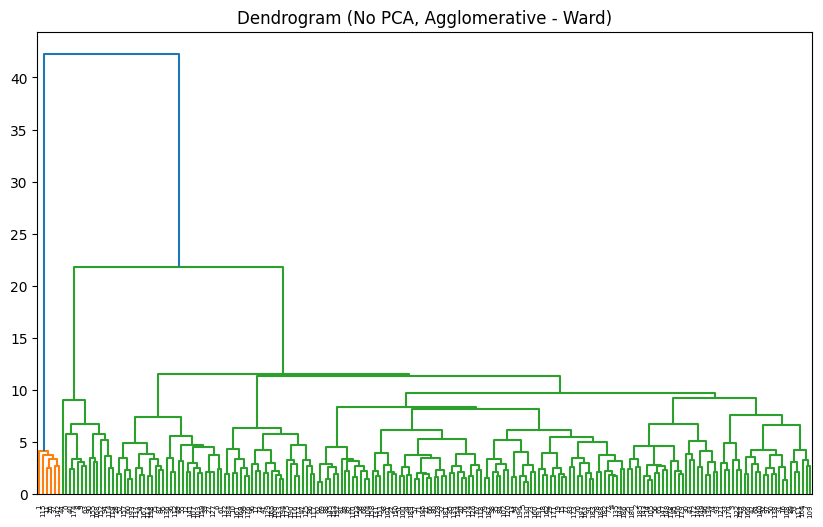

In [ ]:
# -------------------------------------------
# CLUSTERING WITHOUT PCA
# -------------------------------------------

# 1. Imports
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import MiniBatchKMeans, AgglomerativeClustering
from sklearn.metrics import silhouette_score, davies_bouldin_score, calinski_harabasz_score
from scipy.cluster.hierarchy import dendrogram, linkage
from scipy.stats.mstats import winsorize
from sklearn.preprocessing import RobustScaler
from sklearn.decomposition import PCA

# Step 1: Data Preparation (Moved from cell SfDqCa1C7-Dx)
df_processed = df.copy()

# Winsorization to cap outliers
for col in ['AverageOrderValue', 'CustomerLifetimeValue']:
    df_processed[col] = winsorize(df_processed[col], limits=[0.01, 0.01])

features = [
    'Age', 'TotalPurchases', 'AverageOrderValue', 'CustomerLifetimeValue',
    'EmailEngagementRate', 'SocialMediaEngagementRate',
    'CustomerServiceInteractions', 'AverageSatisfactionScore',
    'EmailConversionRate', 'SocialMediaConversionRate',
    'SearchEngineConversionRate', 'RepeatCustomer',
    'PremiumMember', 'HasReturnedItems', 'CustomerTenure'
]

# Step 2: Feature Scaling (Moved from cell SfDqCa1C7-Dx)
scaler = RobustScaler()
df_scaled = scaler.fit_transform(df_processed[features])




# 2. Evaluation Function
def evaluate_clustering(X, labels):
    sil = silhouette_score(X, labels)
    db = davies_bouldin_score(X, labels)
    ch = calinski_harabasz_score(X, labels)
    comp = sil - db + (ch / 1000)
    return sil, db, ch, comp

# 3. Elbow Method for KMeans (no PCA)
sse_no_pca = []
k_range = range(2, 11)
for k in k_range:
    kmeans = MiniBatchKMeans(n_clusters=k, batch_size=100, random_state=42)
    kmeans.fit(df_scaled)
    sse_no_pca.append(kmeans.inertia_)

plt.figure(figsize=(8, 5))
plt.plot(k_range, sse_no_pca, marker='o')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Sum of Squared Errors (Inertia)')
plt.title('Elbow Method for Optimal k (No PCA)')
plt.grid(True)
plt.show()

# 4. Clustering Evaluation & Visualisation (k = 4 to 8)
all_results_no_pca = []

for k in range(4, 9):
    print(f"\n{'='*60}\n🔍 Clustering Evaluation for k={k} (No PCA)\n{'='*60}")
    result_k = []

    # --- MiniBatch KMeans ---
    kmeans = MiniBatchKMeans(n_clusters=k, batch_size=100, random_state=42)
    kmeans_labels = kmeans.fit_predict(df_scaled) + 1
    df_processed[f'Cluster_KMeans_NoPCA_k{k}'] = kmeans_labels
    sil_km, db_km, ch_km, comp_km = evaluate_clustering(df_scaled, kmeans_labels)
    result_k.append({
        'Method': 'KMeans-NoPCA', 'k': k,
        'Silhouette': sil_km, 'DB': db_km, 'CH': ch_km, 'Composite': comp_km
    })

    print(f"\n📊 KMeans Cluster Counts (No PCA, k={k}):")
    display(pd.DataFrame(kmeans_labels).value_counts().sort_index().rename('Count').reset_index().rename(columns={'index': 'Cluster'}))

    # --- Agglomerative Clustering ---
    linkage_method = 'ward'
    ag_model = AgglomerativeClustering(n_clusters=k, linkage=linkage_method)
    ag_labels = ag_model.fit_predict(df_scaled) + 1
    df_processed[f'Cluster_Agglo_NoPCA_k{k}'] = ag_labels
    sil_ag, db_ag, ch_ag, comp_ag = evaluate_clustering(df_scaled, ag_labels)
    result_k.append({
        'Method': f'Agglo-NoPCA-{linkage_method}', 'k': k,
        'Silhouette': sil_ag, 'DB': db_ag, 'CH': ch_ag, 'Composite': comp_ag
    })

    print(f"\n📊 Agglomerative Cluster Counts (No PCA, k={k}, linkage={linkage_method}):")
    display(pd.DataFrame(ag_labels).value_counts().sort_index().rename('Count').reset_index().rename(columns={'index': 'Cluster'}))

    # Store results
    df_k = pd.DataFrame(result_k)
    all_results_no_pca.extend(result_k)
    print(f"\n📈 Evaluation Scores for k={k} (No PCA):")
    display(df_k)

    # Side-by-side scatter plots (first 2 scaled features)
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    sns.scatterplot(x=df_scaled[:, 0], y=df_scaled[:, 1], hue=kmeans_labels, palette='tab10', s=50)
    plt.title(f"KMeans No PCA (k={k})")
    plt.xlabel('Feature 1'); plt.ylabel('Feature 2')

    plt.subplot(1, 2, 2)
    sns.scatterplot(x=df_scaled[:, 0], y=df_scaled[:, 1], hue=ag_labels, palette='tab10', s=50)
    plt.title(f"Agglo No PCA (k={k}, linkage={linkage_method})")
    plt.xlabel('Feature 1'); plt.ylabel('Feature 2')

    plt.tight_layout()
    plt.show()

# 5. Summary Table
df_results_no_pca = pd.DataFrame(all_results_no_pca)
print("\n📋 Full Evaluation Metrics Summary (No PCA):")
display(df_results_no_pca.sort_values(by=['k', 'Method']))

# 6. Best Clustering Without PCA
best_kmeans_no_pca = df_results_no_pca[df_results_no_pca['Method'] == 'KMeans-NoPCA'].sort_values(by='Composite', ascending=False).iloc[0]
best_agglo_no_pca = df_results_no_pca[df_results_no_pca['Method'].str.contains('Agglo')].sort_values(by='Composite', ascending=False).iloc[0]

summary_table_no_pca = pd.DataFrame([best_kmeans_no_pca, best_agglo_no_pca])
print("\n📝 Best Score Comparison Summary (No PCA):")
display(summary_table_no_pca)

# 7. Dendrogram (Optional, if Agglo best)
if 'Agglo' in best_agglo_no_pca['Method']:
    sample_data = pd.DataFrame(df_scaled).sample(n=200, random_state=42)
    linked = linkage(sample_data, method='ward')

    plt.figure(figsize=(10, 6))
    dendrogram(linked)
    plt.title("Dendrogram (No PCA, Agglomerative - Ward)")
    plt.show()

# **#ANALYSIS--CLUSTERING WITH PCA**





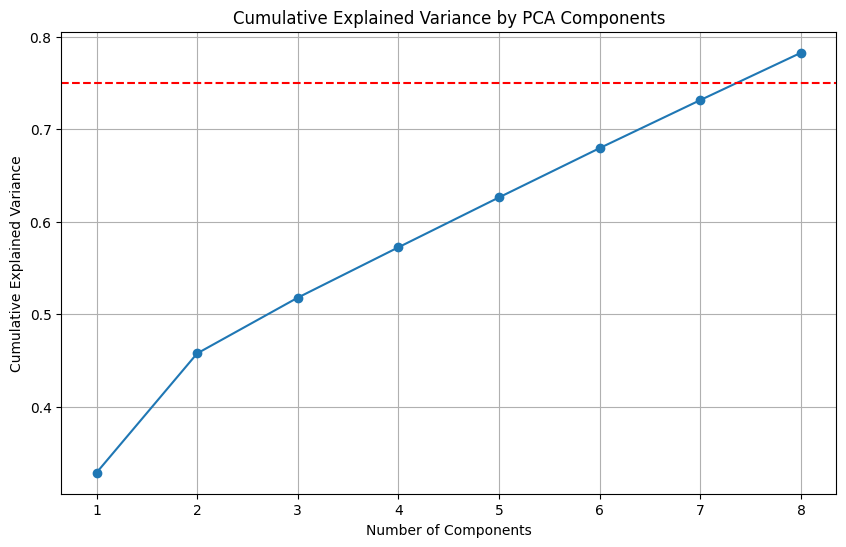


📊 PCA Eigenvalues and Variance Explained:


,Principal Component,Eigenvalue,% Variance Explained,Cumulative % Variance
0,PC1,3.35,32.89,32.89
1,PC2,1.31,12.89,45.78
2,PC3,0.61,6.02,51.80
3,PC4,0.55,5.44,57.24
4,PC5,0.55,5.39,62.64
5,PC6,0.54,5.32,67.96
6,PC7,0.53,5.19,73.15
7,PC8,0.52,5.11,78.26


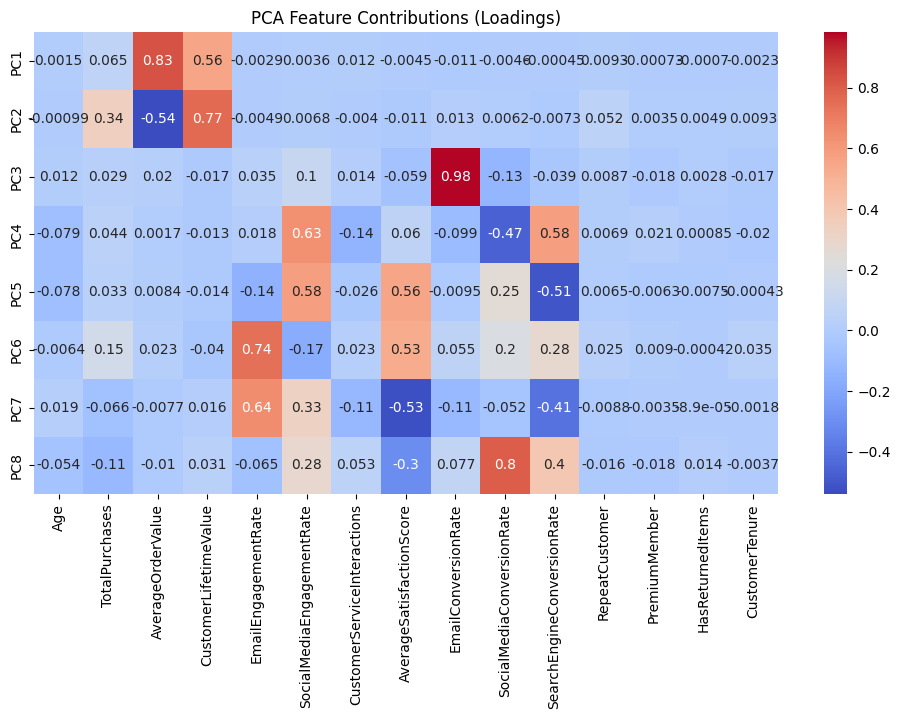

In [ ]:
# =============================== #
# 📌 Part 1: PCA (Principal Component Analysis)
# =============================== #

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from scipy.stats.mstats import winsorize
from sklearn.preprocessing import RobustScaler
from sklearn.decomposition import PCA

# Step 1: Data Preparation
df_processed = df.copy()

# Winsorization to cap outliers
for col in ['AverageOrderValue', 'CustomerLifetimeValue']:
    df_processed[col] = winsorize(df_processed[col], limits=[0.01, 0.01])

features = [
    'Age', 'TotalPurchases', 'AverageOrderValue', 'CustomerLifetimeValue',
    'EmailEngagementRate', 'SocialMediaEngagementRate',
    'CustomerServiceInteractions', 'AverageSatisfactionScore',
    'EmailConversionRate', 'SocialMediaConversionRate',
    'SearchEngineConversionRate', 'RepeatCustomer',
    'PremiumMember', 'HasReturnedItems', 'CustomerTenure'
]

# Step 2: Feature Scaling
scaler = RobustScaler()
df_scaled = scaler.fit_transform(df_processed[features])

# Step 3: Apply PCA (retain 75% of variance)
pca = PCA(n_components=0.75)
pca_data = pca.fit_transform(df_scaled)

# Step 4: Explained Variance Plot
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(pca.explained_variance_ratio_)+1), np.cumsum(pca.explained_variance_ratio_), marker='o')
plt.axhline(y=0.75, color='r', linestyle='--')
plt.title('Cumulative Explained Variance by PCA Components')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.grid(True)
plt.show()

# Step 5: Eigenvalues and Variance Explained
eigenvalues = pca.explained_variance_
explained_variance_ratio = pca.explained_variance_ratio_
cumulative_variance = np.cumsum(explained_variance_ratio)

eigenvalue_df = pd.DataFrame({
    'Principal Component': [f'PC{i+1}' for i in range(len(eigenvalues))],
    'Eigenvalue': np.round(eigenvalues, 4),
    '% Variance Explained': np.round(explained_variance_ratio * 100, 2),
    'Cumulative % Variance': np.round(cumulative_variance * 100, 2)
})
print("\n📊 PCA Eigenvalues and Variance Explained:")
display(eigenvalue_df)

# Step 6: PCA Loadings
pca_loadings_df = pd.DataFrame(
    pca.components_,
    columns=features,
    index=[f'PC{i+1}' for i in range(pca.n_components_)]
)

plt.figure(figsize=(12, 6))
sns.heatmap(pca_loadings_df, cmap="coolwarm", annot=True)
plt.title("PCA Feature Contributions (Loadings)")
plt.show()


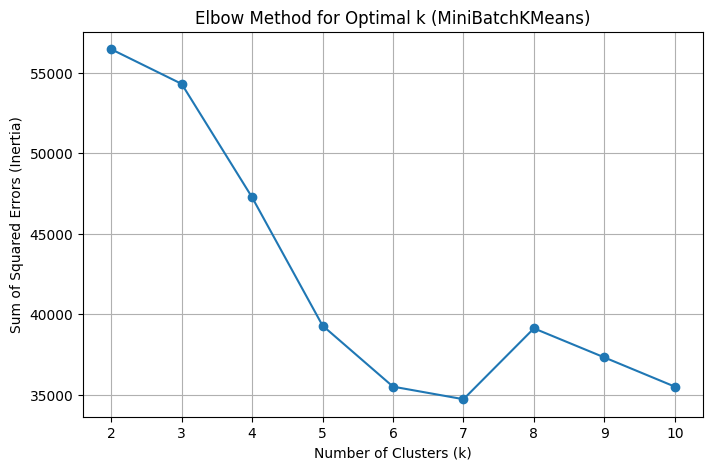


🔍 Clustering Evaluation for k=4

📊 KMeans Cluster Counts (k=4):


,0,Count
0,1,3241
1,2,3397
2,3,2094
3,4,499



📊 Agglomerative Cluster Counts (k=4, linkage=ward):


,0,Count
0,1,8148
1,2,218
2,3,97
3,4,768



📈 Evaluation Scores for k=4:


,Method,k,Silhouette,DB,CH,Composite
0,KMeans,4,0.08,2.27,1780.89,-0.40
1,Agglo-ward,4,0.32,1.31,2153.04,1.16


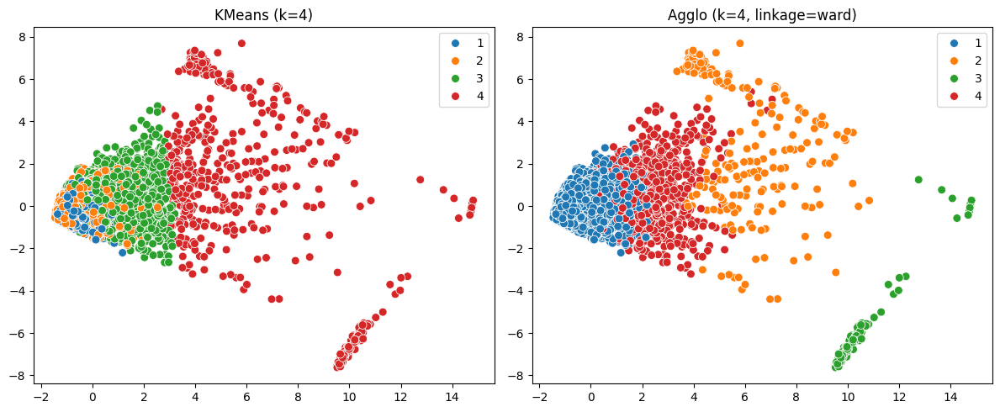


🔍 Clustering Evaluation for k=5

📊 KMeans Cluster Counts (k=5):


,0,Count
0,1,2322
1,2,2553
2,3,114
3,4,539
4,5,3703



📊 Agglomerative Cluster Counts (k=5, linkage=ward):


,0,Count
0,1,2581
1,2,218
2,3,97
3,4,768
4,5,5567



📈 Evaluation Scores for k=5:


,Method,k,Silhouette,DB,CH,Composite
0,KMeans,5,0.10,1.93,2024.39,0.19
1,Agglo-ward,5,0.09,2.25,1805.63,-0.36


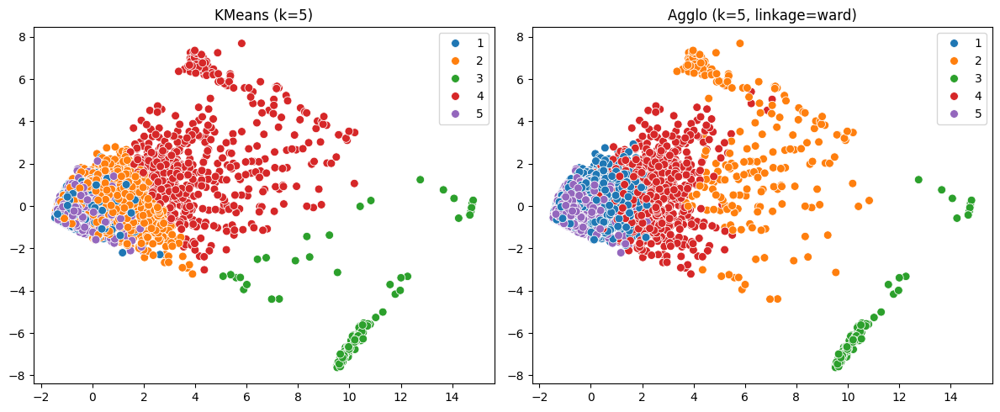


🔍 Clustering Evaluation for k=6

📊 KMeans Cluster Counts (k=6):


,0,Count
0,1,2036
1,2,1801
2,3,113
3,4,300
4,5,3435
5,6,1546



📊 Agglomerative Cluster Counts (k=6, linkage=ward):


,0,Count
0,1,218
1,2,5567
2,3,97
3,4,768
4,5,1803
5,6,778



📈 Evaluation Scores for k=6:


,Method,k,Silhouette,DB,CH,Composite
0,KMeans,6,0.11,1.79,1985.08,0.31
1,Agglo-ward,6,0.08,2.11,1600.23,-0.43


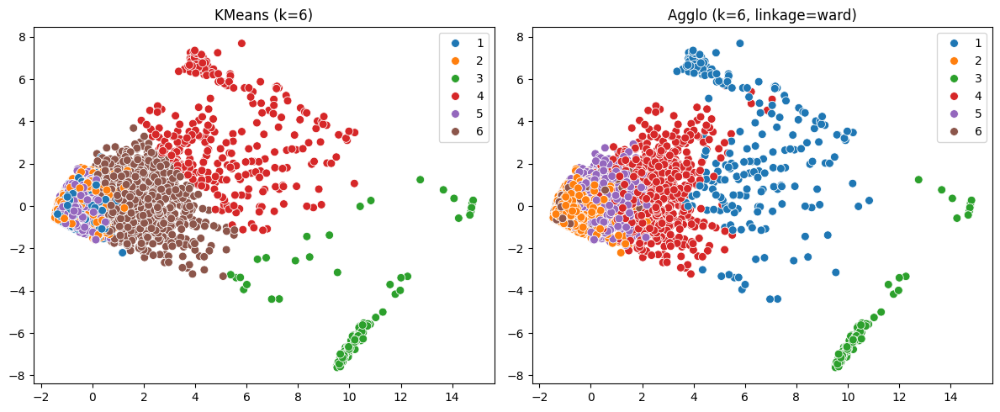


🔍 Clustering Evaluation for k=7

📊 KMeans Cluster Counts (k=7):


,0,Count
0,1,1459
1,2,1729
2,3,121
3,4,195
4,5,2802
5,6,2040
6,7,885



📊 Agglomerative Cluster Counts (k=7, linkage=ward):


,0,Count
0,1,5567
1,2,768
2,3,97
3,4,99
4,5,1803
5,6,778
6,7,119



📈 Evaluation Scores for k=7:


,Method,k,Silhouette,DB,CH,Composite
0,KMeans,7,0.11,1.76,1788.03,0.14
1,Agglo-ward,7,0.08,1.95,1443.59,-0.43


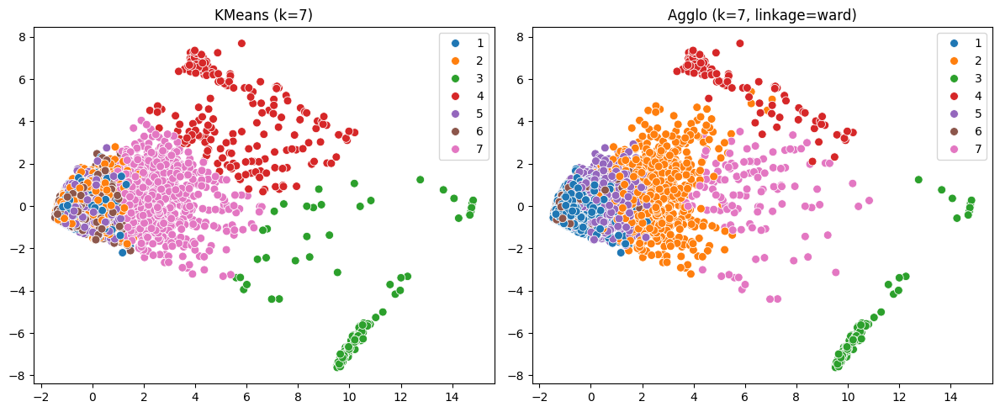


🔍 Clustering Evaluation for k=8

📊 KMeans Cluster Counts (k=8):


,0,Count
0,1,1028
1,2,1191
2,3,1067
3,4,258
4,5,1194
5,6,1890
6,7,1496
7,8,1107



📊 Agglomerative Cluster Counts (k=8, linkage=ward):


,0,Count
0,1,3491
1,2,2076
2,3,97
3,4,768
4,5,1803
5,6,778
6,7,119
7,8,99



📈 Evaluation Scores for k=8:


,Method,k,Silhouette,DB,CH,Composite
0,KMeans,8,0.08,1.87,1234.60,-0.55
1,Agglo-ward,8,0.06,2.14,1334.13,-0.75


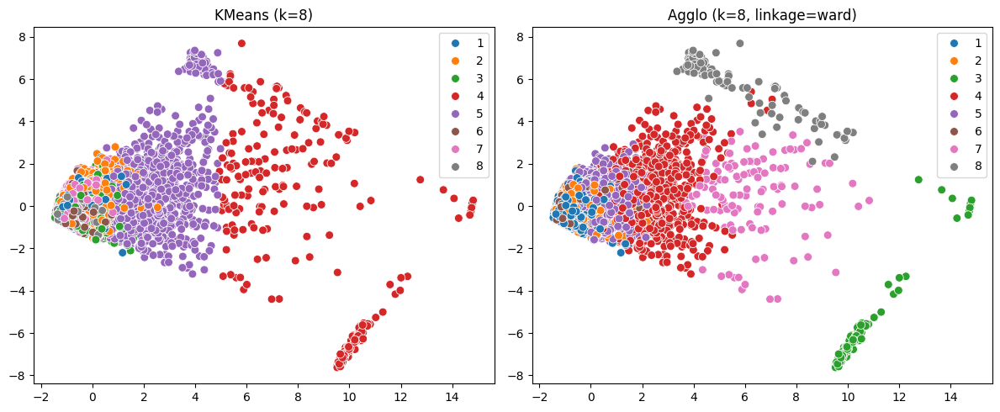


📋 Full Evaluation Metrics Summary:


,Method,k,Silhouette,DB,CH,Composite
1,Agglo-ward,4,0.32,1.31,2153.04,1.16
0,KMeans,4,0.08,2.27,1780.89,-0.40
3,Agglo-ward,5,0.09,2.25,1805.63,-0.36
2,KMeans,5,0.10,1.93,2024.39,0.19
5,Agglo-ward,6,0.08,2.11,1600.23,-0.43
4,KMeans,6,0.11,1.79,1985.08,0.31
7,Agglo-ward,7,0.08,1.95,1443.59,-0.43
6,KMeans,7,0.11,1.76,1788.03,0.14
9,Agglo-ward,8,0.06,2.14,1334.13,-0.75
8,KMeans,8,0.08,1.87,1234.60,-0.55



📝 Best Score Comparison Summary:


,Method,k,Silhouette,DB,CH,Composite
0,KMeans,6,0.11,1.79,1985.08,0.31
1,Agglo-ward,4,0.32,1.31,2153.04,1.16



✅ Best overall clustering method: Agglo-ward with k=4


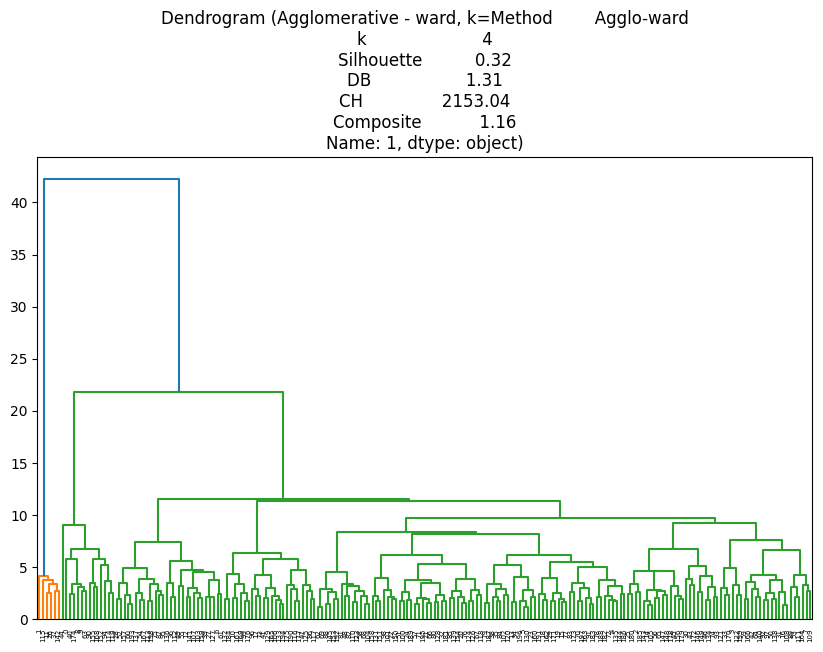

In [ ]:
# -------------------------------------------
# PART 2: FINAL CLUSTERING ANALYSIS WITH EVALUATION
# -------------------------------------------

# 1. Imports
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import MiniBatchKMeans, AgglomerativeClustering
from sklearn.metrics import silhouette_score, davies_bouldin_score, calinski_harabasz_score
from scipy.cluster.hierarchy import dendrogram, linkage

# 2. Evaluation Function
def evaluate_clustering(X, labels):
    sil = silhouette_score(X, labels)
    db = davies_bouldin_score(X, labels)
    ch = calinski_harabasz_score(X, labels)
    comp = sil - db + (ch / 1000)
    return sil, db, ch, comp

# 3. Elbow Method for KMeans
sse = []
k_range = range(2, 11)
for k in k_range:
    kmeans = MiniBatchKMeans(n_clusters=k, batch_size=100, random_state=42)
    kmeans.fit(pca_data)
    sse.append(kmeans.inertia_)

plt.figure(figsize=(8, 5))
plt.plot(k_range, sse, marker='o')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Sum of Squared Errors (Inertia)')
plt.title('Elbow Method for Optimal k (MiniBatchKMeans)')
plt.grid(True)
plt.show()

# 4. Clustering Evaluation & Visualisation (k = 4 to 8)
all_results = []

for k in range(4, 9):
    print(f"\n{'='*60}\n🔍 Clustering Evaluation for k={k}\n{'='*60}")
    result_k = []

    # --- KMeans ---
    kmeans = MiniBatchKMeans(n_clusters=k, batch_size=100, random_state=42)
    kmeans_labels = kmeans.fit_predict(pca_data) + 1
    df_processed[f'Cluster_KMeans_k{k}'] = kmeans_labels
    sil_km, db_km, ch_km, comp_km = evaluate_clustering(pca_data, kmeans_labels)
    result_k.append({
        'Method': 'KMeans', 'k': k,
        'Silhouette': sil_km, 'DB': db_km, 'CH': ch_km, 'Composite': comp_km
    })

    # Cluster counts
    print(f"\n📊 KMeans Cluster Counts (k={k}):")
    display(pd.DataFrame(kmeans_labels).value_counts().sort_index().rename('Count').reset_index().rename(columns={'index': 'Cluster'}))

    # --- Agglomerative with Ward Linkage ---
    linkage_method = 'ward'
    ag_model = AgglomerativeClustering(n_clusters=k, linkage=linkage_method)
    ag_labels = ag_model.fit_predict(pca_data) + 1
    df_processed[f'Cluster_Agglo_k{k}'] = ag_labels
    sil_ag, db_ag, ch_ag, comp_ag = evaluate_clustering(pca_data, ag_labels)
    result_k.append({
        'Method': f'Agglo-{linkage_method}', 'k': k,
        'Silhouette': sil_ag, 'DB': db_ag, 'CH': ch_ag, 'Composite': comp_ag
    })

    print(f"\n📊 Agglomerative Cluster Counts (k={k}, linkage={linkage_method}):")
    display(pd.DataFrame(ag_labels).value_counts().sort_index().rename('Count').reset_index().rename(columns={'index': 'Cluster'}))

    # Show evaluation table for this k
    df_k = pd.DataFrame(result_k)
    all_results.extend(result_k)
    print(f"\n📈 Evaluation Scores for k={k}:")
    display(df_k)

    # --- Side-by-Side Scatter Plot ---
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    sns.scatterplot(x=pca_data[:, 0], y=pca_data[:, 1], hue=kmeans_labels, palette='tab10', s=50)
    plt.title(f"KMeans (k={k})")

    plt.subplot(1, 2, 2)
    sns.scatterplot(x=pca_data[:, 0], y=pca_data[:, 1], hue=ag_labels, palette='tab10', s=50)
    plt.title(f"Agglo (k={k}, linkage={linkage_method})")

    plt.tight_layout()
    plt.show()

# 5. Evaluation Summary Table
df_results = pd.DataFrame(all_results)
print("\n📋 Full Evaluation Metrics Summary:")
display(df_results.sort_values(by=['k', 'Method']))

# 6. Best Score Comparison Summary (in table)
best_kmeans = df_results[df_results['Method'] == 'KMeans'].sort_values(by='Composite', ascending=False).iloc[0]
best_agglo = df_results[df_results['Method'].str.contains('Agglo')].sort_values(by='Composite', ascending=False).iloc[0]

summary_table = pd.DataFrame([
    {
        'Method': best_kmeans['Method'],
        'k': best_kmeans['k'],
        'Silhouette': best_kmeans['Silhouette'],
        'DB': best_kmeans['DB'],
        'CH': best_kmeans['CH'],
        'Composite': best_kmeans['Composite']
    },
    {
        'Method': best_agglo['Method'],
        'k': best_agglo['k'],
        'Silhouette': best_agglo['Silhouette'],
        'DB': best_agglo['DB'],
        'CH': best_agglo['CH'],
        'Composite': best_agglo['Composite']
    }
])
print("\n📝 Best Score Comparison Summary:")
display(summary_table)

# Best model overall
best_overall = best_kmeans if best_kmeans['Composite'] > best_agglo['Composite'] else best_agglo
print(f"\n✅ Best overall clustering method: {best_overall['Method']} with k={best_overall['k']}")


# 8. Dendrogram
if 'Agglo' in best_overall['Method']:
    sample_data = pd.DataFrame(df_scaled).sample(n=200, random_state=42)
    linked = linkage(sample_data, method='ward')

    plt.figure(figsize=(10, 6))
    dendrogram(linked)
    plt.title(f"Dendrogram (Agglomerative - ward, k={best_agglo})")
    plt.show()



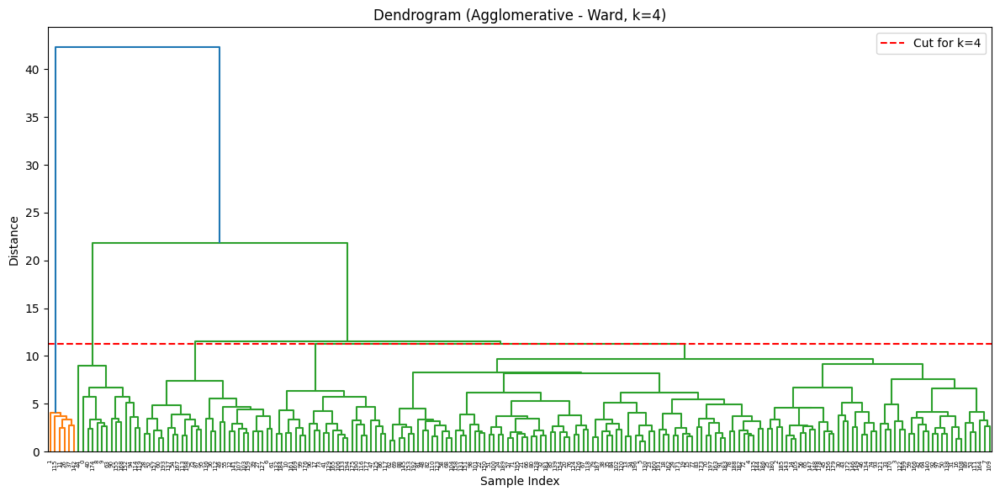

In [ ]:
from scipy.cluster.hierarchy import dendrogram, linkage
import matplotlib.pyplot as plt
import numpy as np

# 8. Dendrogram for Agglomerative Clustering with k=4
sample_data = pd.DataFrame(df_scaled).sample(n=200, random_state=42)
linked = linkage(sample_data, method='ward')

plt.figure(figsize=(12, 6))
dendrogram(linked, color_threshold=None)

# Draw horizontal line to show cut for k=4
cut_level = sorted(linked[:, 2], reverse=True)[3]  # 4 clusters = 3 merges from top
plt.axhline(y=cut_level, color='red', linestyle='--', label='Cut for k=4')

plt.title("Dendrogram (Agglomerative - Ward, k=4)")
plt.xlabel("Sample Index")
plt.ylabel("Distance")
plt.legend()
plt.tight_layout()
plt.show()


🔍 PCA Loadings (Feature Contributions to Principal Components):


,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8
Age,0.00,-0.00,0.01,-0.08,-0.08,-0.01,0.02,-0.05
TotalPurchases,0.06,0.34,0.03,0.04,0.03,0.15,-0.07,-0.11
AverageOrderValue,0.83,-0.54,0.02,0.00,0.01,0.02,-0.01,-0.01
CustomerLifetimeValue,0.56,0.77,-0.02,-0.01,-0.01,-0.04,0.02,0.03
EmailEngagementRate,-0.00,-0.00,0.04,0.02,-0.14,0.74,0.64,-0.06
SocialMediaEngagementRate,0.00,0.01,0.10,0.63,0.58,-0.17,0.33,0.28
CustomerServiceInteractions,0.01,-0.00,0.01,-0.14,-0.03,0.02,-0.11,0.05
AverageSatisfactionScore,-0.00,-0.01,-0.06,0.06,0.56,0.53,-0.53,-0.30
EmailConversionRate,-0.01,0.01,0.98,-0.10,-0.01,0.05,-0.11,0.08
SocialMediaConversionRate,-0.00,0.01,-0.13,-0.47,0.25,0.20,-0.05,0.80



📌 Most Influential Features (Top 3 from PC1 and PC2):
TotalPurchases, CustomerLifetimeValue, AverageOrderValue

🔍 MiniBatch KMeans (k=6) Cluster Profiling

📦 Cluster Sizes:


,count
Cluster_KMeans_k6,
1,2036
2,1801
3,113
4,300
5,3435
6,1546


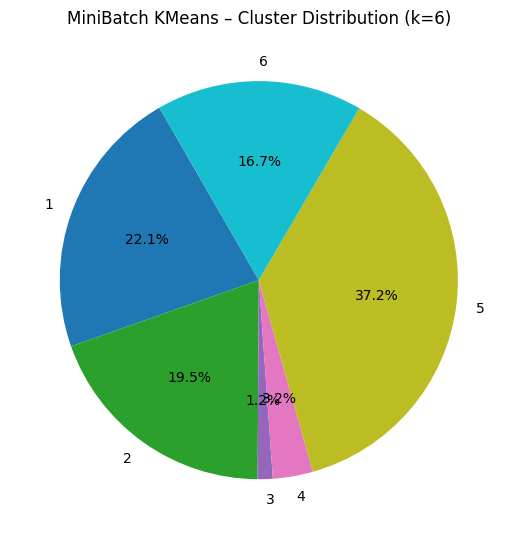

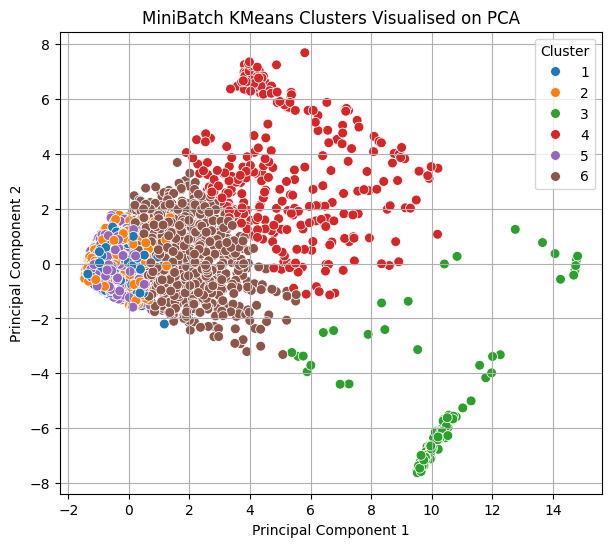


📊 Cluster Profiles – Feature Means (k=6):


,Age,TotalPurchases,AverageOrderValue,CustomerLifetimeValue,EmailEngagementRate,SocialMediaEngagementRate,CustomerServiceInteractions,AverageSatisfactionScore,EmailConversionRate,SocialMediaConversionRate,SearchEngineConversionRate,RepeatCustomer,PremiumMember,HasReturnedItems,CustomerTenure
Cluster_KMeans_k6,,,,,,,,,,,,,,,
1,35.17,4.90,56.17,254.15,0.32,0.29,1.92,6.42,0.16,0.17,0.33,0.91,0.25,0.33,54.57
2,35.67,5.34,62.29,309.57,0.31,0.29,2.06,7.05,0.36,0.20,0.17,0.93,0.22,0.33,54.64
3,35.34,4.96,1223.78,1117.09,0.28,0.30,2.29,6.94,0.19,0.19,0.21,0.88,0.22,0.27,51.70
4,35.56,7.77,342.16,3563.97,0.27,0.30,2.10,6.85,0.19,0.20,0.19,0.98,0.24,0.37,56.18
5,35.56,4.63,55.29,230.99,0.25,0.28,1.99,7.25,0.14,0.21,0.14,0.90,0.24,0.33,55.04
6,35.73,6.17,209.14,1023.12,0.28,0.28,2.03,6.94,0.18,0.20,0.19,0.96,0.23,0.35,54.76



📈 Distribution of Most Influential Features by Cluster:


/tmp/ipython-input-90-1841652009.py:56: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




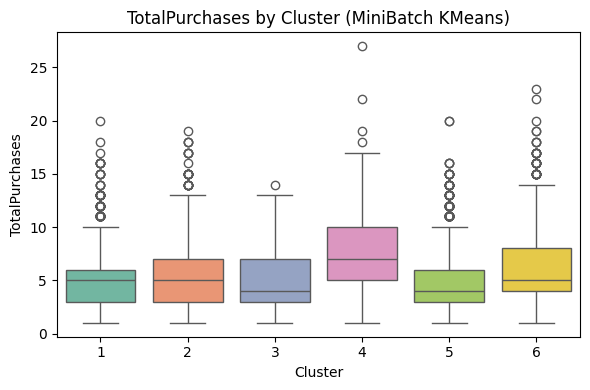

/tmp/ipython-input-90-1841652009.py:56: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




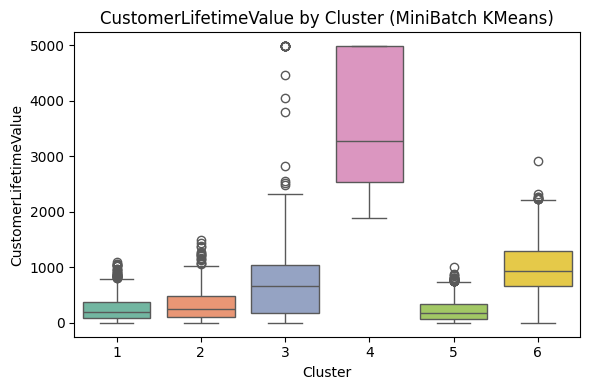

/tmp/ipython-input-90-1841652009.py:56: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




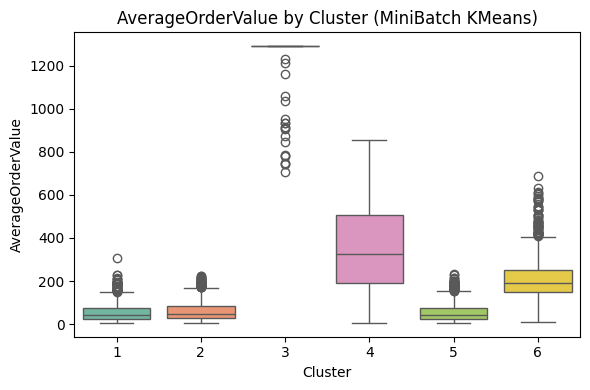


🔍 Agglomerative Clustering (k=4) Cluster Profiling

📦 Cluster Sizes:


,count
Cluster_Agglo_k4,
1,8148
2,218
3,97
4,768


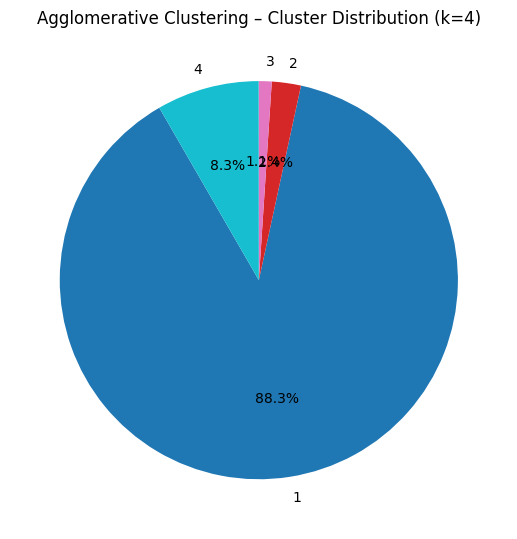

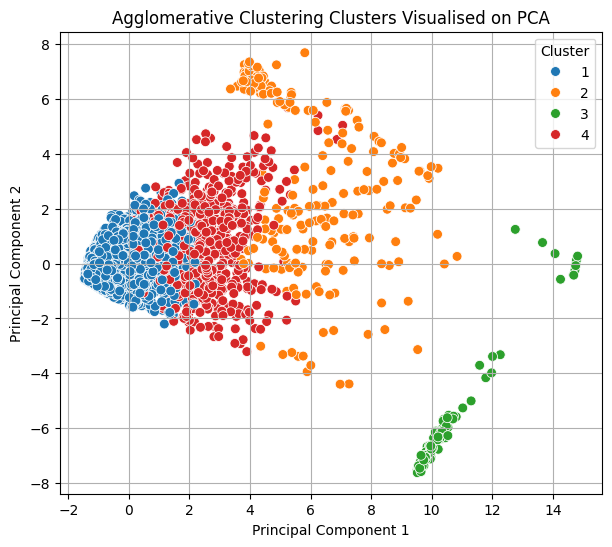


📊 Cluster Profiles – Feature Means (k=4):


,Age,TotalPurchases,AverageOrderValue,CustomerLifetimeValue,EmailEngagementRate,SocialMediaEngagementRate,CustomerServiceInteractions,AverageSatisfactionScore,EmailConversionRate,SocialMediaConversionRate,SearchEngineConversionRate,RepeatCustomer,PremiumMember,HasReturnedItems,CustomerTenure
Cluster_Agglo_k4,,,,,,,,,,,,,,,
1,35.44,5.03,69.50,322.87,0.28,0.29,1.99,6.95,0.20,0.20,0.20,0.92,0.24,0.33,54.79
2,36.61,6.28,429.48,3705.75,0.25,0.31,2.17,6.86,0.21,0.18,0.19,0.96,0.24,0.35,53.57
3,34.02,5.34,1285.46,1018.08,0.29,0.30,2.25,6.96,0.18,0.19,0.21,0.91,0.21,0.29,51.73
4,36.26,6.55,255.35,1443.09,0.30,0.27,2.06,7.09,0.20,0.20,0.22,0.95,0.24,0.35,55.78



📈 Distribution of Most Influential Features by Cluster:


/tmp/ipython-input-90-1841652009.py:56: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




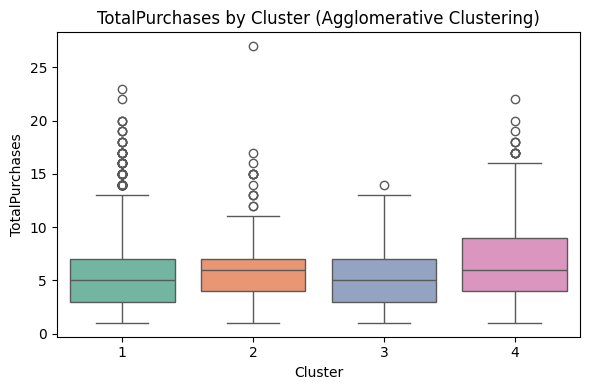

/tmp/ipython-input-90-1841652009.py:56: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




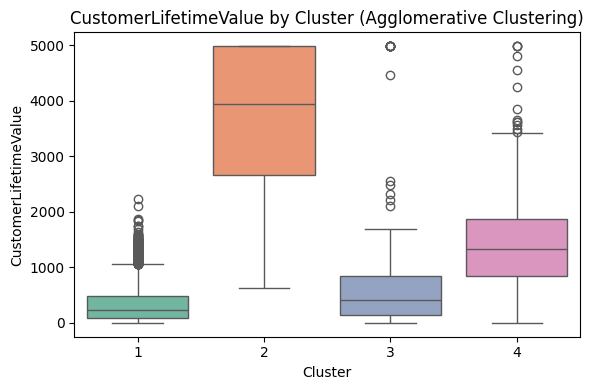

/tmp/ipython-input-90-1841652009.py:56: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




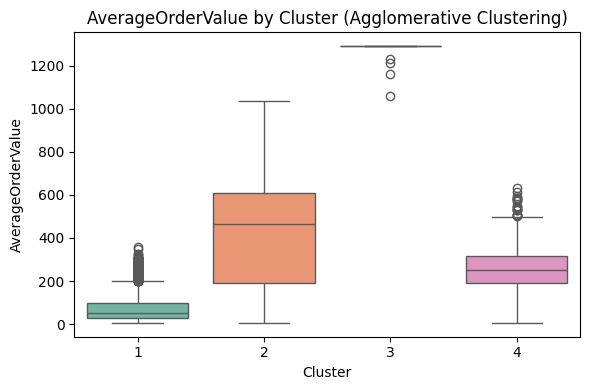


=== Mean PC scores per cluster ===


,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8
Cluster,,,,,,,,
1,-0.50,-0.07,-0,-0,0.01,-0.01,0.01,-0
2,6.07,2.84,0.05,-0.01,0.03,-0.31,0.05,0.05
3,10.59,-5.82,0.10,0.10,0.09,0.25,-0.06,-0.09
4,2.26,0.62,0.02,0.04,-0.09,0.14,-0.07,0.02


In [ ]:
# -------------------------------------------
# PART 3: PCA–Cluster Interpretation & Profiling
# -------------------------------------------

# 1. PCA Loadings – Feature Contributions to Each Component
pca_loadings = pd.DataFrame(pca.components_.T, index=features, columns=[f'PC{i+1}' for i in range(pca.n_components_)])
print("🔍 PCA Loadings (Feature Contributions to Principal Components):")
display(pca_loadings)

# Identify most influential features from first two components
top_features_pc1 = pca_loadings['PC1'].abs().sort_values(ascending=False).head(3).index.tolist()
top_features_pc2 = pca_loadings['PC2'].abs().sort_values(ascending=False).head(3).index.tolist()
important_features = list(set(top_features_pc1 + top_features_pc2))

print("\n📌 Most Influential Features (Top 3 from PC1 and PC2):")
print(", ".join(important_features))

def profile_and_visualise_clusters(df, pca_coords, cluster_col, method_name, k_value):
    print(f"\n============================")
    print(f"🔍 {method_name} (k={k_value}) Cluster Profiling")
    print(f"============================")

    # 1. Cluster Sizes
    cluster_sizes = df[cluster_col].value_counts().sort_index()
    print("\n📦 Cluster Sizes:")
    display(cluster_sizes)

    # Pie Chart for Cluster Proportions
    plt.figure(figsize=(5.5, 5.5))
    cluster_sizes.plot.pie(autopct='%1.1f%%', startangle=120, colormap='tab10')
    plt.title(f"{method_name} – Cluster Distribution (k={k_value})")
    plt.ylabel("")
    plt.tight_layout()
    plt.show()

    # 2. PCA Scatter Plot Coloured by Cluster
    plt.figure(figsize=(7, 6))
    sns.scatterplot(x=pca_coords[:, 0], y=pca_coords[:, 1], hue=df[cluster_col], palette='tab10', s=50)
    plt.title(f"{method_name} Clusters Visualised on PCA")
    plt.xlabel("Principal Component 1")
    plt.ylabel("Principal Component 2")
    plt.legend(title="Cluster")
    plt.grid(True)
    plt.show()

    # 3. Cluster Profile Table (Mean of Original Features)
    profile_features = features + [cluster_col]
    cluster_profile = df[profile_features].groupby(cluster_col).mean().round(2)
    print(f"\n📊 Cluster Profiles – Feature Means (k={k_value}):")
    display(cluster_profile)

    # 4. Feature Distribution Boxplots (Important Features)
    print("\n📈 Distribution of Most Influential Features by Cluster:")
    for feature in important_features:
        plt.figure(figsize=(6, 4))
        sns.boxplot(x=df[cluster_col], y=df[feature], palette='Set2')
        plt.title(f"{feature} by Cluster ({method_name})")
        plt.xlabel("Cluster")
        plt.ylabel(feature)
        plt.tight_layout()
        plt.show()

# Run for MiniBatch KMeans (k = 6)
profile_and_visualise_clusters(
    df=df_processed,
    pca_coords=pca_data,
    cluster_col='Cluster_KMeans_k6',
    method_name='MiniBatch KMeans',
    k_value=6
)

# Run for Agglomerative Clustering (k = 4)
profile_and_visualise_clusters(
    df=df_processed,
    pca_coords=pca_data,
    cluster_col='Cluster_Agglo_k4',
    method_name='Agglomerative Clustering',
    k_value=4
)

# Get the column name of the best clustering result
best_k = best_overall['k']
best_method = best_overall['Method']
cluster_column = ''

if best_method == 'KMeans':
    cluster_column = f'Cluster_KMeans_k{best_k}'
elif 'Agglo' in best_method:
    cluster_column = f'Cluster_Agglo_k{best_k}'


# Create PCA scores DataFrame and append cluster label
pca_scores_df = pd.DataFrame(pca_data, columns=[f'PC{i+1}' for i in range(pca_data.shape[1])])
pca_scores_df['Cluster'] = df_processed[cluster_column].values

# Step 4: Compute mean PC scores per cluster
cluster_pc_means = pca_scores_df.groupby('Cluster').mean().round(2)
print("\n=== Mean PC scores per cluster ===")
display(cluster_pc_means)

In [ ]:
# Example for MiniBatch KMeans with k=6
cluster_col = 'Cluster_Agglo_k4'

# Create PCA scores DataFrame and append cluster label
pca_scores_df = pd.DataFrame(pca_data, columns=[f'PC{i+1}' for i in range(pca_data.shape[1])])
pca_scores_df[cluster_col] = df_processed[cluster_col].values

# Compute mean PC scores per cluster
mean_pc_scores = pca_scores_df.groupby(cluster_col).mean().round(2)
print(f"\n📌 Mean Principal Component Scores per Cluster ({cluster_col}):")
display(mean_pc_scores)



📌 Mean Principal Component Scores per Cluster (Cluster_Agglo_k4):


,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8
Cluster_Agglo_k4,,,,,,,,
1,-0.50,-0.07,-0,-0,0.01,-0.01,0.01,-0
2,6.07,2.84,0.05,-0.01,0.03,-0.31,0.05,0.05
3,10.59,-5.82,0.10,0.10,0.09,0.25,-0.06,-0.09
4,2.26,0.62,0.02,0.04,-0.09,0.14,-0.07,0.02



📊 PCA Eigenvalues and Variance Explained:


,Principal Component,Eigenvalue,% Variance Explained,Cumulative % Variance
0,PC1,3.35,32.89,32.89
1,PC2,1.31,12.89,45.78
2,PC3,0.61,6.02,51.80
3,PC4,0.55,5.44,57.24
4,PC5,0.55,5.39,62.64
5,PC6,0.54,5.32,67.96
6,PC7,0.53,5.19,73.15
7,PC8,0.52,5.11,78.26


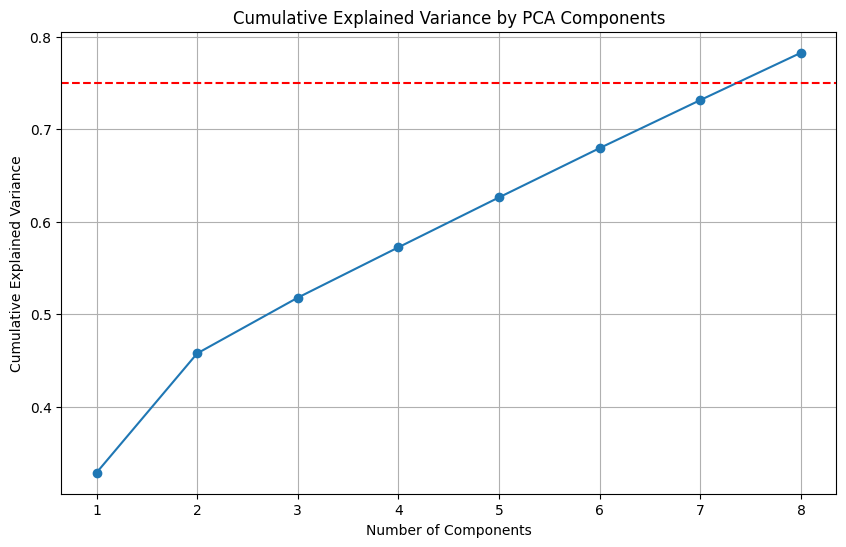

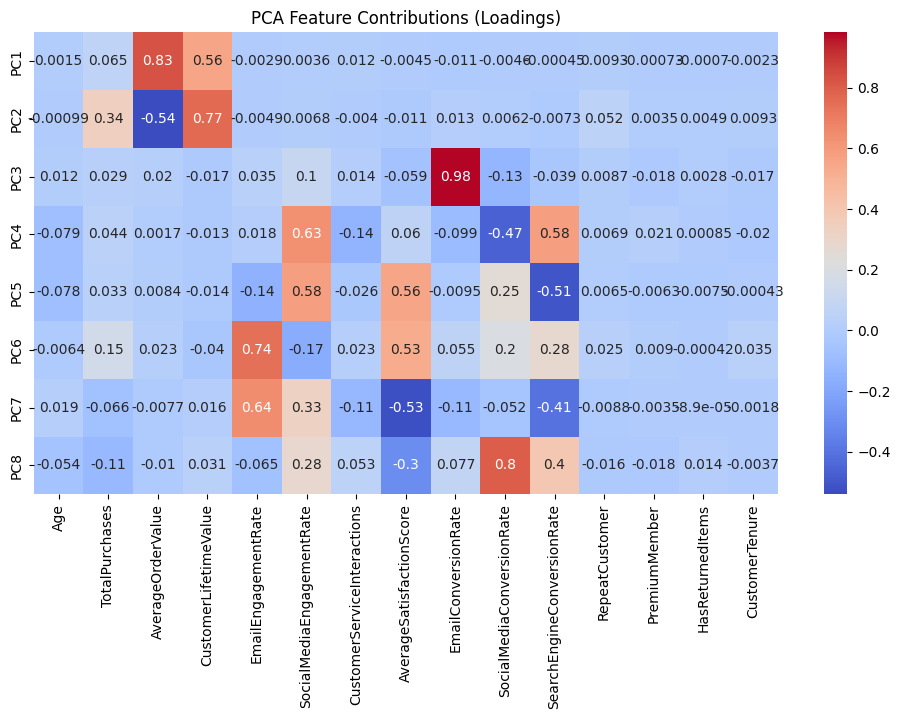

In [ ]:
# ===============================
# 📦 Imports
# ===============================
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

from scipy.stats.mstats import winsorize
from sklearn.preprocessing import RobustScaler
from sklearn.decomposition import PCA
from sklearn.cluster import AgglomerativeClustering, MiniBatchKMeans
from sklearn.metrics import silhouette_score, davies_bouldin_score, calinski_harabasz_score
from scipy.cluster.hierarchy import linkage as scipy_linkage, dendrogram

# ===============================
# 📌 Data Preparation
# ===============================

df_processed = df.copy()

# Winsorization for capping outliers
for col in ['AverageOrderValue', 'CustomerLifetimeValue']:
    df_processed[col] = winsorize(df_processed[col], limits=[0.01, 0.01])

# Feature selection
features = [
    'Age', 'TotalPurchases', 'AverageOrderValue', 'CustomerLifetimeValue',
    'EmailEngagementRate', 'SocialMediaEngagementRate',
    'CustomerServiceInteractions', 'AverageSatisfactionScore',
    'EmailConversionRate', 'SocialMediaConversionRate',
    'SearchEngineConversionRate', 'RepeatCustomer',
    'PremiumMember', 'HasReturnedItems', 'CustomerTenure'
]

# Scaling with RobustScaler
scaler = RobustScaler()
df_scaled = scaler.fit_transform(df_processed[features])

# ===============================
# 📌 Principal Component Analysis (PCA)
# ===============================

# Apply PCA to retain 75% of variance
pca = PCA(n_components=0.75)
pca_data = pca.fit_transform(df_scaled)

# Explained variance metrics
eigenvalues = pca.explained_variance_
explained_variance_ratio = pca.explained_variance_ratio_
cumulative_variance = np.cumsum(explained_variance_ratio)

# Display eigenvalues and variance explained
eigenvalue_df = pd.DataFrame({
    'Principal Component': [f'PC{i+1}' for i in range(len(eigenvalues))],
    'Eigenvalue': np.round(eigenvalues, 4),
    '% Variance Explained': np.round(explained_variance_ratio * 100, 2),
    'Cumulative % Variance': np.round(cumulative_variance * 100, 2)
})

print("\n📊 PCA Eigenvalues and Variance Explained:")
display(eigenvalue_df)

# Plot cumulative explained variance
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(explained_variance_ratio)+1), cumulative_variance, marker='o')
plt.axhline(y=0.75, color='red', linestyle='--')
plt.title('Cumulative Explained Variance by PCA Components')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.grid(True)
plt.show()

# ===============================
# 📌 PCA Loadings (Feature Contributions)
# ===============================

pca_loadings = pd.DataFrame(
    pca.components_,
    columns=features,
    index=[f'PC{i+1}' for i in range(len(pca.components_))]
)

plt.figure(figsize=(12, 6))
sns.heatmap(pca_loadings, cmap="coolwarm", annot=True)
plt.title("PCA Feature Contributions (Loadings)")
plt.show()


In [ ]:
!pip install opendatasets --upgrade --quiet

In [ ]:
import opendatasets as od

dataset = 'https://www.kaggle.com/datasets/noir1112/e-commerce-customer-engagement?select=ecommerce_customer_data.csv'

od.download(dataset)

Skipping, found downloaded files in "./e-commerce-customer-engagement" (use force=True to force download)


In [ ]:
import pandas as pd

# Load the dataset
df = pd.read_csv('/content/e-commerce-customer-engagement/ecommerce_customer_data.csv')

# Inspect the dataset
print("Dataset Shape:", df.shape)  # Dimensions of the dataset
print(df.info())  # Summary of column data types and missing values
print(df.head())  # First few rows for a quick preview

import pandas as pd
from tabulate import tabulate
import io
import re

# Capture the output of df.info()
buffer = io.StringIO()
df.info(buf=buffer)
info_string = buffer.getvalue()

# Parse the output to extract column information
lines = info_string.split('\n')[3:-2]  # Extract relevant lines
table_data = []
index = 0  # Initialize the index
for line in lines:
    # Use regex to extract column name, non-null count, and dtype
    match = re.search(r"(\S+)\s+(\d+)\s+non-null\s+(\S+)", line)
    if match:
        column_name = match.group(1)
        non_null_count = match.group(2)
        dtype = match.group(3)
        table_data.append([index, column_name, non_null_count, dtype])
        index += 1  # Increment the index

# Format with tabulate
formatted_table = tabulate(table_data, headers=["#", "Column", "Non-Null Count", "Dtype"], tablefmt="fancy_grid", showindex=False)

# Display the formatted table
print(formatted_table)

Dataset Shape: (10000, 23)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 23 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   CustomerID                   9508 non-null   object 
 1   RegistrationDate             9504 non-null   object 
 2   Age                          9485 non-null   float64
 3   Gender                       7388 non-null   object 
 4   IncomeLevel                  7497 non-null   object 
 5   Country                      9507 non-null   object 
 6   City                         9517 non-null   object 
 7   TotalPurchases               9470 non-null   float64
 8   AverageOrderValue            9481 non-null   float64
 9   CustomerLifetimeValue        9507 non-null   float64
 10  FavoriteCategory             8411 non-null   object 
 11  SecondFavoriteCategory       8450 non-null   object 
 12  EmailEngagementRate          9524 non-null   flo

In [ ]:
from IPython.display import display, HTML

# Calculate missing values and percentages
missing_values = df.isnull().sum()
missing_percent = (df.isnull().sum() / len(df)) * 100

# Create HTML for side-by-side display
output = f"""
<table>
<tr>
<th>Missing Values</th>
<th>Missing Values (%)</th>
</tr>
<tr>
<td>{missing_values.to_frame().to_html()}</td>
<td>{missing_percent.to_frame().to_html()}</td>
</tr>
</table>
"""

# Display the output
display(HTML(output))

# Drop columns with more than 30% missing values (you can adjust the threshold if needed)
threshold = 30
df = df.loc[:, missing_percent < threshold]
print("Shape After Dropping Columns with >30% Missing:", df.shape)

# Impute missing values for the remaining columns
# For numerical columns, fill with mean
numerical_cols = df.select_dtypes(include=['float64', 'int64']).columns
df[numerical_cols] = df[numerical_cols].fillna(df[numerical_cols].mean())

# For categorical columns, fill with 'Unknown'
categorical_cols = df.select_dtypes(include=['object']).columns
df[categorical_cols] = df[categorical_cols].fillna('Unknown')

# Check if there are any remaining missing values
print("Missing Values After Handling:\n", df.isnull().sum())


Missing Values,Missing Values (%)
,0
CustomerID,492
RegistrationDate,496
Age,515
Gender,2612
IncomeLevel,2503
Country,493
City,483
TotalPurchases,530
AverageOrderValue,519


Shape After Dropping Columns with >30% Missing: (10000, 23)
Missing Values After Handling:
 CustomerID                     0
RegistrationDate               0
Age                            0
Gender                         0
IncomeLevel                    0
Country                        0
City                           0
TotalPurchases                 0
AverageOrderValue              0
CustomerLifetimeValue          0
FavoriteCategory               0
SecondFavoriteCategory         0
EmailEngagementRate            0
SocialMediaEngagementRate      0
MobileAppUsage                 0
CustomerServiceInteractions    0
AverageSatisfactionScore       0
EmailConversionRate            0
SocialMediaConversionRate      0
SearchEngineConversionRate     0
RepeatCustomer                 0
PremiumMember                  0
HasReturnedItems               0
dtype: int64


In [ ]:
# Impute missing values in Age column with the median
df['Age'] = df['Age'].fillna(df['Age'].median())


In [ ]:
# Replace "L" with "Low" and "H" with "High" in the "IncomeLevel" column
df['IncomeLevel'] = df['IncomeLevel'].replace({'L': 'Low', 'H': 'High'})

# Replace "F" with "Female" and "M" with "Male" in the "Gender" column
df['Gender'] = df['Gender'].replace({'F': 'Female', 'M': 'Male'})

# Display the updated DataFrame
print(df.head())

  CustomerID RegistrationDate   Age             Gender IncomeLevel    Country  \
0    Unknown       2020-05-10    25            Unknown     Unknown      Other   
1  CUST00002       2021-07-18 34.54  Prefer not to say        High    Germany   
2  CUST00003       2021-02-04    43            Unknown        High     France   
3  CUST00004       2020-12-31    49             Female        High  Australia   
4  CUST00005       2022-06-27    29             Female   Very High  Australia   

          City  TotalPurchases  AverageOrderValue  CustomerLifetimeValue  ...  \
0        Tokyo               4              15.89                 672.92  ...   
1       London               6              27.64                 181.73  ...   
2      Unknown              10             161.74                1810.56  ...   
3  Los Angeles               5              14.19                  86.22  ...   
4        Tokyo               7           31147.43                2112.58  ...   

  SocialMediaEngagementRat

In [ ]:
# Convert RegistrationDate to datetime
df['RegistrationDate'] = pd.to_datetime(df['RegistrationDate'], errors='coerce')

# Drop rows with invalid dates
df.dropna(subset=['RegistrationDate'], inplace=True)

# Create a CustomerTenure column based on RegistrationDate
from datetime import datetime
current_date = datetime.now()
df['CustomerTenure'] = ((current_date - df['RegistrationDate']).dt.days // 30).astype(int)

# Drop the original RegistrationDate column
df.drop(columns=['RegistrationDate'], inplace=True)

print("Shape After Creating CustomerTenure:", df.shape)
print(df.columns)

Shape After Creating CustomerTenure: (9504, 23)
Index(['CustomerID', 'Age', 'Gender', 'IncomeLevel', 'Country', 'City',
       'TotalPurchases', 'AverageOrderValue', 'CustomerLifetimeValue',
       'FavoriteCategory', 'SecondFavoriteCategory', 'EmailEngagementRate',
       'SocialMediaEngagementRate', 'MobileAppUsage',
       'CustomerServiceInteractions', 'AverageSatisfactionScore',
       'EmailConversionRate', 'SocialMediaConversionRate',
       'SearchEngineConversionRate', 'RepeatCustomer', 'PremiumMember',
       'HasReturnedItems', 'CustomerTenure'],
      dtype='object')


In [ ]:
from sklearn.preprocessing import LabelEncoder
import pandas as pd

# Example: Label Encoding for binary columns (e.g., RepeatCustomer, PremiumMember)
label_cols = ['RepeatCustomer', 'PremiumMember', 'HasReturnedItems']
le = LabelEncoder()
for col in label_cols:
    df[col] = le.fit_transform(df[col])

print("Data After Label Encoding:\n", df.head())

print(df.columns)

Data After Label Encoding:
   CustomerID   Age             Gender IncomeLevel    Country         City  \
0    Unknown    25            Unknown     Unknown      Other        Tokyo   
1  CUST00002 34.54  Prefer not to say        High    Germany       London   
2  CUST00003    43            Unknown        High     France      Unknown   
3  CUST00004    49             Female        High  Australia  Los Angeles   
4  CUST00005    29             Female   Very High  Australia        Tokyo   

   TotalPurchases  AverageOrderValue  CustomerLifetimeValue FavoriteCategory  \
0               4              15.89                 672.92         Clothing   
1               6              27.64                 181.73      Electronics   
2              10             161.74                1810.56          Unknown   
3               5              14.19                  86.22           Sports   
4               7           31147.43                2112.58         Clothing   

   ... MobileAppUsage  Custo

In [ ]:
# 1. Replace '4.0' and 'Unknown' with NaN initially:
df['FavoriteCategory'] = df['FavoriteCategory'].replace(['4.0', 'Unknown'], pd.NA)
df['SecondFavoriteCategory'] = df['SecondFavoriteCategory'].replace(['4.0', 'Unknown'], pd.NA)

# 2. Calculate the most common categories (excluding NaNs):
most_common_fav = df['FavoriteCategory'].dropna().mode()[0]
most_common_second = df['SecondFavoriteCategory'].dropna().mode()[0]

# 3. Fill NaN values with the most common categories:
df['FavoriteCategory'] = df['FavoriteCategory'].fillna(most_common_fav)
df['SecondFavoriteCategory'] = df['SecondFavoriteCategory'].fillna(most_common_second)

# 4. Create the 'FavoriteCombination' column:
df['FavoriteCombination'] = df['FavoriteCategory'] + ' & ' + df['SecondFavoriteCategory']

# 5. Group by 'FavoriteCombination' and count values:
behavior_by_combination = df.groupby('FavoriteCombination')['TotalPurchases'].size()

# 6. Sort and display the top 10 results:
print(behavior_by_combination.sort_values(ascending=False).head(10))

print("Shape After FavoriteCombination:", df.shape)
print(df.columns)
print("Data After FavoriteCombination:\n", df.head())

FavoriteCombination
Beauty & Home Goods         662
Electronics & Home Goods    292
Beauty & Books              280
Beauty & Sports             279
Beauty & Clothing           277
Beauty & Electronics        276
Home Goods & Home Goods     275
Books & Home Goods          272
Beauty & Toys               271
Food & Home Goods           267
Name: TotalPurchases, dtype: int64
Shape After FavoriteCombination: (9504, 24)
Index(['CustomerID', 'Age', 'Gender', 'IncomeLevel', 'Country', 'City',
       'TotalPurchases', 'AverageOrderValue', 'CustomerLifetimeValue',
       'FavoriteCategory', 'SecondFavoriteCategory', 'EmailEngagementRate',
       'SocialMediaEngagementRate', 'MobileAppUsage',
       'CustomerServiceInteractions', 'AverageSatisfactionScore',
       'EmailConversionRate', 'SocialMediaConversionRate',
       'SearchEngineConversionRate', 'RepeatCustomer', 'PremiumMember',
       'HasReturnedItems', 'CustomerTenure', 'FavoriteCombination'],
      dtype='object')
Data After FavoriteC

In [ ]:
print("Missing Values2:\n", df.isnull().sum())

Missing Values2:
 CustomerID                     0
Age                            0
Gender                         0
IncomeLevel                    0
Country                        0
City                           0
TotalPurchases                 0
AverageOrderValue              0
CustomerLifetimeValue          0
FavoriteCategory               0
SecondFavoriteCategory         0
EmailEngagementRate            0
SocialMediaEngagementRate      0
MobileAppUsage                 0
CustomerServiceInteractions    0
AverageSatisfactionScore       0
EmailConversionRate            0
SocialMediaConversionRate      0
SearchEngineConversionRate     0
RepeatCustomer                 0
PremiumMember                  0
HasReturnedItems               0
CustomerTenure                 0
FavoriteCombination            0
dtype: int64


In [ ]:
print(df.dtypes)

CustomerID                      object
Age                            float64
Gender                          object
IncomeLevel                     object
Country                         object
City                            object
TotalPurchases                 float64
AverageOrderValue              float64
CustomerLifetimeValue          float64
FavoriteCategory                object
SecondFavoriteCategory          object
EmailEngagementRate            float64
SocialMediaEngagementRate      float64
MobileAppUsage                  object
CustomerServiceInteractions    float64
AverageSatisfactionScore       float64
EmailConversionRate            float64
SocialMediaConversionRate      float64
SearchEngineConversionRate     float64
RepeatCustomer                   int64
PremiumMember                    int64
HasReturnedItems                 int64
CustomerTenure                   int64
FavoriteCombination             object
dtype: object


In [ ]:
df.to_csv('cleaned_data.csv', index=False)
print("Cleaned data saved.")

Cleaned data saved.


In [ ]:
# Save the DataFrame to an Excel file
!pip install openpyxl
df.to_excel('cleaned_ecommerce_data_16122024.xlsx', index=False)

In [ ]:
#DESCRIPTIVE ANALYSIS
# Summary statistics for numerical columns
df.describe()


,Age,TotalPurchases,AverageOrderValue,CustomerLifetimeValue,EmailEngagementRate,SocialMediaEngagementRate,CustomerServiceInteractions,AverageSatisfactionScore,EmailConversionRate,SocialMediaConversionRate,SearchEngineConversionRate,RepeatCustomer,PremiumMember,HasReturnedItems,CustomerTenure
count,9504,9504,9504,9504,9504,9504,9504,9504,9504,9504,9504,9504,9504,9504,9504
mean,34.54,5.04,192.85,677.46,0.28,0.29,2.00,6.96,0.20,0.20,0.20,1.74,0.43,0.62,54.81
std,14.74,3.11,1468.91,5721.41,0.15,0.16,1.39,1.85,0.12,0.12,0.12,0.63,0.79,0.90,20.84
min,-25,0,1.24,-9331.08,0.00,0.00,0,0,0.00,0.00,0.00,0,0,0,18
25%,25,3,28.71,103.39,0.17,0.17,1,5.75,0.11,0.11,0.11,2,0,0,37
50%,34.54,5,58.23,264.51,0.27,0.28,2,6.96,0.19,0.19,0.19,2,0,0,55
75%,44,7,126.01,635.77,0.38,0.38,3,8.28,0.26,0.27,0.27,2,0,2,73
max,91,27,51810.12,420810.82,0.89,0.85,11,10,0.78,0.82,0.78,2,2,2,91


In [ ]:
# Check if there are any remaining negative values
print(f"Negative Age values after fixing: {df[df['Age'] < 0].shape[0]}")
print(df['Age'].describe())  # Check summary statistics again


Negative Age values after fixing: 81
count    9504
mean    34.54
std     14.74
min       -25
25%        25
50%     34.54
75%        44
max        91
Name: Age, dtype: float64


In [ ]:
# Remove the rows with negative Age values
df_cleaned = df[df['Age'] >= 0]
print(f"New dataset shape after removal: {df_cleaned.shape}")



New dataset shape after removal: (9423, 24)


In [ ]:
# Verify if there are still any negative Age values
print(f"Negative Age values after fixing: {df[df['Age'] < 0].shape[0]}")


Negative Age values after fixing: 81


In [ ]:
# Clip Age values to be within a realistic range (e.g., 13-100)
df['Age'] = df['Age'].clip(lower=18, upper=100)
print(f"New min age: {df['Age'].min()}, New max age: {df['Age'].max()}")


New min age: 18.0, New max age: 91.0


In [ ]:
# Recalculate and review summary statistics
print(df['Age'].describe())


count    9504
mean    35.56
std     13.00
min        18
25%        25
50%     34.54
75%        44
max        91
Name: Age, dtype: float64


In [ ]:
df['CustomerLifetimeValue'] = df['CustomerLifetimeValue'].clip(lower=0)


In [ ]:
df = df[df['TotalPurchases'] > 0]


In [ ]:
df['AverageSatisfactionScore'] = df['AverageSatisfactionScore'].replace(0, df['AverageSatisfactionScore'].median())


/tmp/ipython-input-114-2698419050.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
df['AverageSatisfactionScore'] = df['AverageSatisfactionScore'].clip(lower=1)


/tmp/ipython-input-115-2465986406.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
df['RepeatCustomer'] = df['RepeatCustomer'].clip(0, 1)
df['PremiumMember'] = df['PremiumMember'].clip(0, 1)


/tmp/ipython-input-116-221134613.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipython-input-116-221134613.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
df['HasReturnedItems'] = df['HasReturnedItems'].clip(0, 1)


/tmp/ipython-input-117-2649503628.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



# **STATISTIC ANALYSIS**

In [ ]:
# Convert integer columns to int (remove decimals)
int_columns = ["Age", "TotalPurchases", "CustomerServiceInteractions",
               "RepeatCustomer", "PremiumMember", "HasReturnedItems", "CustomerTenure"]
df[int_columns] = df[int_columns].astype(int)

# Round float columns to 2 decimals
float_columns = ["AverageOrderValue", "CustomerLifetimeValue", "EmailEngagementRate",
                 "SocialMediaEngagementRate", "EmailConversionRate", "SocialMediaConversionRate",
                 "SearchEngineConversionRate", "AverageSatisfactionScore"]
df[float_columns] = df[float_columns].round(2)

# Format the describe() output to limit decimals
pd.options.display.float_format = lambda x: f"{x:.0f}" if x.is_integer() else f"{x:.2f}"

# Display cleaned summary
df.describe()





/tmp/ipython-input-118-2927675608.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipython-input-118-2927675608.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,Age,TotalPurchases,AverageOrderValue,CustomerLifetimeValue,EmailEngagementRate,SocialMediaEngagementRate,CustomerServiceInteractions,AverageSatisfactionScore,EmailConversionRate,SocialMediaConversionRate,SearchEngineConversionRate,RepeatCustomer,PremiumMember,HasReturnedItems,CustomerTenure
count,9231,9231,9231,9231,9231,9231,9231,9231,9231,9231,9231,9231,9231,9231,9231
mean,35.52,5.19,193.68,705.14,0.28,0.29,2.00,6.96,0.20,0.20,0.20,0.92,0.24,0.34,54.81
std,12.99,3.04,1487.94,5800.83,0.15,0.16,1.39,1.85,0.12,0.12,0.12,0.27,0.42,0.47,20.85
min,18,1,1.24,0,0,0,0,1,0,0,0,0,0,0,18
25%,25,3,28.71,112.13,0.17,0.17,1,5.76,0.11,0.11,0.11,1,0,0,37
50%,34,5,58.26,278.08,0.27,0.28,2,6.96,0.19,0.19,0.19,1,0,0,55
75%,44,7,125.91,651.93,0.38,0.38,3,8.28,0.26,0.27,0.27,1,0,1,73
max,91,27,51810.12,420810.82,0.89,0.85,11,10,0.78,0.82,0.78,1,1,1,91


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 9231 entries, 0 to 9999
Data columns (total 24 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   CustomerID                   9231 non-null   object 
 1   Age                          9231 non-null   int64  
 2   Gender                       9231 non-null   object 
 3   IncomeLevel                  9231 non-null   object 
 4   Country                      9231 non-null   object 
 5   City                         9231 non-null   object 
 6   TotalPurchases               9231 non-null   int64  
 7   AverageOrderValue            9231 non-null   float64
 8   CustomerLifetimeValue        9231 non-null   float64
 9   FavoriteCategory             9231 non-null   object 
 10  SecondFavoriteCategory       9231 non-null   object 
 11  EmailEngagementRate          9231 non-null   float64
 12  SocialMediaEngagementRate    9231 non-null   float64
 13  MobileAppUsage         

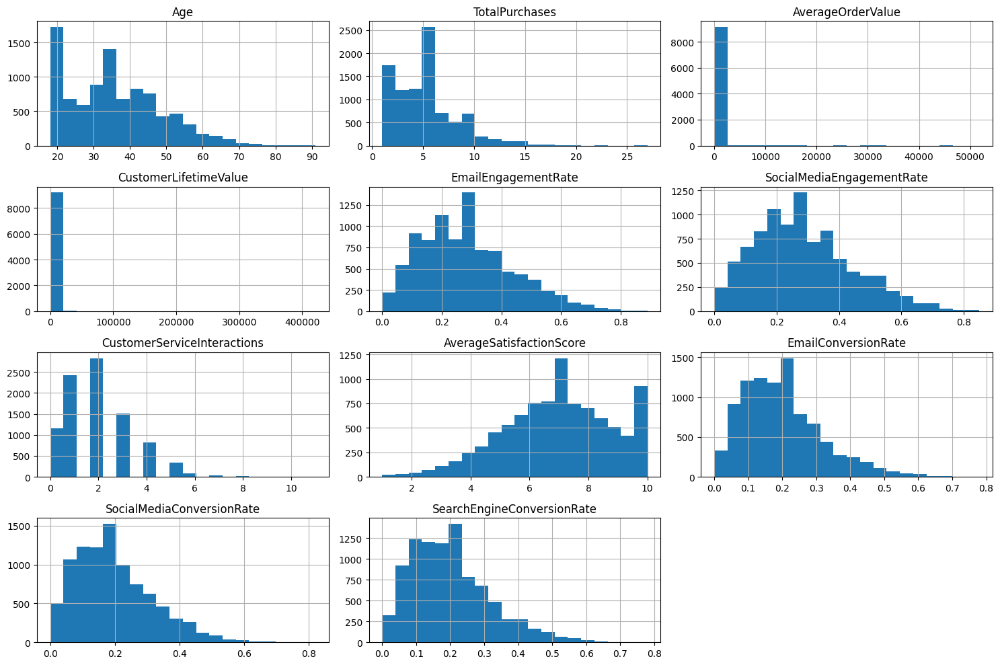

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plotting histograms for all numerical columns
df[numerical_cols].hist(figsize=(15, 10), bins=20)
plt.tight_layout()
plt.show()



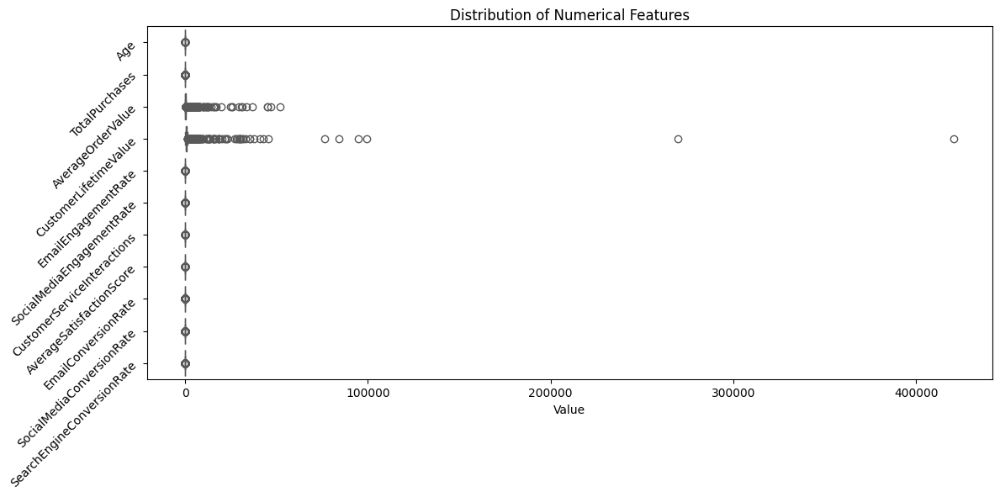

In [ ]:
# Boxplots for key numerical columns (e.g., TotalPurchases, AverageOrderValue)
plt.figure(figsize=(12, 6))  # Adjust figure size for better visibility
sns.boxplot(data=df[numerical_cols], orient="h", palette="Set2")
plt.title("Distribution of Numerical Features")  # Add a title
plt.xlabel("Value")  # Add x-axis label
plt.yticks(rotation=45, ha='right')  # Rotate y-axis labels for readability
plt.tight_layout()  # Adjust layout to prevent overlapping elements
plt.show()

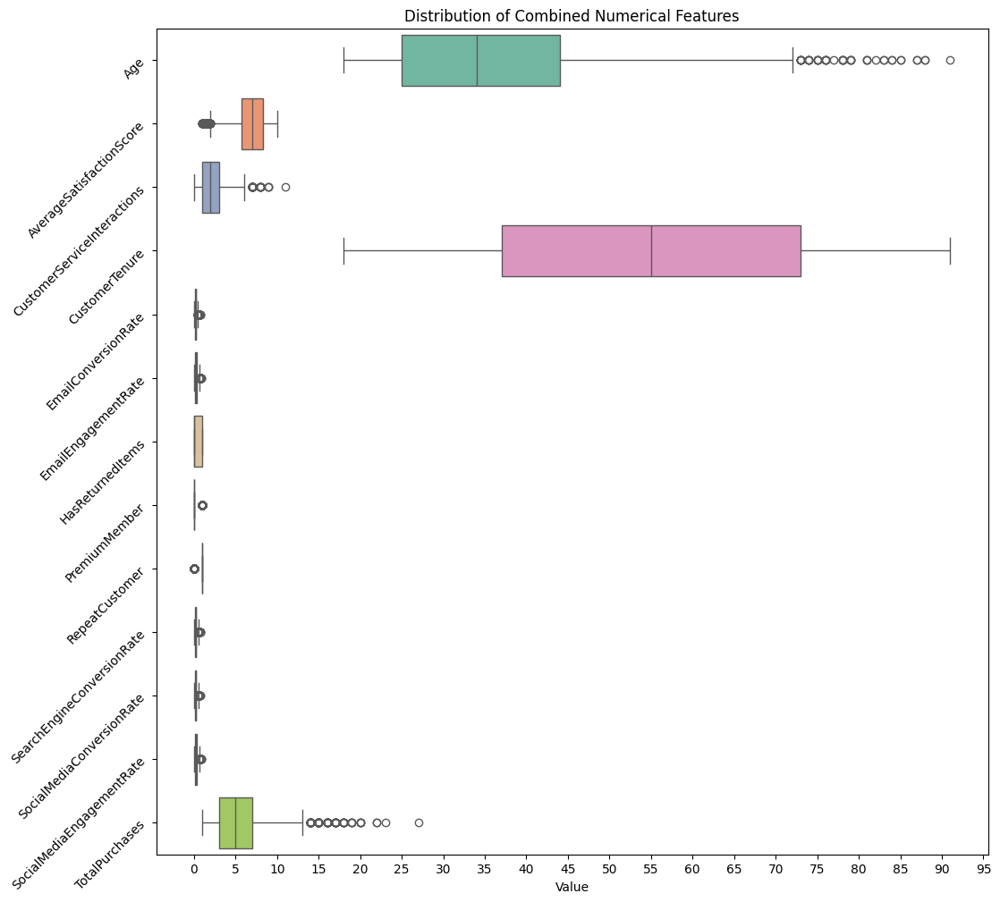

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Define the features to plot, selecting only numerical columns
features_combined = df.select_dtypes(include=['number']).columns.difference(['AverageOrderValue', 'CustomerLifetimeValue']).tolist()

# Set up a larger figure size for better visibility
plt.figure(figsize=(12, 12))

# First subplot for combined numerical features
sns.boxplot(data=df[features_combined], orient="h", palette="Set2")
plt.title("Distribution of Combined Numerical Features")
plt.xlabel("Value")
plt.yticks(rotation=45, ha='right')

# Set the x-axis ticks to increments of 5
# Calculate min and max only for numerical columns
min_val = df[features_combined].min().min()
max_val = df[features_combined].max().max()
plt.xticks(np.arange(min_val, max_val + 5, 5))

plt.show()

In [ ]:
!pip install plotly
import plotly.express as px
from IPython.display import display, HTML

# Frequency of categories in categorical columns (excluding CustomerID)
categorical_cols = df.select_dtypes(include=['object']).columns
categorical_cols = categorical_cols[categorical_cols != 'CustomerID']  # Exclude CustomerID

for col in categorical_cols:
    # Create and display the table of value counts
    value_counts = df[col].value_counts().to_frame()
    value_counts.reset_index(inplace=True)
    value_counts.columns = ['Category', 'Frequency']
    display(HTML(value_counts.to_html()))

    # Create and display the interactive bar chart
    fig = px.bar(
        value_counts,  # Use the value_counts DataFrame for the chart
        x='Category',  # Set x-axis to 'Category'
        y='Frequency',  # Set y-axis to 'Frequency'
        title=f"Frequency of Categories in {col}"
    )
    fig.update_layout(xaxis_tickangle=-45)  # Rotate x-axis labels
    fig.show()

,Category,Frequency
0,Unknown,2404
1,Other,1760
2,Female,1717
3,Male,1685
4,Prefer not to say,1665


,Category,Frequency
0,Unknown,2295
1,Very High,1815
2,Medium,1783
3,Low,1681
4,High,1657


,Category,Frequency
0,France,1132
1,Japan,1120
2,USA,1117
3,Australia,1101
4,Canada,1087
5,Other,1081
6,UK,1075
7,Germany,1073
8,Unknown,445


,Category,Frequency
0,New York,1134
1,Berlin,1124
2,London,1116
3,Tokyo,1113
4,Other,1089
5,Los Angeles,1076
6,Paris,1068
7,Sydney,1062
8,Unknown,449


,Category,Frequency
0,Beauty,2503
1,Sports,991
2,Electronics,984
3,Toys,957
4,Food,955
5,Clothing,952
6,Books,946
7,Home Goods,943


,Category,Frequency
0,Home Goods,2433
1,Electronics,997
2,Clothing,980
3,Sports,979
4,Food,976
5,Toys,960
6,Beauty,958
7,Books,948


,Category,Frequency
0,Unknown,2251
1,Never,1762
2,Low,1749
3,Medium,1739
4,High,1730


,Category,Frequency
0,Beauty & Home Goods,647
1,Electronics & Home Goods,283
2,Beauty & Books,274
3,Beauty & Sports,271
4,Beauty & Clothing,270
5,Beauty & Electronics,267
6,Beauty & Toys,265
7,Food & Home Goods,263
8,Books & Home Goods,262
9,Beauty & Food,261


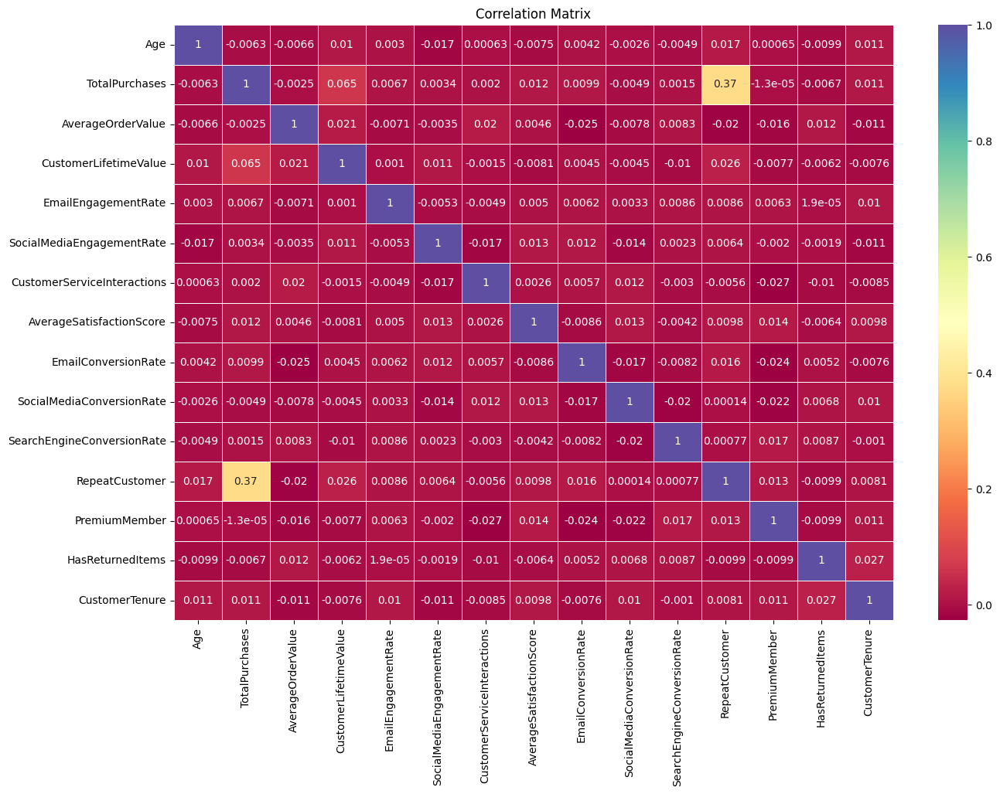

In [ ]:
# Correlation matrix to explore relationships between numerical columns
# Select only numerical features (excluding those with 'object' dtype)
numerical_cols = df.select_dtypes(include=['number']).columns
correlation_matrix = df[numerical_cols].corr()

plt.figure(figsize=(15, 10))
sns.heatmap(correlation_matrix, annot=True, cmap="Spectral", linewidths=0.5)
plt.title('Correlation Matrix')
plt.show()

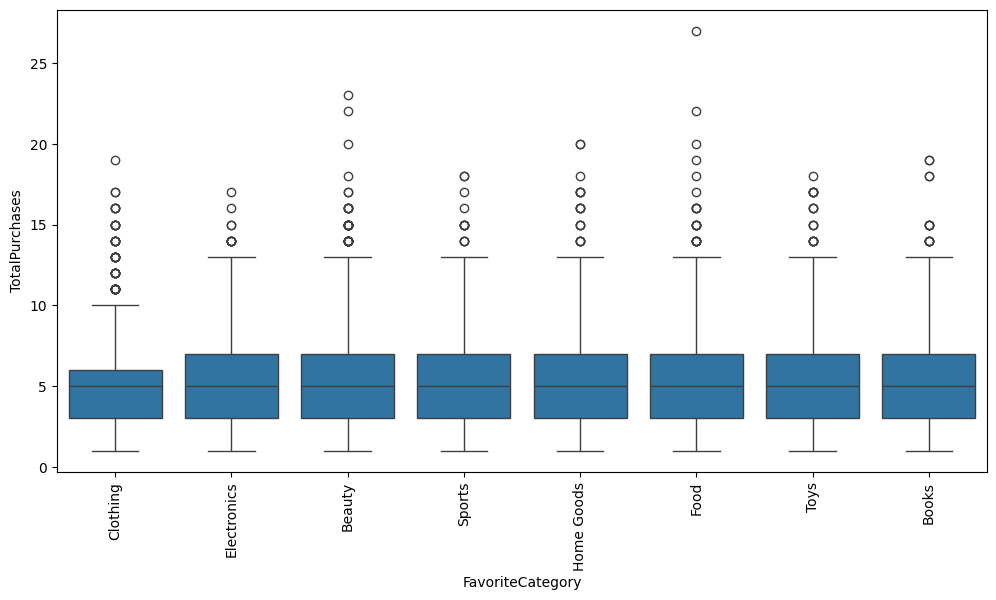

In [ ]:
# Grouping by 'FavoriteCategory' and calculating mean of numerical features
grouped_by_fav_category = df.groupby('FavoriteCategory')[numerical_cols].mean()

# Boxplot for TotalPurchases by FavoriteCategory
plt.figure(figsize=(12, 6))
sns.boxplot(x='FavoriteCategory', y='TotalPurchases', data=df)
plt.xticks(rotation=90)
plt.show()


In [ ]:
# Check for missing values in the dataset
missing_values = df.isnull().sum()
missing_percent = (missing_values / len(df)) * 100
missing_data = pd.DataFrame({"Missing Values": missing_values, "Percentage": missing_percent})
print(missing_data[missing_data['Percentage'] > 0])


Empty DataFrame
Columns: [Missing Values, Percentage]
Index: []


In [ ]:
# Add import statement at the beginning of your code (e.g., in cell ipython-input-48-484bce2eeb5e)
import numpy as np

from scipy import stats

# Calculate Z-scores for numerical features
z_scores = stats.zscore(df[numerical_cols])
abs_z_scores = np.abs(z_scores)

# Identify rows with Z-scores > 3 (potential outliers)
outliers = (abs_z_scores > 3).all(axis=1)
print(f"Number of outliers: {outliers.sum()}")

Number of outliers: 0


Age                            0.53
TotalPurchases                 1.10
AverageOrderValue             22.53
CustomerLifetimeValue         53.97
EmailEngagementRate            0.62
SocialMediaEngagementRate      0.57
CustomerServiceInteractions    0.78
AverageSatisfactionScore      -0.29
EmailConversionRate            0.90
SocialMediaConversionRate      0.83
SearchEngineConversionRate     0.87
RepeatCustomer                -3.12
PremiumMember                  1.24
HasReturnedItems               0.70
CustomerTenure                -0.00
dtype: float64


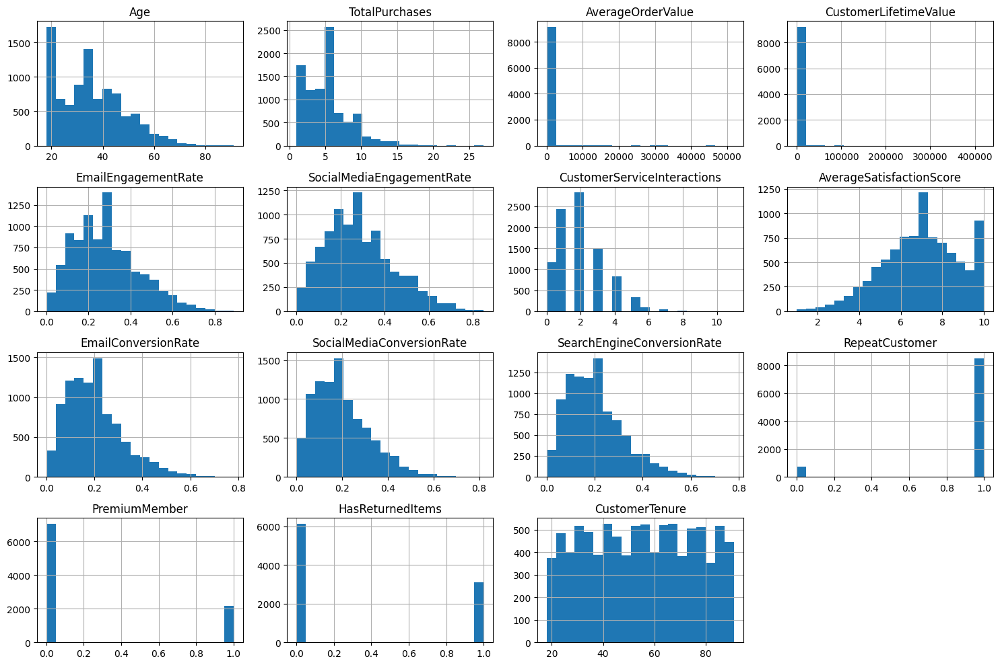

In [ ]:
# Checking skewness of numerical features
skewness = df[numerical_cols].skew()
print(skewness)

# Visualize skewness
df[numerical_cols].hist(figsize=(15, 10), bins=20)
plt.tight_layout()
plt.show()


In [ ]:
n_samples, n_features = df.shape
ratio = n_features / n_samples
print(f"Feature-to-Sample Ratio: {ratio}")


Feature-to-Sample Ratio: 0.0025999350016249595


In [ ]:
sparsity = (df != 0).mean().mean()
print(f"Sparsity of the dataset: {sparsity:.2f}")


Sparsity of the dataset: 0.93


Dataset Shape: (9231, 24)
Feature-to-Sample Ratio: 0.0025999350016249595
The dataset is not high-dimensional.
Sparsity of the dataset: 0.93


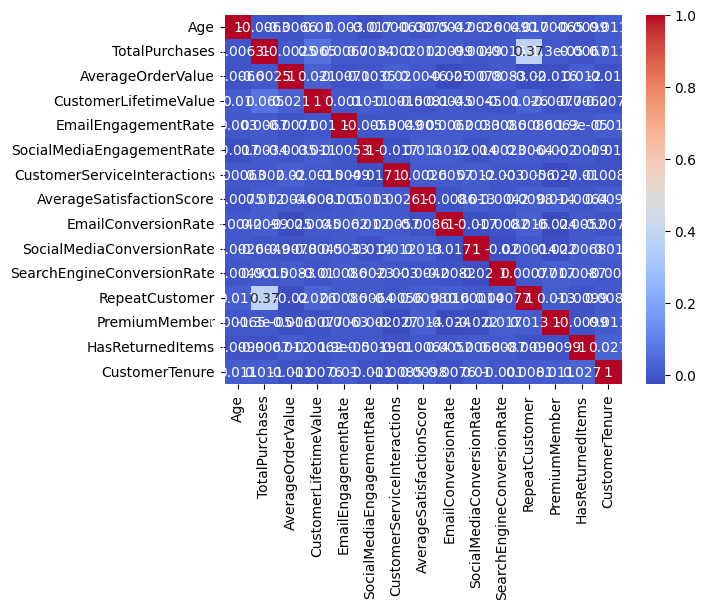

In [ ]:
n_samples, n_features = df.shape
ratio = n_features / n_samples
print(f"Dataset Shape: {df.shape}")
print(f"Feature-to-Sample Ratio: {ratio}")

# Check if the feature-to-sample ratio is greater than 1
if ratio > 1:
    print("The dataset is likely high-dimensional.")
else:
    print("The dataset is not high-dimensional.")

# Check for sparsity
sparsity = (df != 0).mean().mean()
print(f"Sparsity of the dataset: {sparsity:.2f}")

numerical_cols = df.select_dtypes(include=['number']).columns
correlation_matrix = df[numerical_cols].corr()
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm")
plt.show()



## **CLUSTERING ANALYSIS WITHOUT PCA**

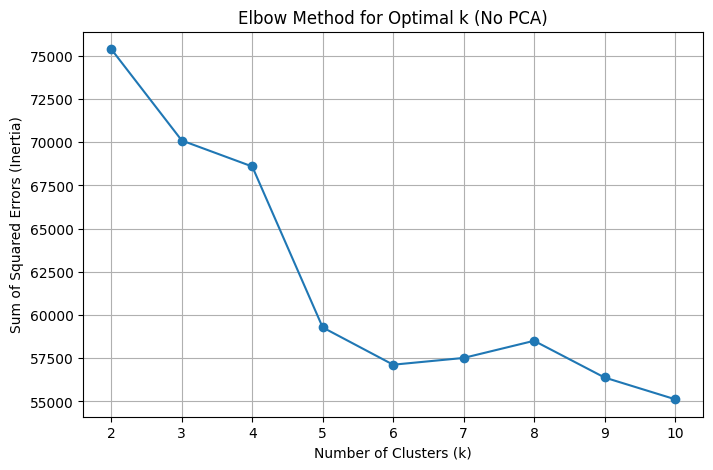


🔍 Clustering Evaluation for k=4 (No PCA)

📊 KMeans Cluster Counts (No PCA, k=4):


,0,Count
0,1,4026
1,2,2405
2,3,719
3,4,2081



📊 Agglomerative Cluster Counts (No PCA, k=4, linkage=ward):


,0,Count
0,1,8406
1,2,204
2,3,86
3,4,535



📈 Evaluation Scores for k=4 (No PCA):


,Method,k,Silhouette,DB,CH,Composite
0,KMeans-NoPCA,4,0.06,2.83,1164.45,-1.61
1,Agglo-NoPCA-ward,4,0.29,1.35,1456.01,0.39


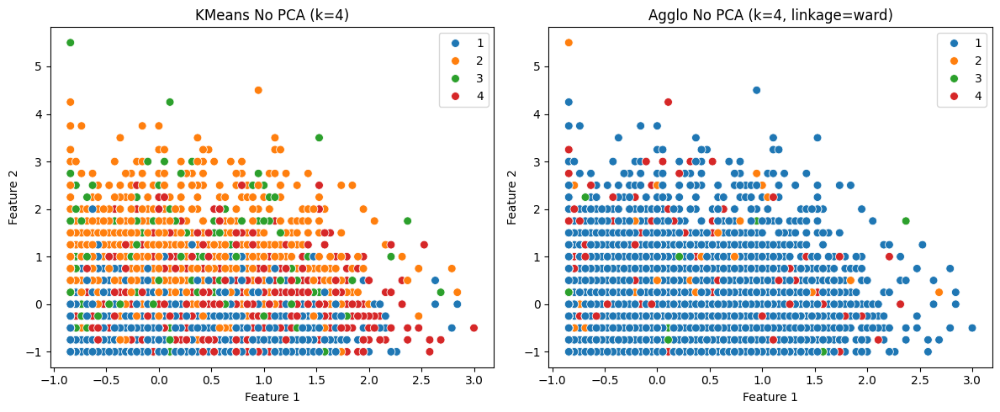


🔍 Clustering Evaluation for k=5 (No PCA)

📊 KMeans Cluster Counts (No PCA, k=5):


,0,Count
0,1,3987
1,2,2305
2,3,650
3,4,111
4,5,2178



📊 Agglomerative Cluster Counts (No PCA, k=5, linkage=ward):


,0,Count
0,1,204
1,2,6422
2,3,86
3,4,535
4,5,1984



📈 Evaluation Scores for k=5 (No PCA):


,Method,k,Silhouette,DB,CH,Composite
0,KMeans-NoPCA,5,0.07,2.42,1361.46,-0.99
1,Agglo-NoPCA-ward,5,0.07,2.41,1224.52,-1.12


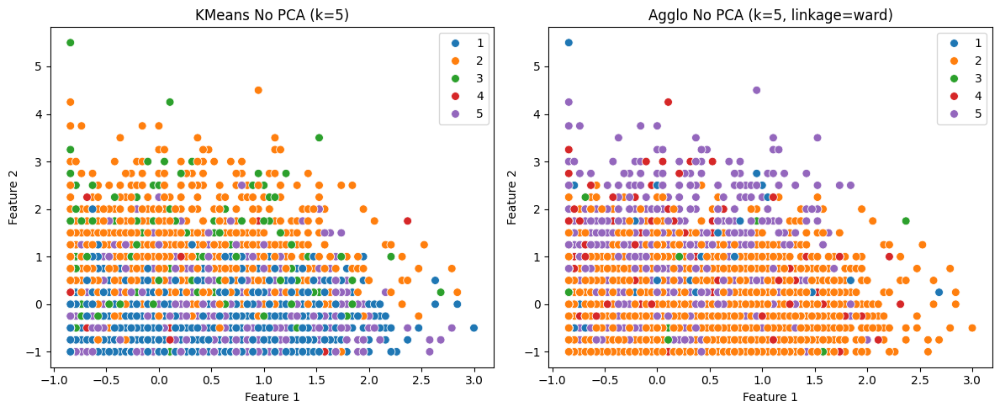


🔍 Clustering Evaluation for k=6 (No PCA)

📊 KMeans Cluster Counts (No PCA, k=6):


,0,Count
0,1,2634
1,2,1855
2,3,556
3,4,111
4,5,1875
5,6,2200



📊 Agglomerative Cluster Counts (No PCA, k=6, linkage=ward):


,0,Count
0,1,6422
1,2,1984
2,3,86
3,4,535
4,5,137
5,6,67



📈 Evaluation Scores for k=6 (No PCA):


,Method,k,Silhouette,DB,CH,Composite
0,KMeans-NoPCA,6,0.06,2.41,1204.01,-1.14
1,Agglo-NoPCA-ward,6,0.07,2.17,1052.14,-1.05


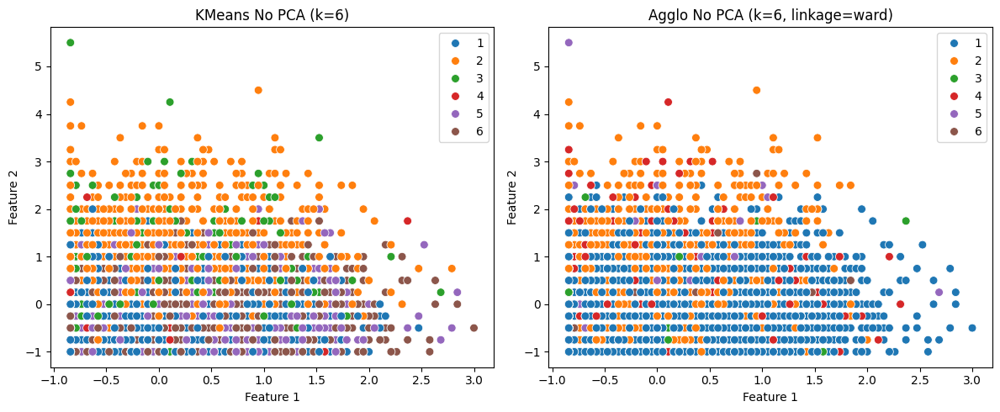


🔍 Clustering Evaluation for k=7 (No PCA)

📊 KMeans Cluster Counts (No PCA, k=7):


,0,Count
0,1,2357
1,2,1339
2,3,435
3,4,129
4,5,1245
5,6,1761
6,7,1965



📊 Agglomerative Cluster Counts (No PCA, k=7, linkage=ward):


,0,Count
0,1,5205
1,2,1984
2,3,1217
3,4,535
4,5,137
5,6,67
6,7,86



📈 Evaluation Scores for k=7 (No PCA):


,Method,k,Silhouette,DB,CH,Composite
0,KMeans-NoPCA,7,0.06,2.41,1043.42,-1.31
1,Agglo-NoPCA-ward,7,0.04,2.38,937.20,-1.40


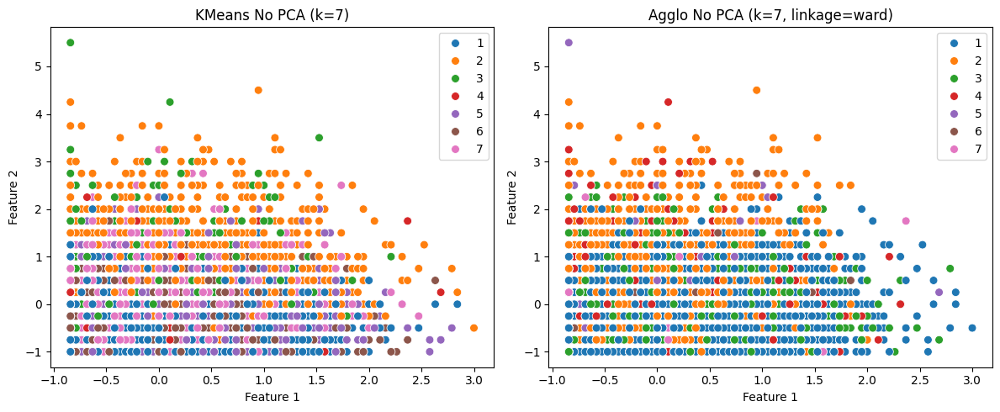


🔍 Clustering Evaluation for k=8 (No PCA)

📊 KMeans Cluster Counts (No PCA, k=8):


,0,Count
0,1,998
1,2,235
2,3,1135
3,4,1789
4,5,713
5,6,1260
6,7,1781
7,8,1320



📊 Agglomerative Cluster Counts (No PCA, k=8, linkage=ward):


,0,Count
0,1,1984
1,2,4729
2,3,1217
3,4,535
4,5,137
5,6,67
6,7,86
7,8,476



📈 Evaluation Scores for k=8 (No PCA):


,Method,k,Silhouette,DB,CH,Composite
0,KMeans-NoPCA,8,0.05,2.58,830.86,-1.70
1,Agglo-NoPCA-ward,8,0.04,2.40,850.93,-1.51


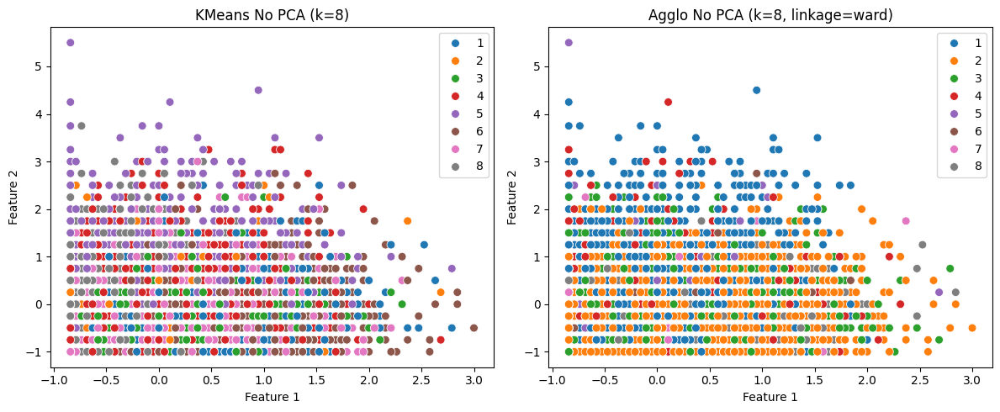


📋 Full Evaluation Metrics Summary (No PCA):


,Method,k,Silhouette,DB,CH,Composite
1,Agglo-NoPCA-ward,4,0.29,1.35,1456.01,0.39
0,KMeans-NoPCA,4,0.06,2.83,1164.45,-1.61
3,Agglo-NoPCA-ward,5,0.07,2.41,1224.52,-1.12
2,KMeans-NoPCA,5,0.07,2.42,1361.46,-0.99
5,Agglo-NoPCA-ward,6,0.07,2.17,1052.14,-1.05
4,KMeans-NoPCA,6,0.06,2.41,1204.01,-1.14
7,Agglo-NoPCA-ward,7,0.04,2.38,937.20,-1.40
6,KMeans-NoPCA,7,0.06,2.41,1043.42,-1.31
9,Agglo-NoPCA-ward,8,0.04,2.40,850.93,-1.51
8,KMeans-NoPCA,8,0.05,2.58,830.86,-1.70



📝 Best Score Comparison Summary (No PCA):


,Method,k,Silhouette,DB,CH,Composite
2,KMeans-NoPCA,5,0.07,2.42,1361.46,-0.99
1,Agglo-NoPCA-ward,4,0.29,1.35,1456.01,0.39


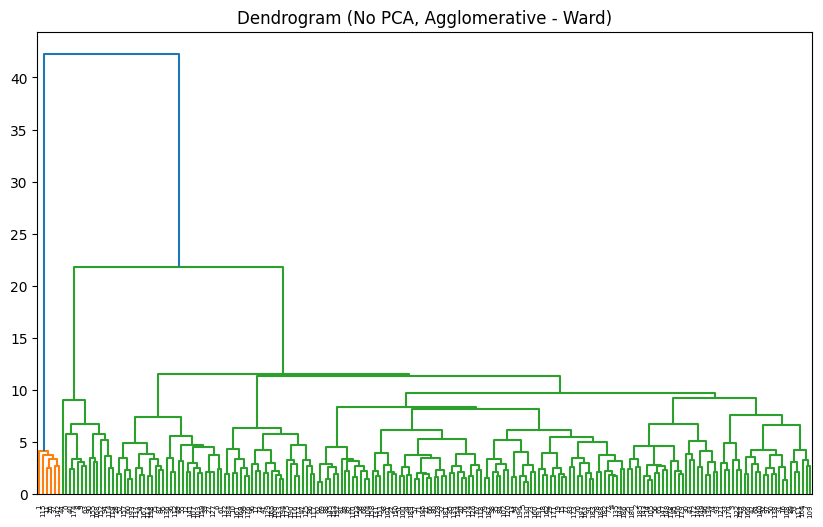

In [ ]:
# -------------------------------------------
# CLUSTERING WITHOUT PCA
# -------------------------------------------

# 1. Imports
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import MiniBatchKMeans, AgglomerativeClustering
from sklearn.metrics import silhouette_score, davies_bouldin_score, calinski_harabasz_score
from scipy.cluster.hierarchy import dendrogram, linkage
from scipy.stats.mstats import winsorize
from sklearn.preprocessing import RobustScaler
from sklearn.decomposition import PCA

# Step 1: Data Preparation (Moved from cell SfDqCa1C7-Dx)
df_processed = df.copy()

# Winsorization to cap outliers
for col in ['AverageOrderValue', 'CustomerLifetimeValue']:
    df_processed[col] = winsorize(df_processed[col], limits=[0.01, 0.01])

features = [
    'Age', 'TotalPurchases', 'AverageOrderValue', 'CustomerLifetimeValue',
    'EmailEngagementRate', 'SocialMediaEngagementRate',
    'CustomerServiceInteractions', 'AverageSatisfactionScore',
    'EmailConversionRate', 'SocialMediaConversionRate',
    'SearchEngineConversionRate', 'RepeatCustomer',
    'PremiumMember', 'HasReturnedItems', 'CustomerTenure'
]

# Step 2: Feature Scaling (Moved from cell SfDqCa1C7-Dx)
scaler = RobustScaler()
df_scaled = scaler.fit_transform(df_processed[features])




# 2. Evaluation Function
def evaluate_clustering(X, labels):
    sil = silhouette_score(X, labels)
    db = davies_bouldin_score(X, labels)
    ch = calinski_harabasz_score(X, labels)
    comp = sil - db + (ch / 1000)
    return sil, db, ch, comp

# 3. Elbow Method for KMeans (no PCA)
sse_no_pca = []
k_range = range(2, 11)
for k in k_range:
    kmeans = MiniBatchKMeans(n_clusters=k, batch_size=100, random_state=42)
    kmeans.fit(df_scaled)
    sse_no_pca.append(kmeans.inertia_)

plt.figure(figsize=(8, 5))
plt.plot(k_range, sse_no_pca, marker='o')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Sum of Squared Errors (Inertia)')
plt.title('Elbow Method for Optimal k (No PCA)')
plt.grid(True)
plt.show()

# 4. Clustering Evaluation & Visualisation (k = 4 to 8)
all_results_no_pca = []

for k in range(4, 9):
    print(f"\n{'='*60}\n🔍 Clustering Evaluation for k={k} (No PCA)\n{'='*60}")
    result_k = []

    # --- MiniBatch KMeans ---
    kmeans = MiniBatchKMeans(n_clusters=k, batch_size=100, random_state=42)
    kmeans_labels = kmeans.fit_predict(df_scaled) + 1
    df_processed[f'Cluster_KMeans_NoPCA_k{k}'] = kmeans_labels
    sil_km, db_km, ch_km, comp_km = evaluate_clustering(df_scaled, kmeans_labels)
    result_k.append({
        'Method': 'KMeans-NoPCA', 'k': k,
        'Silhouette': sil_km, 'DB': db_km, 'CH': ch_km, 'Composite': comp_km
    })

    print(f"\n📊 KMeans Cluster Counts (No PCA, k={k}):")
    display(pd.DataFrame(kmeans_labels).value_counts().sort_index().rename('Count').reset_index().rename(columns={'index': 'Cluster'}))

    # --- Agglomerative Clustering ---
    linkage_method = 'ward'
    ag_model = AgglomerativeClustering(n_clusters=k, linkage=linkage_method)
    ag_labels = ag_model.fit_predict(df_scaled) + 1
    df_processed[f'Cluster_Agglo_NoPCA_k{k}'] = ag_labels
    sil_ag, db_ag, ch_ag, comp_ag = evaluate_clustering(df_scaled, ag_labels)
    result_k.append({
        'Method': f'Agglo-NoPCA-{linkage_method}', 'k': k,
        'Silhouette': sil_ag, 'DB': db_ag, 'CH': ch_ag, 'Composite': comp_ag
    })

    print(f"\n📊 Agglomerative Cluster Counts (No PCA, k={k}, linkage={linkage_method}):")
    display(pd.DataFrame(ag_labels).value_counts().sort_index().rename('Count').reset_index().rename(columns={'index': 'Cluster'}))

    # Store results
    df_k = pd.DataFrame(result_k)
    all_results_no_pca.extend(result_k)
    print(f"\n📈 Evaluation Scores for k={k} (No PCA):")
    display(df_k)

    # Side-by-side scatter plots (first 2 scaled features)
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    sns.scatterplot(x=df_scaled[:, 0], y=df_scaled[:, 1], hue=kmeans_labels, palette='tab10', s=50)
    plt.title(f"KMeans No PCA (k={k})")
    plt.xlabel('Feature 1'); plt.ylabel('Feature 2')

    plt.subplot(1, 2, 2)
    sns.scatterplot(x=df_scaled[:, 0], y=df_scaled[:, 1], hue=ag_labels, palette='tab10', s=50)
    plt.title(f"Agglo No PCA (k={k}, linkage={linkage_method})")
    plt.xlabel('Feature 1'); plt.ylabel('Feature 2')

    plt.tight_layout()
    plt.show()

# 5. Summary Table
df_results_no_pca = pd.DataFrame(all_results_no_pca)
print("\n📋 Full Evaluation Metrics Summary (No PCA):")
display(df_results_no_pca.sort_values(by=['k', 'Method']))

# 6. Best Clustering Without PCA
best_kmeans_no_pca = df_results_no_pca[df_results_no_pca['Method'] == 'KMeans-NoPCA'].sort_values(by='Composite', ascending=False).iloc[0]
best_agglo_no_pca = df_results_no_pca[df_results_no_pca['Method'].str.contains('Agglo')].sort_values(by='Composite', ascending=False).iloc[0]

summary_table_no_pca = pd.DataFrame([best_kmeans_no_pca, best_agglo_no_pca])
print("\n📝 Best Score Comparison Summary (No PCA):")
display(summary_table_no_pca)

# 7. Dendrogram (Optional, if Agglo best)
if 'Agglo' in best_agglo_no_pca['Method']:
    sample_data = pd.DataFrame(df_scaled).sample(n=200, random_state=42)
    linked = linkage(sample_data, method='ward')

    plt.figure(figsize=(10, 6))
    dendrogram(linked)
    plt.title("Dendrogram (No PCA, Agglomerative - Ward)")
    plt.show()

# **#ANALYSIS--CLUSTERING WITH PCA**





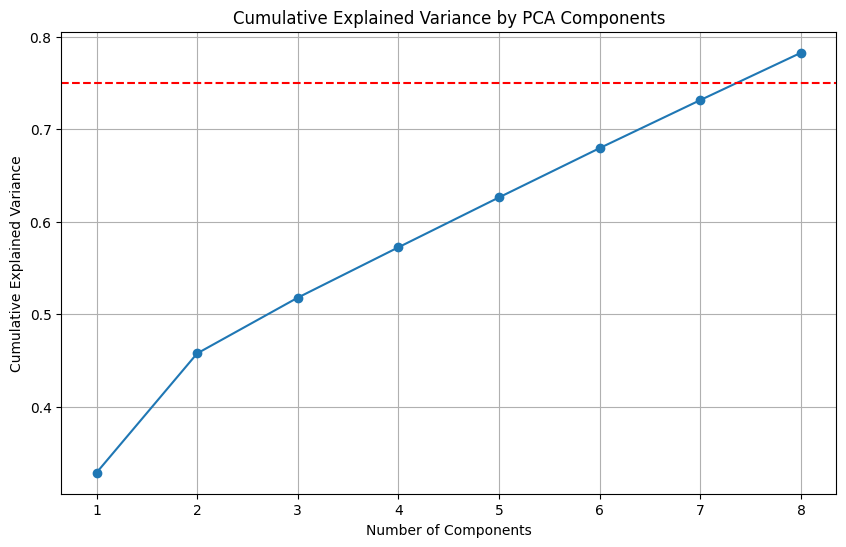


📊 PCA Eigenvalues and Variance Explained:


,Principal Component,Eigenvalue,% Variance Explained,Cumulative % Variance
0,PC1,3.35,32.89,32.89
1,PC2,1.31,12.89,45.78
2,PC3,0.61,6.02,51.80
3,PC4,0.55,5.44,57.24
4,PC5,0.55,5.39,62.64
5,PC6,0.54,5.32,67.96
6,PC7,0.53,5.19,73.15
7,PC8,0.52,5.11,78.26


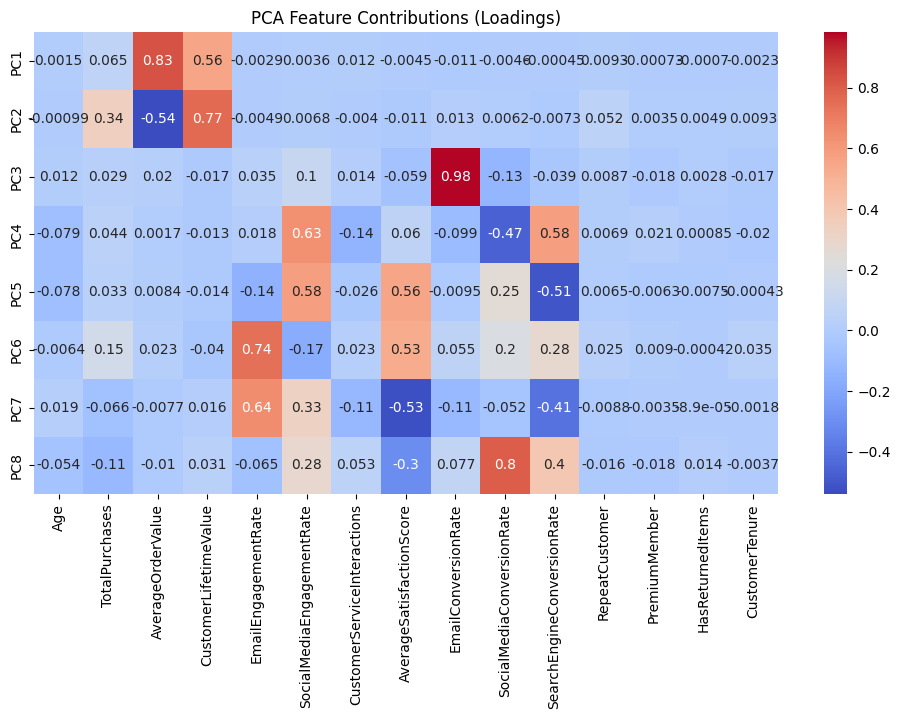

In [ ]:
# =============================== #
# 📌 Part 1: PCA (Principal Component Analysis)
# =============================== #

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from scipy.stats.mstats import winsorize
from sklearn.preprocessing import RobustScaler
from sklearn.decomposition import PCA

# Step 1: Data Preparation
df_processed = df.copy()

# Winsorization to cap outliers
for col in ['AverageOrderValue', 'CustomerLifetimeValue']:
    df_processed[col] = winsorize(df_processed[col], limits=[0.01, 0.01])

features = [
    'Age', 'TotalPurchases', 'AverageOrderValue', 'CustomerLifetimeValue',
    'EmailEngagementRate', 'SocialMediaEngagementRate',
    'CustomerServiceInteractions', 'AverageSatisfactionScore',
    'EmailConversionRate', 'SocialMediaConversionRate',
    'SearchEngineConversionRate', 'RepeatCustomer',
    'PremiumMember', 'HasReturnedItems', 'CustomerTenure'
]

# Step 2: Feature Scaling
scaler = RobustScaler()
df_scaled = scaler.fit_transform(df_processed[features])

# Step 3: Apply PCA (retain 75% of variance)
pca = PCA(n_components=0.75)
pca_data = pca.fit_transform(df_scaled)

# Step 4: Explained Variance Plot
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(pca.explained_variance_ratio_)+1), np.cumsum(pca.explained_variance_ratio_), marker='o')
plt.axhline(y=0.75, color='r', linestyle='--')
plt.title('Cumulative Explained Variance by PCA Components')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.grid(True)
plt.show()

# Step 5: Eigenvalues and Variance Explained
eigenvalues = pca.explained_variance_
explained_variance_ratio = pca.explained_variance_ratio_
cumulative_variance = np.cumsum(explained_variance_ratio)

eigenvalue_df = pd.DataFrame({
    'Principal Component': [f'PC{i+1}' for i in range(len(eigenvalues))],
    'Eigenvalue': np.round(eigenvalues, 4),
    '% Variance Explained': np.round(explained_variance_ratio * 100, 2),
    'Cumulative % Variance': np.round(cumulative_variance * 100, 2)
})
print("\n📊 PCA Eigenvalues and Variance Explained:")
display(eigenvalue_df)

# Step 6: PCA Loadings
pca_loadings_df = pd.DataFrame(
    pca.components_,
    columns=features,
    index=[f'PC{i+1}' for i in range(pca.n_components_)]
)

plt.figure(figsize=(12, 6))
sns.heatmap(pca_loadings_df, cmap="coolwarm", annot=True)
plt.title("PCA Feature Contributions (Loadings)")
plt.show()


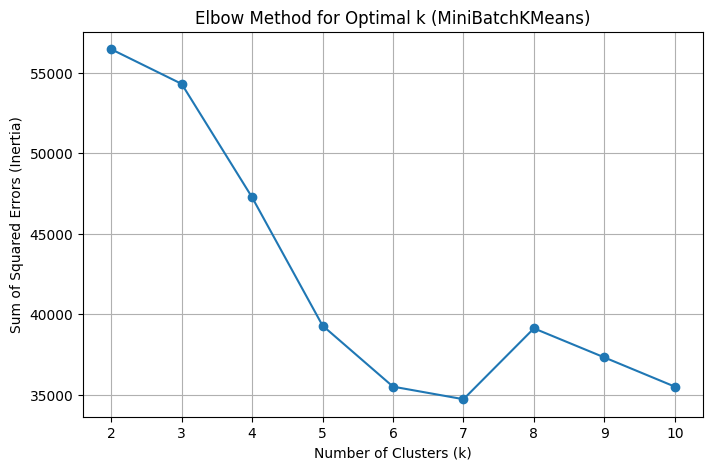


🔍 Clustering Evaluation for k=4

📊 KMeans Cluster Counts (k=4):


,0,Count
0,1,3241
1,2,3397
2,3,2094
3,4,499



📊 Agglomerative Cluster Counts (k=4, linkage=ward):


,0,Count
0,1,8148
1,2,218
2,3,97
3,4,768



📈 Evaluation Scores for k=4:


,Method,k,Silhouette,DB,CH,Composite
0,KMeans,4,0.08,2.27,1780.89,-0.40
1,Agglo-ward,4,0.32,1.31,2153.04,1.16


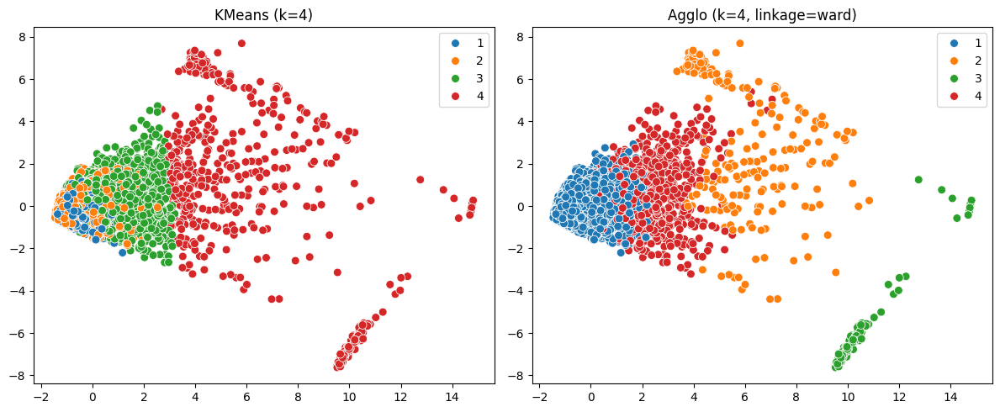


🔍 Clustering Evaluation for k=5

📊 KMeans Cluster Counts (k=5):


,0,Count
0,1,2322
1,2,2553
2,3,114
3,4,539
4,5,3703



📊 Agglomerative Cluster Counts (k=5, linkage=ward):


,0,Count
0,1,2581
1,2,218
2,3,97
3,4,768
4,5,5567



📈 Evaluation Scores for k=5:


,Method,k,Silhouette,DB,CH,Composite
0,KMeans,5,0.10,1.93,2024.39,0.19
1,Agglo-ward,5,0.09,2.25,1805.63,-0.36


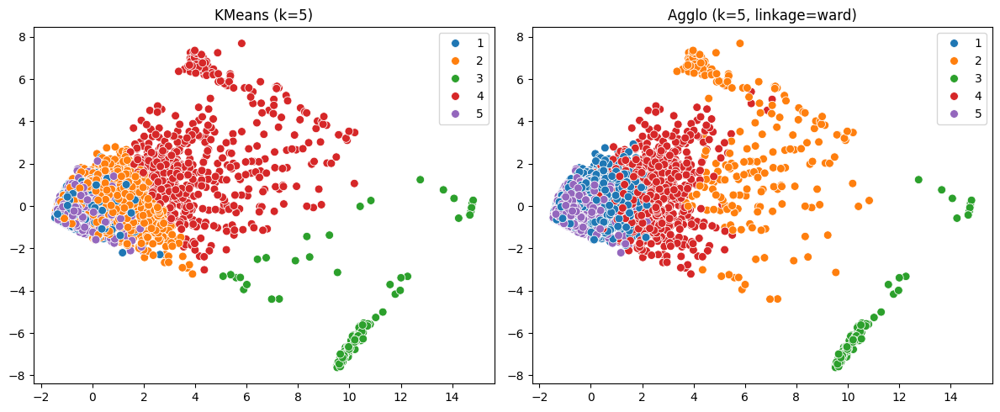


🔍 Clustering Evaluation for k=6

📊 KMeans Cluster Counts (k=6):


,0,Count
0,1,2036
1,2,1801
2,3,113
3,4,300
4,5,3435
5,6,1546



📊 Agglomerative Cluster Counts (k=6, linkage=ward):


,0,Count
0,1,218
1,2,5567
2,3,97
3,4,768
4,5,1803
5,6,778



📈 Evaluation Scores for k=6:


,Method,k,Silhouette,DB,CH,Composite
0,KMeans,6,0.11,1.79,1985.08,0.31
1,Agglo-ward,6,0.08,2.11,1600.23,-0.43


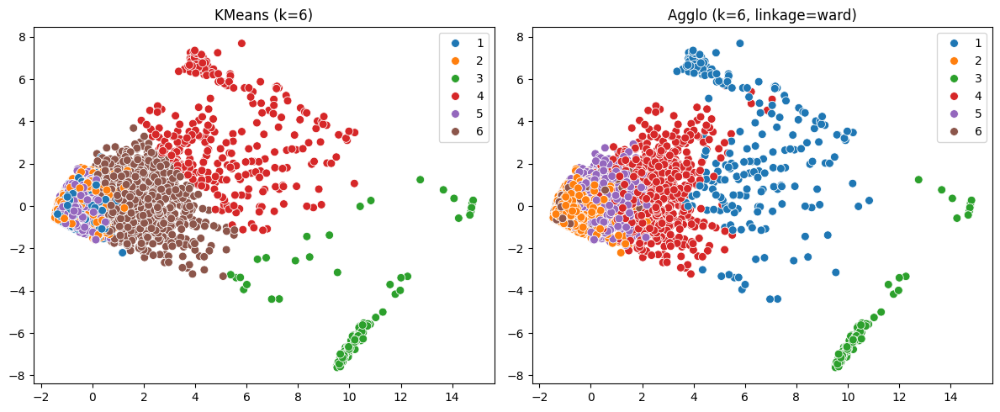


🔍 Clustering Evaluation for k=7

📊 KMeans Cluster Counts (k=7):


,0,Count
0,1,1459
1,2,1729
2,3,121
3,4,195
4,5,2802
5,6,2040
6,7,885



📊 Agglomerative Cluster Counts (k=7, linkage=ward):


,0,Count
0,1,5567
1,2,768
2,3,97
3,4,99
4,5,1803
5,6,778
6,7,119



📈 Evaluation Scores for k=7:


,Method,k,Silhouette,DB,CH,Composite
0,KMeans,7,0.11,1.76,1788.03,0.14
1,Agglo-ward,7,0.08,1.95,1443.59,-0.43


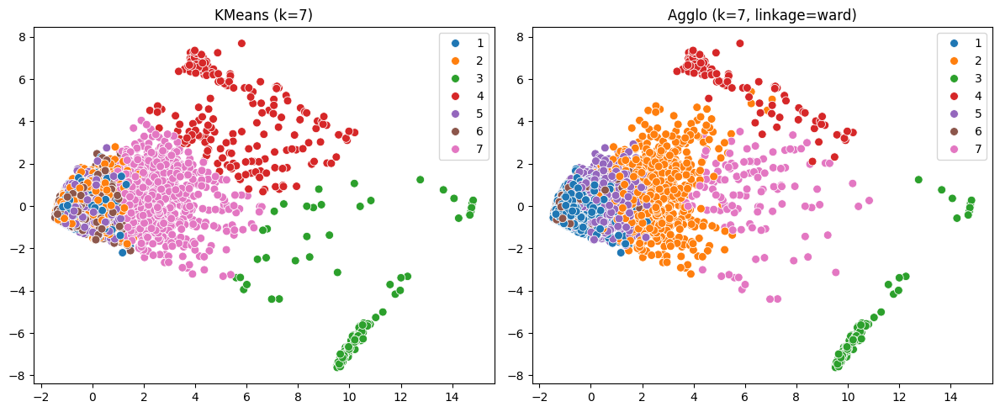


🔍 Clustering Evaluation for k=8

📊 KMeans Cluster Counts (k=8):


,0,Count
0,1,1028
1,2,1191
2,3,1067
3,4,258
4,5,1194
5,6,1890
6,7,1496
7,8,1107



📊 Agglomerative Cluster Counts (k=8, linkage=ward):


,0,Count
0,1,3491
1,2,2076
2,3,97
3,4,768
4,5,1803
5,6,778
6,7,119
7,8,99



📈 Evaluation Scores for k=8:


,Method,k,Silhouette,DB,CH,Composite
0,KMeans,8,0.08,1.87,1234.60,-0.55
1,Agglo-ward,8,0.06,2.14,1334.13,-0.75


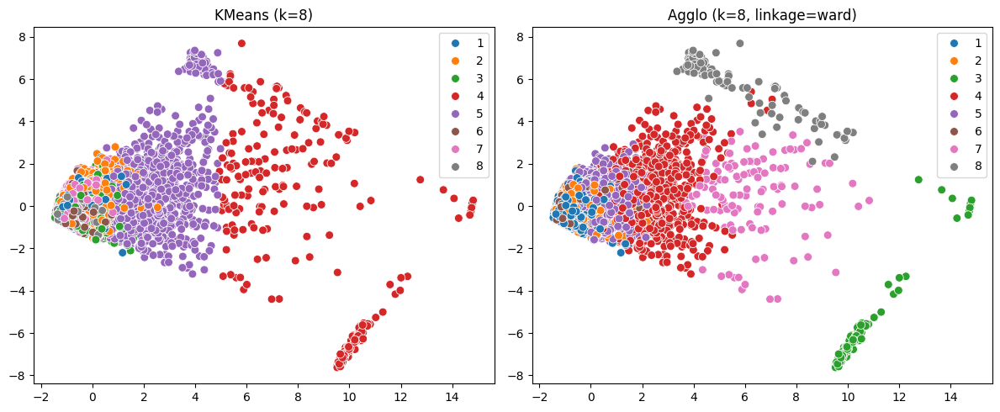


📋 Full Evaluation Metrics Summary:


,Method,k,Silhouette,DB,CH,Composite
1,Agglo-ward,4,0.32,1.31,2153.04,1.16
0,KMeans,4,0.08,2.27,1780.89,-0.40
3,Agglo-ward,5,0.09,2.25,1805.63,-0.36
2,KMeans,5,0.10,1.93,2024.39,0.19
5,Agglo-ward,6,0.08,2.11,1600.23,-0.43
4,KMeans,6,0.11,1.79,1985.08,0.31
7,Agglo-ward,7,0.08,1.95,1443.59,-0.43
6,KMeans,7,0.11,1.76,1788.03,0.14
9,Agglo-ward,8,0.06,2.14,1334.13,-0.75
8,KMeans,8,0.08,1.87,1234.60,-0.55



📝 Best Score Comparison Summary:


,Method,k,Silhouette,DB,CH,Composite
0,KMeans,6,0.11,1.79,1985.08,0.31
1,Agglo-ward,4,0.32,1.31,2153.04,1.16



✅ Best overall clustering method: Agglo-ward with k=4


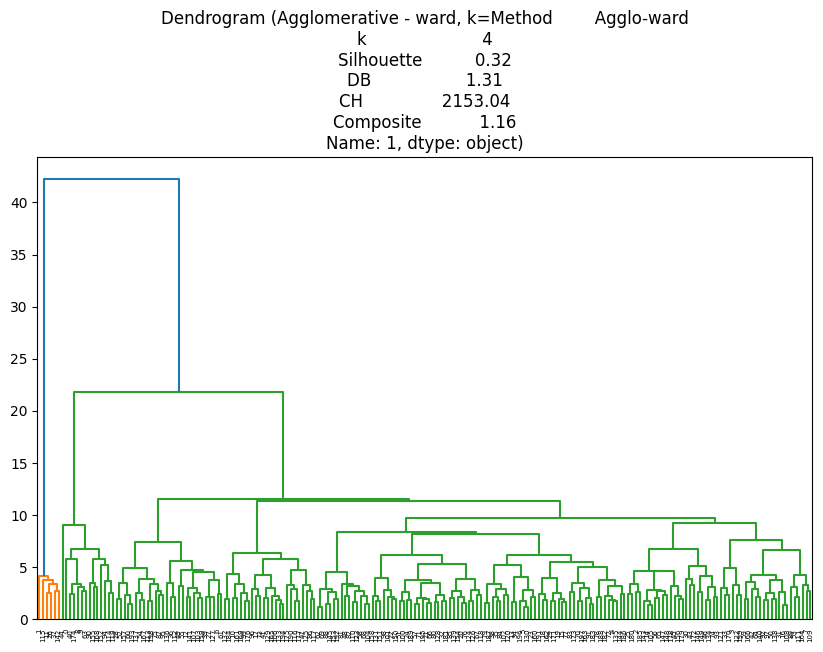

In [ ]:
# -------------------------------------------
# PART 2: FINAL CLUSTERING ANALYSIS WITH EVALUATION
# -------------------------------------------

# 1. Imports
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import MiniBatchKMeans, AgglomerativeClustering
from sklearn.metrics import silhouette_score, davies_bouldin_score, calinski_harabasz_score
from scipy.cluster.hierarchy import dendrogram, linkage

# 2. Evaluation Function
def evaluate_clustering(X, labels):
    sil = silhouette_score(X, labels)
    db = davies_bouldin_score(X, labels)
    ch = calinski_harabasz_score(X, labels)
    comp = sil - db + (ch / 1000)
    return sil, db, ch, comp

# 3. Elbow Method for KMeans
sse = []
k_range = range(2, 11)
for k in k_range:
    kmeans = MiniBatchKMeans(n_clusters=k, batch_size=100, random_state=42)
    kmeans.fit(pca_data)
    sse.append(kmeans.inertia_)

plt.figure(figsize=(8, 5))
plt.plot(k_range, sse, marker='o')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Sum of Squared Errors (Inertia)')
plt.title('Elbow Method for Optimal k (MiniBatchKMeans)')
plt.grid(True)
plt.show()

# 4. Clustering Evaluation & Visualisation (k = 4 to 8)
all_results = []

for k in range(4, 9):
    print(f"\n{'='*60}\n🔍 Clustering Evaluation for k={k}\n{'='*60}")
    result_k = []

    # --- KMeans ---
    kmeans = MiniBatchKMeans(n_clusters=k, batch_size=100, random_state=42)
    kmeans_labels = kmeans.fit_predict(pca_data) + 1
    df_processed[f'Cluster_KMeans_k{k}'] = kmeans_labels
    sil_km, db_km, ch_km, comp_km = evaluate_clustering(pca_data, kmeans_labels)
    result_k.append({
        'Method': 'KMeans', 'k': k,
        'Silhouette': sil_km, 'DB': db_km, 'CH': ch_km, 'Composite': comp_km
    })

    # Cluster counts
    print(f"\n📊 KMeans Cluster Counts (k={k}):")
    display(pd.DataFrame(kmeans_labels).value_counts().sort_index().rename('Count').reset_index().rename(columns={'index': 'Cluster'}))

    # --- Agglomerative with Ward Linkage ---
    linkage_method = 'ward'
    ag_model = AgglomerativeClustering(n_clusters=k, linkage=linkage_method)
    ag_labels = ag_model.fit_predict(pca_data) + 1
    df_processed[f'Cluster_Agglo_k{k}'] = ag_labels
    sil_ag, db_ag, ch_ag, comp_ag = evaluate_clustering(pca_data, ag_labels)
    result_k.append({
        'Method': f'Agglo-{linkage_method}', 'k': k,
        'Silhouette': sil_ag, 'DB': db_ag, 'CH': ch_ag, 'Composite': comp_ag
    })

    print(f"\n📊 Agglomerative Cluster Counts (k={k}, linkage={linkage_method}):")
    display(pd.DataFrame(ag_labels).value_counts().sort_index().rename('Count').reset_index().rename(columns={'index': 'Cluster'}))

    # Show evaluation table for this k
    df_k = pd.DataFrame(result_k)
    all_results.extend(result_k)
    print(f"\n📈 Evaluation Scores for k={k}:")
    display(df_k)

    # --- Side-by-Side Scatter Plot ---
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    sns.scatterplot(x=pca_data[:, 0], y=pca_data[:, 1], hue=kmeans_labels, palette='tab10', s=50)
    plt.title(f"KMeans (k={k})")

    plt.subplot(1, 2, 2)
    sns.scatterplot(x=pca_data[:, 0], y=pca_data[:, 1], hue=ag_labels, palette='tab10', s=50)
    plt.title(f"Agglo (k={k}, linkage={linkage_method})")

    plt.tight_layout()
    plt.show()

# 5. Evaluation Summary Table
df_results = pd.DataFrame(all_results)
print("\n📋 Full Evaluation Metrics Summary:")
display(df_results.sort_values(by=['k', 'Method']))

# 6. Best Score Comparison Summary (in table)
best_kmeans = df_results[df_results['Method'] == 'KMeans'].sort_values(by='Composite', ascending=False).iloc[0]
best_agglo = df_results[df_results['Method'].str.contains('Agglo')].sort_values(by='Composite', ascending=False).iloc[0]

summary_table = pd.DataFrame([
    {
        'Method': best_kmeans['Method'],
        'k': best_kmeans['k'],
        'Silhouette': best_kmeans['Silhouette'],
        'DB': best_kmeans['DB'],
        'CH': best_kmeans['CH'],
        'Composite': best_kmeans['Composite']
    },
    {
        'Method': best_agglo['Method'],
        'k': best_agglo['k'],
        'Silhouette': best_agglo['Silhouette'],
        'DB': best_agglo['DB'],
        'CH': best_agglo['CH'],
        'Composite': best_agglo['Composite']
    }
])
print("\n📝 Best Score Comparison Summary:")
display(summary_table)

# Best model overall
best_overall = best_kmeans if best_kmeans['Composite'] > best_agglo['Composite'] else best_agglo
print(f"\n✅ Best overall clustering method: {best_overall['Method']} with k={best_overall['k']}")


# 8. Dendrogram
if 'Agglo' in best_overall['Method']:
    sample_data = pd.DataFrame(df_scaled).sample(n=200, random_state=42)
    linked = linkage(sample_data, method='ward')

    plt.figure(figsize=(10, 6))
    dendrogram(linked)
    plt.title(f"Dendrogram (Agglomerative - ward, k={best_agglo})")
    plt.show()



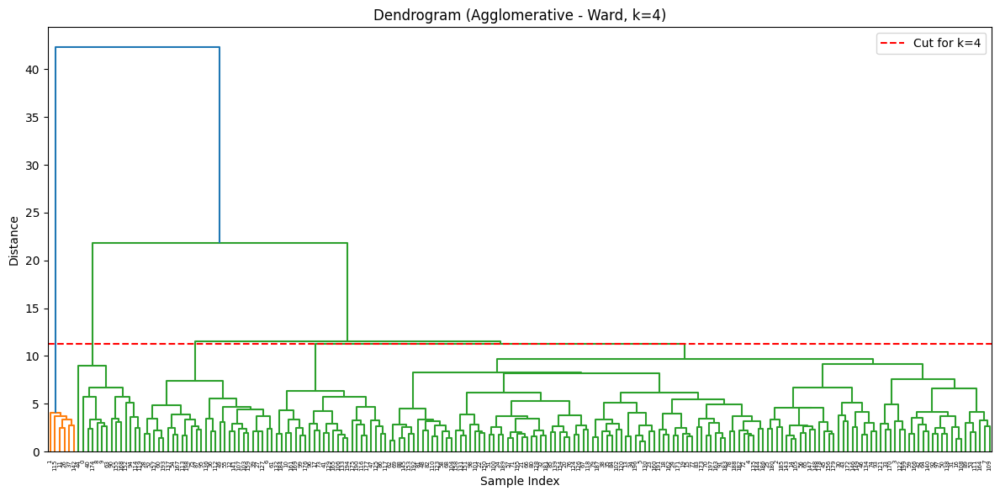

In [ ]:
from scipy.cluster.hierarchy import dendrogram, linkage
import matplotlib.pyplot as plt
import numpy as np

# 8. Dendrogram for Agglomerative Clustering with k=4
sample_data = pd.DataFrame(df_scaled).sample(n=200, random_state=42)
linked = linkage(sample_data, method='ward')

plt.figure(figsize=(12, 6))
dendrogram(linked, color_threshold=None)

# Draw horizontal line to show cut for k=4
cut_level = sorted(linked[:, 2], reverse=True)[3]  # 4 clusters = 3 merges from top
plt.axhline(y=cut_level, color='red', linestyle='--', label='Cut for k=4')

plt.title("Dendrogram (Agglomerative - Ward, k=4)")
plt.xlabel("Sample Index")
plt.ylabel("Distance")
plt.legend()
plt.tight_layout()
plt.show()


🔍 PCA Loadings (Feature Contributions to Principal Components):


,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8
Age,0.00,-0.00,0.01,-0.08,-0.08,-0.01,0.02,-0.05
TotalPurchases,0.06,0.34,0.03,0.04,0.03,0.15,-0.07,-0.11
AverageOrderValue,0.83,-0.54,0.02,0.00,0.01,0.02,-0.01,-0.01
CustomerLifetimeValue,0.56,0.77,-0.02,-0.01,-0.01,-0.04,0.02,0.03
EmailEngagementRate,-0.00,-0.00,0.04,0.02,-0.14,0.74,0.64,-0.06
SocialMediaEngagementRate,0.00,0.01,0.10,0.63,0.58,-0.17,0.33,0.28
CustomerServiceInteractions,0.01,-0.00,0.01,-0.14,-0.03,0.02,-0.11,0.05
AverageSatisfactionScore,-0.00,-0.01,-0.06,0.06,0.56,0.53,-0.53,-0.30
EmailConversionRate,-0.01,0.01,0.98,-0.10,-0.01,0.05,-0.11,0.08
SocialMediaConversionRate,-0.00,0.01,-0.13,-0.47,0.25,0.20,-0.05,0.80



📌 Most Influential Features (Top 3 from PC1 and PC2):
TotalPurchases, CustomerLifetimeValue, AverageOrderValue

🔍 MiniBatch KMeans (k=6) Cluster Profiling

📦 Cluster Sizes:


,count
Cluster_KMeans_k6,
1,2036
2,1801
3,113
4,300
5,3435
6,1546


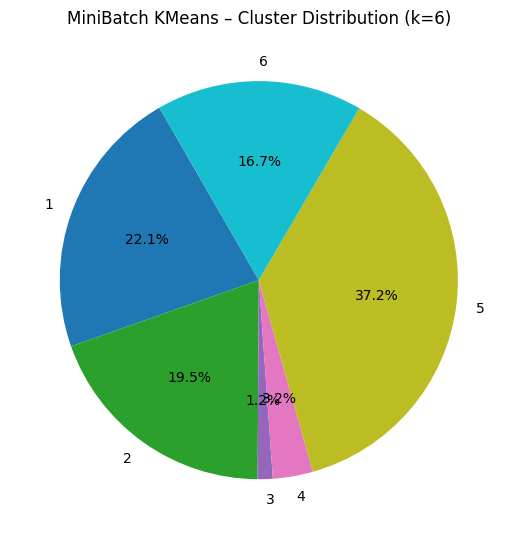

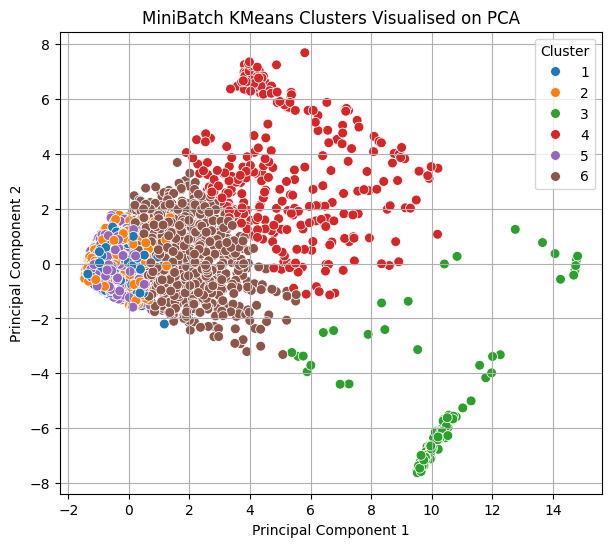


📊 Cluster Profiles – Feature Means (k=6):


,Age,TotalPurchases,AverageOrderValue,CustomerLifetimeValue,EmailEngagementRate,SocialMediaEngagementRate,CustomerServiceInteractions,AverageSatisfactionScore,EmailConversionRate,SocialMediaConversionRate,SearchEngineConversionRate,RepeatCustomer,PremiumMember,HasReturnedItems,CustomerTenure
Cluster_KMeans_k6,,,,,,,,,,,,,,,
1,35.17,4.90,56.17,254.15,0.32,0.29,1.92,6.42,0.16,0.17,0.33,0.91,0.25,0.33,54.57
2,35.67,5.34,62.29,309.57,0.31,0.29,2.06,7.05,0.36,0.20,0.17,0.93,0.22,0.33,54.64
3,35.34,4.96,1223.78,1117.09,0.28,0.30,2.29,6.94,0.19,0.19,0.21,0.88,0.22,0.27,51.70
4,35.56,7.77,342.16,3563.97,0.27,0.30,2.10,6.85,0.19,0.20,0.19,0.98,0.24,0.37,56.18
5,35.56,4.63,55.29,230.99,0.25,0.28,1.99,7.25,0.14,0.21,0.14,0.90,0.24,0.33,55.04
6,35.73,6.17,209.14,1023.12,0.28,0.28,2.03,6.94,0.18,0.20,0.19,0.96,0.23,0.35,54.76



📈 Distribution of Most Influential Features by Cluster:


/tmp/ipython-input-136-1841652009.py:56: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




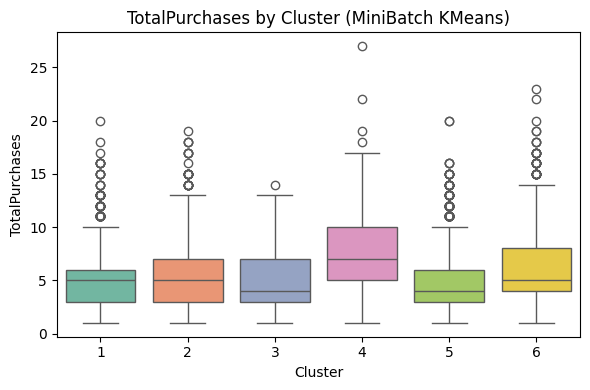

/tmp/ipython-input-136-1841652009.py:56: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




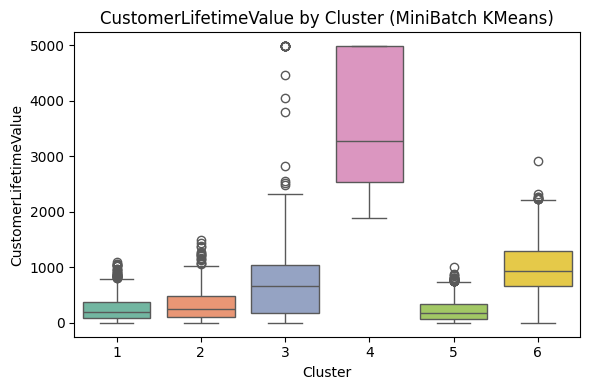

/tmp/ipython-input-136-1841652009.py:56: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




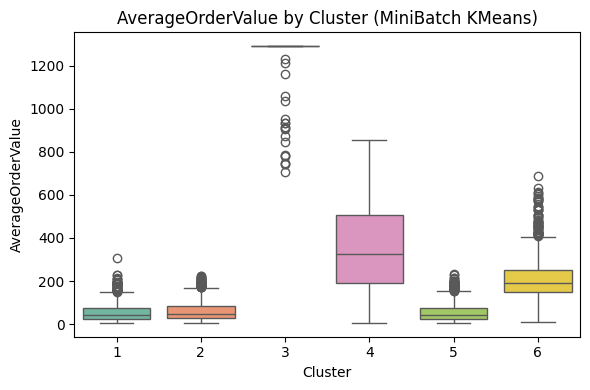


🔍 Agglomerative Clustering (k=4) Cluster Profiling

📦 Cluster Sizes:


,count
Cluster_Agglo_k4,
1,8148
2,218
3,97
4,768


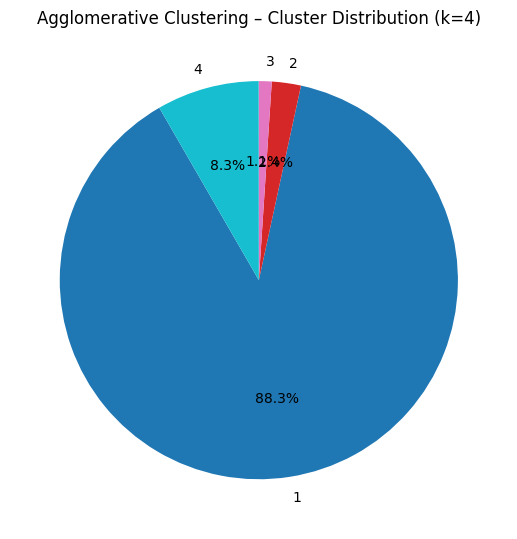

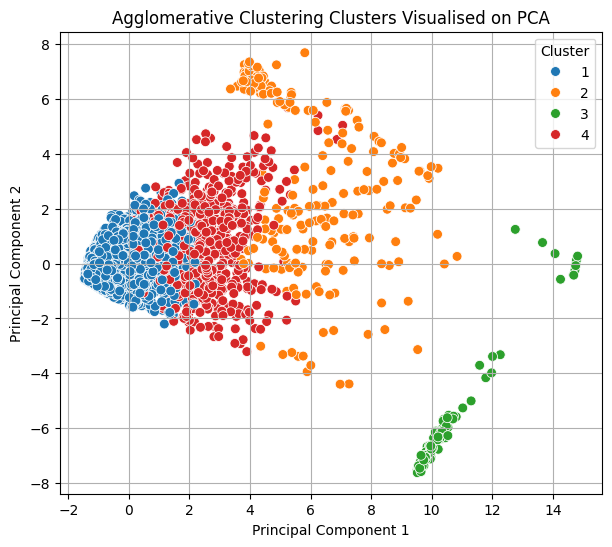


📊 Cluster Profiles – Feature Means (k=4):


,Age,TotalPurchases,AverageOrderValue,CustomerLifetimeValue,EmailEngagementRate,SocialMediaEngagementRate,CustomerServiceInteractions,AverageSatisfactionScore,EmailConversionRate,SocialMediaConversionRate,SearchEngineConversionRate,RepeatCustomer,PremiumMember,HasReturnedItems,CustomerTenure
Cluster_Agglo_k4,,,,,,,,,,,,,,,
1,35.44,5.03,69.50,322.87,0.28,0.29,1.99,6.95,0.20,0.20,0.20,0.92,0.24,0.33,54.79
2,36.61,6.28,429.48,3705.75,0.25,0.31,2.17,6.86,0.21,0.18,0.19,0.96,0.24,0.35,53.57
3,34.02,5.34,1285.46,1018.08,0.29,0.30,2.25,6.96,0.18,0.19,0.21,0.91,0.21,0.29,51.73
4,36.26,6.55,255.35,1443.09,0.30,0.27,2.06,7.09,0.20,0.20,0.22,0.95,0.24,0.35,55.78



📈 Distribution of Most Influential Features by Cluster:


/tmp/ipython-input-136-1841652009.py:56: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




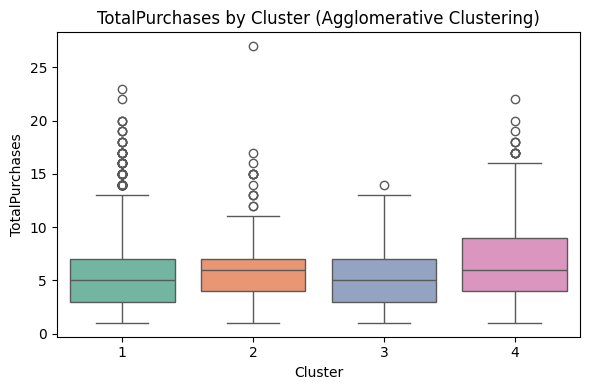

/tmp/ipython-input-136-1841652009.py:56: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




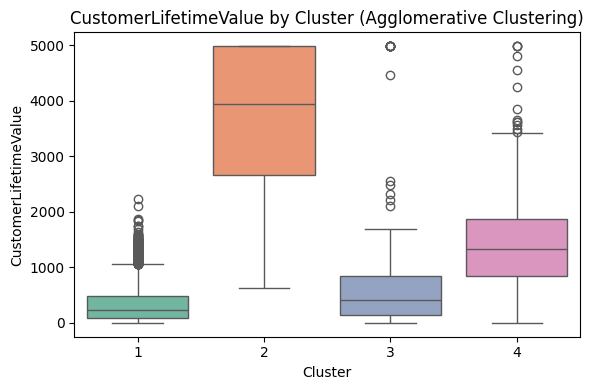

/tmp/ipython-input-136-1841652009.py:56: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




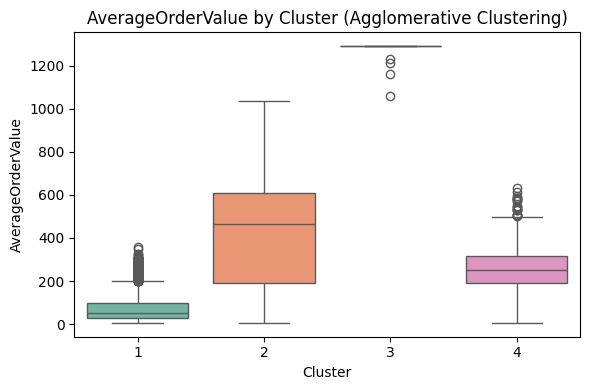


=== Mean PC scores per cluster ===


,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8
Cluster,,,,,,,,
1,-0.50,-0.07,-0,-0,0.01,-0.01,0.01,-0
2,6.07,2.84,0.05,-0.01,0.03,-0.31,0.05,0.05
3,10.59,-5.82,0.10,0.10,0.09,0.25,-0.06,-0.09
4,2.26,0.62,0.02,0.04,-0.09,0.14,-0.07,0.02


In [ ]:
# -------------------------------------------
# PART 3: PCA–Cluster Interpretation & Profiling
# -------------------------------------------

# 1. PCA Loadings – Feature Contributions to Each Component
pca_loadings = pd.DataFrame(pca.components_.T, index=features, columns=[f'PC{i+1}' for i in range(pca.n_components_)])
print("🔍 PCA Loadings (Feature Contributions to Principal Components):")
display(pca_loadings)

# Identify most influential features from first two components
top_features_pc1 = pca_loadings['PC1'].abs().sort_values(ascending=False).head(3).index.tolist()
top_features_pc2 = pca_loadings['PC2'].abs().sort_values(ascending=False).head(3).index.tolist()
important_features = list(set(top_features_pc1 + top_features_pc2))

print("\n📌 Most Influential Features (Top 3 from PC1 and PC2):")
print(", ".join(important_features))

def profile_and_visualise_clusters(df, pca_coords, cluster_col, method_name, k_value):
    print(f"\n============================")
    print(f"🔍 {method_name} (k={k_value}) Cluster Profiling")
    print(f"============================")

    # 1. Cluster Sizes
    cluster_sizes = df[cluster_col].value_counts().sort_index()
    print("\n📦 Cluster Sizes:")
    display(cluster_sizes)

    # Pie Chart for Cluster Proportions
    plt.figure(figsize=(5.5, 5.5))
    cluster_sizes.plot.pie(autopct='%1.1f%%', startangle=120, colormap='tab10')
    plt.title(f"{method_name} – Cluster Distribution (k={k_value})")
    plt.ylabel("")
    plt.tight_layout()
    plt.show()

    # 2. PCA Scatter Plot Coloured by Cluster
    plt.figure(figsize=(7, 6))
    sns.scatterplot(x=pca_coords[:, 0], y=pca_coords[:, 1], hue=df[cluster_col], palette='tab10', s=50)
    plt.title(f"{method_name} Clusters Visualised on PCA")
    plt.xlabel("Principal Component 1")
    plt.ylabel("Principal Component 2")
    plt.legend(title="Cluster")
    plt.grid(True)
    plt.show()

    # 3. Cluster Profile Table (Mean of Original Features)
    profile_features = features + [cluster_col]
    cluster_profile = df[profile_features].groupby(cluster_col).mean().round(2)
    print(f"\n📊 Cluster Profiles – Feature Means (k={k_value}):")
    display(cluster_profile)

    # 4. Feature Distribution Boxplots (Important Features)
    print("\n📈 Distribution of Most Influential Features by Cluster:")
    for feature in important_features:
        plt.figure(figsize=(6, 4))
        sns.boxplot(x=df[cluster_col], y=df[feature], palette='Set2')
        plt.title(f"{feature} by Cluster ({method_name})")
        plt.xlabel("Cluster")
        plt.ylabel(feature)
        plt.tight_layout()
        plt.show()

# Run for MiniBatch KMeans (k = 6)
profile_and_visualise_clusters(
    df=df_processed,
    pca_coords=pca_data,
    cluster_col='Cluster_KMeans_k6',
    method_name='MiniBatch KMeans',
    k_value=6
)

# Run for Agglomerative Clustering (k = 4)
profile_and_visualise_clusters(
    df=df_processed,
    pca_coords=pca_data,
    cluster_col='Cluster_Agglo_k4',
    method_name='Agglomerative Clustering',
    k_value=4
)

# Get the column name of the best clustering result
best_k = best_overall['k']
best_method = best_overall['Method']
cluster_column = ''

if best_method == 'KMeans':
    cluster_column = f'Cluster_KMeans_k{best_k}'
elif 'Agglo' in best_method:
    cluster_column = f'Cluster_Agglo_k{best_k}'


# Create PCA scores DataFrame and append cluster label
pca_scores_df = pd.DataFrame(pca_data, columns=[f'PC{i+1}' for i in range(pca_data.shape[1])])
pca_scores_df['Cluster'] = df_processed[cluster_column].values

# Step 4: Compute mean PC scores per cluster
cluster_pc_means = pca_scores_df.groupby('Cluster').mean().round(2)
print("\n=== Mean PC scores per cluster ===")
display(cluster_pc_means)

In [ ]:
# Example for MiniBatch KMeans with k=6
cluster_col = 'Cluster_Agglo_k4'

# Create PCA scores DataFrame and append cluster label
pca_scores_df = pd.DataFrame(pca_data, columns=[f'PC{i+1}' for i in range(pca_data.shape[1])])
pca_scores_df[cluster_col] = df_processed[cluster_col].values

# Compute mean PC scores per cluster
mean_pc_scores = pca_scores_df.groupby(cluster_col).mean().round(2)
print(f"\n📌 Mean Principal Component Scores per Cluster ({cluster_col}):")
display(mean_pc_scores)



📌 Mean Principal Component Scores per Cluster (Cluster_Agglo_k4):


,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8
Cluster_Agglo_k4,,,,,,,,
1,-0.50,-0.07,-0,-0,0.01,-0.01,0.01,-0
2,6.07,2.84,0.05,-0.01,0.03,-0.31,0.05,0.05
3,10.59,-5.82,0.10,0.10,0.09,0.25,-0.06,-0.09
4,2.26,0.62,0.02,0.04,-0.09,0.14,-0.07,0.02



📊 PCA Eigenvalues and Variance Explained:


,Principal Component,Eigenvalue,% Variance Explained,Cumulative % Variance
0,PC1,3.35,32.89,32.89
1,PC2,1.31,12.89,45.78
2,PC3,0.61,6.02,51.80
3,PC4,0.55,5.44,57.24
4,PC5,0.55,5.39,62.64
5,PC6,0.54,5.32,67.96
6,PC7,0.53,5.19,73.15
7,PC8,0.52,5.11,78.26


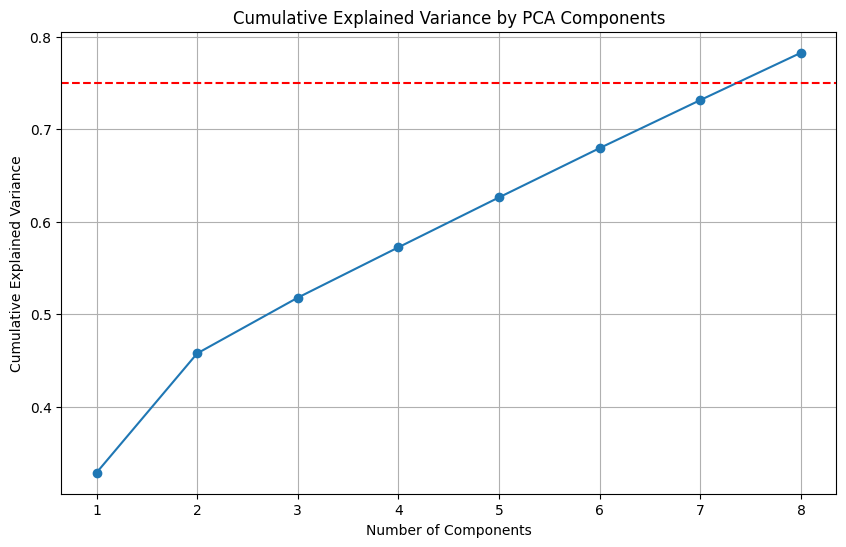

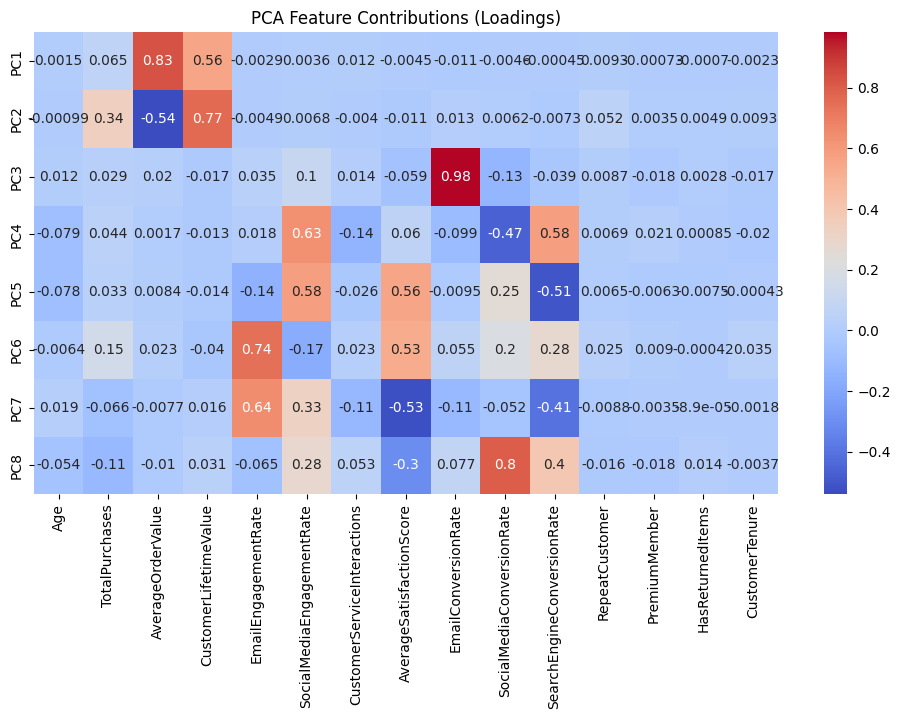

In [ ]:
# ===============================
# 📦 Imports
# ===============================
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

from scipy.stats.mstats import winsorize
from sklearn.preprocessing import RobustScaler
from sklearn.decomposition import PCA
from sklearn.cluster import AgglomerativeClustering, MiniBatchKMeans
from sklearn.metrics import silhouette_score, davies_bouldin_score, calinski_harabasz_score
from scipy.cluster.hierarchy import linkage as scipy_linkage, dendrogram

# ===============================
# 📌 Data Preparation
# ===============================

df_processed = df.copy()

# Winsorization for capping outliers
for col in ['AverageOrderValue', 'CustomerLifetimeValue']:
    df_processed[col] = winsorize(df_processed[col], limits=[0.01, 0.01])

# Feature selection
features = [
    'Age', 'TotalPurchases', 'AverageOrderValue', 'CustomerLifetimeValue',
    'EmailEngagementRate', 'SocialMediaEngagementRate',
    'CustomerServiceInteractions', 'AverageSatisfactionScore',
    'EmailConversionRate', 'SocialMediaConversionRate',
    'SearchEngineConversionRate', 'RepeatCustomer',
    'PremiumMember', 'HasReturnedItems', 'CustomerTenure'
]

# Scaling with RobustScaler
scaler = RobustScaler()
df_scaled = scaler.fit_transform(df_processed[features])

# ===============================
# 📌 Principal Component Analysis (PCA)
# ===============================

# Apply PCA to retain 75% of variance
pca = PCA(n_components=0.75)
pca_data = pca.fit_transform(df_scaled)

# Explained variance metrics
eigenvalues = pca.explained_variance_
explained_variance_ratio = pca.explained_variance_ratio_
cumulative_variance = np.cumsum(explained_variance_ratio)

# Display eigenvalues and variance explained
eigenvalue_df = pd.DataFrame({
    'Principal Component': [f'PC{i+1}' for i in range(len(eigenvalues))],
    'Eigenvalue': np.round(eigenvalues, 4),
    '% Variance Explained': np.round(explained_variance_ratio * 100, 2),
    'Cumulative % Variance': np.round(cumulative_variance * 100, 2)
})

print("\n📊 PCA Eigenvalues and Variance Explained:")
display(eigenvalue_df)

# Plot cumulative explained variance
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(explained_variance_ratio)+1), cumulative_variance, marker='o')
plt.axhline(y=0.75, color='red', linestyle='--')
plt.title('Cumulative Explained Variance by PCA Components')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.grid(True)
plt.show()

# ===============================
# 📌 PCA Loadings (Feature Contributions)
# ===============================

pca_loadings = pd.DataFrame(
    pca.components_,
    columns=features,
    index=[f'PC{i+1}' for i in range(len(pca.components_))]
)

plt.figure(figsize=(12, 6))
sns.heatmap(pca_loadings, cmap="coolwarm", annot=True)
plt.title("PCA Feature Contributions (Loadings)")
plt.show()


In [ ]:
!pip install opendatasets --upgrade --quiet

In [ ]:
import opendatasets as od

dataset = 'https://www.kaggle.com/datasets/noir1112/e-commerce-customer-engagement?select=ecommerce_customer_data.csv'

od.download(dataset)

Skipping, found downloaded files in "./e-commerce-customer-engagement" (use force=True to force download)


In [ ]:
import pandas as pd

# Load the dataset
df = pd.read_csv('/content/e-commerce-customer-engagement/ecommerce_customer_data.csv')

# Inspect the dataset
print("Dataset Shape:", df.shape)  # Dimensions of the dataset
print(df.info())  # Summary of column data types and missing values
print(df.head())  # First few rows for a quick preview

import pandas as pd
from tabulate import tabulate
import io
import re

# Capture the output of df.info()
buffer = io.StringIO()
df.info(buf=buffer)
info_string = buffer.getvalue()

# Parse the output to extract column information
lines = info_string.split('\n')[3:-2]  # Extract relevant lines
table_data = []
index = 0  # Initialize the index
for line in lines:
    # Use regex to extract column name, non-null count, and dtype
    match = re.search(r"(\S+)\s+(\d+)\s+non-null\s+(\S+)", line)
    if match:
        column_name = match.group(1)
        non_null_count = match.group(2)
        dtype = match.group(3)
        table_data.append([index, column_name, non_null_count, dtype])
        index += 1  # Increment the index

# Format with tabulate
formatted_table = tabulate(table_data, headers=["#", "Column", "Non-Null Count", "Dtype"], tablefmt="fancy_grid", showindex=False)

# Display the formatted table
print(formatted_table)

Dataset Shape: (10000, 23)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 23 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   CustomerID                   9508 non-null   object 
 1   RegistrationDate             9504 non-null   object 
 2   Age                          9485 non-null   float64
 3   Gender                       7388 non-null   object 
 4   IncomeLevel                  7497 non-null   object 
 5   Country                      9507 non-null   object 
 6   City                         9517 non-null   object 
 7   TotalPurchases               9470 non-null   float64
 8   AverageOrderValue            9481 non-null   float64
 9   CustomerLifetimeValue        9507 non-null   float64
 10  FavoriteCategory             8411 non-null   object 
 11  SecondFavoriteCategory       8450 non-null   object 
 12  EmailEngagementRate          9524 non-null   flo

In [ ]:
from IPython.display import display, HTML

# Calculate missing values and percentages
missing_values = df.isnull().sum()
missing_percent = (df.isnull().sum() / len(df)) * 100

# Create HTML for side-by-side display
output = f"""
<table>
<tr>
<th>Missing Values</th>
<th>Missing Values (%)</th>
</tr>
<tr>
<td>{missing_values.to_frame().to_html()}</td>
<td>{missing_percent.to_frame().to_html()}</td>
</tr>
</table>
"""

# Display the output
display(HTML(output))

# Drop columns with more than 30% missing values (you can adjust the threshold if needed)
threshold = 30
df = df.loc[:, missing_percent < threshold]
print("Shape After Dropping Columns with >30% Missing:", df.shape)

# Impute missing values for the remaining columns
# For numerical columns, fill with mean
numerical_cols = df.select_dtypes(include=['float64', 'int64']).columns
df[numerical_cols] = df[numerical_cols].fillna(df[numerical_cols].mean())

# For categorical columns, fill with 'Unknown'
categorical_cols = df.select_dtypes(include=['object']).columns
df[categorical_cols] = df[categorical_cols].fillna('Unknown')

# Check if there are any remaining missing values
print("Missing Values After Handling:\n", df.isnull().sum())


Missing Values,Missing Values (%)
,0
CustomerID,492
RegistrationDate,496
Age,515
Gender,2612
IncomeLevel,2503
Country,493
City,483
TotalPurchases,530
AverageOrderValue,519


Shape After Dropping Columns with >30% Missing: (10000, 23)
Missing Values After Handling:
 CustomerID                     0
RegistrationDate               0
Age                            0
Gender                         0
IncomeLevel                    0
Country                        0
City                           0
TotalPurchases                 0
AverageOrderValue              0
CustomerLifetimeValue          0
FavoriteCategory               0
SecondFavoriteCategory         0
EmailEngagementRate            0
SocialMediaEngagementRate      0
MobileAppUsage                 0
CustomerServiceInteractions    0
AverageSatisfactionScore       0
EmailConversionRate            0
SocialMediaConversionRate      0
SearchEngineConversionRate     0
RepeatCustomer                 0
PremiumMember                  0
HasReturnedItems               0
dtype: int64


In [ ]:
# Impute missing values in Age column with the median
df['Age'] = df['Age'].fillna(df['Age'].median())


In [ ]:
# Replace "L" with "Low" and "H" with "High" in the "IncomeLevel" column
df['IncomeLevel'] = df['IncomeLevel'].replace({'L': 'Low', 'H': 'High'})

# Replace "F" with "Female" and "M" with "Male" in the "Gender" column
df['Gender'] = df['Gender'].replace({'F': 'Female', 'M': 'Male'})

# Display the updated DataFrame
print(df.head())

  CustomerID RegistrationDate   Age             Gender IncomeLevel    Country  \
0    Unknown       2020-05-10    25            Unknown     Unknown      Other   
1  CUST00002       2021-07-18 34.54  Prefer not to say        High    Germany   
2  CUST00003       2021-02-04    43            Unknown        High     France   
3  CUST00004       2020-12-31    49             Female        High  Australia   
4  CUST00005       2022-06-27    29             Female   Very High  Australia   

          City  TotalPurchases  AverageOrderValue  CustomerLifetimeValue  ...  \
0        Tokyo               4              15.89                 672.92  ...   
1       London               6              27.64                 181.73  ...   
2      Unknown              10             161.74                1810.56  ...   
3  Los Angeles               5              14.19                  86.22  ...   
4        Tokyo               7           31147.43                2112.58  ...   

  SocialMediaEngagementRat

In [ ]:
# Convert RegistrationDate to datetime
df['RegistrationDate'] = pd.to_datetime(df['RegistrationDate'], errors='coerce')

# Drop rows with invalid dates
df.dropna(subset=['RegistrationDate'], inplace=True)

# Create a CustomerTenure column based on RegistrationDate
from datetime import datetime
current_date = datetime.now()
df['CustomerTenure'] = ((current_date - df['RegistrationDate']).dt.days // 30).astype(int)

# Drop the original RegistrationDate column
df.drop(columns=['RegistrationDate'], inplace=True)

print("Shape After Creating CustomerTenure:", df.shape)
print(df.columns)

Shape After Creating CustomerTenure: (9504, 23)
Index(['CustomerID', 'Age', 'Gender', 'IncomeLevel', 'Country', 'City',
       'TotalPurchases', 'AverageOrderValue', 'CustomerLifetimeValue',
       'FavoriteCategory', 'SecondFavoriteCategory', 'EmailEngagementRate',
       'SocialMediaEngagementRate', 'MobileAppUsage',
       'CustomerServiceInteractions', 'AverageSatisfactionScore',
       'EmailConversionRate', 'SocialMediaConversionRate',
       'SearchEngineConversionRate', 'RepeatCustomer', 'PremiumMember',
       'HasReturnedItems', 'CustomerTenure'],
      dtype='object')


In [ ]:
from sklearn.preprocessing import LabelEncoder
import pandas as pd

# Example: Label Encoding for binary columns (e.g., RepeatCustomer, PremiumMember)
label_cols = ['RepeatCustomer', 'PremiumMember', 'HasReturnedItems']
le = LabelEncoder()
for col in label_cols:
    df[col] = le.fit_transform(df[col])

print("Data After Label Encoding:\n", df.head())

print(df.columns)

Data After Label Encoding:
   CustomerID   Age             Gender IncomeLevel    Country         City  \
0    Unknown    25            Unknown     Unknown      Other        Tokyo   
1  CUST00002 34.54  Prefer not to say        High    Germany       London   
2  CUST00003    43            Unknown        High     France      Unknown   
3  CUST00004    49             Female        High  Australia  Los Angeles   
4  CUST00005    29             Female   Very High  Australia        Tokyo   

   TotalPurchases  AverageOrderValue  CustomerLifetimeValue FavoriteCategory  \
0               4              15.89                 672.92         Clothing   
1               6              27.64                 181.73      Electronics   
2              10             161.74                1810.56          Unknown   
3               5              14.19                  86.22           Sports   
4               7           31147.43                2112.58         Clothing   

   ... MobileAppUsage  Custo

In [ ]:
# 1. Replace '4.0' and 'Unknown' with NaN initially:
df['FavoriteCategory'] = df['FavoriteCategory'].replace(['4.0', 'Unknown'], pd.NA)
df['SecondFavoriteCategory'] = df['SecondFavoriteCategory'].replace(['4.0', 'Unknown'], pd.NA)

# 2. Calculate the most common categories (excluding NaNs):
most_common_fav = df['FavoriteCategory'].dropna().mode()[0]
most_common_second = df['SecondFavoriteCategory'].dropna().mode()[0]

# 3. Fill NaN values with the most common categories:
df['FavoriteCategory'] = df['FavoriteCategory'].fillna(most_common_fav)
df['SecondFavoriteCategory'] = df['SecondFavoriteCategory'].fillna(most_common_second)

# 4. Create the 'FavoriteCombination' column:
df['FavoriteCombination'] = df['FavoriteCategory'] + ' & ' + df['SecondFavoriteCategory']

# 5. Group by 'FavoriteCombination' and count values:
behavior_by_combination = df.groupby('FavoriteCombination')['TotalPurchases'].size()

# 6. Sort and display the top 10 results:
print(behavior_by_combination.sort_values(ascending=False).head(10))

print("Shape After FavoriteCombination:", df.shape)
print(df.columns)
print("Data After FavoriteCombination:\n", df.head())

FavoriteCombination
Beauty & Home Goods         662
Electronics & Home Goods    292
Beauty & Books              280
Beauty & Sports             279
Beauty & Clothing           277
Beauty & Electronics        276
Home Goods & Home Goods     275
Books & Home Goods          272
Beauty & Toys               271
Food & Home Goods           267
Name: TotalPurchases, dtype: int64
Shape After FavoriteCombination: (9504, 24)
Index(['CustomerID', 'Age', 'Gender', 'IncomeLevel', 'Country', 'City',
       'TotalPurchases', 'AverageOrderValue', 'CustomerLifetimeValue',
       'FavoriteCategory', 'SecondFavoriteCategory', 'EmailEngagementRate',
       'SocialMediaEngagementRate', 'MobileAppUsage',
       'CustomerServiceInteractions', 'AverageSatisfactionScore',
       'EmailConversionRate', 'SocialMediaConversionRate',
       'SearchEngineConversionRate', 'RepeatCustomer', 'PremiumMember',
       'HasReturnedItems', 'CustomerTenure', 'FavoriteCombination'],
      dtype='object')
Data After FavoriteC

In [ ]:
print("Missing Values2:\n", df.isnull().sum())

Missing Values2:
 CustomerID                     0
Age                            0
Gender                         0
IncomeLevel                    0
Country                        0
City                           0
TotalPurchases                 0
AverageOrderValue              0
CustomerLifetimeValue          0
FavoriteCategory               0
SecondFavoriteCategory         0
EmailEngagementRate            0
SocialMediaEngagementRate      0
MobileAppUsage                 0
CustomerServiceInteractions    0
AverageSatisfactionScore       0
EmailConversionRate            0
SocialMediaConversionRate      0
SearchEngineConversionRate     0
RepeatCustomer                 0
PremiumMember                  0
HasReturnedItems               0
CustomerTenure                 0
FavoriteCombination            0
dtype: int64


In [ ]:
print(df.dtypes)

CustomerID                      object
Age                            float64
Gender                          object
IncomeLevel                     object
Country                         object
City                            object
TotalPurchases                 float64
AverageOrderValue              float64
CustomerLifetimeValue          float64
FavoriteCategory                object
SecondFavoriteCategory          object
EmailEngagementRate            float64
SocialMediaEngagementRate      float64
MobileAppUsage                  object
CustomerServiceInteractions    float64
AverageSatisfactionScore       float64
EmailConversionRate            float64
SocialMediaConversionRate      float64
SearchEngineConversionRate     float64
RepeatCustomer                   int64
PremiumMember                    int64
HasReturnedItems                 int64
CustomerTenure                   int64
FavoriteCombination             object
dtype: object


In [ ]:
df.to_csv('cleaned_data.csv', index=False)
print("Cleaned data saved.")

Cleaned data saved.


In [ ]:
# Save the DataFrame to an Excel file
!pip install openpyxl
df.to_excel('cleaned_ecommerce_data_16122024.xlsx', index=False)

In [ ]:
#DESCRIPTIVE ANALYSIS
# Summary statistics for numerical columns
df.describe()


,Age,TotalPurchases,AverageOrderValue,CustomerLifetimeValue,EmailEngagementRate,SocialMediaEngagementRate,CustomerServiceInteractions,AverageSatisfactionScore,EmailConversionRate,SocialMediaConversionRate,SearchEngineConversionRate,RepeatCustomer,PremiumMember,HasReturnedItems,CustomerTenure
count,9504,9504,9504,9504,9504,9504,9504,9504,9504,9504,9504,9504,9504,9504,9504
mean,34.54,5.04,192.85,677.46,0.28,0.29,2.00,6.96,0.20,0.20,0.20,1.74,0.43,0.62,54.81
std,14.74,3.11,1468.91,5721.41,0.15,0.16,1.39,1.85,0.12,0.12,0.12,0.63,0.79,0.90,20.84
min,-25,0,1.24,-9331.08,0.00,0.00,0,0,0.00,0.00,0.00,0,0,0,18
25%,25,3,28.71,103.39,0.17,0.17,1,5.75,0.11,0.11,0.11,2,0,0,37
50%,34.54,5,58.23,264.51,0.27,0.28,2,6.96,0.19,0.19,0.19,2,0,0,55
75%,44,7,126.01,635.77,0.38,0.38,3,8.28,0.26,0.27,0.27,2,0,2,73
max,91,27,51810.12,420810.82,0.89,0.85,11,10,0.78,0.82,0.78,2,2,2,91


In [ ]:
# Check if there are any remaining negative values
print(f"Negative Age values after fixing: {df[df['Age'] < 0].shape[0]}")
print(df['Age'].describe())  # Check summary statistics again


Negative Age values after fixing: 81
count    9504
mean    34.54
std     14.74
min       -25
25%        25
50%     34.54
75%        44
max        91
Name: Age, dtype: float64


In [ ]:
# Remove the rows with negative Age values
df_cleaned = df[df['Age'] >= 0]
print(f"New dataset shape after removal: {df_cleaned.shape}")



New dataset shape after removal: (9423, 24)


In [ ]:
# Verify if there are still any negative Age values
print(f"Negative Age values after fixing: {df[df['Age'] < 0].shape[0]}")


Negative Age values after fixing: 81


In [ ]:
# Clip Age values to be within a realistic range (e.g., 13-100)
df['Age'] = df['Age'].clip(lower=18, upper=100)
print(f"New min age: {df['Age'].min()}, New max age: {df['Age'].max()}")


New min age: 18.0, New max age: 91.0


In [ ]:
# Recalculate and review summary statistics
print(df['Age'].describe())


count    9504
mean    35.56
std     13.00
min        18
25%        25
50%     34.54
75%        44
max        91
Name: Age, dtype: float64


In [ ]:
df['CustomerLifetimeValue'] = df['CustomerLifetimeValue'].clip(lower=0)


In [ ]:
df = df[df['TotalPurchases'] > 0]


In [ ]:
df['AverageSatisfactionScore'] = df['AverageSatisfactionScore'].replace(0, df['AverageSatisfactionScore'].median())


/tmp/ipython-input-160-2698419050.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
df['AverageSatisfactionScore'] = df['AverageSatisfactionScore'].clip(lower=1)


/tmp/ipython-input-161-2465986406.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
df['RepeatCustomer'] = df['RepeatCustomer'].clip(0, 1)
df['PremiumMember'] = df['PremiumMember'].clip(0, 1)


/tmp/ipython-input-162-221134613.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipython-input-162-221134613.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
df['HasReturnedItems'] = df['HasReturnedItems'].clip(0, 1)


/tmp/ipython-input-163-2649503628.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



# **STATISTIC ANALYSIS**

In [ ]:
# Convert integer columns to int (remove decimals)
int_columns = ["Age", "TotalPurchases", "CustomerServiceInteractions",
               "RepeatCustomer", "PremiumMember", "HasReturnedItems", "CustomerTenure"]
df[int_columns] = df[int_columns].astype(int)

# Round float columns to 2 decimals
float_columns = ["AverageOrderValue", "CustomerLifetimeValue", "EmailEngagementRate",
                 "SocialMediaEngagementRate", "EmailConversionRate", "SocialMediaConversionRate",
                 "SearchEngineConversionRate", "AverageSatisfactionScore"]
df[float_columns] = df[float_columns].round(2)

# Format the describe() output to limit decimals
pd.options.display.float_format = lambda x: f"{x:.0f}" if x.is_integer() else f"{x:.2f}"

# Display cleaned summary
df.describe()





,Age,TotalPurchases,AverageOrderValue,CustomerLifetimeValue,EmailEngagementRate,SocialMediaEngagementRate,CustomerServiceInteractions,AverageSatisfactionScore,EmailConversionRate,SocialMediaConversionRate,SearchEngineConversionRate,RepeatCustomer,PremiumMember,HasReturnedItems,CustomerTenure
count,9231,9231,9231,9231,9231,9231,9231,9231,9231,9231,9231,9231,9231,9231,9231
mean,35.52,5.19,193.68,705.14,0.28,0.29,2.00,6.96,0.20,0.20,0.20,0.92,0.24,0.34,54.81
std,12.99,3.04,1487.94,5800.83,0.15,0.16,1.39,1.85,0.12,0.12,0.12,0.27,0.42,0.47,20.85
min,18,1,1.24,0,0,0,0,1,0,0,0,0,0,0,18
25%,25,3,28.71,112.13,0.17,0.17,1,5.76,0.11,0.11,0.11,1,0,0,37
50%,34,5,58.26,278.08,0.27,0.28,2,6.96,0.19,0.19,0.19,1,0,0,55
75%,44,7,125.91,651.93,0.38,0.38,3,8.28,0.26,0.27,0.27,1,0,1,73
max,91,27,51810.12,420810.82,0.89,0.85,11,10,0.78,0.82,0.78,1,1,1,91


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 9231 entries, 0 to 9999
Data columns (total 24 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   CustomerID                   9231 non-null   object 
 1   Age                          9231 non-null   int64  
 2   Gender                       9231 non-null   object 
 3   IncomeLevel                  9231 non-null   object 
 4   Country                      9231 non-null   object 
 5   City                         9231 non-null   object 
 6   TotalPurchases               9231 non-null   int64  
 7   AverageOrderValue            9231 non-null   float64
 8   CustomerLifetimeValue        9231 non-null   float64
 9   FavoriteCategory             9231 non-null   object 
 10  SecondFavoriteCategory       9231 non-null   object 
 11  EmailEngagementRate          9231 non-null   float64
 12  SocialMediaEngagementRate    9231 non-null   float64
 13  MobileAppUsage         

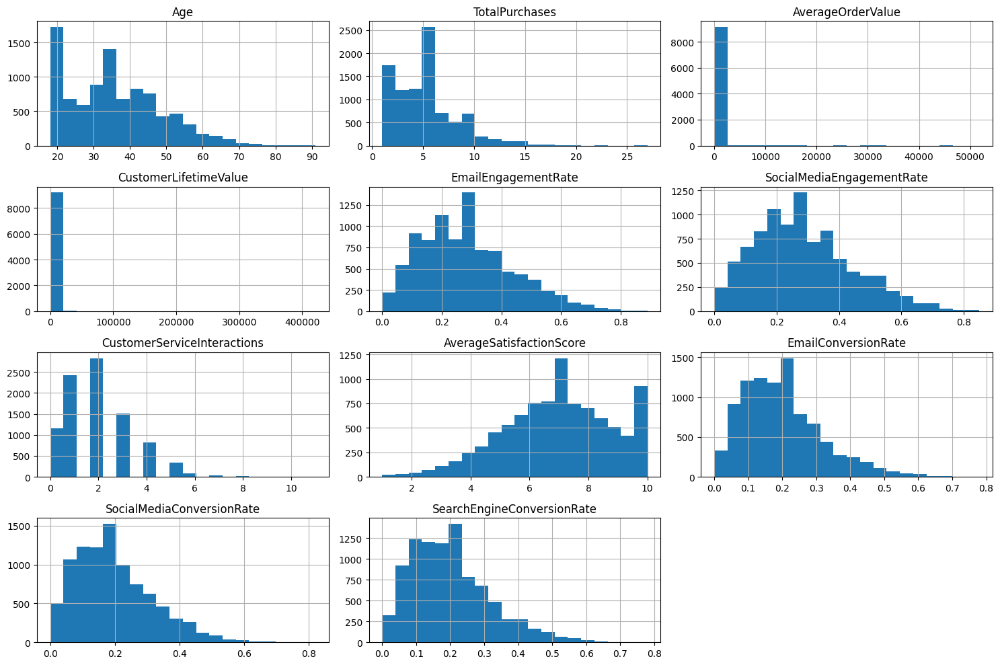

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plotting histograms for all numerical columns
df[numerical_cols].hist(figsize=(15, 10), bins=20)
plt.tight_layout()
plt.show()



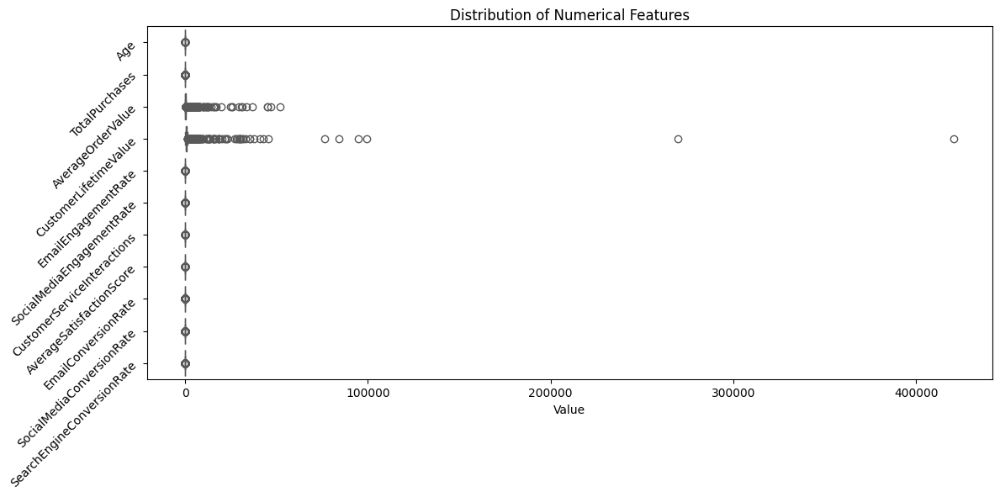

In [ ]:
# Boxplots for key numerical columns (e.g., TotalPurchases, AverageOrderValue)
plt.figure(figsize=(12, 6))  # Adjust figure size for better visibility
sns.boxplot(data=df[numerical_cols], orient="h", palette="Set2")
plt.title("Distribution of Numerical Features")  # Add a title
plt.xlabel("Value")  # Add x-axis label
plt.yticks(rotation=45, ha='right')  # Rotate y-axis labels for readability
plt.tight_layout()  # Adjust layout to prevent overlapping elements
plt.show()

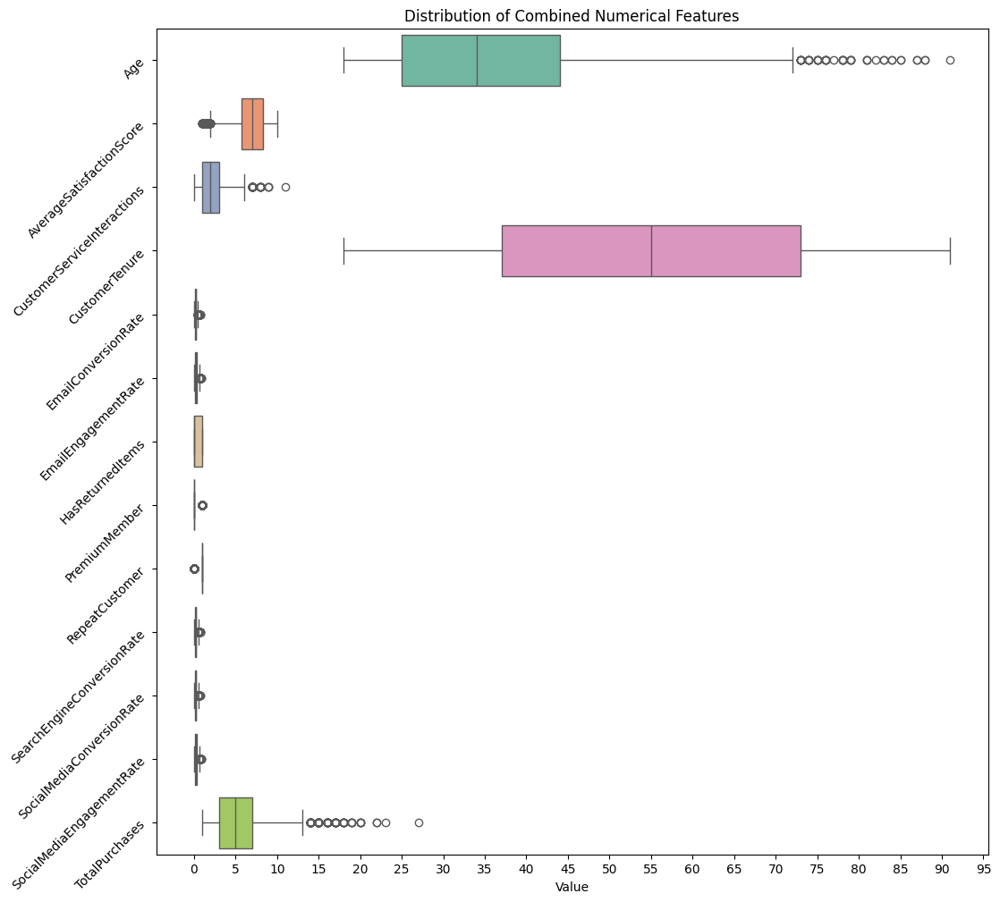

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Define the features to plot, selecting only numerical columns
features_combined = df.select_dtypes(include=['number']).columns.difference(['AverageOrderValue', 'CustomerLifetimeValue']).tolist()

# Set up a larger figure size for better visibility
plt.figure(figsize=(12, 12))

# First subplot for combined numerical features
sns.boxplot(data=df[features_combined], orient="h", palette="Set2")
plt.title("Distribution of Combined Numerical Features")
plt.xlabel("Value")
plt.yticks(rotation=45, ha='right')

# Set the x-axis ticks to increments of 5
# Calculate min and max only for numerical columns
min_val = df[features_combined].min().min()
max_val = df[features_combined].max().max()
plt.xticks(np.arange(min_val, max_val + 5, 5))

plt.show()

In [ ]:
!pip install plotly
import plotly.express as px
from IPython.display import display, HTML

# Frequency of categories in categorical columns (excluding CustomerID)
categorical_cols = df.select_dtypes(include=['object']).columns
categorical_cols = categorical_cols[categorical_cols != 'CustomerID']  # Exclude CustomerID

for col in categorical_cols:
    # Create and display the table of value counts
    value_counts = df[col].value_counts().to_frame()
    value_counts.reset_index(inplace=True)
    value_counts.columns = ['Category', 'Frequency']
    display(HTML(value_counts.to_html()))

    # Create and display the interactive bar chart
    fig = px.bar(
        value_counts,  # Use the value_counts DataFrame for the chart
        x='Category',  # Set x-axis to 'Category'
        y='Frequency',  # Set y-axis to 'Frequency'
        title=f"Frequency of Categories in {col}"
    )
    fig.update_layout(xaxis_tickangle=-45)  # Rotate x-axis labels
    fig.show()

,Category,Frequency
0,Unknown,2404
1,Other,1760
2,Female,1717
3,Male,1685
4,Prefer not to say,1665


,Category,Frequency
0,Unknown,2295
1,Very High,1815
2,Medium,1783
3,Low,1681
4,High,1657


,Category,Frequency
0,France,1132
1,Japan,1120
2,USA,1117
3,Australia,1101
4,Canada,1087
5,Other,1081
6,UK,1075
7,Germany,1073
8,Unknown,445


,Category,Frequency
0,New York,1134
1,Berlin,1124
2,London,1116
3,Tokyo,1113
4,Other,1089
5,Los Angeles,1076
6,Paris,1068
7,Sydney,1062
8,Unknown,449


,Category,Frequency
0,Beauty,2503
1,Sports,991
2,Electronics,984
3,Toys,957
4,Food,955
5,Clothing,952
6,Books,946
7,Home Goods,943


,Category,Frequency
0,Home Goods,2433
1,Electronics,997
2,Clothing,980
3,Sports,979
4,Food,976
5,Toys,960
6,Beauty,958
7,Books,948


,Category,Frequency
0,Unknown,2251
1,Never,1762
2,Low,1749
3,Medium,1739
4,High,1730


,Category,Frequency
0,Beauty & Home Goods,647
1,Electronics & Home Goods,283
2,Beauty & Books,274
3,Beauty & Sports,271
4,Beauty & Clothing,270
5,Beauty & Electronics,267
6,Beauty & Toys,265
7,Food & Home Goods,263
8,Books & Home Goods,262
9,Beauty & Food,261


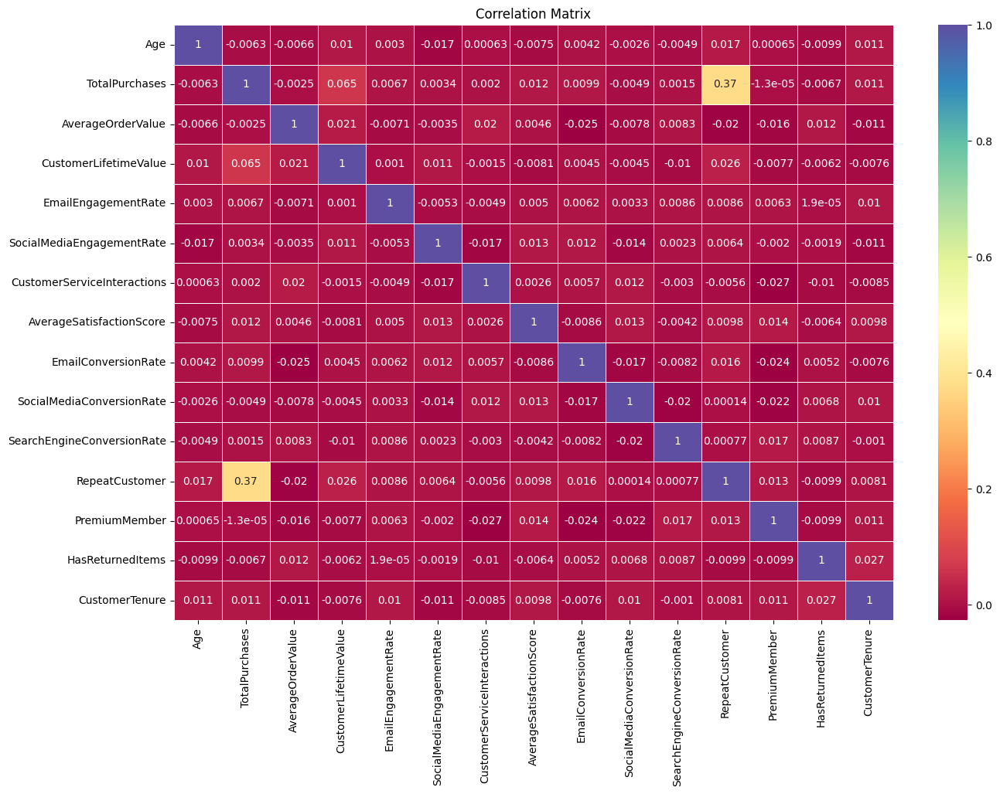

In [ ]:
# Correlation matrix to explore relationships between numerical columns
# Select only numerical features (excluding those with 'object' dtype)
numerical_cols = df.select_dtypes(include=['number']).columns
correlation_matrix = df[numerical_cols].corr()

plt.figure(figsize=(15, 10))
sns.heatmap(correlation_matrix, annot=True, cmap="Spectral", linewidths=0.5)
plt.title('Correlation Matrix')
plt.show()

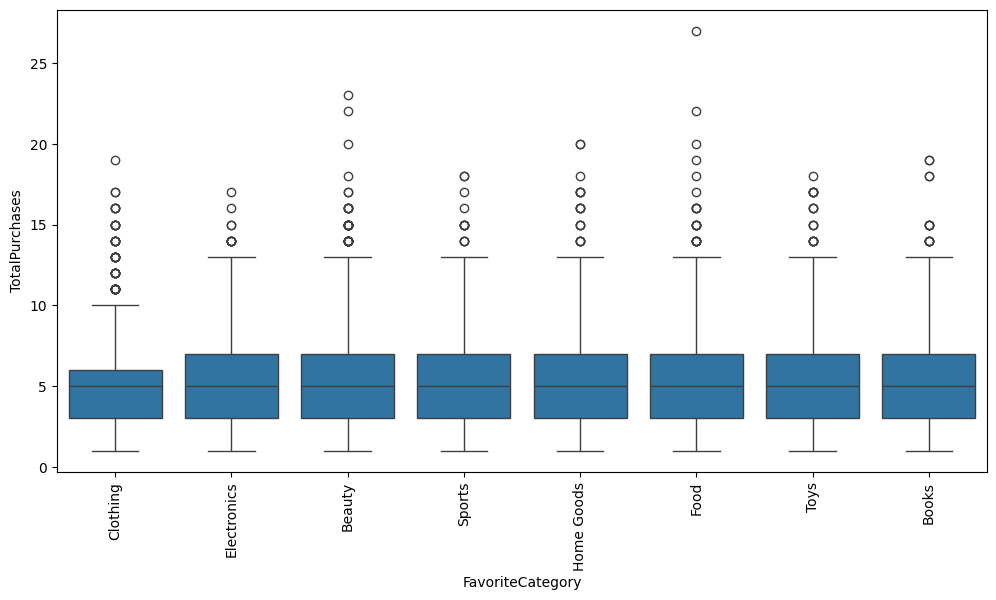

In [ ]:
# Grouping by 'FavoriteCategory' and calculating mean of numerical features
grouped_by_fav_category = df.groupby('FavoriteCategory')[numerical_cols].mean()

# Boxplot for TotalPurchases by FavoriteCategory
plt.figure(figsize=(12, 6))
sns.boxplot(x='FavoriteCategory', y='TotalPurchases', data=df)
plt.xticks(rotation=90)
plt.show()


In [ ]:
# Check for missing values in the dataset
missing_values = df.isnull().sum()
missing_percent = (missing_values / len(df)) * 100
missing_data = pd.DataFrame({"Missing Values": missing_values, "Percentage": missing_percent})
print(missing_data[missing_data['Percentage'] > 0])


Empty DataFrame
Columns: [Missing Values, Percentage]
Index: []


In [ ]:
# Add import statement at the beginning of your code (e.g., in cell ipython-input-48-484bce2eeb5e)
import numpy as np

from scipy import stats

# Calculate Z-scores for numerical features
z_scores = stats.zscore(df[numerical_cols])
abs_z_scores = np.abs(z_scores)

# Identify rows with Z-scores > 3 (potential outliers)
outliers = (abs_z_scores > 3).all(axis=1)
print(f"Number of outliers: {outliers.sum()}")

Number of outliers: 0


Age                            0.53
TotalPurchases                 1.10
AverageOrderValue             22.53
CustomerLifetimeValue         53.97
EmailEngagementRate            0.62
SocialMediaEngagementRate      0.57
CustomerServiceInteractions    0.78
AverageSatisfactionScore      -0.29
EmailConversionRate            0.90
SocialMediaConversionRate      0.83
SearchEngineConversionRate     0.87
RepeatCustomer                -3.12
PremiumMember                  1.24
HasReturnedItems               0.70
CustomerTenure                -0.00
dtype: float64


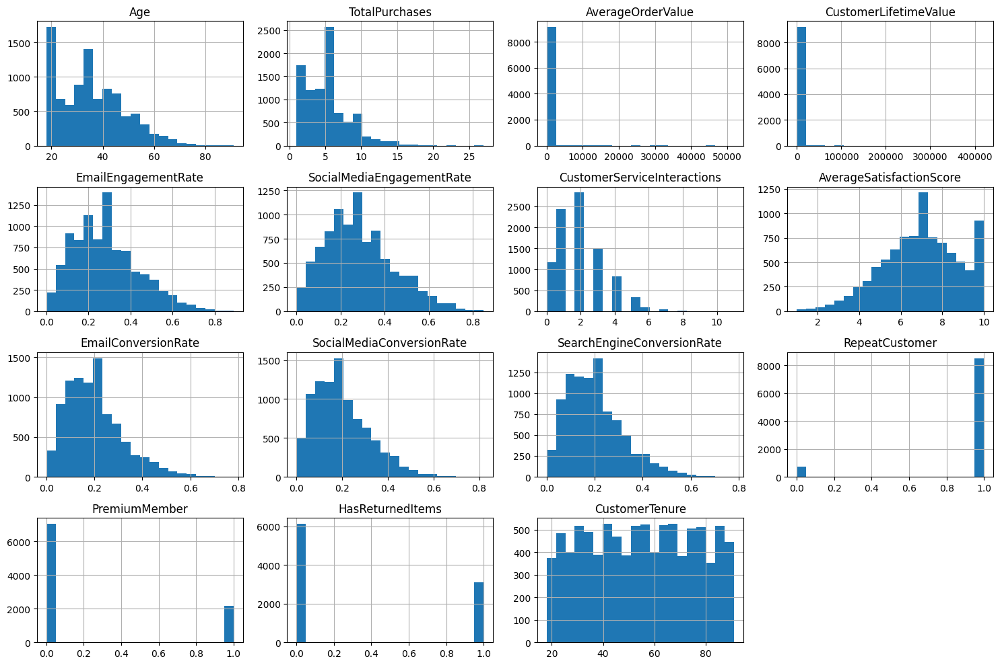

In [ ]:
# Checking skewness of numerical features
skewness = df[numerical_cols].skew()
print(skewness)

# Visualize skewness
df[numerical_cols].hist(figsize=(15, 10), bins=20)
plt.tight_layout()
plt.show()


In [ ]:
n_samples, n_features = df.shape
ratio = n_features / n_samples
print(f"Feature-to-Sample Ratio: {ratio}")


Feature-to-Sample Ratio: 0.0025999350016249595


In [ ]:
sparsity = (df != 0).mean().mean()
print(f"Sparsity of the dataset: {sparsity:.2f}")


Sparsity of the dataset: 0.93


Dataset Shape: (9231, 24)
Feature-to-Sample Ratio: 0.0025999350016249595
The dataset is not high-dimensional.
Sparsity of the dataset: 0.93


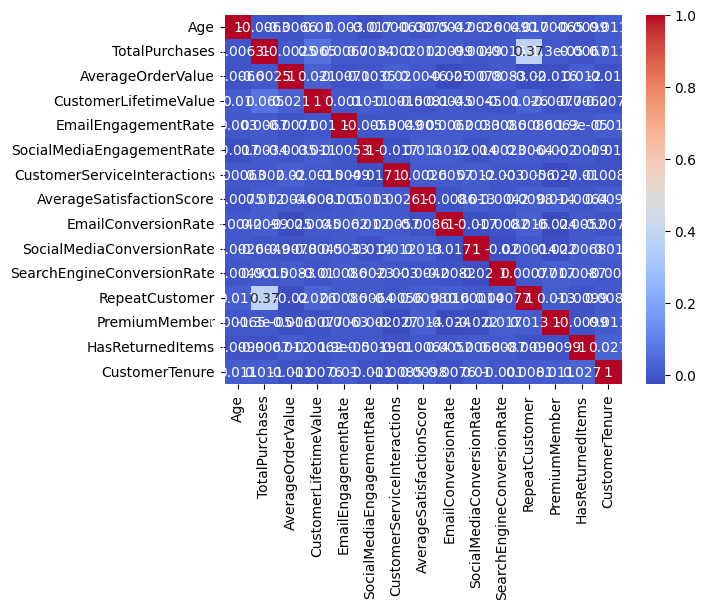

In [ ]:
n_samples, n_features = df.shape
ratio = n_features / n_samples
print(f"Dataset Shape: {df.shape}")
print(f"Feature-to-Sample Ratio: {ratio}")

# Check if the feature-to-sample ratio is greater than 1
if ratio > 1:
    print("The dataset is likely high-dimensional.")
else:
    print("The dataset is not high-dimensional.")

# Check for sparsity
sparsity = (df != 0).mean().mean()
print(f"Sparsity of the dataset: {sparsity:.2f}")

numerical_cols = df.select_dtypes(include=['number']).columns
correlation_matrix = df[numerical_cols].corr()
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm")
plt.show()



## **CLUSTERING ANALYSIS WITHOUT PCA**

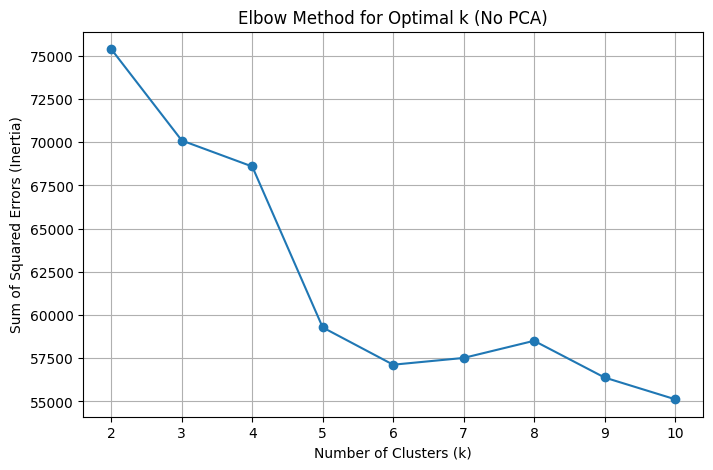


🔍 Clustering Evaluation for k=4 (No PCA)

📊 KMeans Cluster Counts (No PCA, k=4):


,0,Count
0,1,4026
1,2,2405
2,3,719
3,4,2081



📊 Agglomerative Cluster Counts (No PCA, k=4, linkage=ward):


,0,Count
0,1,8406
1,2,204
2,3,86
3,4,535



📈 Evaluation Scores for k=4 (No PCA):


,Method,k,Silhouette,DB,CH,Composite
0,KMeans-NoPCA,4,0.06,2.83,1164.45,-1.61
1,Agglo-NoPCA-ward,4,0.29,1.35,1456.01,0.39


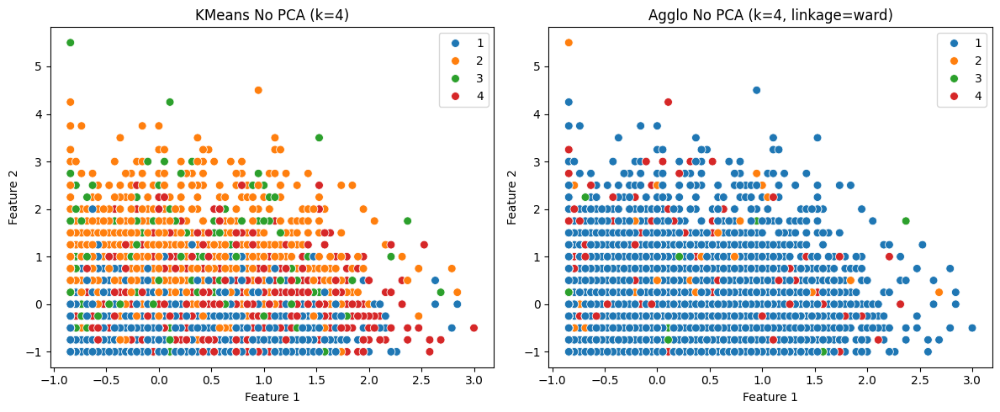


🔍 Clustering Evaluation for k=5 (No PCA)

📊 KMeans Cluster Counts (No PCA, k=5):


,0,Count
0,1,3987
1,2,2305
2,3,650
3,4,111
4,5,2178



📊 Agglomerative Cluster Counts (No PCA, k=5, linkage=ward):


,0,Count
0,1,204
1,2,6422
2,3,86
3,4,535
4,5,1984



📈 Evaluation Scores for k=5 (No PCA):


,Method,k,Silhouette,DB,CH,Composite
0,KMeans-NoPCA,5,0.07,2.42,1361.46,-0.99
1,Agglo-NoPCA-ward,5,0.07,2.41,1224.52,-1.12


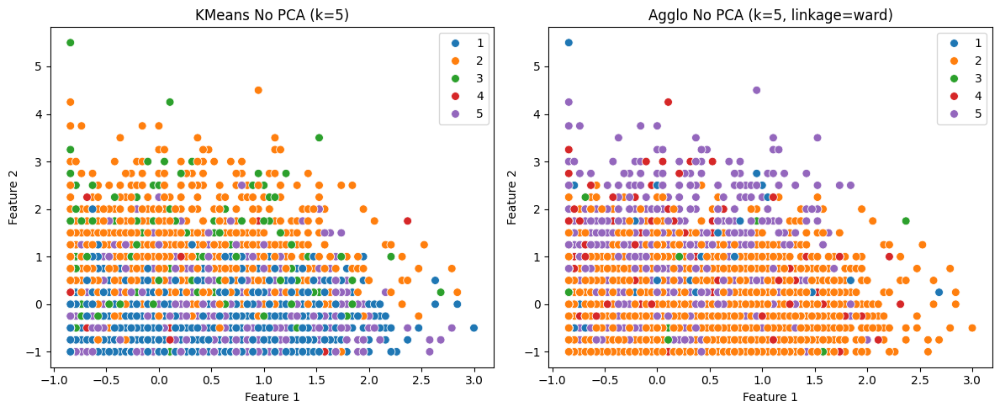


🔍 Clustering Evaluation for k=6 (No PCA)

📊 KMeans Cluster Counts (No PCA, k=6):


,0,Count
0,1,2634
1,2,1855
2,3,556
3,4,111
4,5,1875
5,6,2200



📊 Agglomerative Cluster Counts (No PCA, k=6, linkage=ward):


,0,Count
0,1,6422
1,2,1984
2,3,86
3,4,535
4,5,137
5,6,67



📈 Evaluation Scores for k=6 (No PCA):


,Method,k,Silhouette,DB,CH,Composite
0,KMeans-NoPCA,6,0.06,2.41,1204.01,-1.14
1,Agglo-NoPCA-ward,6,0.07,2.17,1052.14,-1.05


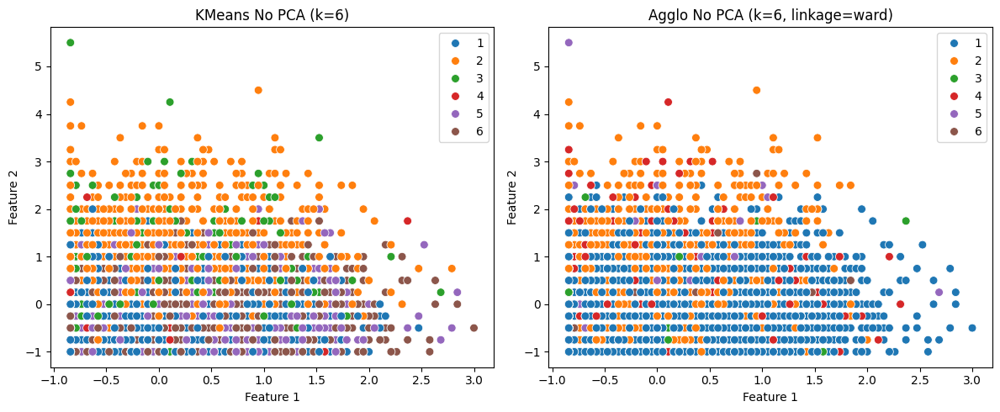


🔍 Clustering Evaluation for k=7 (No PCA)

📊 KMeans Cluster Counts (No PCA, k=7):


,0,Count
0,1,2357
1,2,1339
2,3,435
3,4,129
4,5,1245
5,6,1761
6,7,1965



📊 Agglomerative Cluster Counts (No PCA, k=7, linkage=ward):


,0,Count
0,1,5205
1,2,1984
2,3,1217
3,4,535
4,5,137
5,6,67
6,7,86



📈 Evaluation Scores for k=7 (No PCA):


,Method,k,Silhouette,DB,CH,Composite
0,KMeans-NoPCA,7,0.06,2.41,1043.42,-1.31
1,Agglo-NoPCA-ward,7,0.04,2.38,937.20,-1.40


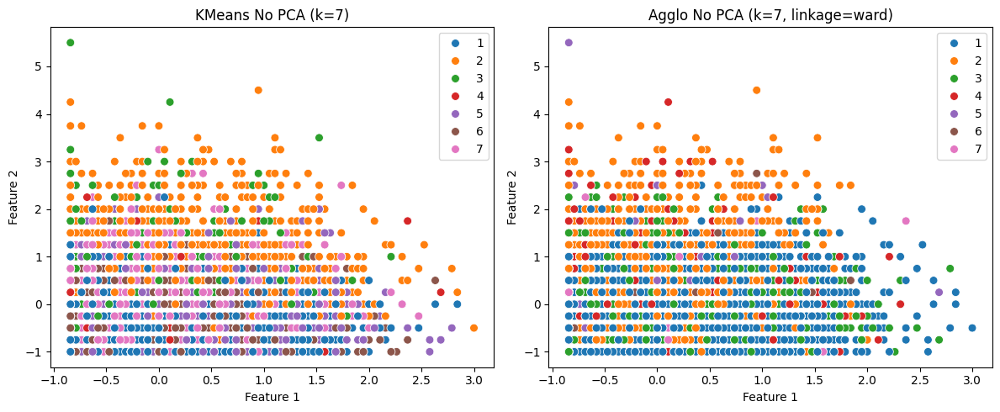


🔍 Clustering Evaluation for k=8 (No PCA)

📊 KMeans Cluster Counts (No PCA, k=8):


,0,Count
0,1,998
1,2,235
2,3,1135
3,4,1789
4,5,713
5,6,1260
6,7,1781
7,8,1320



📊 Agglomerative Cluster Counts (No PCA, k=8, linkage=ward):


,0,Count
0,1,1984
1,2,4729
2,3,1217
3,4,535
4,5,137
5,6,67
6,7,86
7,8,476



📈 Evaluation Scores for k=8 (No PCA):


,Method,k,Silhouette,DB,CH,Composite
0,KMeans-NoPCA,8,0.05,2.58,830.86,-1.70
1,Agglo-NoPCA-ward,8,0.04,2.40,850.93,-1.51


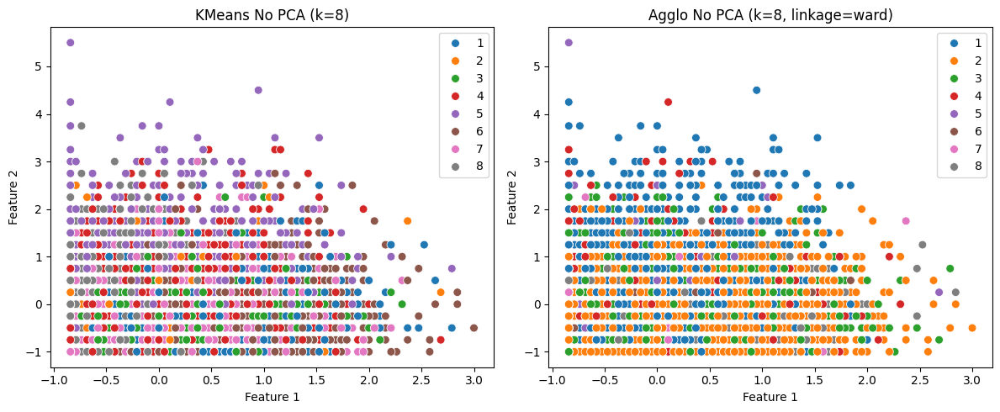


📋 Full Evaluation Metrics Summary (No PCA):


,Method,k,Silhouette,DB,CH,Composite
1,Agglo-NoPCA-ward,4,0.29,1.35,1456.01,0.39
0,KMeans-NoPCA,4,0.06,2.83,1164.45,-1.61
3,Agglo-NoPCA-ward,5,0.07,2.41,1224.52,-1.12
2,KMeans-NoPCA,5,0.07,2.42,1361.46,-0.99
5,Agglo-NoPCA-ward,6,0.07,2.17,1052.14,-1.05
4,KMeans-NoPCA,6,0.06,2.41,1204.01,-1.14
7,Agglo-NoPCA-ward,7,0.04,2.38,937.20,-1.40
6,KMeans-NoPCA,7,0.06,2.41,1043.42,-1.31
9,Agglo-NoPCA-ward,8,0.04,2.40,850.93,-1.51
8,KMeans-NoPCA,8,0.05,2.58,830.86,-1.70



📝 Best Score Comparison Summary (No PCA):


,Method,k,Silhouette,DB,CH,Composite
2,KMeans-NoPCA,5,0.07,2.42,1361.46,-0.99
1,Agglo-NoPCA-ward,4,0.29,1.35,1456.01,0.39


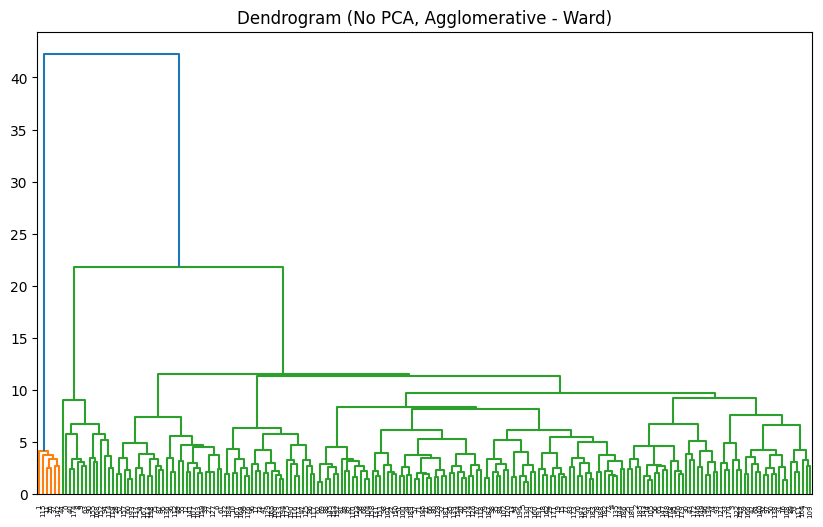

In [ ]:
# -------------------------------------------
# CLUSTERING WITHOUT PCA
# -------------------------------------------

# 1. Imports
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import MiniBatchKMeans, AgglomerativeClustering
from sklearn.metrics import silhouette_score, davies_bouldin_score, calinski_harabasz_score
from scipy.cluster.hierarchy import dendrogram, linkage
from scipy.stats.mstats import winsorize
from sklearn.preprocessing import RobustScaler
from sklearn.decomposition import PCA

# Step 1: Data Preparation (Moved from cell SfDqCa1C7-Dx)
df_processed = df.copy()

# Winsorization to cap outliers
for col in ['AverageOrderValue', 'CustomerLifetimeValue']:
    df_processed[col] = winsorize(df_processed[col], limits=[0.01, 0.01])

features = [
    'Age', 'TotalPurchases', 'AverageOrderValue', 'CustomerLifetimeValue',
    'EmailEngagementRate', 'SocialMediaEngagementRate',
    'CustomerServiceInteractions', 'AverageSatisfactionScore',
    'EmailConversionRate', 'SocialMediaConversionRate',
    'SearchEngineConversionRate', 'RepeatCustomer',
    'PremiumMember', 'HasReturnedItems', 'CustomerTenure'
]

# Step 2: Feature Scaling (Moved from cell SfDqCa1C7-Dx)
scaler = RobustScaler()
df_scaled = scaler.fit_transform(df_processed[features])




# 2. Evaluation Function
def evaluate_clustering(X, labels):
    sil = silhouette_score(X, labels)
    db = davies_bouldin_score(X, labels)
    ch = calinski_harabasz_score(X, labels)
    comp = sil - db + (ch / 1000)
    return sil, db, ch, comp

# 3. Elbow Method for KMeans (no PCA)
sse_no_pca = []
k_range = range(2, 11)
for k in k_range:
    kmeans = MiniBatchKMeans(n_clusters=k, batch_size=100, random_state=42)
    kmeans.fit(df_scaled)
    sse_no_pca.append(kmeans.inertia_)

plt.figure(figsize=(8, 5))
plt.plot(k_range, sse_no_pca, marker='o')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Sum of Squared Errors (Inertia)')
plt.title('Elbow Method for Optimal k (No PCA)')
plt.grid(True)
plt.show()

# 4. Clustering Evaluation & Visualisation (k = 4 to 8)
all_results_no_pca = []

for k in range(4, 9):
    print(f"\n{'='*60}\n🔍 Clustering Evaluation for k={k} (No PCA)\n{'='*60}")
    result_k = []

    # --- MiniBatch KMeans ---
    kmeans = MiniBatchKMeans(n_clusters=k, batch_size=100, random_state=42)
    kmeans_labels = kmeans.fit_predict(df_scaled) + 1
    df_processed[f'Cluster_KMeans_NoPCA_k{k}'] = kmeans_labels
    sil_km, db_km, ch_km, comp_km = evaluate_clustering(df_scaled, kmeans_labels)
    result_k.append({
        'Method': 'KMeans-NoPCA', 'k': k,
        'Silhouette': sil_km, 'DB': db_km, 'CH': ch_km, 'Composite': comp_km
    })

    print(f"\n📊 KMeans Cluster Counts (No PCA, k={k}):")
    display(pd.DataFrame(kmeans_labels).value_counts().sort_index().rename('Count').reset_index().rename(columns={'index': 'Cluster'}))

    # --- Agglomerative Clustering ---
    linkage_method = 'ward'
    ag_model = AgglomerativeClustering(n_clusters=k, linkage=linkage_method)
    ag_labels = ag_model.fit_predict(df_scaled) + 1
    df_processed[f'Cluster_Agglo_NoPCA_k{k}'] = ag_labels
    sil_ag, db_ag, ch_ag, comp_ag = evaluate_clustering(df_scaled, ag_labels)
    result_k.append({
        'Method': f'Agglo-NoPCA-{linkage_method}', 'k': k,
        'Silhouette': sil_ag, 'DB': db_ag, 'CH': ch_ag, 'Composite': comp_ag
    })

    print(f"\n📊 Agglomerative Cluster Counts (No PCA, k={k}, linkage={linkage_method}):")
    display(pd.DataFrame(ag_labels).value_counts().sort_index().rename('Count').reset_index().rename(columns={'index': 'Cluster'}))

    # Store results
    df_k = pd.DataFrame(result_k)
    all_results_no_pca.extend(result_k)
    print(f"\n📈 Evaluation Scores for k={k} (No PCA):")
    display(df_k)

    # Side-by-side scatter plots (first 2 scaled features)
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    sns.scatterplot(x=df_scaled[:, 0], y=df_scaled[:, 1], hue=kmeans_labels, palette='tab10', s=50)
    plt.title(f"KMeans No PCA (k={k})")
    plt.xlabel('Feature 1'); plt.ylabel('Feature 2')

    plt.subplot(1, 2, 2)
    sns.scatterplot(x=df_scaled[:, 0], y=df_scaled[:, 1], hue=ag_labels, palette='tab10', s=50)
    plt.title(f"Agglo No PCA (k={k}, linkage={linkage_method})")
    plt.xlabel('Feature 1'); plt.ylabel('Feature 2')

    plt.tight_layout()
    plt.show()

# 5. Summary Table
df_results_no_pca = pd.DataFrame(all_results_no_pca)
print("\n📋 Full Evaluation Metrics Summary (No PCA):")
display(df_results_no_pca.sort_values(by=['k', 'Method']))

# 6. Best Clustering Without PCA
best_kmeans_no_pca = df_results_no_pca[df_results_no_pca['Method'] == 'KMeans-NoPCA'].sort_values(by='Composite', ascending=False).iloc[0]
best_agglo_no_pca = df_results_no_pca[df_results_no_pca['Method'].str.contains('Agglo')].sort_values(by='Composite', ascending=False).iloc[0]

summary_table_no_pca = pd.DataFrame([best_kmeans_no_pca, best_agglo_no_pca])
print("\n📝 Best Score Comparison Summary (No PCA):")
display(summary_table_no_pca)

# 7. Dendrogram (Optional, if Agglo best)
if 'Agglo' in best_agglo_no_pca['Method']:
    sample_data = pd.DataFrame(df_scaled).sample(n=200, random_state=42)
    linked = linkage(sample_data, method='ward')

    plt.figure(figsize=(10, 6))
    dendrogram(linked)
    plt.title("Dendrogram (No PCA, Agglomerative - Ward)")
    plt.show()

# **#ANALYSIS--CLUSTERING WITH PCA**





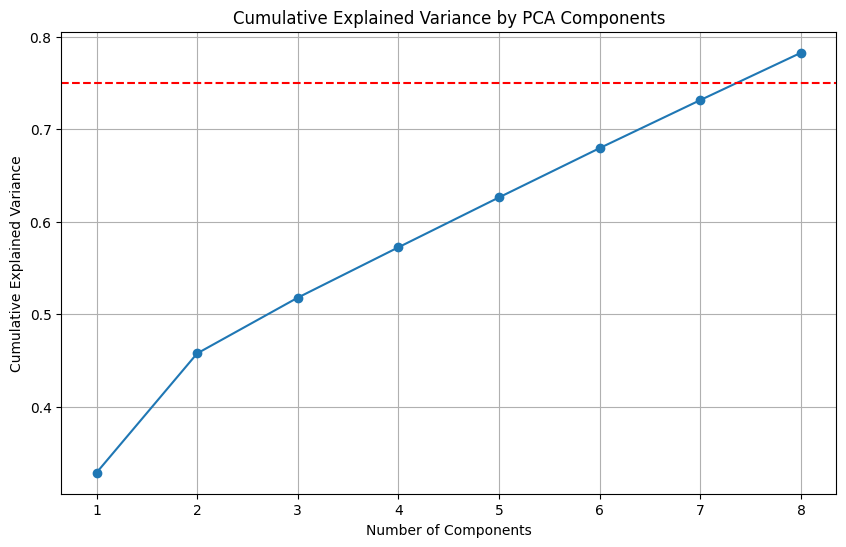


📊 PCA Eigenvalues and Variance Explained:


,Principal Component,Eigenvalue,% Variance Explained,Cumulative % Variance
0,PC1,3.35,32.89,32.89
1,PC2,1.31,12.89,45.78
2,PC3,0.61,6.02,51.80
3,PC4,0.55,5.44,57.24
4,PC5,0.55,5.39,62.64
5,PC6,0.54,5.32,67.96
6,PC7,0.53,5.19,73.15
7,PC8,0.52,5.11,78.26


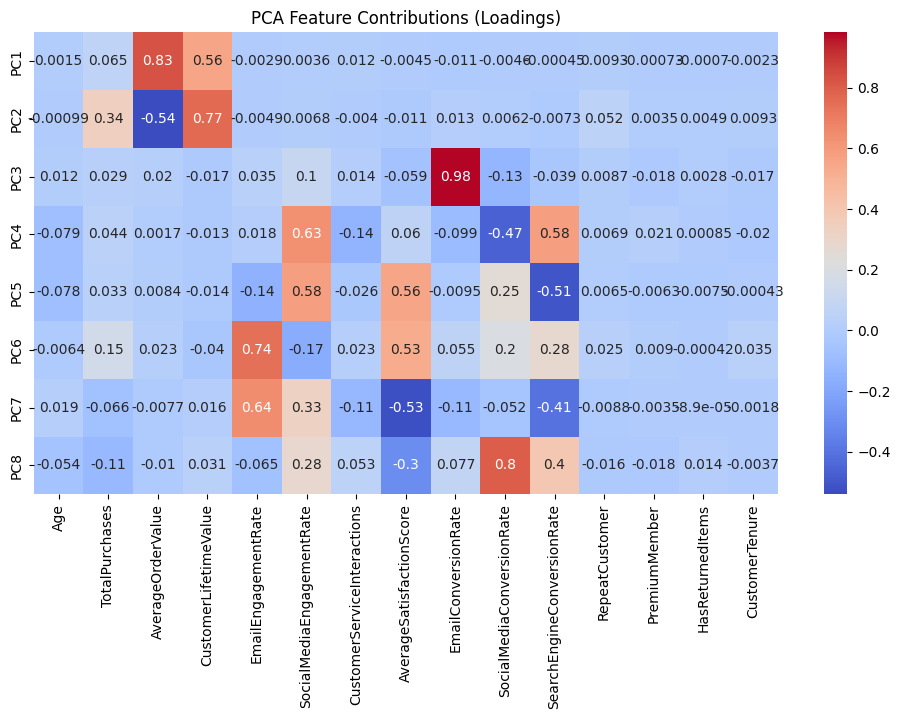

In [ ]:
# =============================== #
# 📌 Part 1: PCA (Principal Component Analysis)
# =============================== #

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from scipy.stats.mstats import winsorize
from sklearn.preprocessing import RobustScaler
from sklearn.decomposition import PCA

# Step 1: Data Preparation
df_processed = df.copy()

# Winsorization to cap outliers
for col in ['AverageOrderValue', 'CustomerLifetimeValue']:
    df_processed[col] = winsorize(df_processed[col], limits=[0.01, 0.01])

features = [
    'Age', 'TotalPurchases', 'AverageOrderValue', 'CustomerLifetimeValue',
    'EmailEngagementRate', 'SocialMediaEngagementRate',
    'CustomerServiceInteractions', 'AverageSatisfactionScore',
    'EmailConversionRate', 'SocialMediaConversionRate',
    'SearchEngineConversionRate', 'RepeatCustomer',
    'PremiumMember', 'HasReturnedItems', 'CustomerTenure'
]

# Step 2: Feature Scaling
scaler = RobustScaler()
df_scaled = scaler.fit_transform(df_processed[features])

# Step 3: Apply PCA (retain 75% of variance)
pca = PCA(n_components=0.75)
pca_data = pca.fit_transform(df_scaled)

# Step 4: Explained Variance Plot
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(pca.explained_variance_ratio_)+1), np.cumsum(pca.explained_variance_ratio_), marker='o')
plt.axhline(y=0.75, color='r', linestyle='--')
plt.title('Cumulative Explained Variance by PCA Components')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.grid(True)
plt.show()

# Step 5: Eigenvalues and Variance Explained
eigenvalues = pca.explained_variance_
explained_variance_ratio = pca.explained_variance_ratio_
cumulative_variance = np.cumsum(explained_variance_ratio)

eigenvalue_df = pd.DataFrame({
    'Principal Component': [f'PC{i+1}' for i in range(len(eigenvalues))],
    'Eigenvalue': np.round(eigenvalues, 4),
    '% Variance Explained': np.round(explained_variance_ratio * 100, 2),
    'Cumulative % Variance': np.round(cumulative_variance * 100, 2)
})
print("\n📊 PCA Eigenvalues and Variance Explained:")
display(eigenvalue_df)

# Step 6: PCA Loadings
pca_loadings_df = pd.DataFrame(
    pca.components_,
    columns=features,
    index=[f'PC{i+1}' for i in range(pca.n_components_)]
)

plt.figure(figsize=(12, 6))
sns.heatmap(pca_loadings_df, cmap="coolwarm", annot=True)
plt.title("PCA Feature Contributions (Loadings)")
plt.show()


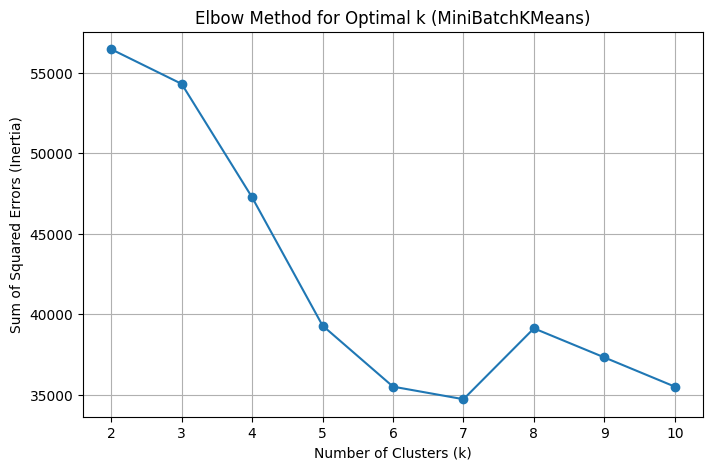


🔍 Clustering Evaluation for k=4

📊 KMeans Cluster Counts (k=4):


,0,Count
0,1,3241
1,2,3397
2,3,2094
3,4,499



📊 Agglomerative Cluster Counts (k=4, linkage=ward):


,0,Count
0,1,8148
1,2,218
2,3,97
3,4,768



📈 Evaluation Scores for k=4:


,Method,k,Silhouette,DB,CH,Composite
0,KMeans,4,0.08,2.27,1780.89,-0.40
1,Agglo-ward,4,0.32,1.31,2153.04,1.16


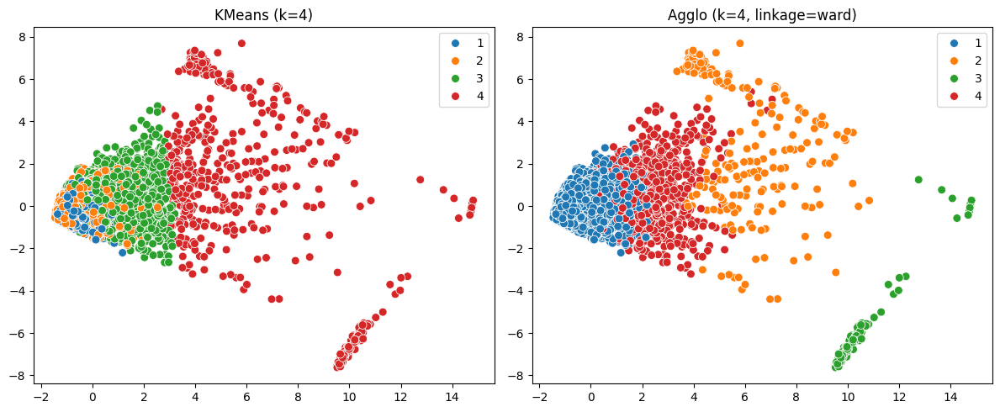


🔍 Clustering Evaluation for k=5

📊 KMeans Cluster Counts (k=5):


,0,Count
0,1,2322
1,2,2553
2,3,114
3,4,539
4,5,3703



📊 Agglomerative Cluster Counts (k=5, linkage=ward):


,0,Count
0,1,2581
1,2,218
2,3,97
3,4,768
4,5,5567



📈 Evaluation Scores for k=5:


,Method,k,Silhouette,DB,CH,Composite
0,KMeans,5,0.10,1.93,2024.39,0.19
1,Agglo-ward,5,0.09,2.25,1805.63,-0.36


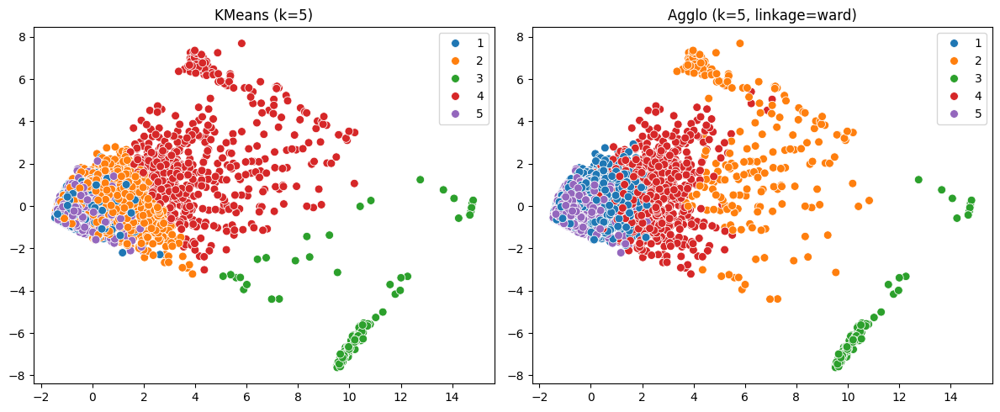


🔍 Clustering Evaluation for k=6

📊 KMeans Cluster Counts (k=6):


,0,Count
0,1,2036
1,2,1801
2,3,113
3,4,300
4,5,3435
5,6,1546



📊 Agglomerative Cluster Counts (k=6, linkage=ward):


,0,Count
0,1,218
1,2,5567
2,3,97
3,4,768
4,5,1803
5,6,778



📈 Evaluation Scores for k=6:


,Method,k,Silhouette,DB,CH,Composite
0,KMeans,6,0.11,1.79,1985.08,0.31
1,Agglo-ward,6,0.08,2.11,1600.23,-0.43


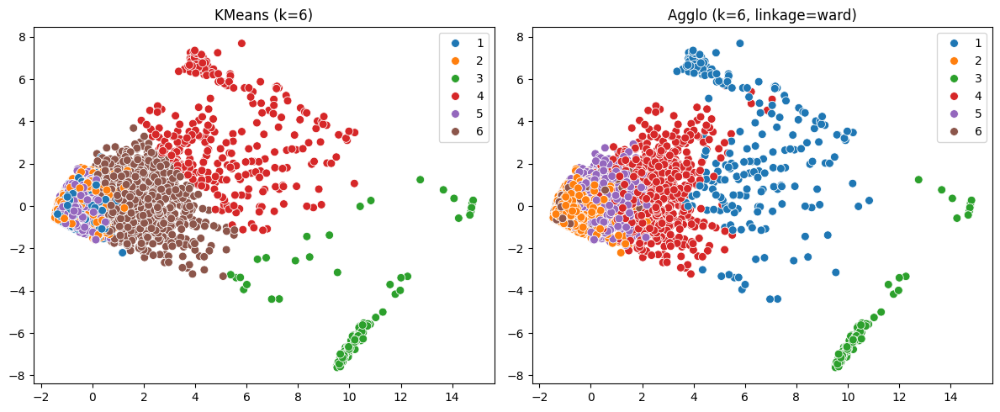


🔍 Clustering Evaluation for k=7

📊 KMeans Cluster Counts (k=7):


,0,Count
0,1,1459
1,2,1729
2,3,121
3,4,195
4,5,2802
5,6,2040
6,7,885



📊 Agglomerative Cluster Counts (k=7, linkage=ward):


,0,Count
0,1,5567
1,2,768
2,3,97
3,4,99
4,5,1803
5,6,778
6,7,119



📈 Evaluation Scores for k=7:


,Method,k,Silhouette,DB,CH,Composite
0,KMeans,7,0.11,1.76,1788.03,0.14
1,Agglo-ward,7,0.08,1.95,1443.59,-0.43


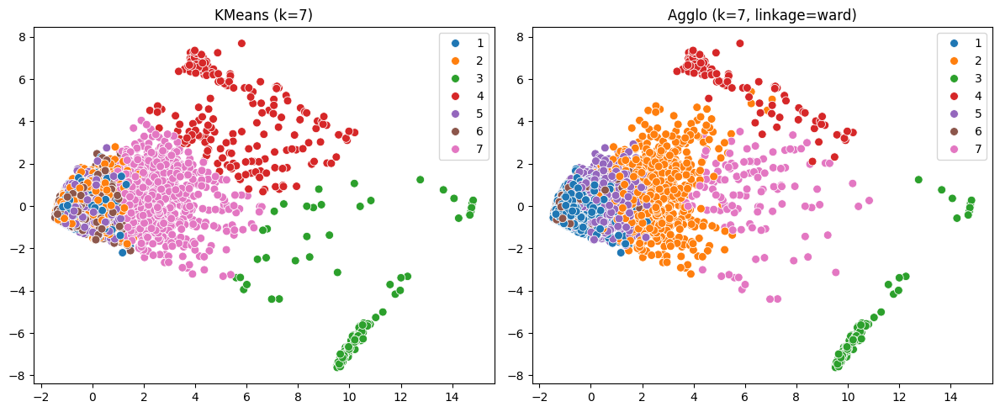


🔍 Clustering Evaluation for k=8

📊 KMeans Cluster Counts (k=8):


,0,Count
0,1,1028
1,2,1191
2,3,1067
3,4,258
4,5,1194
5,6,1890
6,7,1496
7,8,1107



📊 Agglomerative Cluster Counts (k=8, linkage=ward):


,0,Count
0,1,3491
1,2,2076
2,3,97
3,4,768
4,5,1803
5,6,778
6,7,119
7,8,99



📈 Evaluation Scores for k=8:


,Method,k,Silhouette,DB,CH,Composite
0,KMeans,8,0.08,1.87,1234.60,-0.55
1,Agglo-ward,8,0.06,2.14,1334.13,-0.75


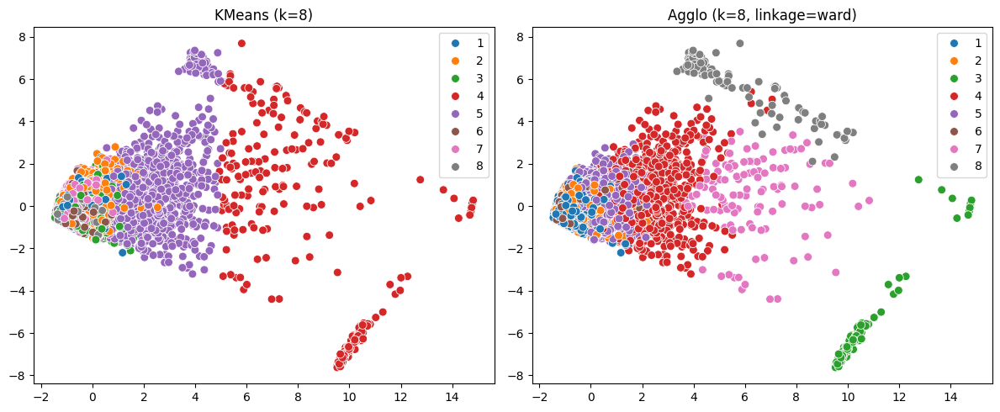


📋 Full Evaluation Metrics Summary:


,Method,k,Silhouette,DB,CH,Composite
1,Agglo-ward,4,0.32,1.31,2153.04,1.16
0,KMeans,4,0.08,2.27,1780.89,-0.40
3,Agglo-ward,5,0.09,2.25,1805.63,-0.36
2,KMeans,5,0.10,1.93,2024.39,0.19
5,Agglo-ward,6,0.08,2.11,1600.23,-0.43
4,KMeans,6,0.11,1.79,1985.08,0.31
7,Agglo-ward,7,0.08,1.95,1443.59,-0.43
6,KMeans,7,0.11,1.76,1788.03,0.14
9,Agglo-ward,8,0.06,2.14,1334.13,-0.75
8,KMeans,8,0.08,1.87,1234.60,-0.55



📝 Best Score Comparison Summary:


,Method,k,Silhouette,DB,CH,Composite
0,KMeans,6,0.11,1.79,1985.08,0.31
1,Agglo-ward,4,0.32,1.31,2153.04,1.16



✅ Best overall clustering method: Agglo-ward with k=4


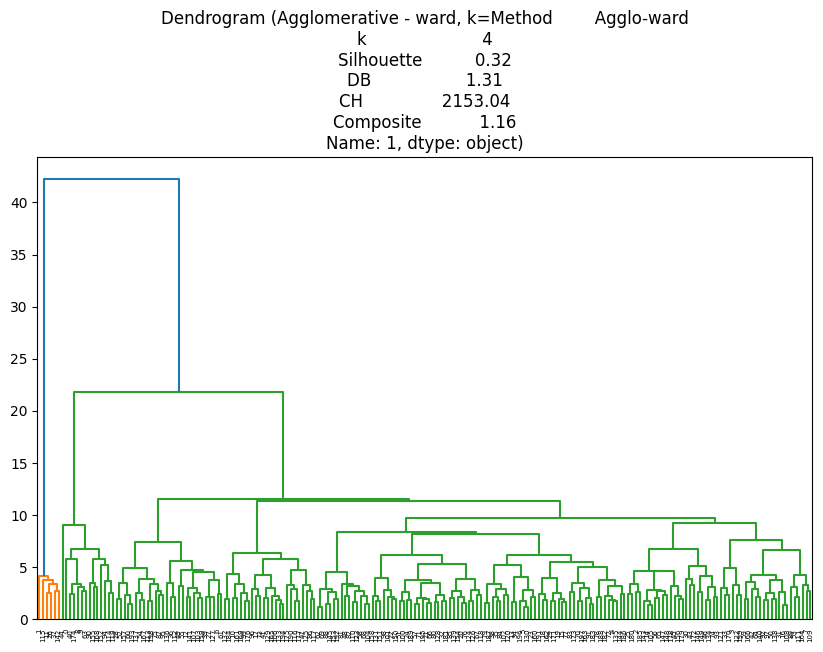

In [ ]:
# -------------------------------------------
# PART 2: FINAL CLUSTERING ANALYSIS WITH EVALUATION
# -------------------------------------------

# 1. Imports
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import MiniBatchKMeans, AgglomerativeClustering
from sklearn.metrics import silhouette_score, davies_bouldin_score, calinski_harabasz_score
from scipy.cluster.hierarchy import dendrogram, linkage

# 2. Evaluation Function
def evaluate_clustering(X, labels):
    sil = silhouette_score(X, labels)
    db = davies_bouldin_score(X, labels)
    ch = calinski_harabasz_score(X, labels)
    comp = sil - db + (ch / 1000)
    return sil, db, ch, comp

# 3. Elbow Method for KMeans
sse = []
k_range = range(2, 11)
for k in k_range:
    kmeans = MiniBatchKMeans(n_clusters=k, batch_size=100, random_state=42)
    kmeans.fit(pca_data)
    sse.append(kmeans.inertia_)

plt.figure(figsize=(8, 5))
plt.plot(k_range, sse, marker='o')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Sum of Squared Errors (Inertia)')
plt.title('Elbow Method for Optimal k (MiniBatchKMeans)')
plt.grid(True)
plt.show()

# 4. Clustering Evaluation & Visualisation (k = 4 to 8)
all_results = []

for k in range(4, 9):
    print(f"\n{'='*60}\n🔍 Clustering Evaluation for k={k}\n{'='*60}")
    result_k = []

    # --- KMeans ---
    kmeans = MiniBatchKMeans(n_clusters=k, batch_size=100, random_state=42)
    kmeans_labels = kmeans.fit_predict(pca_data) + 1
    df_processed[f'Cluster_KMeans_k{k}'] = kmeans_labels
    sil_km, db_km, ch_km, comp_km = evaluate_clustering(pca_data, kmeans_labels)
    result_k.append({
        'Method': 'KMeans', 'k': k,
        'Silhouette': sil_km, 'DB': db_km, 'CH': ch_km, 'Composite': comp_km
    })

    # Cluster counts
    print(f"\n📊 KMeans Cluster Counts (k={k}):")
    display(pd.DataFrame(kmeans_labels).value_counts().sort_index().rename('Count').reset_index().rename(columns={'index': 'Cluster'}))

    # --- Agglomerative with Ward Linkage ---
    linkage_method = 'ward'
    ag_model = AgglomerativeClustering(n_clusters=k, linkage=linkage_method)
    ag_labels = ag_model.fit_predict(pca_data) + 1
    df_processed[f'Cluster_Agglo_k{k}'] = ag_labels
    sil_ag, db_ag, ch_ag, comp_ag = evaluate_clustering(pca_data, ag_labels)
    result_k.append({
        'Method': f'Agglo-{linkage_method}', 'k': k,
        'Silhouette': sil_ag, 'DB': db_ag, 'CH': ch_ag, 'Composite': comp_ag
    })

    print(f"\n📊 Agglomerative Cluster Counts (k={k}, linkage={linkage_method}):")
    display(pd.DataFrame(ag_labels).value_counts().sort_index().rename('Count').reset_index().rename(columns={'index': 'Cluster'}))

    # Show evaluation table for this k
    df_k = pd.DataFrame(result_k)
    all_results.extend(result_k)
    print(f"\n📈 Evaluation Scores for k={k}:")
    display(df_k)

    # --- Side-by-Side Scatter Plot ---
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    sns.scatterplot(x=pca_data[:, 0], y=pca_data[:, 1], hue=kmeans_labels, palette='tab10', s=50)
    plt.title(f"KMeans (k={k})")

    plt.subplot(1, 2, 2)
    sns.scatterplot(x=pca_data[:, 0], y=pca_data[:, 1], hue=ag_labels, palette='tab10', s=50)
    plt.title(f"Agglo (k={k}, linkage={linkage_method})")

    plt.tight_layout()
    plt.show()

# 5. Evaluation Summary Table
df_results = pd.DataFrame(all_results)
print("\n📋 Full Evaluation Metrics Summary:")
display(df_results.sort_values(by=['k', 'Method']))

# 6. Best Score Comparison Summary (in table)
best_kmeans = df_results[df_results['Method'] == 'KMeans'].sort_values(by='Composite', ascending=False).iloc[0]
best_agglo = df_results[df_results['Method'].str.contains('Agglo')].sort_values(by='Composite', ascending=False).iloc[0]

summary_table = pd.DataFrame([
    {
        'Method': best_kmeans['Method'],
        'k': best_kmeans['k'],
        'Silhouette': best_kmeans['Silhouette'],
        'DB': best_kmeans['DB'],
        'CH': best_kmeans['CH'],
        'Composite': best_kmeans['Composite']
    },
    {
        'Method': best_agglo['Method'],
        'k': best_agglo['k'],
        'Silhouette': best_agglo['Silhouette'],
        'DB': best_agglo['DB'],
        'CH': best_agglo['CH'],
        'Composite': best_agglo['Composite']
    }
])
print("\n📝 Best Score Comparison Summary:")
display(summary_table)

# Best model overall
best_overall = best_kmeans if best_kmeans['Composite'] > best_agglo['Composite'] else best_agglo
print(f"\n✅ Best overall clustering method: {best_overall['Method']} with k={best_overall['k']}")


# 8. Dendrogram
if 'Agglo' in best_overall['Method']:
    sample_data = pd.DataFrame(df_scaled).sample(n=200, random_state=42)
    linked = linkage(sample_data, method='ward')

    plt.figure(figsize=(10, 6))
    dendrogram(linked)
    plt.title(f"Dendrogram (Agglomerative - ward, k={best_agglo})")
    plt.show()



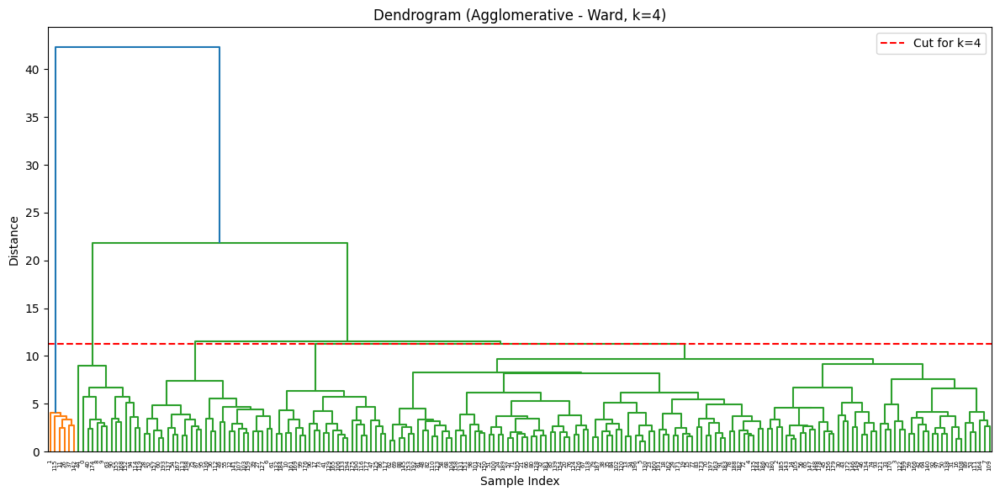

In [ ]:
from scipy.cluster.hierarchy import dendrogram, linkage
import matplotlib.pyplot as plt
import numpy as np

# 8. Dendrogram for Agglomerative Clustering with k=4
sample_data = pd.DataFrame(df_scaled).sample(n=200, random_state=42)
linked = linkage(sample_data, method='ward')

plt.figure(figsize=(12, 6))
dendrogram(linked, color_threshold=None)

# Draw horizontal line to show cut for k=4
cut_level = sorted(linked[:, 2], reverse=True)[3]  # 4 clusters = 3 merges from top
plt.axhline(y=cut_level, color='red', linestyle='--', label='Cut for k=4')

plt.title("Dendrogram (Agglomerative - Ward, k=4)")
plt.xlabel("Sample Index")
plt.ylabel("Distance")
plt.legend()
plt.tight_layout()
plt.show()


🔍 PCA Loadings (Feature Contributions to Principal Components):


,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8
Age,0.00,-0.00,0.01,-0.08,-0.08,-0.01,0.02,-0.05
TotalPurchases,0.06,0.34,0.03,0.04,0.03,0.15,-0.07,-0.11
AverageOrderValue,0.83,-0.54,0.02,0.00,0.01,0.02,-0.01,-0.01
CustomerLifetimeValue,0.56,0.77,-0.02,-0.01,-0.01,-0.04,0.02,0.03
EmailEngagementRate,-0.00,-0.00,0.04,0.02,-0.14,0.74,0.64,-0.06
SocialMediaEngagementRate,0.00,0.01,0.10,0.63,0.58,-0.17,0.33,0.28
CustomerServiceInteractions,0.01,-0.00,0.01,-0.14,-0.03,0.02,-0.11,0.05
AverageSatisfactionScore,-0.00,-0.01,-0.06,0.06,0.56,0.53,-0.53,-0.30
EmailConversionRate,-0.01,0.01,0.98,-0.10,-0.01,0.05,-0.11,0.08
SocialMediaConversionRate,-0.00,0.01,-0.13,-0.47,0.25,0.20,-0.05,0.80



📌 Most Influential Features (Top 3 from PC1 and PC2):
TotalPurchases, CustomerLifetimeValue, AverageOrderValue

🔍 MiniBatch KMeans (k=6) Cluster Profiling

📦 Cluster Sizes:


,count
Cluster_KMeans_k6,
1,2036
2,1801
3,113
4,300
5,3435
6,1546


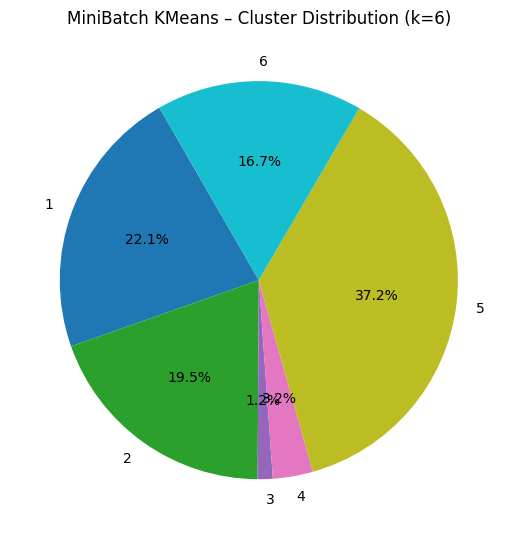

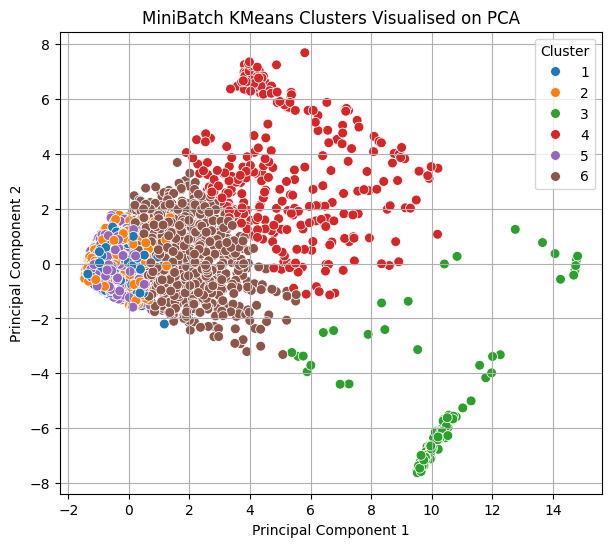


📊 Cluster Profiles – Feature Means (k=6):


,Age,TotalPurchases,AverageOrderValue,CustomerLifetimeValue,EmailEngagementRate,SocialMediaEngagementRate,CustomerServiceInteractions,AverageSatisfactionScore,EmailConversionRate,SocialMediaConversionRate,SearchEngineConversionRate,RepeatCustomer,PremiumMember,HasReturnedItems,CustomerTenure
Cluster_KMeans_k6,,,,,,,,,,,,,,,
1,35.17,4.90,56.17,254.15,0.32,0.29,1.92,6.42,0.16,0.17,0.33,0.91,0.25,0.33,54.57
2,35.67,5.34,62.29,309.57,0.31,0.29,2.06,7.05,0.36,0.20,0.17,0.93,0.22,0.33,54.64
3,35.34,4.96,1223.78,1117.09,0.28,0.30,2.29,6.94,0.19,0.19,0.21,0.88,0.22,0.27,51.70
4,35.56,7.77,342.16,3563.97,0.27,0.30,2.10,6.85,0.19,0.20,0.19,0.98,0.24,0.37,56.18
5,35.56,4.63,55.29,230.99,0.25,0.28,1.99,7.25,0.14,0.21,0.14,0.90,0.24,0.33,55.04
6,35.73,6.17,209.14,1023.12,0.28,0.28,2.03,6.94,0.18,0.20,0.19,0.96,0.23,0.35,54.76



📈 Distribution of Most Influential Features by Cluster:


/tmp/ipython-input-182-1841652009.py:56: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




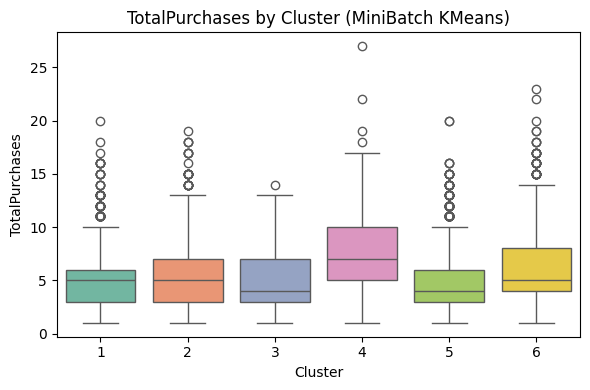

/tmp/ipython-input-182-1841652009.py:56: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




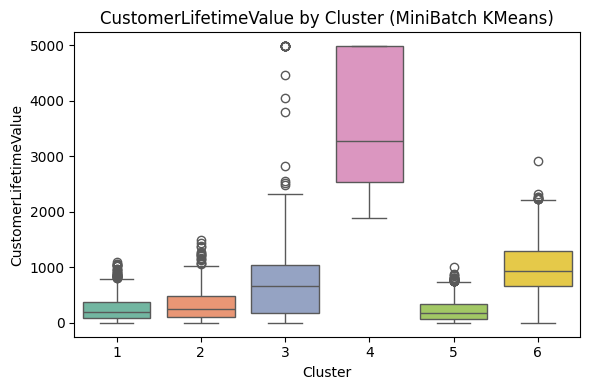

/tmp/ipython-input-182-1841652009.py:56: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




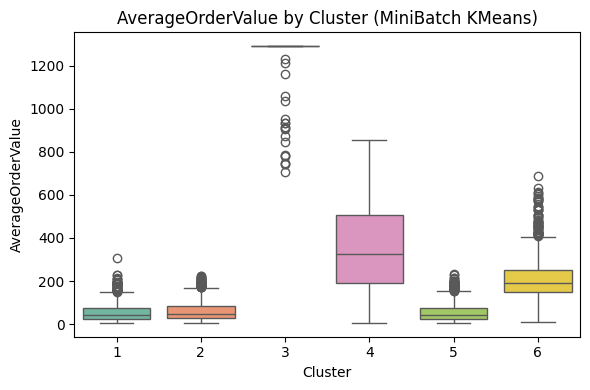


🔍 Agglomerative Clustering (k=4) Cluster Profiling

📦 Cluster Sizes:


,count
Cluster_Agglo_k4,
1,8148
2,218
3,97
4,768


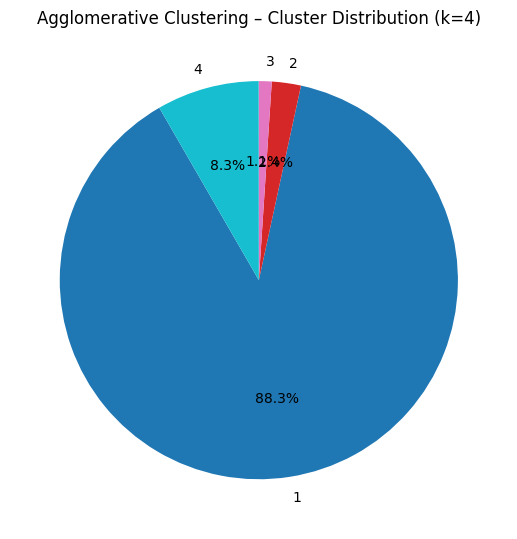

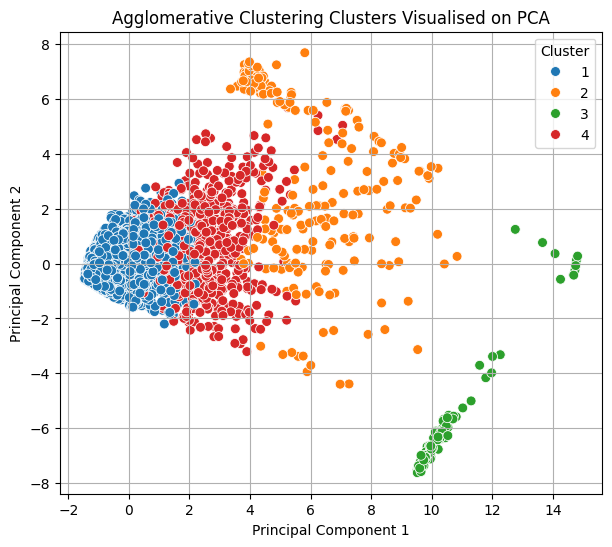


📊 Cluster Profiles – Feature Means (k=4):


,Age,TotalPurchases,AverageOrderValue,CustomerLifetimeValue,EmailEngagementRate,SocialMediaEngagementRate,CustomerServiceInteractions,AverageSatisfactionScore,EmailConversionRate,SocialMediaConversionRate,SearchEngineConversionRate,RepeatCustomer,PremiumMember,HasReturnedItems,CustomerTenure
Cluster_Agglo_k4,,,,,,,,,,,,,,,
1,35.44,5.03,69.50,322.87,0.28,0.29,1.99,6.95,0.20,0.20,0.20,0.92,0.24,0.33,54.79
2,36.61,6.28,429.48,3705.75,0.25,0.31,2.17,6.86,0.21,0.18,0.19,0.96,0.24,0.35,53.57
3,34.02,5.34,1285.46,1018.08,0.29,0.30,2.25,6.96,0.18,0.19,0.21,0.91,0.21,0.29,51.73
4,36.26,6.55,255.35,1443.09,0.30,0.27,2.06,7.09,0.20,0.20,0.22,0.95,0.24,0.35,55.78



📈 Distribution of Most Influential Features by Cluster:


/tmp/ipython-input-182-1841652009.py:56: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




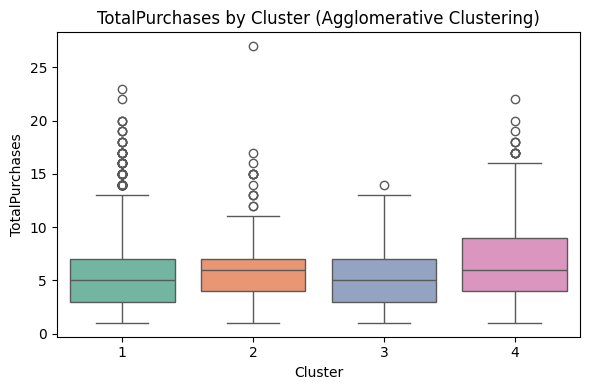

/tmp/ipython-input-182-1841652009.py:56: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




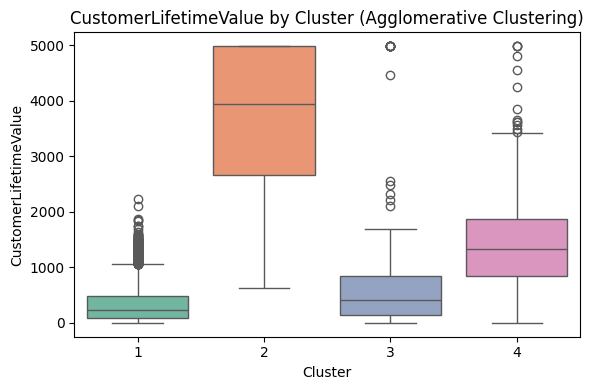

/tmp/ipython-input-182-1841652009.py:56: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




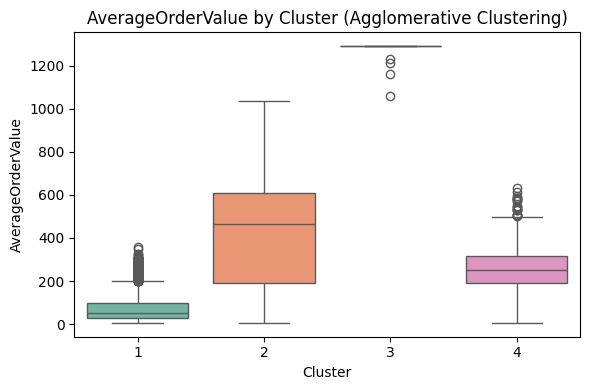


=== Mean PC scores per cluster ===


,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8
Cluster,,,,,,,,
1,-0.50,-0.07,-0,-0,0.01,-0.01,0.01,-0
2,6.07,2.84,0.05,-0.01,0.03,-0.31,0.05,0.05
3,10.59,-5.82,0.10,0.10,0.09,0.25,-0.06,-0.09
4,2.26,0.62,0.02,0.04,-0.09,0.14,-0.07,0.02


In [ ]:
# -------------------------------------------
# PART 3: PCA–Cluster Interpretation & Profiling
# -------------------------------------------

# 1. PCA Loadings – Feature Contributions to Each Component
pca_loadings = pd.DataFrame(pca.components_.T, index=features, columns=[f'PC{i+1}' for i in range(pca.n_components_)])
print("🔍 PCA Loadings (Feature Contributions to Principal Components):")
display(pca_loadings)

# Identify most influential features from first two components
top_features_pc1 = pca_loadings['PC1'].abs().sort_values(ascending=False).head(3).index.tolist()
top_features_pc2 = pca_loadings['PC2'].abs().sort_values(ascending=False).head(3).index.tolist()
important_features = list(set(top_features_pc1 + top_features_pc2))

print("\n📌 Most Influential Features (Top 3 from PC1 and PC2):")
print(", ".join(important_features))

def profile_and_visualise_clusters(df, pca_coords, cluster_col, method_name, k_value):
    print(f"\n============================")
    print(f"🔍 {method_name} (k={k_value}) Cluster Profiling")
    print(f"============================")

    # 1. Cluster Sizes
    cluster_sizes = df[cluster_col].value_counts().sort_index()
    print("\n📦 Cluster Sizes:")
    display(cluster_sizes)

    # Pie Chart for Cluster Proportions
    plt.figure(figsize=(5.5, 5.5))
    cluster_sizes.plot.pie(autopct='%1.1f%%', startangle=120, colormap='tab10')
    plt.title(f"{method_name} – Cluster Distribution (k={k_value})")
    plt.ylabel("")
    plt.tight_layout()
    plt.show()

    # 2. PCA Scatter Plot Coloured by Cluster
    plt.figure(figsize=(7, 6))
    sns.scatterplot(x=pca_coords[:, 0], y=pca_coords[:, 1], hue=df[cluster_col], palette='tab10', s=50)
    plt.title(f"{method_name} Clusters Visualised on PCA")
    plt.xlabel("Principal Component 1")
    plt.ylabel("Principal Component 2")
    plt.legend(title="Cluster")
    plt.grid(True)
    plt.show()

    # 3. Cluster Profile Table (Mean of Original Features)
    profile_features = features + [cluster_col]
    cluster_profile = df[profile_features].groupby(cluster_col).mean().round(2)
    print(f"\n📊 Cluster Profiles – Feature Means (k={k_value}):")
    display(cluster_profile)

    # 4. Feature Distribution Boxplots (Important Features)
    print("\n📈 Distribution of Most Influential Features by Cluster:")
    for feature in important_features:
        plt.figure(figsize=(6, 4))
        sns.boxplot(x=df[cluster_col], y=df[feature], palette='Set2')
        plt.title(f"{feature} by Cluster ({method_name})")
        plt.xlabel("Cluster")
        plt.ylabel(feature)
        plt.tight_layout()
        plt.show()

# Run for MiniBatch KMeans (k = 6)
profile_and_visualise_clusters(
    df=df_processed,
    pca_coords=pca_data,
    cluster_col='Cluster_KMeans_k6',
    method_name='MiniBatch KMeans',
    k_value=6
)

# Run for Agglomerative Clustering (k = 4)
profile_and_visualise_clusters(
    df=df_processed,
    pca_coords=pca_data,
    cluster_col='Cluster_Agglo_k4',
    method_name='Agglomerative Clustering',
    k_value=4
)

# Get the column name of the best clustering result
best_k = best_overall['k']
best_method = best_overall['Method']
cluster_column = ''

if best_method == 'KMeans':
    cluster_column = f'Cluster_KMeans_k{best_k}'
elif 'Agglo' in best_method:
    cluster_column = f'Cluster_Agglo_k{best_k}'


# Create PCA scores DataFrame and append cluster label
pca_scores_df = pd.DataFrame(pca_data, columns=[f'PC{i+1}' for i in range(pca_data.shape[1])])
pca_scores_df['Cluster'] = df_processed[cluster_column].values

# Step 4: Compute mean PC scores per cluster
cluster_pc_means = pca_scores_df.groupby('Cluster').mean().round(2)
print("\n=== Mean PC scores per cluster ===")
display(cluster_pc_means)

In [ ]:
# Example for MiniBatch KMeans with k=6
cluster_col = 'Cluster_Agglo_k4'

# Create PCA scores DataFrame and append cluster label
pca_scores_df = pd.DataFrame(pca_data, columns=[f'PC{i+1}' for i in range(pca_data.shape[1])])
pca_scores_df[cluster_col] = df_processed[cluster_col].values

# Compute mean PC scores per cluster
mean_pc_scores = pca_scores_df.groupby(cluster_col).mean().round(2)
print(f"\n📌 Mean Principal Component Scores per Cluster ({cluster_col}):")
display(mean_pc_scores)



📌 Mean Principal Component Scores per Cluster (Cluster_Agglo_k4):


,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8
Cluster_Agglo_k4,,,,,,,,
1,-0.50,-0.07,-0,-0,0.01,-0.01,0.01,-0
2,6.07,2.84,0.05,-0.01,0.03,-0.31,0.05,0.05
3,10.59,-5.82,0.10,0.10,0.09,0.25,-0.06,-0.09
4,2.26,0.62,0.02,0.04,-0.09,0.14,-0.07,0.02



📊 PCA Eigenvalues and Variance Explained:


,Principal Component,Eigenvalue,% Variance Explained,Cumulative % Variance
0,PC1,3.35,32.89,32.89
1,PC2,1.31,12.89,45.78
2,PC3,0.61,6.02,51.80
3,PC4,0.55,5.44,57.24
4,PC5,0.55,5.39,62.64
5,PC6,0.54,5.32,67.96
6,PC7,0.53,5.19,73.15
7,PC8,0.52,5.11,78.26


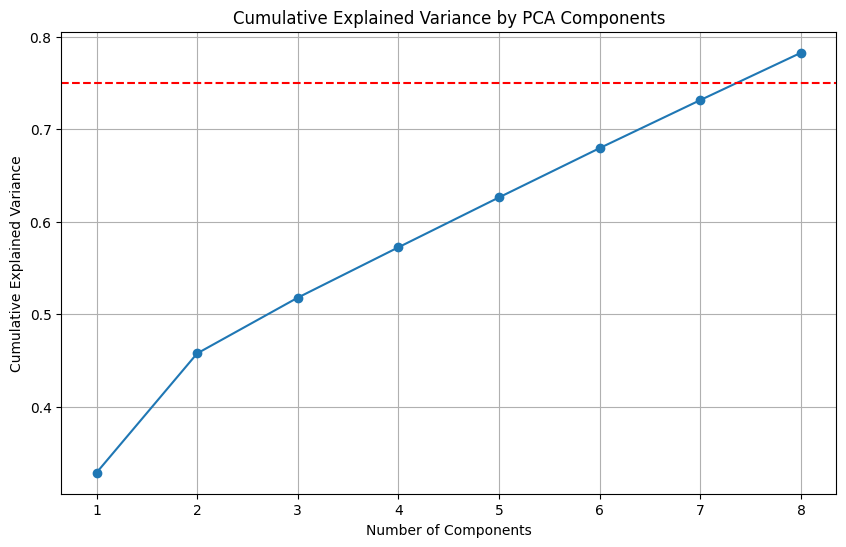

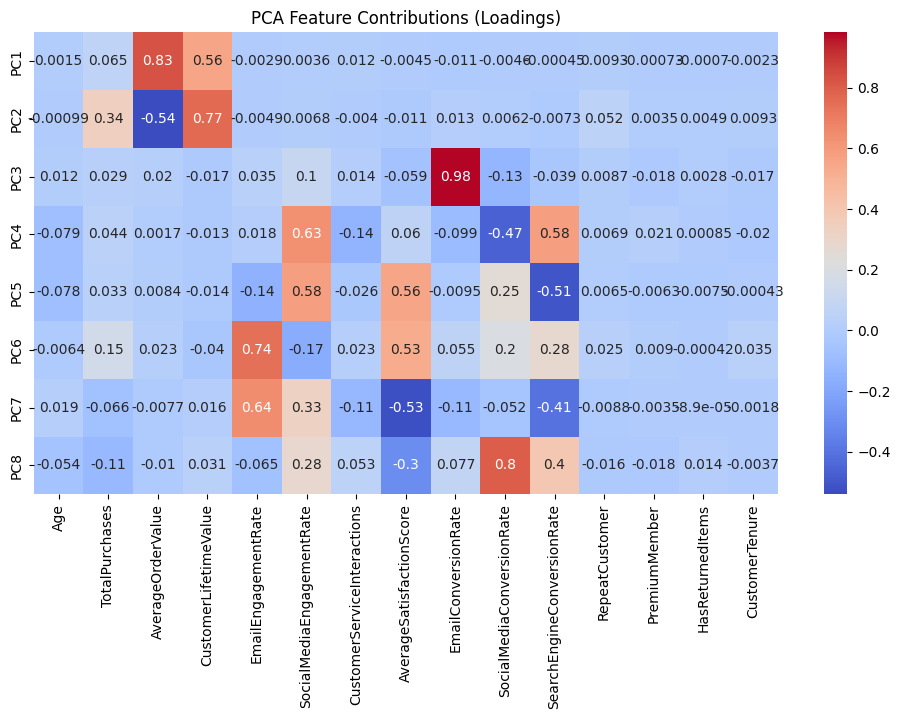

In [ ]:
# ===============================
# 📦 Imports
# ===============================
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

from scipy.stats.mstats import winsorize
from sklearn.preprocessing import RobustScaler
from sklearn.decomposition import PCA
from sklearn.cluster import AgglomerativeClustering, MiniBatchKMeans
from sklearn.metrics import silhouette_score, davies_bouldin_score, calinski_harabasz_score
from scipy.cluster.hierarchy import linkage as scipy_linkage, dendrogram

# ===============================
# 📌 Data Preparation
# ===============================

df_processed = df.copy()

# Winsorization for capping outliers
for col in ['AverageOrderValue', 'CustomerLifetimeValue']:
    df_processed[col] = winsorize(df_processed[col], limits=[0.01, 0.01])

# Feature selection
features = [
    'Age', 'TotalPurchases', 'AverageOrderValue', 'CustomerLifetimeValue',
    'EmailEngagementRate', 'SocialMediaEngagementRate',
    'CustomerServiceInteractions', 'AverageSatisfactionScore',
    'EmailConversionRate', 'SocialMediaConversionRate',
    'SearchEngineConversionRate', 'RepeatCustomer',
    'PremiumMember', 'HasReturnedItems', 'CustomerTenure'
]

# Scaling with RobustScaler
scaler = RobustScaler()
df_scaled = scaler.fit_transform(df_processed[features])

# ===============================
# 📌 Principal Component Analysis (PCA)
# ===============================

# Apply PCA to retain 75% of variance
pca = PCA(n_components=0.75)
pca_data = pca.fit_transform(df_scaled)

# Explained variance metrics
eigenvalues = pca.explained_variance_
explained_variance_ratio = pca.explained_variance_ratio_
cumulative_variance = np.cumsum(explained_variance_ratio)

# Display eigenvalues and variance explained
eigenvalue_df = pd.DataFrame({
    'Principal Component': [f'PC{i+1}' for i in range(len(eigenvalues))],
    'Eigenvalue': np.round(eigenvalues, 4),
    '% Variance Explained': np.round(explained_variance_ratio * 100, 2),
    'Cumulative % Variance': np.round(cumulative_variance * 100, 2)
})

print("\n📊 PCA Eigenvalues and Variance Explained:")
display(eigenvalue_df)

# Plot cumulative explained variance
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(explained_variance_ratio)+1), cumulative_variance, marker='o')
plt.axhline(y=0.75, color='red', linestyle='--')
plt.title('Cumulative Explained Variance by PCA Components')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.grid(True)
plt.show()

# ===============================
# 📌 PCA Loadings (Feature Contributions)
# ===============================

pca_loadings = pd.DataFrame(
    pca.components_,
    columns=features,
    index=[f'PC{i+1}' for i in range(len(pca.components_))]
)

plt.figure(figsize=(12, 6))
sns.heatmap(pca_loadings, cmap="coolwarm", annot=True)
plt.title("PCA Feature Contributions (Loadings)")
plt.show()
